In [44]:
import os
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

In [21]:
os.chdir("C:\\Users\\user\\Desktop\python\\Text mining") ## 수정부분

# data

In [31]:
df=pd.read_csv("googleplaystore_user_reviews.csv",encoding="latin1")

In [32]:
len(df)

64295

In [38]:
64295-37324

26971

In [33]:
df.head()

,App,Translated_Review,Sentiment,Sentiment_Polarity,Sentiment_Subjectivity
0,10 Best Foods for You,I like eat delicious food. That's I'm cooking ...,Positive,1.00,0.533333
1,10 Best Foods for You,This help eating healthy exercise regular basis,Positive,0.25,0.288462
2,10 Best Foods for You,NaN,NaN,NaN,NaN
3,10 Best Foods for You,Works great especially going grocery store,Positive,0.40,0.875000
4,10 Best Foods for You,Best idea us,Positive,1.00,0.300000


In [34]:
len(df.App.unique())

1074

# 1. data 전처리 

## na 처리

In [35]:
df= df[pd.notnull(df['Translated_Review'])]
df = df[pd.notnull(df['Sentiment'])]

In [36]:
len(df)

37427

In [37]:
len(df.App.unique())

865

## col 조정

In [40]:
df2=pd.concat([df.App,df.Translated_Review,df.Sentiment],axis=1)
df2.dropna(axis=0,inplace=True)  # For drop nan values. It makes confuse for our model.
df2.tail()

,App,Translated_Review,Sentiment
64222,Housing-Real Estate & Property,Most ads older many agents ..not much owner po...,Positive
64223,Housing-Real Estate & Property,"If photos posted portal load, fit purpose. I'm...",Positive
64226,Housing-Real Estate & Property,"Dumb app, I wanted post property rent give opt...",Negative
64227,Housing-Real Estate & Property,I property business got link SMS happy perform...,Positive
64230,Housing-Real Estate & Property,"Useless app, I searched flats kondapur, Hydera...",Negative


In [50]:
df2.reset_index(drop=True, inplace=True)

In [279]:
len(df2.App.unique())

865

## 토큰화 및 Lemmatization 

In [129]:
import nltk  ## Natural Language Tool Kit
from nltk.corpus import stopwords 
from nltk.stem.porter import PorterStemmer
from nltk.tokenize import word_tokenize
import re

text_list = []
for i in df2.Translated_Review :
    text=re.sub("[^a-zA-Z]"," ",i)
    text=re.sub("[/(){}\[\]\|@!,;:[''][""]``]"," ",text)
    text = re.sub('[ #+_♥️]', ' ',text)
    text=text.lower()
    text=nltk.word_tokenize(text)
    lemma=nltk.WordNetLemmatizer()
    text=[lemma.lemmatize(word) for word in text]
    text=" ".join(text)
    text_list.append(text)


In [130]:
text_list

['i like eat delicious food that s i m cooking food myself case best food help lot also best before shelf life',
 'this help eating healthy exercise regular basis',
 'work great especially going grocery store',
 'best idea u',
 'best way',
 'amazing',
 'looking forward app',
 'it helpful site it help food get',
 'good you',
 'useful information the amount spelling error question validity information shared once fixed star given',
 'thank you great app add arthritis eye immunity kidney liver detox food please',
 'greatest ever completely awesome maintain health this must ppl there love it',
 'good health good health first priority',
 'health it s important world either life think',
 'mr sunita bhati i thankful developer to make kind app really good healthy food body',
 'very useful in diabetes age i need control sugar thanks',
 'one greatest apps',
 'good nice',
 'healthy really helped',
 'god health',
 'health should always be top priority on mysg',
 'an excellent a useful',
 'i found 

## 불용어제거

In [131]:
text_list2 = pd.DataFrame(text_list)

In [132]:
stop_words = set(stopwords.words('english'))
text_list2 = text_list2[0].apply(lambda x: ' '.join(
    term for term in x.split() if term not in stop_words))

In [134]:
text_list2[0]

'like eat delicious food cooking food case best food help lot also best shelf life'

## bag-of-words

In [189]:
all_words = []
for message in text_list2:
    words = word_tokenize(message)
    for w in words:
        all_words.append(w)

In [204]:
word_token=[]
for message in text_list2:
    words = word_tokenize(message)
    word_token.append(words)

In [205]:
word_token

[['like',
  'eat',
  'delicious',
  'food',
  'cooking',
  'food',
  'case',
  'best',
  'food',
  'help',
  'lot',
  'also',
  'best',
  'shelf',
  'life'],
 ['help', 'eating', 'healthy', 'exercise', 'regular', 'basis'],
 ['work', 'great', 'especially', 'going', 'grocery', 'store'],
 ['best', 'idea', 'u'],
 ['best', 'way'],
 ['amazing'],
 ['looking', 'forward', 'app'],
 ['helpful', 'site', 'help', 'food', 'get'],
 ['good'],
 ['useful',
  'information',
  'amount',
  'spelling',
  'error',
  'question',
  'validity',
  'information',
  'shared',
  'fixed',
  'star',
  'given'],
 ['thank',
  'great',
  'app',
  'add',
  'arthritis',
  'eye',
  'immunity',
  'kidney',
  'liver',
  'detox',
  'food',
  'please'],
 ['greatest',
  'ever',
  'completely',
  'awesome',
  'maintain',
  'health',
  'must',
  'ppl',
  'love'],
 ['good', 'health', 'good', 'health', 'first', 'priority'],
 ['health', 'important', 'world', 'either', 'life', 'think'],
 ['mr',
  'sunita',
  'bhati',
  'thankful',
  'd

# 2. EDA

Text(0,0.5,'Count')

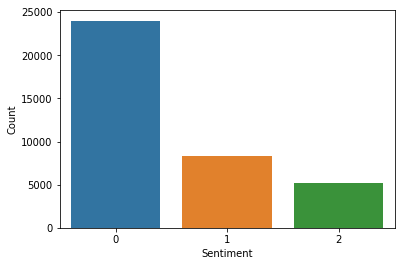

In [208]:
sns.countplot(x='Sentiment', data=df2)
plt.xlabel('Sentiment')
plt.ylabel('Count')

## Most common Words

In [193]:
all_words = nltk.FreqDist(all_words)

#Printing the total number of words and the 15 most common words
print('Number of words: {}'.format(len(all_words)))
print('Most common words: {}'.format(all_words.most_common(15)))


Number of words: 17580
Most common words: [('game', 10374), ('time', 5658), ('like', 5595), ('good', 5294), ('get', 5153), ('app', 5025), ('great', 4819), ('love', 4783), ('ad', 3467), ('work', 3452), ('would', 3417), ('really', 3096), ('update', 3047), ('even', 2889), ('make', 2861)]


In [191]:
from collections import Counter
words_counts = Counter(all_words)
most_common_words = sorted(words_counts.items(), key=lambda x: x[1], reverse=True)
most_commmom_wordList = []
most_commmom_CountList = []
for x, y in most_common_words:
    most_commmom_wordList.append(x)
    most_commmom_CountList.append(y)

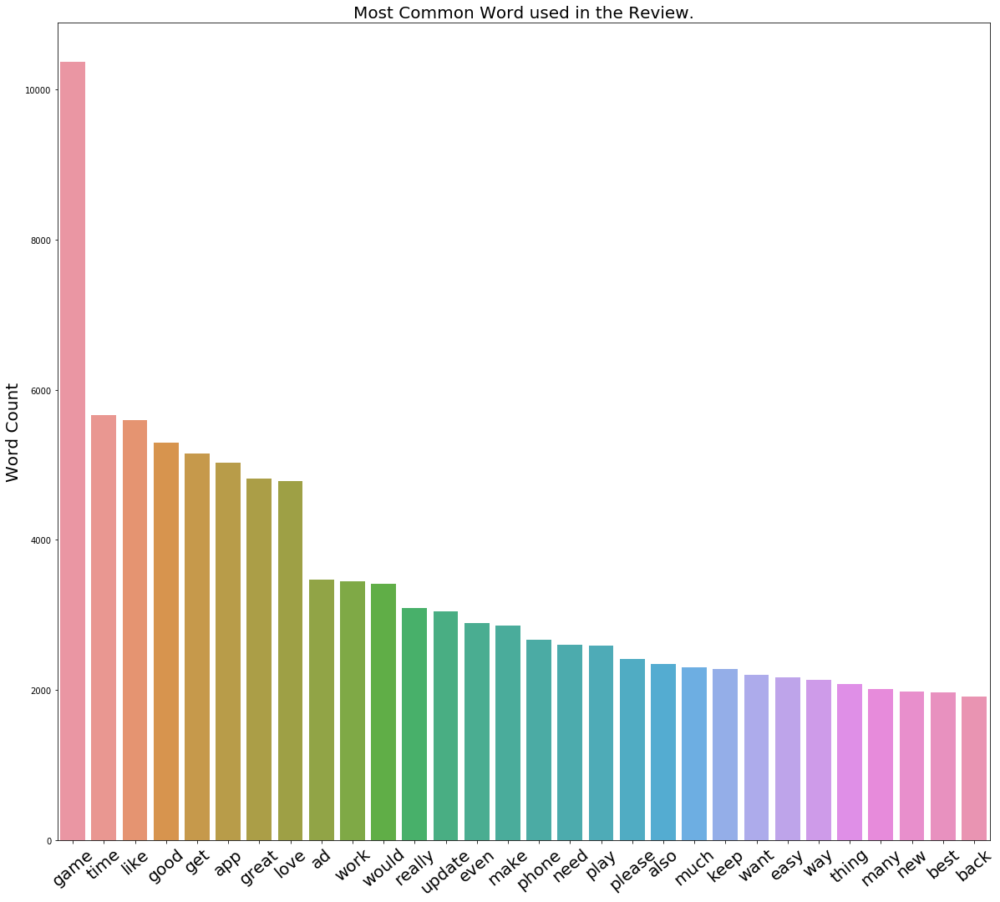

In [192]:
plt.figure(figsize=(20,18))
plot = sns.barplot(np.arange(30), most_commmom_CountList[0:30]) #width=0.35)
plt.ylabel('Word Count',fontsize=20)
plt.xticks(np.arange(30), most_commmom_wordList[0:30], fontsize=20, rotation=40)
plt.title('Most Common Word used in the Review.', fontsize=20)
plt.show()

## 감성 별 Most Common Words

In [206]:
k = most_commmom_wordList[0:30]
Sentiment_Polarity=[]
Positive=[]
Neutral=[]
Negative=[]
for i in k:
    Sentiment=[]
    for z in word_token:
        if i in z and df2['Sentiment'][word_token.index(z)]==0:
            Positive.append(i)
        elif i in z and df2['Sentiment'][word_token.index(z)]==2:
            Neutral.append(i)
        elif i in z and df2['Sentiment'][word_token.index(z)]==1:
            Negative.append(i)

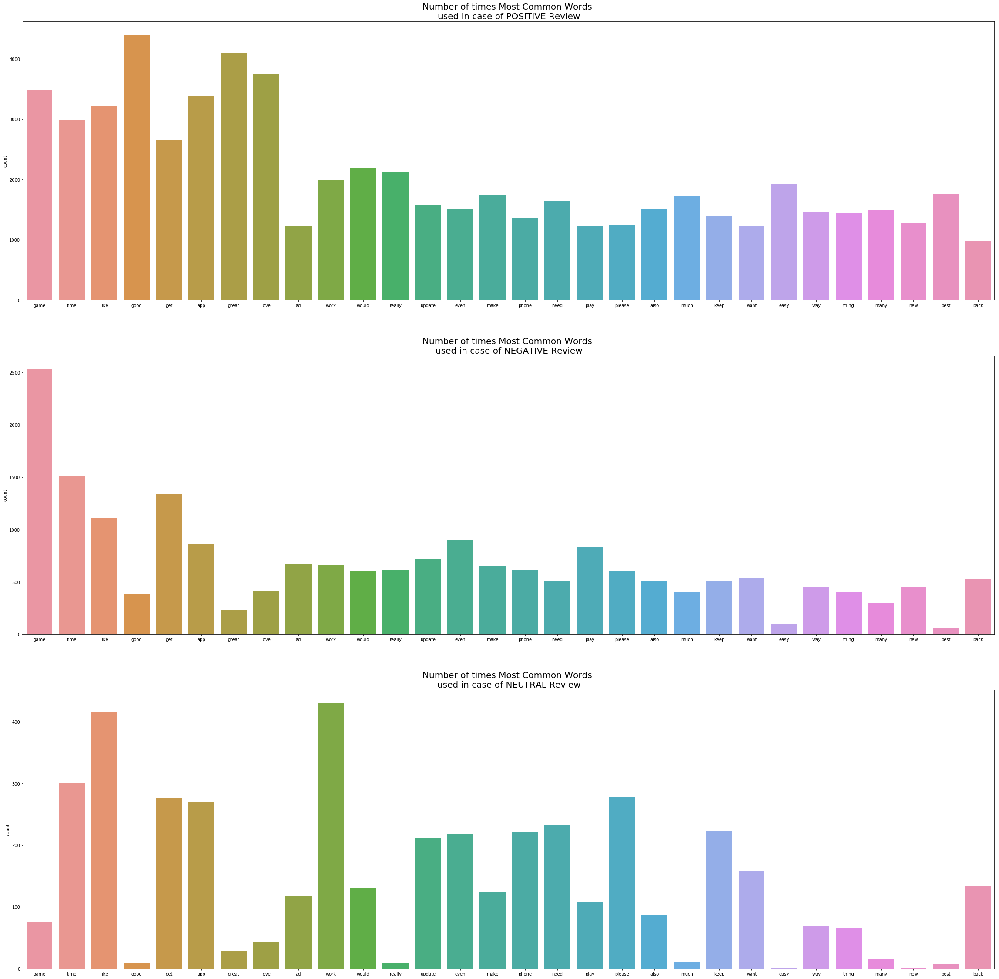

In [207]:
f,ax = plt.subplots(3,1,figsize=(40,40))
c1 = sns.countplot(Positive, ax=ax[0])
c2 = sns.countplot(Neutral,ax=ax[2])
c3 = sns.countplot(Negative,ax=ax[1])
ax[0].set_title("Number of times Most Common Words \nused in case of POSITIVE Review",fontsize=20)
ax[2].set_title("Number of times Most Common Words \nused in case of NEUTRAL Review",fontsize=20)
ax[1].set_title("Number of times Most Common Words \nused in case of NEGATIVE Review",fontsize=20)
plt.show()

## WordCloud

(-0.5, 399.5, 199.5, -0.5)

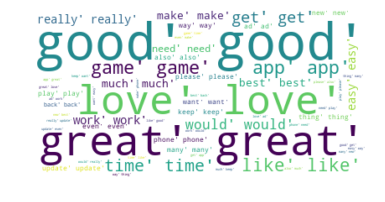

In [209]:
from wordcloud import WordCloud
# Word Cloud for positive reviews
Positive=str(Positive)
wordcloud = WordCloud(max_font_size=100, max_words=200, background_color="white").generate(Positive)

plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")

(-0.5, 399.5, 199.5, -0.5)

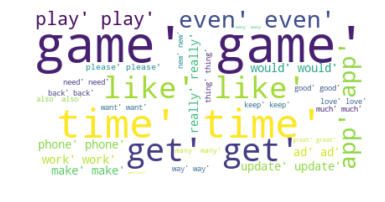

In [210]:
from wordcloud import WordCloud
# Word Cloud for negative reviews
Positive=str(Negative)
wordcloud = WordCloud(max_font_size=100, max_words=200, background_color="white").generate(Positive)

plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")

(-0.5, 399.5, 199.5, -0.5)

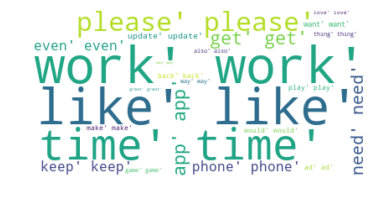

In [211]:
from wordcloud import WordCloud
# Word Cloud for neutral reviews
Positive=str(Neutral)
wordcloud = WordCloud(max_font_size=100, max_words=200, background_color="white").generate(Positive)

plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")

## data type

In [212]:
#Using the 3000 words as features
word_features = list(all_words.keys())[:3000]

def find_features(message):
    words = word_tokenize(message)
    features = {}
    for word in word_features:
        features[word] = (word in words)

    return features

#Unifying reviews with their respective encoded class labels
messages = list(zip(text_list2, df2['Sentiment']))
print("Testing(Unification of reviews and labels):", messages[0])

Testing(Unification of reviews and labels): ('like eat delicious food cooking food case best food help lot also best shelf life', 0)


# Modeling

In [224]:
from nltk.classify.scikitlearn import SklearnClassifier
from sklearn import model_selection
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import classification_report, confusion_matrix
import warnings

#Defining a seed for reproducibility and shuffling
seed = 1
np.random.seed = seed
np.random.shuffle(messages)

#Calling find_features function for each review
featuresets = [(find_features(text), label) for (text, label) in messages]

#Splitting the data into training and testing datasets
training, testing = model_selection.train_test_split(featuresets, test_size = 0.25, random_state=seed)
print("Training set:", len(training))
print("Testing set:", len(testing))

Training set: 28070
Testing set: 9357


In [225]:
featuresets[0]

({'like': False,
  'eat': False,
  'delicious': False,
  'food': False,
  'cooking': False,
  'case': False,
  'best': False,
  'help': False,
  'lot': False,
  'also': False,
  'shelf': False,
  'life': False,
  'eating': False,
  'healthy': False,
  'exercise': False,
  'regular': False,
  'basis': False,
  'work': False,
  'great': False,
  'especially': False,
  'going': False,
  'grocery': False,
  'store': False,
  'idea': False,
  'u': False,
  'way': False,
  'amazing': False,
  'looking': False,
  'forward': False,
  'app': False,
  'helpful': False,
  'site': False,
  'get': False,
  'good': False,
  'useful': False,
  'information': False,
  'amount': False,
  'spelling': False,
  'error': False,
  'question': False,
  'validity': False,
  'shared': False,
  'fixed': False,
  'star': False,
  'given': False,
  'thank': False,
  'add': True,
  'arthritis': False,
  'eye': False,
  'immunity': False,
  'kidney': False,
  'liver': False,
  'detox': False,
  'please': False,
  '

In [266]:
from sklearn.feature_extraction import DictVectorizer
vectorizer = DictVectorizer()

X_train, y_train = list(zip(*training))
X_train = vectorizer.fit_transform(X_train)

X_test, y_test = list(zip(*testing))
X_test = vectorizer.transform(X_test)

## Naive Bayes

In [299]:
from sklearn.naive_bayes import MultinomialNB

nb = MultinomialNB(alpha=1.0, fit_prior=True)

nb.fit(X_train, y_train)

accuracy = nb.score(X_test, y_test)
print('The accuracy using MultinomialNB is: {0:.2f}%'.format(accuracy*100))

The accuracy using MultinomialNB is: 76.92%


In [239]:
#Displaying the false positives and True positives in confusion matrix
df = pd.DataFrame(
    confusion_matrix(labels, prediction),
    index = [['actual', 'actual', 'actual'], ['Negative','Neutral', 'Positive']],
    columns = [['predicted', 'predicted', 'predicted'], ['Negative','Neutral', 'Positive']])
print(df)


                predicted                 
                 Negative Neutral Positive
actual Negative      5383     442      147
       Neutral        572    1383      121
       Positive       795      83      431


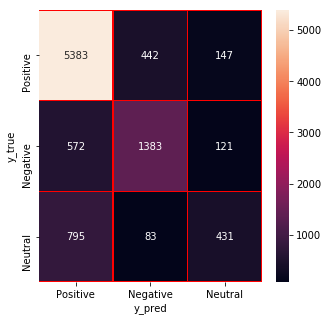

In [300]:
#confussion matrix
y_pred=nb.predict(X_test)
y_true=y_test
from sklearn.metrics import confusion_matrix
import seaborn as sns
names=["Positive","Negative","Neutral"]
cm=confusion_matrix(y_true,y_pred)
f,ax=plt.subplots(figsize=(5,5))
sns.heatmap(cm,annot=True,linewidth=.5,linecolor="r",fmt=".0f",ax=ax)
plt.xlabel("y_pred")
plt.ylabel("y_true")
ax.set_xticklabels(names)
ax.set_yticklabels(names)
plt.show()

In [301]:
print(classification_report(y_test,y_pred))

             precision    recall  f1-score   support

          0       0.80      0.90      0.85      5972
          1       0.72      0.67      0.69      2076
          2       0.62      0.33      0.43      1309

avg / total       0.76      0.77      0.75      9357



## RandomForest

In [302]:
## from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import confusion_matrix

clf = RandomForestClassifier()
clf.fit(X_train, y_train)

accuracy = clf.score(X_test, y_test)
print('The accuracy using RandomForest is: {0:.2f}%'.format(accuracy*100))

The accuracy using RandomForest is: 89.31%


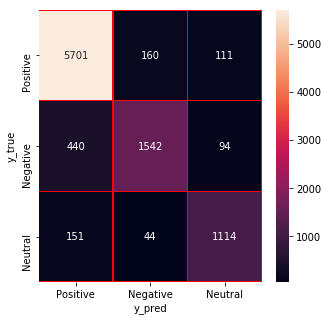

In [303]:
#confussion matrix
y_pred=clf.predict(X_test)
y_true=y_test

from sklearn.metrics import confusion_matrix
import seaborn as sns
names=["Positive","Negative","Neutral"]
cm=confusion_matrix(y_true,y_pred)
f,ax=plt.subplots(figsize=(5,5))
sns.heatmap(cm,annot=True,linewidth=.5,linecolor="r",fmt=".0f",ax=ax)
plt.xlabel("y_pred")
plt.ylabel("y_true")
ax.set_xticklabels(names)
ax.set_yticklabels(names)
plt.show()

In [304]:
print(classification_report(y_test,y_pred))

             precision    recall  f1-score   support

          0       0.91      0.95      0.93      5972
          1       0.88      0.74      0.81      2076
          2       0.84      0.85      0.85      1309

avg / total       0.89      0.89      0.89      9357



## Logistic Regression

In [305]:
#logistic Regression
from sklearn.linear_model import LogisticRegression
lr=LogisticRegression()
lr.fit(X_train,y_train)
accuracy = lr.score(X_test, y_test)
print('The accuracy using Logistic Regression is: {0:.2f}%'.format(accuracy*100))

The accuracy using Logistic Regression is: 90.62%


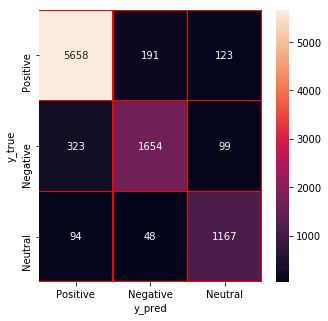

In [306]:
#confussion matrix
y_pred=lr.predict(X_test)
y_true=y_test
from sklearn.metrics import confusion_matrix
import seaborn as sns
names=["Positive","Negative","Neutral"]
cm=confusion_matrix(y_true,y_pred)
f,ax=plt.subplots(figsize=(5,5))
sns.heatmap(cm,annot=True,linewidth=.5,linecolor="r",fmt=".0f",ax=ax)
plt.xlabel("y_pred")
plt.ylabel("y_true")
ax.set_xticklabels(names)
ax.set_yticklabels(names)
plt.show()

In [307]:
print(classification_report(y_test,y_pred))

             precision    recall  f1-score   support

          0       0.93      0.95      0.94      5972
          1       0.87      0.80      0.83      2076
          2       0.84      0.89      0.87      1309

avg / total       0.91      0.91      0.91      9357



## SVM

In [319]:
from sklearn.svm import SVC

svm = SVC(kernel='linear', C=1.0, random_state=42)    # C는 SVM 튜닝 매개변수 

svm.fit(X_train, y_train)

accuracy = svm.score(X_test, y_test)

print('The accuracy using SVM is: {0:.2f}%'.format(accuracy*100))

The accuracy using SVM is: 91.00%


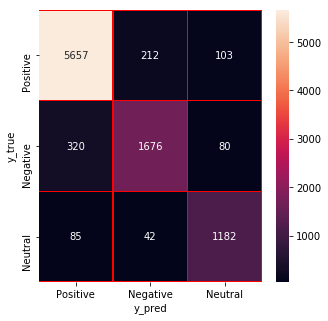

In [320]:
#confussion matrix
y_pred=svm.predict(X_test)
y_true=y_test
from sklearn.metrics import confusion_matrix
import seaborn as sns
names=["Positive","Negative","Neutral"]
cm=confusion_matrix(y_true,y_pred)
f,ax=plt.subplots(figsize=(5,5))
sns.heatmap(cm,annot=True,linewidth=.5,linecolor="r",fmt=".0f",ax=ax)
plt.xlabel("y_pred")
plt.ylabel("y_true")
ax.set_xticklabels(names)
ax.set_yticklabels(names)
plt.show()

In [310]:
print(classification_report(y_test,y_pred))

             precision    recall  f1-score   support

          0       0.93      0.95      0.94      5972
          1       0.87      0.81      0.84      2076
          2       0.87      0.90      0.88      1309

avg / total       0.91      0.91      0.91      9357



## Decision Tree

In [311]:
from sklearn.tree import DecisionTreeClassifier

decision_tree = DecisionTreeClassifier(
        max_features=None,
        max_depth=20)

decision_tree.fit(X_train,y_train)

accuracy = decision_tree.score(X_test, y_test)

print('The accuracy using Decision Tree is: {0:.2f}%'.format(accuracy*100))


The accuracy using Decision Tree is: 71.81%


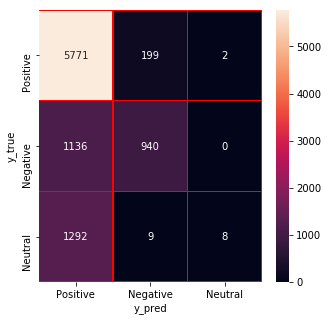

In [312]:
#confussion matrix
y_pred=decision_tree.predict(X_test)
y_true=y_test
from sklearn.metrics import confusion_matrix
import seaborn as sns
names=["Positive","Negative","Neutral"]
cm=confusion_matrix(y_true,y_pred)
f,ax=plt.subplots(figsize=(5,5))
sns.heatmap(cm,annot=True,linewidth=.5,linecolor="r",fmt=".0f",ax=ax)
plt.xlabel("y_pred")
plt.ylabel("y_true")
ax.set_xticklabels(names)
ax.set_yticklabels(names)
plt.show()

In [313]:
print(classification_report(y_test,y_pred))

             precision    recall  f1-score   support

          0       0.70      0.97      0.81      5972
          1       0.82      0.45      0.58      2076
          2       0.80      0.01      0.01      1309

avg / total       0.74      0.72      0.65      9357



## SVM FINAL

In [321]:
nltk_model = SklearnClassifier(svm)
nltk_model.train(training)

<SklearnClassifier(SVC(C=1.0, cache_size=200, class_weight=None, coef0=0.0,
  decision_function_shape='ovr', degree=3, gamma='auto', kernel='linear',
  max_iter=-1, probability=False, random_state=42, shrinking=True,
  tol=0.001, verbose=False))>

In [322]:
#Listing the predicted labels for testing dataset
txt_features, labels = list(zip(*testing))
prediction = nltk_model.classify_many(txt_features)

In [323]:
# Bag of words - Negative/Neutral/Positive reviews
neut=[];
neg=[];
pos=[];
unifyy = list(zip(prediction, txt_features, labels))
for p, t, l in unifyy:
    for key, value in t.items():
        if value==True and l==p==1:
            neg.append(key)
            break
        elif value==True and l==p==2:
            neut.append(key)
            break
        elif value==True and l==p==0:
            pos.append(key)
            break
print("Negative Words:", neg)
print("Neutral Words:", neut)
print("Positive Words:", pos)

Negative Words: ['ever', 'please', 'u', 'life', 'password', 'make', 'fake', 'like', 'phone', 'make', 'help', 'suck', 'world', 'much', 'hate', 'app', 'also', 'work', 'u', 'make', 'make', 'case', 'app', 'problem', 'way', 'even', 'also', 'exercise', 'terrible', 'like', 'like', 'ad', 'like', 'also', 'keep', 'thank', 'need', 'game', 'really', 'got', 'like', 'error', 'like', 'fixed', 'app', 'get', 'work', 'star', 'work', 'never', 'love', 'ad', 'way', 'add', 'please', 'like', 'way', 'u', 'work', 'best', 'like', 'kind', 'lot', 'need', 'star', 'please', 'good', 'get', 'app', 'add', 'store', 'bad', 'app', 'also', 'work', 'app', 'like', 'idea', 'nice', 'lot', 'make', 'case', 'app', 'also', 'star', 'help', 'ad', 'error', 'bad', 'game', 'like', 'lost', 'ever', 'u', 'much', 'like', 'please', 'zero', 'like', 'site', 'stupid', 'hate', 'like', 'get', 'really', 'developer', 'worst', 'like', 'app', 'get', 'picture', 'unable', 'especially', 'update', 'star', 'like', 'please', 'eating', 'forward', 'like', 

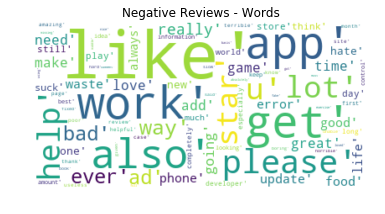

In [324]:
#Generating wordcloud for Negative, Neutral, and Positive words
negative = str(neg)
wordCloud = WordCloud(background_color="white").generate(negative)
plt.imshow(wordCloud, interpolation='bilinear')
plt.axis('off')
plt.title('Negative Reviews - Words')
plt.show()

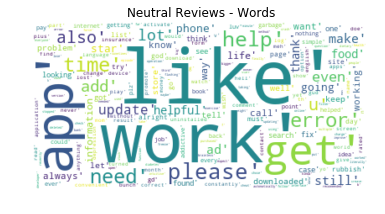

In [325]:
neutral = str(neut)
wordCloud = WordCloud(background_color="white").generate(neutral)
plt.imshow(wordCloud, interpolation='bilinear')
plt.axis('off')
plt.title('Neutral Reviews - Words')
plt.show()

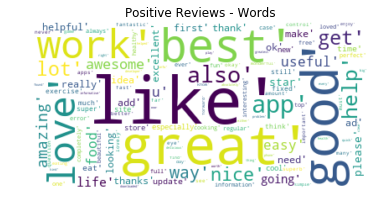

In [326]:
positive = str(pos)
wordCloud = WordCloud(background_color="white").generate(positive)
plt.imshow(wordCloud, interpolation='bilinear')
plt.axis('off')
plt.title('Positive Reviews - Words')
plt.show()

# LDA TOPIC

In [314]:
df2.head()

,App,Translated_Review,Sentiment
0,10 Best Foods for You,I like eat delicious food. That's I'm cooking ...,0
1,10 Best Foods for You,This help eating healthy exercise regular basis,0
2,10 Best Foods for You,Works great especially going grocery store,0
3,10 Best Foods for You,Best idea us,0
4,10 Best Foods for You,Best way,0


In [342]:
import pyLDAvis.gensim
from gensim import corpora
from gensim.models.ldamodel import LdaModel

In [345]:
from gensim import corpora
from gensim import models

# 어휘(vocabulary) 학습
dictionary = corpora.Dictionary(word_token)
corpus = [dictionary.doc2bow(text) for text in texts]
n_items = len(dictionary)

# TF 기준 term-document matrix
tfidf = models.TfidfModel(corpus)

# corpus = TF-IDF 기준 term-document matrix
corpus2 = tfidf[corpus]

In [ ]:
NUM_TOPICS = 30   # 토픽 개수 생성

model = models.ldamodel.LdaModel(corpus2, num_topics=NUM_TOPICS, id2word=dictionary)   # 토픽모델 = LDA

In [355]:
NUM_TOPICS = 10   # 토픽 개수 생성

model = models.ldamodel.LdaModel(corpus2, num_topics=NUM_TOPICS, id2word=dictionary)   # 토픽모델 = LDA

In [347]:
model.show_topic(5, 30)

[('thanks', 0.022636032),
 ('book', 0.017766997),
 ('data', 0.01659431),
 ('google', 0.012907354),
 ('permission', 0.00968963),
 ('else', 0.009359853),
 ('decent', 0.009231096),
 ('recipe', 0.009133933),
 ('except', 0.008844045),
 ('happened', 0.007633943),
 ('min', 0.0075882627),
 ('see', 0.0075039784),
 ('meet', 0.0074051684),
 ('cheaper', 0.0072156917),
 ('discount', 0.0071279),
 ('app', 0.007079697),
 ('map', 0.0070692454),
 ('good', 0.0070286705),
 ('like', 0.0067674294),
 ('alright', 0.006764632),
 ('find', 0.006589068),
 ('someone', 0.0064769415),
 ('child', 0.006295981),
 ('scroll', 0.0062632486),
 ('go', 0.00613968),
 ('maybe', 0.00606772),
 ('great', 0.0059183333),
 ('part', 0.0056972555),
 ('person', 0.0056397724),
 ('phone', 0.005608155)]

In [348]:
model.show_topic(0, 30)

[('booking', 0.048783176),
 ('crash', 0.035771616),
 ('word', 0.03374038),
 ('payment', 0.02738609),
 ('balance', 0.024840903),
 ('download', 0.024516484),
 ('latest', 0.023219189),
 ('spending', 0.019116309),
 ('informative', 0.018147714),
 ('confusing', 0.01765775),
 ('ability', 0.0173224),
 ('check', 0.016240774),
 ('history', 0.016205933),
 ('freeze', 0.01611067),
 ('noticed', 0.015916405),
 ('running', 0.014392426),
 ('bank', 0.013768978),
 ('watching', 0.012329539),
 ('frequently', 0.011629612),
 ('constantly', 0.010640724),
 ('continue', 0.009430063),
 ('appreciate', 0.008938179),
 ('clear', 0.008730397),
 ('miss', 0.008592317),
 ('dog', 0.0076421415),
 ('update', 0.007622796),
 ('checking', 0.007451567),
 ('glitchy', 0.0071797003),
 ('minute', 0.0066352),
 ('reminds', 0.0066213524)]

In [349]:
def print_document_topics(model, corpus):
    """주어진 토픽 모델링 결과와 문서 어휘 행렬에서 문서별 토픽 분포를 출력한다."""
    
    for doc_num, doc in enumerate(corpus):
        topic_probs = model[doc]
        print("Doc num: {}".format(doc_num))

        for topic_id, prob in topic_probs:
            print("\t{}\t{}".format(topic_id, prob))
            
        # break

        print("\n")   
        
print_document_topics(model, corpus2)

Doc num: 0
	4	0.10988547652959824
	21	0.4721851646900177
	25	0.17547720670700073


Doc num: 1
	3	0.37083926796913147
	15	0.15376168489456177
	26	0.21083539724349976


Doc num: 2
	0	0.010111642070114613
	1	0.010111642070114613
	2	0.010111642070114613
	3	0.010111642070114613
	4	0.010111642070114613
	5	0.010111642070114613
	6	0.010111642070114613
	7	0.010111642070114613
	8	0.010111642070114613
	9	0.010111642070114613
	10	0.010111642070114613
	11	0.010111642070114613
	12	0.010111642070114613
	13	0.010111642070114613
	14	0.010111642070114613
	15	0.010111642070114613
	16	0.010111642070114613
	17	0.010111642070114613
	18	0.010111642070114613
	19	0.010111642070114613
	20	0.010111642070114613
	21	0.7067623734474182
	22	0.010111642070114613
	23	0.010111642070114613
	24	0.010111642070114613
	25	0.010111642070114613
	26	0.010111642070114613
	27	0.010111642070114613
	28	0.010111642070114613
	29	0.010111642070114613


Doc num: 3
	0	0.0123208062723279
	1	0.0123208062723279
	2	0.0123208062723279
	3	0.

	24	0.012460625730454922
	25	0.012460625730454922
	26	0.012460625730454922
	27	0.3411250710487366
	28	0.012460625730454922
	29	0.012460625730454922


Doc num: 50
	0	0.011360768228769302
	1	0.18767549097537994
	2	0.011360768228769302
	3	0.011360768228769302
	4	0.011360768228769302
	5	0.011360768228769302
	6	0.011360768228769302
	7	0.011360768228769302
	8	0.011360768228769302
	9	0.011360768228769302
	10	0.011360768228769302
	11	0.011360768228769302
	12	0.011360768228769302
	13	0.011360768228769302
	14	0.011360768228769302
	15	0.011360768228769302
	16	0.011360768228769302
	17	0.011360768228769302
	18	0.011360768228769302
	19	0.011360768228769302
	20	0.011360768228769302
	21	0.4942229688167572
	22	0.011360768228769302
	23	0.011360768228769302
	24	0.011360768228769302
	25	0.011360768228769302
	26	0.011360768228769302
	27	0.011360768228769302
	28	0.011360768228769302
	29	0.011360768228769302


Doc num: 51
	0	0.011163412593305111
	1	0.011163412593305111
	2	0.011163412593305111
	3	0.0111634125

	17	0.014597803354263306
	18	0.014597803354263306
	19	0.014597803354263306
	20	0.014597803354263306
	21	0.014597803354263306
	22	0.014597803354263306
	23	0.014597803354263306
	24	0.014597803354263306
	25	0.014597803354263306
	26	0.014597803354263306
	27	0.014597803354263306
	28	0.014597803354263306
	29	0.014597803354263306


Doc num: 83
	0	0.35093215107917786
	1	0.022381650283932686
	2	0.022381650283932686
	3	0.022381650283932686
	4	0.022381650283932686
	5	0.022381650283932686
	6	0.022381650283932686
	7	0.022381650283932686
	8	0.022381650283932686
	9	0.022381650283932686
	10	0.022381650283932686
	11	0.022381650283932686
	12	0.022381650283932686
	13	0.022381650283932686
	14	0.022381650283932686
	15	0.022381650283932686
	16	0.022381650283932686
	17	0.022381650283932686
	18	0.022381650283932686
	19	0.022381650283932686
	20	0.022381650283932686
	21	0.022381650283932686
	22	0.022381650283932686
	23	0.022381650283932686
	24	0.022381650283932686
	25	0.022381650283932686
	26	0.0223816502839326

	7	0.016666676849126816
	8	0.016666676849126816
	9	0.016666676849126816
	10	0.016666676849126816
	11	0.016666676849126816
	12	0.016666676849126816
	13	0.016666676849126816
	14	0.016666676849126816
	15	0.016666676849126816
	16	0.016666676849126816
	17	0.016666676849126816
	18	0.016666676849126816
	19	0.016666676849126816
	20	0.016666676849126816
	21	0.016666676849126816
	22	0.016666676849126816
	23	0.016666676849126816
	24	0.016666676849126816
	25	0.016666676849126816
	26	0.016666676849126816
	27	0.016666676849126816
	28	0.016666676849126816
	29	0.016666676849126816


Doc num: 125
	5	0.750615656375885


Doc num: 126
	0	0.012513875961303711
	1	0.012513875961303711
	2	0.012513875961303711
	3	0.012513875961303711
	4	0.012513875961303711
	5	0.5104931592941284
	6	0.012513875961303711
	7	0.012513875961303711
	8	0.012513875961303711
	9	0.012513875961303711
	10	0.012513875961303711
	11	0.012513875961303711
	12	0.012513875961303711
	13	0.012513875961303711
	14	0.012513875961303711
	15	0.01251387

	24	0.012360836379230022
	25	0.012360836379230022
	26	0.012360836379230022
	27	0.012360836379230022
	28	0.012360836379230022
	29	0.012360836379230022


Doc num: 160
	0	0.010833023115992546
	1	0.010833023115992546
	2	0.010833023115992546
	3	0.010833023115992546
	4	0.010833023115992546
	5	0.010833023115992546
	6	0.010833023115992546
	7	0.010833023115992546
	8	0.010833023115992546
	9	0.010833023115992546
	10	0.010833023115992546
	11	0.010833023115992546
	12	0.010833023115992546
	13	0.010833023115992546
	14	0.010833023115992546
	15	0.010833023115992546
	16	0.12716691195964813
	17	0.010833023115992546
	18	0.010833023115992546
	19	0.010833023115992546
	20	0.010833023115992546
	21	0.27950215339660645
	22	0.010833023115992546
	23	0.010833023115992546
	24	0.010833023115992546
	25	0.010833023115992546
	26	0.010833023115992546
	27	0.010833023115992546
	28	0.010833023115992546
	29	0.3008393347263336


Doc num: 161
	0	0.016666999086737633
	1	0.016666999086737633
	2	0.016666999086737633
	3	0.0166669

	15	0.287324458360672
	16	0.016991427168250084
	17	0.016991427168250084
	18	0.016991427168250084
	19	0.016991427168250084
	20	0.016991427168250084
	21	0.016991427168250084
	22	0.016991427168250084
	23	0.016991427168250084
	24	0.016991427168250084
	25	0.016991427168250084
	26	0.016991427168250084
	27	0.016991427168250084
	28	0.016991427168250084
	29	0.016991427168250084


Doc num: 200
	0	0.010364962741732597
	1	0.010364962741732597
	2	0.010364962741732597
	3	0.010364962741732597
	4	0.010364962741732597
	5	0.010364962741732597
	6	0.010364962741732597
	7	0.010364962741732597
	8	0.010364962741732597
	9	0.010364962741732597
	10	0.010364962741732597
	11	0.010364962741732597
	12	0.010364962741732597
	13	0.010364962741732597
	14	0.1335742175579071
	15	0.010364962741732597
	16	0.010364962741732597
	17	0.010364962741732597
	18	0.5762068033218384
	19	0.010364962741732597
	20	0.010364962741732597
	21	0.010364962741732597
	22	0.010364962741732597
	23	0.010364962741732597
	24	0.010364962741732597
	2

	15	0.010035387240350246
	16	0.010035387240350246
	17	0.010035387240350246
	18	0.010035387240350246
	19	0.010035387240350246
	20	0.010035387240350246
	21	0.010035387240350246
	22	0.010035387240350246
	23	0.010035387240350246
	24	0.010035387240350246
	25	0.5819627046585083
	26	0.13704641163349152
	27	0.010035387240350246
	28	0.010035387240350246
	29	0.010035387240350246


Doc num: 238
	19	0.11523960530757904
	27	0.636074423789978


Doc num: 239
	0	0.013874565251171589
	1	0.013874565251171589
	2	0.013874565251171589
	3	0.013874565251171589
	4	0.013874565251171589
	5	0.013874565251171589
	6	0.013874565251171589
	7	0.013874565251171589
	8	0.013874565251171589
	9	0.013874565251171589
	10	0.013874565251171589
	11	0.013874565251171589
	12	0.013874565251171589
	13	0.013874565251171589
	14	0.013874565251171589
	15	0.013874565251171589
	16	0.013874565251171589
	17	0.21326375007629395
	18	0.013874565251171589
	19	0.3982483744621277
	20	0.013874565251171589
	21	0.013874565251171589
	22	0.013874565

Doc num: 285
	0	0.013862374238669872
	1	0.013862374238669872
	2	0.013862374238669872
	3	0.013862374238669872
	4	0.013862374238669872
	5	0.013862374238669872
	6	0.013862374238669872
	7	0.013862374238669872
	8	0.013862374238669872
	9	0.013862374238669872
	10	0.013862374238669872
	11	0.013862374238669872
	12	0.013862374238669872
	13	0.013862374238669872
	14	0.013862374238669872
	15	0.013862374238669872
	16	0.013862374238669872
	17	0.013862374238669872
	18	0.013862374238669872
	19	0.013862374238669872
	20	0.013862374238669872
	21	0.013862374238669872
	22	0.013862374238669872
	23	0.013862374238669872
	24	0.5979911684989929
	25	0.013862374238669872
	26	0.013862374238669872
	27	0.013862374238669872
	28	0.013862374238669872
	29	0.013862374238669872


Doc num: 286
	0	0.010897316038608551
	1	0.010897316038608551
	2	0.010897316038608551
	3	0.010897316038608551
	4	0.6839778423309326
	5	0.010897316038608551
	6	0.010897316038608551
	7	0.010897316038608551
	8	0.010897316038608551
	9	0.010897316038608

	18	0.016666695475578308
	19	0.016666695475578308
	20	0.016666695475578308
	21	0.016666695475578308
	22	0.016666695475578308
	23	0.016666695475578308
	24	0.016666695475578308
	25	0.016666695475578308
	26	0.016666695475578308
	27	0.016666695475578308
	28	0.016666695475578308
	29	0.016666695475578308


Doc num: 331
	0	0.016666704788804054
	1	0.016666704788804054
	2	0.016666704788804054
	3	0.016666704788804054
	4	0.016666704788804054
	5	0.016666704788804054
	6	0.016666704788804054
	7	0.016666704788804054
	8	0.016666704788804054
	9	0.016666704788804054
	10	0.016666704788804054
	11	0.016666704788804054
	12	0.016666704788804054
	13	0.016666704788804054
	14	0.016666704788804054
	15	0.016666704788804054
	16	0.016666704788804054
	17	0.016666704788804054
	18	0.016666704788804054
	19	0.016666704788804054
	20	0.016666704788804054
	21	0.016666704788804054
	22	0.016666704788804054
	23	0.016666704788804054
	24	0.5166655778884888
	25	0.016666704788804054
	26	0.016666704788804054
	27	0.0166667047888040

	25	0.014659268781542778
	26	0.014659268781542778
	27	0.014659268781542778
	28	0.014659268781542778
	29	0.014659268781542778


Doc num: 373
	0	0.016667598858475685
	1	0.016667598858475685
	2	0.016667598858475685
	3	0.016667598858475685
	4	0.016667598858475685
	5	0.016667598858475685
	6	0.016667598858475685
	7	0.016667598858475685
	8	0.016667598858475685
	9	0.016667598858475685
	10	0.016667598858475685
	11	0.016667598858475685
	12	0.016667598858475685
	13	0.016667598858475685
	14	0.016667598858475685
	15	0.016667598858475685
	16	0.016667598858475685
	17	0.016667598858475685
	18	0.016667598858475685
	19	0.016667598858475685
	20	0.016667598858475685
	21	0.016667598858475685
	22	0.016667598858475685
	23	0.016667598858475685
	24	0.016667598858475685
	25	0.016667598858475685
	26	0.016667598858475685
	27	0.016667598858475685
	28	0.5166396498680115
	29	0.016667598858475685


Doc num: 374
	0	0.016666721552610397
	1	0.016666721552610397
	2	0.016666721552610397
	3	0.016666721552610397
	4	0.516665

Doc num: 421
	8	0.28777655959129333
	23	0.2473672479391098
	29	0.23813468217849731


Doc num: 422
	0	0.01755707897245884
	1	0.01755707897245884
	2	0.01755707897245884
	3	0.01755707897245884
	4	0.01755707897245884
	5	0.01755707897245884
	6	0.01755707897245884
	7	0.01755707897245884
	8	0.01755707897245884
	9	0.01755707897245884
	10	0.01755707897245884
	11	0.01755707897245884
	12	0.01755707897245884
	13	0.01755707897245884
	14	0.01755707897245884
	15	0.01755707897245884
	16	0.01755707897245884
	17	0.01755707897245884
	18	0.01755707897245884
	19	0.01755707897245884
	20	0.01755707897245884
	21	0.01755707897245884
	22	0.01755707897245884
	23	0.01755707897245884
	24	0.01755707897245884
	25	0.01755707897245884
	26	0.01755707897245884
	27	0.01755707897245884
	28	0.01755707897245884
	29	0.4908446669578552


Doc num: 423
	11	0.07258820533752441
	25	0.6769629120826721


Doc num: 424
	4	0.3838745355606079
	8	0.2501862645149231
	15	0.07698551565408707
	29	0.07812241464853287


Doc num: 425
	24	0.048

Doc num: 493
	6	0.16883662343025208
	10	0.041647568345069885
	23	0.2231946587562561
	29	0.4099653661251068


Doc num: 494
	17	0.37608176469802856
	29	0.3684210777282715


Doc num: 495
	1	0.04581243917346001
	12	0.2036607265472412
	17	0.04852347448468208
	19	0.09581412374973297
	20	0.3279404640197754
	29	0.1289592832326889


Doc num: 496
	3	0.09817926585674286
	24	0.06014367938041687
	26	0.5037857890129089
	29	0.11281329393386841


Doc num: 497
	0	0.01133541576564312
	1	0.01133541576564312
	2	0.01133541576564312
	3	0.01133541576564312
	4	0.2282348871231079
	5	0.01133541576564312
	6	0.01133541576564312
	7	0.01133541576564312
	8	0.01133541576564312
	9	0.01133541576564312
	10	0.01133541576564312
	11	0.45437347888946533
	12	0.01133541576564312
	13	0.01133541576564312
	14	0.01133541576564312
	15	0.01133541576564312
	16	0.01133541576564312
	17	0.01133541576564312
	18	0.01133541576564312
	19	0.01133541576564312
	20	0.01133541576564312
	21	0.01133541576564312
	22	0.01133541576564312
	23	0.01133

	14	0.017750291153788567
	15	0.017750291153788567
	16	0.017750291153788567
	17	0.017750291153788567
	18	0.017750291153788567
	19	0.017750291153788567
	20	0.017750291153788567
	21	0.017750291153788567
	22	0.017750291153788567
	23	0.017750291153788567
	24	0.017750291153788567
	25	0.017750291153788567
	26	0.017750291153788567
	27	0.017750291153788567
	28	0.017750291153788567
	29	0.017750291153788567


Doc num: 552
	0	0.010096078738570213
	1	0.010096078738570213
	2	0.010096078738570213
	3	0.010096078738570213
	4	0.010096078738570213
	5	0.010096078738570213
	6	0.010096078738570213
	7	0.010096078738570213
	8	0.010096078738570213
	9	0.010096078738570213
	10	0.010096078738570213
	11	0.010096078738570213
	12	0.010096078738570213
	13	0.010096078738570213
	14	0.010096078738570213
	15	0.010096078738570213
	16	0.010096078738570213
	17	0.010096078738570213
	18	0.010096078738570213
	19	0.010096078738570213
	20	0.010096078738570213
	21	0.010096078738570213
	22	0.010096078738570213
	23	0.01009607873857

Doc num: 603
	0	0.016666697338223457
	1	0.016666697338223457
	2	0.016666697338223457
	3	0.016666697338223457
	4	0.016666697338223457
	5	0.016666697338223457
	6	0.016666697338223457
	7	0.016666697338223457
	8	0.016666697338223457
	9	0.016666697338223457
	10	0.016666697338223457
	11	0.016666697338223457
	12	0.016666697338223457
	13	0.016666697338223457
	14	0.016666697338223457
	15	0.016666697338223457
	16	0.016666697338223457
	17	0.016666697338223457
	18	0.016666697338223457
	19	0.016666697338223457
	20	0.016666697338223457
	21	0.016666697338223457
	22	0.016666697338223457
	23	0.016666697338223457
	24	0.016666697338223457
	25	0.016666697338223457
	26	0.016666697338223457
	27	0.5166657567024231
	28	0.016666697338223457
	29	0.016666697338223457


Doc num: 604
	0	0.016666676849126816
	1	0.5166663527488708
	2	0.016666676849126816
	3	0.016666676849126816
	4	0.016666676849126816
	5	0.016666676849126816
	6	0.016666676849126816
	7	0.016666676849126816
	8	0.016666676849126816
	9	0.016666676849126

Doc num: 662
	0	0.013359805569052696
	1	0.013359805569052696
	2	0.013359805569052696
	3	0.013359805569052696
	4	0.013359805569052696
	5	0.013359805569052696
	6	0.013359805569052696
	7	0.013359805569052696
	8	0.013359805569052696
	9	0.013359805569052696
	10	0.013359805569052696
	11	0.19436034560203552
	12	0.013359805569052696
	13	0.013359805569052696
	14	0.013359805569052696
	15	0.013359805569052696
	16	0.013359805569052696
	17	0.013359805569052696
	18	0.013359805569052696
	19	0.013359805569052696
	20	0.013359805569052696
	21	0.013359805569052696
	22	0.013359805569052696
	23	0.013359805569052696
	24	0.013359805569052696
	25	0.013359805569052696
	26	0.4315651059150696
	27	0.013359805569052696
	28	0.013359805569052696
	29	0.013359805569052696


Doc num: 663
	4	0.07898746430873871
	5	0.07632505148649216
	26	0.05642692372202873
	29	0.5875848531723022


Doc num: 664
	0	0.010651810094714165
	1	0.010651810094714165
	2	0.010651810094714165
	3	0.010651810094714165
	4	0.010651810094714165
	5	0.01

	18	0.011502704583108425
	19	0.011502704583108425
	20	0.20397205650806427
	21	0.011502704583108425
	22	0.011502704583108425
	23	0.011502704583108425
	24	0.011502704583108425
	25	0.011502704583108425
	26	0.011502704583108425
	27	0.011502704583108425
	28	0.2593395411968231
	29	0.011502704583108425


Doc num: 709
	12	0.1568455845117569
	15	0.4393787384033203
	29	0.1350041925907135


Doc num: 710
	0	0.012716690078377724
	1	0.012716690078377724
	2	0.012716690078377724
	3	0.012716690078377724
	4	0.2089158147573471
	5	0.012716690078377724
	6	0.012716690078377724
	7	0.012716690078377724
	8	0.012716690078377724
	9	0.012716690078377724
	10	0.012716690078377724
	11	0.012716690078377724
	12	0.012716690078377724
	13	0.012716690078377724
	14	0.012716690078377724
	15	0.012716690078377724
	16	0.012716690078377724
	17	0.012716690078377724
	18	0.012716690078377724
	19	0.012716690078377724
	20	0.012716690078377724
	21	0.012716690078377724
	22	0.012716690078377724
	23	0.012716690078377724
	24	0.0127166900

	24	0.012507149018347263
	25	0.012507149018347263
	26	0.012507149018347263
	27	0.6372926235198975
	28	0.012507149018347263
	29	0.012507149018347263


Doc num: 753
	13	0.1239890530705452
	20	0.310043603181839
	29	0.3886326551437378


Doc num: 754
	13	0.28296634554862976
	27	0.49531227350234985


Doc num: 755
	0	0.12526187300682068
	7	0.22589682042598724
	25	0.4095827341079712


Doc num: 756
	0	0.012253599241375923
	1	0.012253599241375923
	2	0.012253599241375923
	3	0.012253599241375923
	4	0.43710094690322876
	5	0.012253599241375923
	6	0.012253599241375923
	7	0.012253599241375923
	8	0.012253599241375923
	9	0.012253599241375923
	10	0.012253599241375923
	11	0.012253599241375923
	12	0.012253599241375923
	13	0.012253599241375923
	14	0.012253599241375923
	15	0.012253599241375923
	16	0.012253599241375923
	17	0.012253599241375923
	18	0.012253599241375923
	19	0.012253599241375923
	20	0.012253599241375923
	21	0.012253599241375923
	22	0.012253599241375923
	23	0.012253599241375923
	24	0.012253599241

Doc num: 836
	4	0.04514627158641815
	9	0.043933384120464325
	12	0.17908667027950287
	25	0.10504936426877975
	26	0.19874384999275208
	28	0.1098189428448677
	29	0.17929339408874512


Doc num: 837
	4	0.1339389979839325
	13	0.17324845492839813
	14	0.059444017708301544
	18	0.06071728095412254
	19	0.39213430881500244


Doc num: 838
	0	0.04113847017288208
	18	0.03486248478293419
	26	0.785693883895874


Doc num: 839
	4	0.06759622693061829
	11	0.07522085309028625
	17	0.6262639164924622
	28	0.06244312599301338


Doc num: 840
	2	0.09613485634326935
	4	0.05488984286785126
	11	0.11501169949769974
	12	0.05225246772170067
	13	0.07594967633485794
	20	0.4206322133541107


Doc num: 841
	3	0.07932731509208679
	22	0.34549400210380554
	29	0.3883917033672333


Doc num: 842
	3	0.13582774996757507
	8	0.17756083607673645
	19	0.06104253977537155
	27	0.05996820330619812
	28	0.32215821743011475
	29	0.09260014444589615


Doc num: 843
	4	0.12067330628633499
	25	0.1281317174434662
	29	0.5753692984580994


Doc num: 8

	2	0.045767150819301605
	8	0.04655782878398895
	24	0.0455496571958065
	26	0.05481334403157234
	29	0.6567336916923523


Doc num: 948
	0	0.14607077836990356
	18	0.05326857045292854
	25	0.16926249861717224
	27	0.2142205536365509
	29	0.2471369355916977


Doc num: 949
	0	0.011165802367031574
	1	0.011165802367031574
	2	0.011165802367031574
	3	0.011165802367031574
	4	0.011165802367031574
	5	0.011165802367031574
	6	0.011165802367031574
	7	0.011165802367031574
	8	0.011165802367031574
	9	0.011165802367031574
	10	0.011165802367031574
	11	0.011165802367031574
	12	0.011165802367031574
	13	0.011165802367031574
	14	0.011165802367031574
	15	0.011165802367031574
	16	0.011165802367031574
	17	0.011165802367031574
	18	0.011165802367031574
	19	0.011165802367031574
	20	0.011165802367031574
	21	0.24012982845306396
	22	0.011165802367031574
	23	0.011165802367031574
	24	0.011165802367031574
	25	0.011165802367031574
	26	0.011165802367031574
	27	0.36050036549568176
	28	0.06024297699332237
	29	0.048815976828336716

Doc num: 1040
	0	0.014450879767537117
	1	0.014450879767537117
	2	0.014450879767537117
	3	0.014450879767537117
	4	0.014450879767537117
	5	0.014450879767537117
	6	0.014450879767537117
	7	0.014450879767537117
	8	0.014450879767537117
	9	0.014450879767537117
	10	0.014450879767537117
	11	0.014450879767537117
	12	0.014450879767537117
	13	0.014450879767537117
	14	0.014450879767537117
	15	0.014450879767537117
	16	0.014450879767537117
	17	0.014450879767537117
	18	0.014450879767537117
	19	0.014450879767537117
	20	0.014450879767537117
	21	0.014450879767537117
	22	0.014450879767537117
	23	0.014450879767537117
	24	0.5809244513511658
	25	0.014450879767537117
	26	0.014450879767537117
	27	0.014450879767537117
	28	0.014450879767537117
	29	0.014450879767537117


Doc num: 1041
	7	0.31411314010620117
	12	0.4577387869358063
	24	0.0504036583006382


Doc num: 1042
	7	0.2479858696460724
	9	0.06051747873425484
	16	0.25922200083732605
	26	0.24763351678848267


Doc num: 1043
	0	0.013658128678798676
	1	0.013658128

	6	0.4422464370727539
	12	0.05607578158378601
	17	0.2828128933906555


Doc num: 1104
	13	0.14430536329746246
	16	0.06238202005624771
	17	0.07200109213590622
	21	0.13943921029567719
	25	0.40324947237968445


Doc num: 1105
	2	0.3468749523162842
	14	0.27279821038246155
	21	0.06807320564985275
	26	0.0573875866830349
	29	0.11301802098751068


Doc num: 1106
	5	0.047866616398096085
	8	0.16619953513145447
	10	0.051328111439943314
	21	0.07694927603006363
	25	0.4634695053100586


Doc num: 1107
	21	0.5957765579223633
	22	0.1776617020368576


Doc num: 1108
	26	0.7821041941642761


Doc num: 1109
	6	0.0185419712215662
	7	0.020828913897275925
	15	0.14650920033454895
	17	0.02407657727599144
	21	0.5236590504646301
	25	0.04479488730430603
	28	0.10765155404806137


Doc num: 1110
	2	0.09137614071369171
	4	0.14450861513614655
	5	0.44887709617614746
	7	0.09179603308439255


Doc num: 1111
	21	0.22377245128154755
	28	0.3963337540626526
	29	0.13427594304084778


Doc num: 1112
	6	0.6366990804672241
	7	0.1193750

	4	0.011658013798296452
	5	0.011658013798296452
	6	0.011658013798296452
	7	0.011658013798296452
	8	0.011658013798296452
	9	0.011658013798296452
	10	0.011658013798296452
	11	0.011658013798296452
	12	0.011658013798296452
	13	0.011658013798296452
	14	0.6619176268577576
	15	0.011658013798296452
	16	0.011658013798296452
	17	0.011658013798296452
	18	0.011658013798296452
	19	0.011658013798296452
	20	0.011658013798296452
	21	0.011658013798296452
	22	0.011658013798296452
	23	0.011658013798296452
	24	0.011658013798296452
	25	0.011658013798296452
	26	0.011658013798296452
	27	0.011658013798296452
	28	0.011658013798296452
	29	0.011658013798296452


Doc num: 1227
	0	0.013625881634652615
	1	0.013625881634652615
	2	0.013625881634652615
	3	0.013625881634652615
	4	0.013625881634652615
	5	0.013625881634652615
	6	0.013625881634652615
	7	0.013625881634652615
	8	0.013625881634652615
	9	0.013625881634652615
	10	0.013625881634652615
	11	0.013625881634652615
	12	0.013625881634652615
	13	0.013625881634652615
	1

Doc num: 1284
	1	0.5638265013694763
	22	0.09427773952484131
	29	0.12468107044696808


Doc num: 1285
	0	0.012105188332498074
	1	0.26640719175338745
	2	0.012105188332498074
	3	0.012105188332498074
	4	0.012105188332498074
	5	0.012105188332498074
	6	0.012105188332498074
	7	0.012105188332498074
	8	0.012105188332498074
	9	0.012105188332498074
	10	0.012105188332498074
	11	0.012105188332498074
	12	0.012105188332498074
	13	0.012105188332498074
	14	0.012105188332498074
	15	0.012105188332498074
	16	0.012105188332498074
	17	0.012105188332498074
	18	0.14955158531665802
	19	0.012105188332498074
	20	0.012105188332498074
	21	0.012105188332498074
	22	0.2572011351585388
	23	0.012105188332498074
	24	0.012105188332498074
	25	0.012105188332498074
	26	0.012105188332498074
	27	0.012105188332498074
	28	0.012105188332498074
	29	0.012105188332498074


Doc num: 1286
	0	0.012606456875801086
	1	0.012606456875801086
	2	0.012606456875801086
	3	0.012606456875801086
	4	0.012606456875801086
	5	0.012606456875801086
	6	0

	19	0.015821781009435654
	20	0.015821781009435654
	21	0.015821781009435654
	22	0.015821781009435654
	23	0.015821781009435654
	24	0.31060007214546204
	25	0.015821781009435654
	26	0.015821781009435654
	27	0.015821781009435654
	28	0.24639002978801727
	29	0.015821781009435654


Doc num: 1349
	0	0.021464208140969276
	1	0.021464208140969276
	2	0.021464208140969276
	3	0.021464208140969276
	4	0.021464208140969276
	5	0.021464208140969276
	6	0.021464208140969276
	7	0.021464208140969276
	8	0.021464208140969276
	9	0.021464208140969276
	10	0.021464208140969276
	11	0.021464208140969276
	12	0.021464208140969276
	13	0.021464208140969276
	14	0.021464208140969276
	15	0.021464208140969276
	16	0.021464208140969276
	17	0.021464208140969276
	18	0.021464208140969276
	19	0.021464208140969276
	20	0.021464208140969276
	21	0.021464208140969276
	22	0.021464208140969276
	23	0.021464208140969276
	24	0.021464208140969276
	25	0.021464208140969276
	26	0.021464208140969276
	27	0.021464208140969276
	28	0.021464208140969

	19	0.01250228937715292
	20	0.01250228937715292
	21	0.01250228937715292
	22	0.01250228937715292
	23	0.01250228937715292
	24	0.01250228937715292
	25	0.6374335885047913
	26	0.01250228937715292
	27	0.01250228937715292
	28	0.01250228937715292
	29	0.01250228937715292


Doc num: 1397
	7	0.14318057894706726
	16	0.0996033176779747
	17	0.07852599024772644
	18	0.35305896401405334
	19	0.08455189317464828


Doc num: 1398
	0	0.010683907195925713
	1	0.010683907195925713
	2	0.010683907195925713
	3	0.010683907195925713
	4	0.010683907195925713
	5	0.010683907195925713
	6	0.010683907195925713
	7	0.3162495791912079
	8	0.010683907195925713
	9	0.010683907195925713
	10	0.010683907195925713
	11	0.010683907195925713
	12	0.010683907195925713
	13	0.010683907195925713
	14	0.010683907195925713
	15	0.010683907195925713
	16	0.010683907195925713
	17	0.010683907195925713
	18	0.010683907195925713
	19	0.010683907195925713
	20	0.010683907195925713
	21	0.010683907195925713
	22	0.010683907195925713
	23	0.010683907195925713

	20	0.011557459831237793
	21	0.011557459831237793
	22	0.011557459831237793
	23	0.011557459831237793
	24	0.011557459831237793
	25	0.011557459831237793
	26	0.011557459831237793
	27	0.011557459831237793
	28	0.011557459831237793
	29	0.011557459831237793


Doc num: 1440
	0	0.011328884400427341
	1	0.011328884400427341
	2	0.011328884400427341
	3	0.011328884400427341
	4	0.011328884400427341
	5	0.011328884400427341
	6	0.011328884400427341
	7	0.011328884400427341
	8	0.011328884400427341
	9	0.011328884400427341
	10	0.17906463146209717
	11	0.2174813449382782
	12	0.011328884400427341
	13	0.011328884400427341
	14	0.011328884400427341
	15	0.011328884400427341
	16	0.011328884400427341
	17	0.011328884400427341
	18	0.011328884400427341
	19	0.011328884400427341
	20	0.011328884400427341
	21	0.011328884400427341
	22	0.011328884400427341
	23	0.011328884400427341
	24	0.011328884400427341
	25	0.011328884400427341
	26	0.011328884400427341
	27	0.011328884400427341
	28	0.011328884400427341
	29	0.2975741028785705

	18	0.01666668802499771
	19	0.01666668802499771
	20	0.01666668802499771
	21	0.01666668802499771
	22	0.01666668802499771
	23	0.01666668802499771
	24	0.01666668802499771
	25	0.01666668802499771
	26	0.01666668802499771
	27	0.01666668802499771
	28	0.01666668802499771
	29	0.01666668802499771


Doc num: 1483
	0	0.01403087843209505
	1	0.01403087843209505
	2	0.01403087843209505
	3	0.01403087843209505
	4	0.01403087843209505
	5	0.01403087843209505
	6	0.01403087843209505
	7	0.01403087843209505
	8	0.01403087843209505
	9	0.01403087843209505
	10	0.01403087843209505
	11	0.01403087843209505
	12	0.01403087843209505
	13	0.01403087843209505
	14	0.01403087843209505
	15	0.01403087843209505
	16	0.23461595177650452
	17	0.01403087843209505
	18	0.01403087843209505
	19	0.01403087843209505
	20	0.01403087843209505
	21	0.01403087843209505
	22	0.01403087843209505
	23	0.01403087843209505
	24	0.01403087843209505
	25	0.01403087843209505
	26	0.01403087843209505
	27	0.37251943349838257
	28	0.01403087843209505
	29	0.0140

	19	0.026424532756209373
	20	0.026424532756209373
	21	0.026424532756209373
	22	0.026424532756209373
	23	0.026424532756209373
	24	0.026424532756209373
	25	0.026424532756209373
	26	0.026424532756209373
	27	0.026424532756209373
	28	0.026424532756209373
	29	0.026424532756209373


Doc num: 1516
	0	0.015706581994891167
	1	0.015706581994891167
	2	0.015706581994891167
	3	0.015706581994891167
	4	0.015706581994891167
	5	0.015706581994891167
	6	0.015706581994891167
	7	0.015706581994891167
	8	0.015706581994891167
	9	0.015706581994891167
	10	0.015706581994891167
	11	0.015706581994891167
	12	0.015706581994891167
	13	0.015706581994891167
	14	0.2784819006919861
	15	0.015706581994891167
	16	0.015706581994891167
	17	0.015706581994891167
	18	0.2817338705062866
	19	0.015706581994891167
	20	0.015706581994891167
	21	0.015706581994891167
	22	0.015706581994891167
	23	0.015706581994891167
	24	0.015706581994891167
	25	0.015706581994891167
	26	0.015706581994891167
	27	0.015706581994891167
	28	0.01570658199489116

Doc num: 1586
	0	0.014366169460117817
	1	0.014366169460117817
	2	0.20377248525619507
	3	0.014366169460117817
	4	0.014366169460117817
	5	0.014366169460117817
	6	0.014366169460117817
	7	0.014366169460117817
	8	0.014366169460117817
	9	0.014366169460117817
	10	0.16687019169330597
	11	0.014366169460117817
	12	0.014366169460117817
	13	0.014366169460117817
	14	0.014366169460117817
	15	0.014366169460117817
	16	0.014366169460117817
	17	0.014366169460117817
	18	0.014366169460117817
	19	0.014366169460117817
	20	0.014366169460117817
	21	0.014366169460117817
	22	0.014366169460117817
	23	0.014366169460117817
	24	0.24147072434425354
	25	0.014366169460117817
	26	0.014366169460117817
	27	0.014366169460117817
	28	0.014366169460117817
	29	0.014366169460117817


Doc num: 1587
	0	0.015027778223156929
	1	0.015027778223156929
	2	0.015027778223156929
	3	0.015027778223156929
	4	0.015027778223156929
	5	0.015027778223156929
	6	0.015027778223156929
	7	0.015027778223156929
	8	0.015027778223156929
	9	0.015027778223

	27	0.03333333507180214
	28	0.03333333507180214
	29	0.03333333507180214


Doc num: 1633
	0	0.03333333507180214
	1	0.03333333507180214
	2	0.03333333507180214
	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214
	6	0.03333333507180214
	7	0.03333333507180214
	8	0.03333333507180214
	9	0.03333333507180214
	10	0.03333333507180214
	11	0.03333333507180214
	12	0.03333333507180214
	13	0.03333333507180214
	14	0.03333333507180214
	15	0.03333333507180214
	16	0.03333333507180214
	17	0.03333333507180214
	18	0.03333333507180214
	19	0.03333333507180214
	20	0.03333333507180214
	21	0.03333333507180214
	22	0.03333333507180214
	23	0.03333333507180214
	24	0.03333333507180214
	25	0.03333333507180214
	26	0.03333333507180214
	27	0.03333333507180214
	28	0.03333333507180214
	29	0.03333333507180214


Doc num: 1634
	0	0.03333333507180214
	1	0.03333333507180214
	2	0.03333333507180214
	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214
	6	0.03333333507180214
	7	0.03333333507180214
	8

Doc num: 1708
	14	0.43932223320007324
	15	0.09235856682062149
	20	0.23730556666851044


Doc num: 1709
	0	0.013770059682428837
	1	0.18017764389514923
	2	0.013770059682428837
	3	0.013770059682428837
	4	0.013770059682428837
	5	0.013770059682428837
	6	0.013770059682428837
	7	0.013770059682428837
	8	0.013770059682428837
	9	0.013770059682428837
	10	0.013770059682428837
	11	0.013770059682428837
	12	0.013770059682428837
	13	0.013770059682428837
	14	0.013770059682428837
	15	0.013770059682428837
	16	0.2750121057033539
	17	0.013770059682428837
	18	0.013770059682428837
	19	0.013770059682428837
	20	0.013770059682428837
	21	0.013770059682428837
	22	0.17301860451698303
	23	0.013770059682428837
	24	0.013770059682428837
	25	0.013770059682428837
	26	0.013770059682428837
	27	0.013770059682428837
	28	0.013770059682428837
	29	0.013770059682428837


Doc num: 1710
	0	0.013991646468639374
	1	0.013991646468639374
	2	0.013991646468639374
	3	0.013991646468639374
	4	0.013991646468639374
	5	0.33819544315338135
	6	

	6	0.015385746955871582
	7	0.015385746955871582
	8	0.015385746955871582
	9	0.015385746955871582
	10	0.015385746955871582
	11	0.015385746955871582
	12	0.015385746955871582
	13	0.015385746955871582
	14	0.015385746955871582
	15	0.015385746955871582
	16	0.015385746955871582
	17	0.015385746955871582
	18	0.015385746955871582
	19	0.015385746955871582
	20	0.015385746955871582
	21	0.015385746955871582
	22	0.015385746955871582
	23	0.015385746955871582
	24	0.015385746955871582
	25	0.015385746955871582
	26	0.1974697709083557
	27	0.015385746955871582
	28	0.015385746955871582
	29	0.015385746955871582


Doc num: 1757
	0	0.03333333507180214
	1	0.03333333507180214
	2	0.03333333507180214
	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214
	6	0.03333333507180214
	7	0.03333333507180214
	8	0.03333333507180214
	9	0.03333333507180214
	10	0.03333333507180214
	11	0.03333333507180214
	12	0.03333333507180214
	13	0.03333333507180214
	14	0.03333333507180214
	15	0.03333333507180214
	16	0.0333333350

	5	0.010371586307883263
	6	0.010371586307883263
	7	0.010371586307883263
	8	0.010371586307883263
	9	0.010371586307883263
	10	0.010371586307883263
	11	0.010371586307883263
	12	0.010371586307883263
	13	0.010371586307883263
	14	0.010371586307883263
	15	0.010371586307883263
	16	0.010371586307883263
	17	0.010371586307883263
	18	0.1830301135778427
	19	0.010371586307883263
	20	0.277915894985199
	21	0.010371586307883263
	22	0.010371586307883263
	23	0.25902116298675537
	24	0.010371586307883263
	25	0.010371586307883263
	26	0.010371586307883263
	27	0.010371586307883263
	28	0.010371586307883263
	29	0.010371586307883263


Doc num: 1826
	0	0.014014237560331821
	1	0.014014237560331821
	2	0.014014237560331821
	3	0.014014237560331821
	4	0.014014237560331821
	5	0.014014237560331821
	6	0.014014237560331821
	7	0.014014237560331821
	8	0.014014237560331821
	9	0.014014237560331821
	10	0.014014237560331821
	11	0.014014237560331821
	12	0.014014237560331821
	13	0.014014237560331821
	14	0.014014237560331821
	15	0



Doc num: 1887
	0	0.016666676849126816
	1	0.5166663527488708
	2	0.016666676849126816
	3	0.016666676849126816
	4	0.016666676849126816
	5	0.016666676849126816
	6	0.016666676849126816
	7	0.016666676849126816
	8	0.016666676849126816
	9	0.016666676849126816
	10	0.016666676849126816
	11	0.016666676849126816
	12	0.016666676849126816
	13	0.016666676849126816
	14	0.016666676849126816
	15	0.016666676849126816
	16	0.016666676849126816
	17	0.016666676849126816
	18	0.016666676849126816
	19	0.016666676849126816
	20	0.016666676849126816
	21	0.016666676849126816
	22	0.016666676849126816
	23	0.016666676849126816
	24	0.016666676849126816
	25	0.016666676849126816
	26	0.016666676849126816
	27	0.016666676849126816
	28	0.016666676849126816
	29	0.016666676849126816


Doc num: 1888
	0	0.03333333507180214
	1	0.03333333507180214
	2	0.03333333507180214
	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214
	6	0.03333333507180214
	7	0.03333333507180214
	8	0.03333333507180214
	9	0.03333333507180214


	28	0.012164339423179626
	29	0.012164339423179626


Doc num: 1940
	0	0.01231315452605486
	1	0.01231315452605486
	2	0.01231315452605486
	3	0.2664181590080261
	4	0.01231315452605486
	5	0.01231315452605486
	6	0.01231315452605486
	7	0.1640091836452484
	8	0.01231315452605486
	9	0.01231315452605486
	10	0.01231315452605486
	11	0.01231315452605486
	12	0.01231315452605486
	13	0.01231315452605486
	14	0.01231315452605486
	15	0.01231315452605486
	16	0.01231315452605486
	17	0.01231315452605486
	18	0.01231315452605486
	19	0.01231315452605486
	20	0.01231315452605486
	21	0.01231315452605486
	22	0.01231315452605486
	23	0.01231315452605486
	24	0.23711749911308289
	25	0.01231315452605486
	26	0.01231315452605486
	27	0.01231315452605486
	28	0.01231315452605486
	29	0.01231315452605486


Doc num: 1941
	0	0.01411791704595089
	1	0.01411791704595089
	2	0.01411791704595089
	3	0.01411791704595089
	4	0.01411791704595089
	5	0.01411791704595089
	6	0.01411791704595089
	7	0.01411791704595089
	8	0.01411791704595089
	9	

	23	0.022375674918293953
	24	0.022375674918293953
	25	0.022375674918293953
	26	0.022375674918293953
	27	0.022375674918293953
	28	0.022375674918293953
	29	0.022375674918293953


Doc num: 1974
	0	0.016666684299707413
	1	0.016666684299707413
	2	0.016666684299707413
	3	0.016666684299707413
	4	0.016666684299707413
	5	0.016666684299707413
	6	0.016666684299707413
	7	0.016666684299707413
	8	0.016666684299707413
	9	0.016666684299707413
	10	0.016666684299707413
	11	0.016666684299707413
	12	0.016666684299707413
	13	0.016666684299707413
	14	0.016666684299707413
	15	0.016666684299707413
	16	0.5166661739349365
	17	0.016666684299707413
	18	0.016666684299707413
	19	0.016666684299707413
	20	0.016666684299707413
	21	0.016666684299707413
	22	0.016666684299707413
	23	0.016666684299707413
	24	0.016666684299707413
	25	0.016666684299707413
	26	0.016666684299707413
	27	0.016666684299707413
	28	0.016666684299707413
	29	0.016666684299707413


Doc num: 1975
	0	0.016666676849126816
	1	0.5166663527488708
	2	0.0166

	6	0.6488226652145386


Doc num: 2014
	5	0.3516923785209656
	22	0.13726545870304108
	25	0.06485533714294434
	29	0.23790572583675385


Doc num: 2015
	0	0.01003007497638464
	1	0.01003007497638464
	2	0.01003007497638464
	3	0.01003007497638464
	4	0.01003007497638464
	5	0.01003007497638464
	6	0.01003007497638464
	7	0.11437235027551651
	8	0.01003007497638464
	9	0.01003007497638464
	10	0.01003007497638464
	11	0.01003007497638464
	12	0.01003007497638464
	13	0.01003007497638464
	14	0.01003007497638464
	15	0.01003007497638464
	16	0.01003007497638464
	17	0.01003007497638464
	18	0.01003007497638464
	19	0.01003007497638464
	20	0.01003007497638464
	21	0.24902628362178802
	22	0.01003007497638464
	23	0.01003007497638464
	24	0.01003007497638464
	25	0.01003007497638464
	26	0.01003007497638464
	27	0.09626928716897964
	28	0.01003007497638464
	29	0.27955013513565063


Doc num: 2016
	0	0.01301634032279253
	1	0.01301634032279253
	2	0.01301634032279253
	3	0.01301634032279253
	4	0.01301634032279253
	5	0.013016

	13	0.010726598091423512
	14	0.010726598091423512
	15	0.010726598091423512
	16	0.010726598091423512
	17	0.010726598091423512
	18	0.010726598091423512
	19	0.010726598091423512
	20	0.010726598091423512
	21	0.11438065767288208
	22	0.010726598091423512
	23	0.010726598091423512
	24	0.010726598091423512
	25	0.010726598091423512
	26	0.010726598091423512
	27	0.5852746367454529
	28	0.010726598091423512
	29	0.010726598091423512


Doc num: 2066
	0	0.010889504104852676
	1	0.010889504104852676
	2	0.39963361620903015
	3	0.010889504104852676
	4	0.010889504104852676
	5	0.010889504104852676
	6	0.010889504104852676
	7	0.010889504104852676
	8	0.010889504104852676
	9	0.010889504104852676
	10	0.010889504104852676
	11	0.010889504104852676
	12	0.010889504104852676
	13	0.010889504104852676
	14	0.010889504104852676
	15	0.010889504104852676
	16	0.17173685133457184
	17	0.010889504104852676
	18	0.13461288809776306
	19	0.010889504104852676
	20	0.010889504104852676
	21	0.010889504104852676
	22	0.010889504104852676


	18	0.016666676849126816
	19	0.016666676849126816
	20	0.016666676849126816
	21	0.016666676849126816
	22	0.016666676849126816
	23	0.016666676849126816
	24	0.016666676849126816
	25	0.016666676849126816
	26	0.016666676849126816
	27	0.016666676849126816
	28	0.016666676849126816
	29	0.016666676849126816


Doc num: 2110
	0	0.016666676849126816
	1	0.5166663527488708
	2	0.016666676849126816
	3	0.016666676849126816
	4	0.016666676849126816
	5	0.016666676849126816
	6	0.016666676849126816
	7	0.016666676849126816
	8	0.016666676849126816
	9	0.016666676849126816
	10	0.016666676849126816
	11	0.016666676849126816
	12	0.016666676849126816
	13	0.016666676849126816
	14	0.016666676849126816
	15	0.016666676849126816
	16	0.016666676849126816
	17	0.016666676849126816
	18	0.016666676849126816
	19	0.016666676849126816
	20	0.016666676849126816
	21	0.016666676849126816
	22	0.016666676849126816
	23	0.016666676849126816
	24	0.016666676849126816
	25	0.016666676849126816
	26	0.016666676849126816
	27	0.016666676849126

	6	0.15469525754451752
	14	0.16430208086967468
	24	0.3710700571537018


Doc num: 2160
	0	0.012706955894827843
	1	0.012706955894827843
	2	0.012706955894827843
	3	0.012706955894827843
	4	0.012706955894827843
	5	0.012706955894827843
	6	0.012706955894827843
	7	0.012706955894827843
	8	0.012706955894827843
	9	0.012706955894827843
	10	0.2087436318397522
	11	0.012706955894827843
	12	0.012706955894827843
	13	0.012706955894827843
	14	0.012706955894827843
	15	0.012706955894827843
	16	0.012706955894827843
	17	0.012706955894827843
	18	0.012706955894827843
	19	0.012706955894827843
	20	0.012706955894827843
	21	0.012706955894827843
	22	0.012706955894827843
	23	0.012706955894827843
	24	0.012706955894827843
	25	0.012706955894827843
	26	0.4354616105556488
	27	0.012706955894827843
	28	0.012706955894827843
	29	0.012706955894827843


Doc num: 2161
	11	0.21987171471118927
	15	0.10559644550085068
	28	0.4263734519481659


Doc num: 2162
	0	0.014650139957666397
	1	0.014650139957666397
	2	0.014650139957666397
	3	

Doc num: 2226
	1	0.07692962884902954
	14	0.09647030383348465
	16	0.07448015362024307
	17	0.14921234548091888
	28	0.3691904842853546


Doc num: 2227
	0	0.011655383743345737
	1	0.011655383743345737
	2	0.011655383743345737
	3	0.011655383743345737
	4	0.011655383743345737
	5	0.011655383743345737
	6	0.011655383743345737
	7	0.011655383743345737
	8	0.011655383743345737
	9	0.011655383743345737
	10	0.011655383743345737
	11	0.011655383743345737
	12	0.011655383743345737
	13	0.011655383743345737
	14	0.011655383743345737
	15	0.05386864393949509
	16	0.011655383743345737
	17	0.011655383743345737
	18	0.011655383743345737
	19	0.011655383743345737
	20	0.011655383743345737
	21	0.011655383743345737
	22	0.011655383743345737
	23	0.011655383743345737
	24	0.011655383743345737
	25	0.011655383743345737
	26	0.011655383743345737
	27	0.07202208042144775
	28	0.011655383743345737
	29	0.5594139099121094


Doc num: 2228
	0	0.011652303859591484
	1	0.011652303859591484
	2	0.011652303859591484
	3	0.011652303859591484
	4	0

	3	0.0604185089468956
	5	0.1686699390411377
	8	0.06496799737215042
	18	0.08053380250930786
	20	0.32724007964134216
	23	0.10443243384361267


Doc num: 2286
	8	0.11267150938510895
	9	0.06818470358848572
	24	0.37463831901550293
	26	0.2361956238746643


Doc num: 2287
	2	0.03288789093494415
	5	0.02700137160718441
	12	0.03356738016009331
	13	0.10577341169118881
	15	0.04154131934046745
	18	0.09274088591337204
	22	0.03421984612941742
	23	0.18997333943843842
	24	0.07991689443588257
	29	0.21539424359798431


Doc num: 2288
	9	0.06758233904838562
	13	0.17284654080867767
	17	0.36300745606422424
	19	0.0753735825419426
	23	0.11590845882892609


Doc num: 2289
	1	0.10209989547729492
	2	0.05039910599589348
	8	0.05482206866145134
	11	0.035318516194820404
	20	0.4100405275821686
	28	0.06303319334983826
	29	0.12156044691801071


Doc num: 2290
	0	0.010825932025909424
	1	0.010825932025909424
	2	0.010825932025909424
	3	0.010825932025909424
	4	0.010825932025909424
	5	0.010825932025909424
	6	0.010825932025909424

	4	0.07700160890817642
	10	0.06531879305839539
	15	0.06984897702932358
	27	0.11154377460479736
	28	0.4610482156276703


Doc num: 2336
	5	0.09614472091197968
	21	0.10687890648841858
	22	0.08139895647764206
	26	0.3259112238883972
	28	0.1410173922777176


Doc num: 2337
	0	0.01666690781712532
	1	0.01666690781712532
	2	0.01666690781712532
	3	0.01666690781712532
	4	0.01666690781712532
	5	0.01666690781712532
	6	0.01666690781712532
	7	0.01666690781712532
	8	0.01666690781712532
	9	0.01666690781712532
	10	0.01666690781712532
	11	0.01666690781712532
	12	0.01666690781712532
	13	0.01666690781712532
	14	0.01666690781712532
	15	0.01666690781712532
	16	0.01666690781712532
	17	0.01666690781712532
	18	0.01666690781712532
	19	0.01666690781712532
	20	0.01666690781712532
	21	0.01666690781712532
	22	0.01666690781712532
	23	0.01666690781712532
	24	0.5166597366333008
	25	0.01666690781712532
	26	0.01666690781712532
	27	0.01666690781712532
	28	0.01666690781712532
	29	0.01666690781712532


Doc num: 2338
	0	0.017

Doc num: 2390
	5	0.41299325227737427
	12	0.04225091263651848
	14	0.047528285533189774
	20	0.20611590147018433
	23	0.053620655089616776
	26	0.04740019887685776


Doc num: 2391
	0	0.08297878503799438
	1	0.013098828494548798
	2	0.013098828494548798
	3	0.06759077310562134
	4	0.013098828494548798
	5	0.11410173028707504
	6	0.013098828494548798
	7	0.013098828494548798
	8	0.013098828494548798
	9	0.013098828494548798
	10	0.013098828494548798
	11	0.013098828494548798
	12	0.013098828494548798
	13	0.013098828494548798
	14	0.08717159181833267
	15	0.013098828494548798
	16	0.013098828494548798
	17	0.013098828494548798
	18	0.013098828494548798
	19	0.013098828494548798
	20	0.013098828494548798
	21	0.013098828494548798
	22	0.013098828494548798
	23	0.013098828494548798
	24	0.07528143376111984
	25	0.013098828494548798
	26	0.013098828494548798
	27	0.013098828494548798
	28	0.013098828494548798
	29	0.2585037648677826


Doc num: 2392
	0	0.0114539610221982
	1	0.0114539610221982
	2	0.0114539610221982
	3	0.01145

	20	0.011606508865952492
	21	0.011606508865952492
	22	0.011606508865952492
	23	0.011606508865952492
	24	0.43017342686653137
	25	0.011606508865952492
	26	0.011606508865952492
	27	0.011606508865952492
	28	0.011606508865952492
	29	0.011606508865952492


Doc num: 2451
	0	0.016666753217577934
	1	0.016666753217577934
	2	0.016666753217577934
	3	0.016666753217577934
	4	0.016666753217577934
	5	0.016666753217577934
	6	0.016666753217577934
	7	0.016666753217577934
	8	0.016666753217577934
	9	0.016666753217577934
	10	0.016666753217577934
	11	0.016666753217577934
	12	0.016666753217577934
	13	0.016666753217577934
	14	0.016666753217577934
	15	0.016666753217577934
	16	0.016666753217577934
	17	0.016666753217577934
	18	0.016666753217577934
	19	0.016666753217577934
	20	0.016666753217577934
	21	0.016666753217577934
	22	0.016666753217577934
	23	0.016666753217577934
	24	0.5166641473770142
	25	0.016666753217577934
	26	0.016666753217577934
	27	0.016666753217577934
	28	0.016666753217577934
	29	0.0166667532175779

	29	0.010049361735582352


Doc num: 2503
	12	0.09206294268369675
	17	0.08675137162208557
	26	0.07290926575660706
	28	0.48868975043296814


Doc num: 2504
	0	0.010024732910096645
	1	0.010024732910096645
	2	0.010024732910096645
	3	0.010024732910096645
	4	0.010024732910096645
	5	0.010024732910096645
	6	0.010024732910096645
	7	0.010024732910096645
	8	0.010024732910096645
	9	0.010024732910096645
	10	0.010024732910096645
	11	0.14876073598861694
	12	0.010024732910096645
	13	0.23428875207901
	14	0.010024732910096645
	15	0.010024732910096645
	16	0.010024732910096645
	17	0.010024732910096645
	18	0.010024732910096645
	19	0.215370774269104
	20	0.010024732910096645
	21	0.010024732910096645
	22	0.010024732910096645
	23	0.010024732910096645
	24	0.010024732910096645
	25	0.010024732910096645
	26	0.010024732910096645
	27	0.010024732910096645
	28	0.010024732910096645
	29	0.14093665778636932


Doc num: 2505
	13	0.10280071943998337
	22	0.39968645572662354
	25	0.19163362681865692
	26	0.046101246029138565


D

	13	0.112759530544281
	14	0.013471938669681549
	15	0.013471938669681549
	16	0.013471938669681549
	17	0.013471938669681549
	18	0.09816080331802368
	19	0.013471938669681549
	20	0.013471938669681549
	21	0.013471938669681549
	22	0.013471938669681549
	23	0.013471938669681549
	24	0.013471938669681549
	25	0.1083587110042572
	26	0.013471938669681549
	27	0.013471938669681549
	28	0.013471938669681549
	29	0.013471938669681549


Doc num: 2561
	2	0.10383062809705734
	12	0.0436355285346508
	14	0.21892958879470825
	15	0.3475674092769623
	17	0.045054588466882706
	19	0.041854437440633774


Doc num: 2562
	3	0.026296773925423622
	5	0.03550006449222565
	7	0.036106351763010025
	11	0.1470067948102951
	12	0.08707313984632492
	14	0.12211024761199951
	16	0.0660020038485527
	19	0.03429293632507324
	21	0.15602488815784454
	23	0.15044598281383514
	29	0.025758951902389526


Doc num: 2563
	5	0.15523357689380646
	9	0.02004511095583439
	11	0.03923876956105232
	23	0.1627180278301239
	25	0.10808645933866501
	28	0.08952

	6	0.010182293131947517
	7	0.010182293131947517
	8	0.010182293131947517
	9	0.010182293131947517
	10	0.010182293131947517
	11	0.010182293131947517
	12	0.0803627222776413
	13	0.010182293131947517
	14	0.010182293131947517
	15	0.010182293131947517
	16	0.010182293131947517
	17	0.010182293131947517
	18	0.010182293131947517
	19	0.010182293131947517
	20	0.2606584131717682
	21	0.010182293131947517
	22	0.08116668462753296
	23	0.09188295900821686
	24	0.010182293131947517
	25	0.010182293131947517
	26	0.010182293131947517
	27	0.010182293131947517
	28	0.010182293131947517
	29	0.010182293131947517


Doc num: 2619
	0	0.012015993706882
	1	0.012015993706882
	2	0.012015993706882
	3	0.012015993706882
	4	0.012015993706882
	5	0.012015993706882
	6	0.012015993706882
	7	0.012015993706882
	8	0.012015993706882
	9	0.012015993706882
	10	0.012015993706882
	11	0.012015993706882
	12	0.012015993706882
	13	0.012015993706882
	14	0.012015993706882
	15	0.012015993706882
	16	0.012015993706882
	17	0.43932342529296875
	18	0.

	29	0.0489601269364357


Doc num: 2707
	0	0.010047693736851215
	1	0.010047693736851215
	2	0.010047693736851215
	3	0.010047693736851215
	4	0.010047693736851215
	5	0.010047693736851215
	6	0.010047693736851215
	7	0.010047693736851215
	8	0.010047693736851215
	9	0.010047693736851215
	10	0.010047693736851215
	11	0.010047693736851215
	12	0.010047693736851215
	13	0.010047693736851215
	14	0.010047693736851215
	15	0.08041034638881683
	16	0.010047693736851215
	17	0.010047693736851215
	18	0.010047693736851215
	19	0.010047693736851215
	20	0.010047693736851215
	21	0.010047693736851215
	22	0.010047693736851215
	23	0.010047693736851215
	24	0.09167856723070145
	25	0.07628870755434036
	26	0.010047693736851215
	27	0.010047693736851215
	28	0.010047693736851215
	29	0.4903823733329773


Doc num: 2708
	5	0.1631491482257843
	6	0.15991005301475525
	15	0.13772647082805634
	18	0.153069406747818
	22	0.1703890860080719
	24	0.04457397758960724


Doc num: 2709
	0	0.07517321407794952
	5	0.251224547624588
	11	0.029173

	25	0.07288694381713867
	27	0.3016202747821808


Doc num: 2771
	0	0.010090736672282219
	1	0.010090736672282219
	2	0.010090736672282219
	3	0.010090736672282219
	4	0.010090736672282219
	5	0.010090736672282219
	6	0.010090736672282219
	7	0.010090736672282219
	8	0.010090736672282219
	9	0.010090736672282219
	10	0.010090736672282219
	11	0.010090736672282219
	12	0.010090736672282219
	13	0.010090736672282219
	14	0.010090736672282219
	15	0.010090736672282219
	16	0.010090736672282219
	17	0.010090736672282219
	18	0.010090736672282219
	19	0.010090736672282219
	20	0.23481421172618866
	21	0.010090736672282219
	22	0.010090736672282219
	23	0.010090736672282219
	24	0.010090736672282219
	25	0.010090736672282219
	26	0.30538123846054077
	27	0.010090736672282219
	28	0.010090736672282219
	29	0.18735463917255402


Doc num: 2772
	0	0.12036512792110443
	28	0.23327019810676575
	29	0.4219130277633667


Doc num: 2773
	2	0.36560988426208496
	12	0.17632660269737244
	21	0.2264823168516159


Doc num: 2774
	0	0.0111098

	9	0.012216501869261265
	10	0.012216501869261265
	11	0.012216501869261265
	12	0.012216501869261265
	13	0.012216501869261265
	14	0.012216501869261265
	15	0.012216501869261265
	16	0.012216501869261265
	17	0.012216501869261265
	18	0.012216501869261265
	19	0.012216501869261265
	20	0.012216501869261265
	21	0.012216501869261265
	22	0.012216501869261265
	23	0.012216501869261265
	24	0.012216501869261265
	25	0.012216501869261265
	26	0.012216501869261265
	27	0.012216501869261265
	28	0.012216501869261265
	29	0.645721435546875


Doc num: 2850
	17	0.2650289833545685
	29	0.49484819173812866


Doc num: 2851
	3	0.15246716141700745
	17	0.0771900936961174
	20	0.37701964378356934
	25	0.18059252202510834


Doc num: 2852
	0	0.011253836564719677
	1	0.011253836564719677
	2	0.011253836564719677
	3	0.011253836564719677
	4	0.011253836564719677
	5	0.12257090210914612
	6	0.011253836564719677
	7	0.011253836564719677
	8	0.011253836564719677
	9	0.011253836564719677
	10	0.011253836564719677
	11	0.011253836564719677
	

	2	0.010880652815103531
	3	0.1612091362476349
	4	0.010880652815103531
	5	0.010880652815103531
	6	0.010880652815103531
	7	0.010880652815103531
	8	0.010880652815103531
	9	0.010880652815103531
	10	0.010880652815103531
	11	0.010880652815103531
	12	0.010880652815103531
	13	0.010880652815103531
	14	0.010880652815103531
	15	0.010880652815103531
	16	0.010880652815103531
	17	0.010880652815103531
	18	0.010880652815103531
	19	0.13085632026195526
	20	0.010880652815103531
	21	0.010880652815103531
	22	0.010880652815103531
	23	0.010880652815103531
	24	0.010880652815103531
	25	0.4141569137573242
	26	0.010880652815103531
	27	0.010880652815103531
	28	0.010880652815103531
	29	0.010880652815103531


Doc num: 2906
	0	0.010648776777088642
	1	0.010648776777088642
	2	0.010648776777088642
	3	0.010648776777088642
	4	0.010648776777088642
	5	0.010648776777088642
	6	0.010648776777088642
	7	0.010648776777088642
	8	0.010648776777088642
	9	0.010648776777088642
	10	0.010648776777088642
	11	0.010648776777088642
	12	0.0

Doc num: 2965
	6	0.2915390133857727
	11	0.19283565878868103
	19	0.1720399409532547
	24	0.13413111865520477


Doc num: 2966
	17	0.13585633039474487
	19	0.09812786430120468
	25	0.5198379158973694


Doc num: 2967
	0	0.010866807773709297
	1	0.010866807773709297
	2	0.010866807773709297
	3	0.010866807773709297
	4	0.010866807773709297
	5	0.010866807773709297
	6	0.22886955738067627
	7	0.010866807773709297
	8	0.010866807773709297
	9	0.010866807773709297
	10	0.010866807773709297
	11	0.010866807773709297
	12	0.010866807773709297
	13	0.010866807773709297
	14	0.010866807773709297
	15	0.010866807773709297
	16	0.010866807773709297
	17	0.010866807773709297
	18	0.010866807773709297
	19	0.010866807773709297
	20	0.010866807773709297
	21	0.010866807773709297
	22	0.4668598473072052
	23	0.010866807773709297
	24	0.010866807773709297
	25	0.010866807773709297
	26	0.010866807773709297
	27	0.010866807773709297
	28	0.010866807773709297
	29	0.010866807773709297


Doc num: 2968
	6	0.15038061141967773
	22	0.49757996

	27	0.020926840603351593
	28	0.020926840603351593
	29	0.020926840603351593


Doc num: 3012
	0	0.012412268668413162
	1	0.012412268668413162
	2	0.012412268668413162
	3	0.012412268668413162
	4	0.3684917390346527
	5	0.012412268668413162
	6	0.012412268668413162
	7	0.012412268668413162
	8	0.012412268668413162
	9	0.012412268668413162
	10	0.012412268668413162
	11	0.012412268668413162
	12	0.012412268668413162
	13	0.012412268668413162
	14	0.012412268668413162
	15	0.012412268668413162
	16	0.012412268668413162
	17	0.012412268668413162
	18	0.012412268668413162
	19	0.28396475315093994
	20	0.012412268668413162
	21	0.012412268668413162
	22	0.012412268668413162
	23	0.012412268668413162
	24	0.012412268668413162
	25	0.012412268668413162
	26	0.012412268668413162
	27	0.012412268668413162
	28	0.012412268668413162
	29	0.012412268668413162


Doc num: 3013
	0	0.01307783741503954
	1	0.01307783741503954
	2	0.01307783741503954
	3	0.01307783741503954
	4	0.01307783741503954
	5	0.01307783741503954
	6	0.0130778374150

	7	0.011572865769267082
	8	0.1322759985923767
	9	0.011572865769267082
	10	0.011572865769267082
	11	0.011572865769267082
	12	0.011572865769267082
	13	0.011572865769267082
	14	0.011572865769267082
	15	0.011572865769267082
	16	0.011572865769267082
	17	0.011572865769267082
	18	0.011572865769267082
	19	0.011572865769267082
	20	0.011572865769267082
	21	0.011572865769267082
	22	0.011572865769267082
	23	0.011572865769267082
	24	0.2798377573490143
	25	0.011572865769267082
	26	0.011572865769267082
	27	0.27541881799697876
	28	0.011572865769267082
	29	0.011572865769267082


Doc num: 3067
	0	0.016557304188609123
	1	0.016557304188609123
	2	0.016557304188609123
	3	0.016557304188609123
	4	0.016557304188609123
	5	0.016557304188609123
	6	0.016557304188609123
	7	0.3261006772518158
	8	0.016557304188609123
	9	0.016557304188609123
	10	0.016557304188609123
	11	0.016557304188609123
	12	0.016557304188609123
	13	0.016557304188609123
	14	0.016557304188609123
	15	0.016557304188609123
	16	0.016557304188609123
	17	

	8	0.010109800845384598
	9	0.09521594643592834
	10	0.010109800845384598
	11	0.010109800845384598
	12	0.010109800845384598
	13	0.010109800845384598
	14	0.0962715595960617
	15	0.010109800845384598
	16	0.010109800845384598
	17	0.010109800845384598
	18	0.09487122297286987
	19	0.010109800845384598
	20	0.010109800845384598
	21	0.2802963852882385
	22	0.010109800845384598
	23	0.010109800845384598
	24	0.010109800845384598
	25	0.010109800845384598
	26	0.010109800845384598
	27	0.010109800845384598
	28	0.010109800845384598
	29	0.010109800845384598


Doc num: 3134
	0	0.010657443664968014
	1	0.19943246245384216
	2	0.010657443664968014
	3	0.010657443664968014
	4	0.010657443664968014
	5	0.010657443664968014
	6	0.010657443664968014
	7	0.010657443664968014
	8	0.010657443664968014
	9	0.010657443664968014
	10	0.010657443664968014
	11	0.010657443664968014
	12	0.18576867878437042
	13	0.010657443664968014
	14	0.010657443664968014
	15	0.010657443664968014
	16	0.010657443664968014
	17	0.010657443664968014
	18	

	0	0.013191240839660168
	1	0.013191240839660168
	2	0.013191240839660168
	3	0.013191240839660168
	4	0.013191240839660168
	5	0.013191240839660168
	6	0.013191240839660168
	7	0.013191240839660168
	8	0.013191240839660168
	9	0.013191240839660168
	10	0.14634881913661957
	11	0.013191240839660168
	12	0.013191240839660168
	13	0.013191240839660168
	14	0.013191240839660168
	15	0.013191240839660168
	16	0.013191240839660168
	17	0.013191240839660168
	18	0.013191240839660168
	19	0.013191240839660168
	20	0.013191240839660168
	21	0.013191240839660168
	22	0.013191240839660168
	23	0.013191240839660168
	24	0.013191240839660168
	25	0.48429644107818604
	26	0.013191240839660168
	27	0.013191240839660168
	28	0.013191240839660168
	29	0.013191240839660168


Doc num: 3179
	5	0.12610659003257751
	16	0.10009074956178665
	20	0.5056630373001099


Doc num: 3180
	0	0.01666705124080181
	1	0.01666705124080181
	2	0.01666705124080181
	3	0.01666705124080181
	4	0.01666705124080181
	5	0.01666705124080181
	6	0.01666705124080181

	5	0.06035283952951431
	6	0.06042174994945526
	11	0.07147526741027832
	15	0.08799755573272705
	20	0.4589940309524536
	28	0.052874911576509476


Doc num: 3234
	0	0.012671968899667263
	1	0.012671968899667263
	2	0.012671968899667263
	3	0.012671968899667263
	4	0.012671968899667263
	5	0.012671968899667263
	6	0.012671968899667263
	7	0.012671968899667263
	8	0.012671968899667263
	9	0.012671968899667263
	10	0.012671968899667263
	11	0.012671968899667263
	12	0.012671968899667263
	13	0.012671968899667263
	14	0.012671968899667263
	15	0.012671968899667263
	16	0.012671968899667263
	17	0.012671968899667263
	18	0.2289438247680664
	19	0.012671968899667263
	20	0.012671968899667263
	21	0.012671968899667263
	22	0.2802705764770508
	23	0.012671968899667263
	24	0.012671968899667263
	25	0.1486423909664154
	26	0.012671968899667263
	27	0.012671968899667263
	28	0.012671968899667263
	29	0.012671968899667263


Doc num: 3235
	0	0.010370898060500622
	1	0.010370898060500622
	2	0.010370898060500622
	3	0.010370898060500

	3	0.012676606886088848
	4	0.012676606886088848
	5	0.012676606886088848
	6	0.012676606886088848
	7	0.2172243297100067
	8	0.012676606886088848
	9	0.3259902894496918
	10	0.012676606886088848
	11	0.012676606886088848
	12	0.012676606886088848
	13	0.012676606886088848
	14	0.11451698839664459
	15	0.012676606886088848
	16	0.012676606886088848
	17	0.012676606886088848
	18	0.012676606886088848
	19	0.012676606886088848
	20	0.012676606886088848
	21	0.012676606886088848
	22	0.012676606886088848
	23	0.012676606886088848
	24	0.012676606886088848
	25	0.012676606886088848
	26	0.012676606886088848
	27	0.012676606886088848
	28	0.012676606886088848
	29	0.012676606886088848


Doc num: 3280
	0	0.03333333507180214
	1	0.03333333507180214
	2	0.03333333507180214
	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214
	6	0.03333333507180214
	7	0.03333333507180214
	8	0.03333333507180214
	9	0.03333333507180214
	10	0.03333333507180214
	11	0.03333333507180214
	12	0.03333333507180214
	13	0.0333333350718

	13	0.014148390851914883
	14	0.09178075939416885
	15	0.014148390851914883
	16	0.014148390851914883
	17	0.014148390851914883
	18	0.014148390851914883
	19	0.014148390851914883
	20	0.014148390851914883
	21	0.014148390851914883
	22	0.014148390851914883
	23	0.014148390851914883
	24	0.014148390851914883
	25	0.014148390851914883
	26	0.03729751333594322
	27	0.014148390851914883
	28	0.014148390851914883
	29	0.014148390851914883


Doc num: 3322
	4	0.07812436670064926
	5	0.10524754971265793
	26	0.39166608452796936
	28	0.22371003031730652


Doc num: 3323
	19	0.1260451227426529
	24	0.23414704203605652
	29	0.4102610647678375


Doc num: 3324
	0	0.010785281658172607
	1	0.010785281658172607
	2	0.2804982364177704
	3	0.010785281658172607
	4	0.010785281658172607
	5	0.010785281658172607
	6	0.010785281658172607
	7	0.010785281658172607
	8	0.010785281658172607
	9	0.010785281658172607
	10	0.010785281658172607
	11	0.010785281658172607
	12	0.010785281658172607
	13	0.010785281658172607
	14	0.010785281658172607
	1

	27	0.01232086680829525
	28	0.01232086680829525
	29	0.01232086680829525


Doc num: 3365
	0	0.016666706651449203
	1	0.016666706651449203
	2	0.016666706651449203
	3	0.016666706651449203
	4	0.016666706651449203
	5	0.016666706651449203
	6	0.016666706651449203
	7	0.016666706651449203
	8	0.016666706651449203
	9	0.016666706651449203
	10	0.016666706651449203
	11	0.016666706651449203
	12	0.016666706651449203
	13	0.016666706651449203
	14	0.016666706651449203
	15	0.016666706651449203
	16	0.016666706651449203
	17	0.016666706651449203
	18	0.016666706651449203
	19	0.016666706651449203
	20	0.016666706651449203
	21	0.016666706651449203
	22	0.016666706651449203
	23	0.016666706651449203
	24	0.516665518283844
	25	0.016666706651449203
	26	0.016666706651449203
	27	0.016666706651449203
	28	0.016666706651449203
	29	0.016666706651449203


Doc num: 3366
	0	0.016666734591126442
	1	0.016666734591126442
	2	0.016666734591126442
	3	0.016666734591126442
	4	0.016666734591126442
	5	0.016666734591126442
	6	0.0166667345

	8	0.016666704788804054
	9	0.016666704788804054
	10	0.016666704788804054
	11	0.016666704788804054
	12	0.016666704788804054
	13	0.016666704788804054
	14	0.016666704788804054
	15	0.016666704788804054
	16	0.016666704788804054
	17	0.016666704788804054
	18	0.016666704788804054
	19	0.016666704788804054
	20	0.016666704788804054
	21	0.016666704788804054
	22	0.016666704788804054
	23	0.016666704788804054
	24	0.5166655778884888
	25	0.016666704788804054
	26	0.016666704788804054
	27	0.016666704788804054
	28	0.016666704788804054
	29	0.016666704788804054


Doc num: 3430
	0	0.016666706651449203
	1	0.016666706651449203
	2	0.016666706651449203
	3	0.016666706651449203
	4	0.016666706651449203
	5	0.016666706651449203
	6	0.016666706651449203
	7	0.016666706651449203
	8	0.016666706651449203
	9	0.016666706651449203
	10	0.016666706651449203
	11	0.516665518283844
	12	0.016666706651449203
	13	0.016666706651449203
	14	0.016666706651449203
	15	0.016666706651449203
	16	0.016666706651449203
	17	0.016666706651449203
	

	13	0.16685469448566437
	14	0.012238441966474056
	15	0.012238441966474056
	16	0.012238441966474056
	17	0.012238441966474056
	18	0.012238441966474056
	19	0.012238441966474056
	20	0.012238441966474056
	21	0.012238441966474056
	22	0.012238441966474056
	23	0.012238441966474056
	24	0.012238441966474056
	25	0.012238441966474056
	26	0.012238441966474056
	27	0.07614927738904953
	28	0.012238441966474056
	29	0.012238441966474056


Doc num: 3477
	0	0.01259342860430479
	1	0.01259342860430479
	2	0.47963160276412964
	3	0.16775238513946533
	4	0.01259342860430479
	5	0.01259342860430479
	6	0.01259342860430479
	7	0.01259342860430479
	8	0.01259342860430479
	9	0.01259342860430479
	10	0.01259342860430479
	11	0.01259342860430479
	12	0.01259342860430479
	13	0.01259342860430479
	14	0.01259342860430479
	15	0.01259342860430479
	16	0.01259342860430479
	17	0.01259342860430479
	18	0.01259342860430479
	19	0.01259342860430479
	20	0.01259342860430479
	21	0.01259342860430479
	22	0.01259342860430479
	23	0.0125934286043

	9	0.010840089991688728
	10	0.010840089991688728
	11	0.010840089991688728
	12	0.010840089991688728
	13	0.010840089991688728
	14	0.010840089991688728
	15	0.12175604701042175
	16	0.010840089991688728
	17	0.010840089991688728
	18	0.010840089991688728
	19	0.010840089991688728
	20	0.010840089991688728
	21	0.18932034075260162
	22	0.12414330989122391
	23	0.010840089991688728
	24	0.010840089991688728
	25	0.010840089991688728
	26	0.010840089991688728
	27	0.010840089991688728
	28	0.010840089991688728
	29	0.010840089991688728


Doc num: 3529
	0	0.02163032256066799
	1	0.02163032256066799
	2	0.02163032256066799
	3	0.02163032256066799
	4	0.02163032256066799
	5	0.02163032256066799
	6	0.02163032256066799
	7	0.02163032256066799
	8	0.02163032256066799
	9	0.02163032256066799
	10	0.02163032256066799
	11	0.02163032256066799
	12	0.02163032256066799
	13	0.02163032256066799
	14	0.02163032256066799
	15	0.02163032256066799
	16	0.02163032256066799
	17	0.02163032256066799
	18	0.02163032256066799
	19	0.02163032256

	16	0.014064154587686062
	17	0.014064154587686062
	18	0.014064154587686062
	19	0.014064154587686062
	20	0.014064154587686062
	21	0.014064154587686062
	22	0.014064154587686062
	23	0.014064154587686062
	24	0.014064154587686062
	25	0.014064154587686062
	26	0.014064154587686062
	27	0.014064154587686062
	28	0.014064154587686062
	29	0.014064154587686062


Doc num: 3578
	0	0.016667241230607033
	1	0.016667241230607033
	2	0.016667241230607033
	3	0.016667241230607033
	4	0.016667241230607033
	5	0.016667241230607033
	6	0.016667241230607033
	7	0.016667241230607033
	8	0.016667241230607033
	9	0.016667241230607033
	10	0.016667241230607033
	11	0.016667241230607033
	12	0.016667241230607033
	13	0.016667241230607033
	14	0.016667241230607033
	15	0.016667241230607033
	16	0.016667241230607033
	17	0.016667241230607033
	18	0.016667241230607033
	19	0.016667241230607033
	20	0.016667241230607033
	21	0.016667241230607033
	22	0.016667241230607033
	23	0.016667241230607033
	24	0.016667241230607033
	25	0.0166672412306

	19	0.010589909739792347
	20	0.010589909739792347
	21	0.010589909739792347
	22	0.010589909739792347
	23	0.010589909739792347
	24	0.010589909739792347
	25	0.010589909739792347
	26	0.010589909739792347
	27	0.010589909739792347
	28	0.010589909739792347
	29	0.010589909739792347


Doc num: 3614
	0	0.01726604998111725
	1	0.01726604998111725
	2	0.01726604998111725
	3	0.01726604998111725
	4	0.01726604998111725
	5	0.01726604998111725
	6	0.01726604998111725
	7	0.01726604998111725
	8	0.01726604998111725
	9	0.01726604998111725
	10	0.01726604998111725
	11	0.4992845952510834
	12	0.01726604998111725
	13	0.01726604998111725
	14	0.01726604998111725
	15	0.01726604998111725
	16	0.01726604998111725
	17	0.01726604998111725
	18	0.01726604998111725
	19	0.01726604998111725
	20	0.01726604998111725
	21	0.01726604998111725
	22	0.01726604998111725
	23	0.01726604998111725
	24	0.01726604998111725
	25	0.01726604998111725
	26	0.01726604998111725
	27	0.01726604998111725
	28	0.01726604998111725
	29	0.01726604998111725


	25	0.015135719440877438
	26	0.015135719440877438
	27	0.015135719440877438
	28	0.015135719440877438
	29	0.015135719440877438


Doc num: 3650
	0	0.013929815031588078
	1	0.013929815031588078
	2	0.013929815031588078
	3	0.013929815031588078
	4	0.013929815031588078
	5	0.013929815031588078
	6	0.5960353016853333
	7	0.013929815031588078
	8	0.013929815031588078
	9	0.013929815031588078
	10	0.013929815031588078
	11	0.013929815031588078
	12	0.013929815031588078
	13	0.013929815031588078
	14	0.013929815031588078
	15	0.013929815031588078
	16	0.013929815031588078
	17	0.013929815031588078
	18	0.013929815031588078
	19	0.013929815031588078
	20	0.013929815031588078
	21	0.013929815031588078
	22	0.013929815031588078
	23	0.013929815031588078
	24	0.013929815031588078
	25	0.013929815031588078
	26	0.013929815031588078
	27	0.013929815031588078
	28	0.013929815031588078
	29	0.013929815031588078


Doc num: 3651
	0	0.016394201666116714
	1	0.016394201666116714
	2	0.016394201666116714
	3	0.016394201666116714
	4	0.0163

	8	0.012709354981780052
	9	0.012709354981780052
	10	0.012709354981780052
	11	0.012709354981780052
	12	0.012709354981780052
	13	0.012709354981780052
	14	0.012709354981780052
	15	0.012709354981780052
	16	0.012709354981780052
	17	0.012709354981780052
	18	0.012709354981780052
	19	0.012709354981780052
	20	0.012709354981780052
	21	0.012709354981780052
	22	0.012709354981780052
	23	0.012709354981780052
	24	0.6314286589622498
	25	0.012709354981780052
	26	0.012709354981780052
	27	0.012709354981780052
	28	0.012709354981780052
	29	0.012709354981780052


Doc num: 3699
	0	0.016666732728481293
	1	0.016666732728481293
	2	0.016666732728481293
	3	0.016666732728481293
	4	0.016666732728481293
	5	0.016666732728481293
	6	0.016666732728481293
	7	0.016666732728481293
	8	0.016666732728481293
	9	0.016666732728481293
	10	0.016666732728481293
	11	0.016666732728481293
	12	0.016666732728481293
	13	0.016666732728481293
	14	0.5166647434234619
	15	0.016666732728481293
	16	0.016666732728481293
	17	0.016666732728481293



Doc num: 3752
	0	0.09926159679889679
	1	0.05530912056565285
	6	0.26474469900131226
	19	0.12726503610610962
	21	0.060844555497169495
	22	0.19118744134902954
	28	0.05553576350212097


Doc num: 3753
	7	0.05643381178379059
	9	0.1023903489112854
	13	0.4247342050075531
	18	0.04388958588242531
	23	0.1751057207584381


Doc num: 3754
	3	0.05354514345526695
	8	0.08633805811405182
	13	0.07532336562871933
	25	0.351153701543808
	29	0.25134310126304626


Doc num: 3755
	0	0.07352542877197266
	5	0.5273019075393677
	23	0.16071997582912445


Doc num: 3756
	2	0.14675204455852509
	5	0.23141880333423615
	8	0.1907772272825241
	26	0.23647631704807281


Doc num: 3757
	0	0.011615131981670856
	1	0.011615131981670856
	2	0.1141577959060669
	3	0.011615131981670856
	4	0.011615131981670856
	5	0.011615131981670856
	6	0.011615131981670856
	7	0.011615131981670856
	8	0.011615131981670856
	9	0.011615131981670856
	10	0.011615131981670856
	11	0.011615131981670856
	12	0.011615131981670856
	13	0.011615131981670856
	14	0.171

	19	0.014593932777643204
	20	0.014593932777643204
	21	0.014593932777643204
	22	0.014593932777643204
	23	0.014593932777643204
	24	0.014593932777643204
	25	0.014593932777643204
	26	0.2032729685306549
	27	0.014593932777643204
	28	0.014593932777643204
	29	0.014593932777643204


Doc num: 3839
	10	0.17634280025959015
	12	0.42801928520202637
	21	0.1417142152786255


Doc num: 3840
	9	0.16938155889511108
	21	0.07823415845632553
	27	0.13310334086418152
	28	0.2141585499048233
	29	0.1908191442489624


Doc num: 3841
	11	0.24370995163917542
	18	0.27247634530067444
	19	0.23042283952236176


Doc num: 3842
	4	0.08890167623758316
	6	0.06900572031736374
	20	0.39747750759124756
	29	0.20679691433906555


Doc num: 3843
	17	0.11886335909366608
	26	0.6125088930130005


Doc num: 3844
	1	0.058871276676654816
	5	0.05544212833046913
	8	0.25837674736976624
	13	0.2658734619617462
	18	0.09379946440458298
	28	0.06491480767726898


Doc num: 3845
	5	0.3337975740432739
	12	0.07412786036729813
	19	0.06263384968042374
	26

	7	0.010789693333208561
	8	0.010789693333208561
	9	0.010789693333208561
	10	0.010789693333208561
	11	0.010789693333208561
	12	0.010789693333208561
	13	0.010789693333208561
	14	0.010789693333208561
	15	0.010789693333208561
	16	0.010789693333208561
	17	0.010789693333208561
	18	0.010789693333208561
	19	0.010789693333208561
	20	0.010789693333208561
	21	0.47241371870040894
	22	0.010789693333208561
	23	0.010789693333208561
	24	0.1280943900346756
	25	0.010789693333208561
	26	0.010789693333208561
	27	0.010789693333208561
	28	0.010789693333208561
	29	0.010789693333208561


Doc num: 3933
	4	0.0888984352350235
	6	0.06901513785123825
	20	0.3984328806400299
	29	0.20583540201187134


Doc num: 3934
	24	0.14335207641124725
	26	0.5880109071731567


Doc num: 3935
	12	0.11045975983142853
	20	0.5301497578620911
	22	0.11076347529888153


Doc num: 3936
	5	0.14376939833164215
	6	0.081116683781147
	9	0.0570145845413208
	12	0.06893689185380936
	17	0.2237963229417801
	18	0.035035986453294754
	26	0.2569144666194

	9	0.016666889190673828
	10	0.016666889190673828
	11	0.516660213470459
	12	0.016666889190673828
	13	0.016666889190673828
	14	0.016666889190673828
	15	0.016666889190673828
	16	0.016666889190673828
	17	0.016666889190673828
	18	0.016666889190673828
	19	0.016666889190673828
	20	0.016666889190673828
	21	0.016666889190673828
	22	0.016666889190673828
	23	0.016666889190673828
	24	0.016666889190673828
	25	0.016666889190673828
	26	0.016666889190673828
	27	0.016666889190673828
	28	0.016666889190673828
	29	0.016666889190673828


Doc num: 3993
	0	0.01666668802499771
	1	0.01666668802499771
	2	0.01666668802499771
	3	0.01666668802499771
	4	0.01666668802499771
	5	0.01666668802499771
	6	0.01666668802499771
	7	0.01666668802499771
	8	0.01666668802499771
	9	0.01666668802499771
	10	0.01666668802499771
	11	0.01666668802499771
	12	0.01666668802499771
	13	0.01666668802499771
	14	0.516666054725647
	15	0.01666668802499771
	16	0.01666668802499771
	17	0.01666668802499771
	18	0.01666668802499771
	19	0.0166666880249

Doc num: 4070
	4	0.1788506805896759
	5	0.3354945182800293
	26	0.2574108839035034


Doc num: 4071
	0	0.010818642564117908
	1	0.010818642564117908
	2	0.010818642564117908
	3	0.010818642564117908
	4	0.010818642564117908
	5	0.010818642564117908
	6	0.010818642564117908
	7	0.010818642564117908
	8	0.010818642564117908
	9	0.010818642564117908
	10	0.010818642564117908
	11	0.010818642564117908
	12	0.010818642564117908
	13	0.010818642564117908
	14	0.010818642564117908
	15	0.010818642564117908
	16	0.010818642564117908
	17	0.010818642564117908
	18	0.010818642564117908
	19	0.010818642564117908
	20	0.5387895107269287
	21	0.010818642564117908
	22	0.010818642564117908
	23	0.010818642564117908
	24	0.010818642564117908
	25	0.15828849375247955
	26	0.010818642564117908
	27	0.010818642564117908
	28	0.010818642564117908
	29	0.010818642564117908


Doc num: 4072
	2	0.09830573946237564
	5	0.15183424949645996
	8	0.024155672639608383
	10	0.02840561978518963
	18	0.03284686431288719
	24	0.2416345328092575
	26	0.248

	4	0.01035381481051445
	5	0.2809760272502899
	6	0.01035381481051445
	7	0.01035381481051445
	8	0.13011731207370758
	9	0.01035381481051445
	10	0.01035381481051445
	11	0.01035381481051445
	12	0.01035381481051445
	13	0.01035381481051445
	14	0.01035381481051445
	15	0.01035381481051445
	16	0.01035381481051445
	17	0.01035381481051445
	18	0.19309121370315552
	19	0.01035381481051445
	20	0.01035381481051445
	21	0.12661629915237427
	22	0.01035381481051445
	23	0.01035381481051445
	24	0.01035381481051445
	25	0.01035381481051445
	26	0.01035381481051445
	27	0.01035381481051445
	28	0.01035381481051445
	29	0.01035381481051445


Doc num: 4151
	0	0.29561829566955566
	1	0.011258063837885857
	2	0.38915592432022095
	3	0.011258063837885857
	4	0.011258063837885857
	5	0.011258063837885857
	6	0.011258063837885857
	7	0.011258063837885857
	8	0.011258063837885857
	9	0.011258063837885857
	10	0.011258063837885857
	11	0.011258063837885857
	12	0.011258063837885857
	13	0.011258063837885857
	14	0.011258063837885857
	15	

	10	0.011055072769522667
	11	0.011055072769522667
	12	0.011055072769522667
	13	0.011055072769522667
	14	0.011055072769522667
	15	0.011055072769522667
	16	0.011055072769522667
	17	0.011055072769522667
	18	0.011055072769522667
	19	0.011055072769522667
	20	0.011055072769522667
	21	0.011055072769522667
	22	0.011055072769522667
	23	0.011055072769522667
	24	0.011055072769522667
	25	0.011055072769522667
	26	0.011055072769522667
	27	0.36781615018844604
	28	0.011055072769522667
	29	0.011055072769522667


Doc num: 4234
	0	0.10291023552417755
	20	0.6681690812110901


Doc num: 4235
	0	0.35038813948631287
	2	0.24145182967185974
	21	0.14393016695976257


Doc num: 4236
	0	0.011320953257381916
	1	0.011320953257381916
	2	0.011320953257381916
	3	0.011320953257381916
	4	0.011320953257381916
	5	0.011320953257381916
	6	0.011320953257381916
	7	0.011320953257381916
	8	0.011320953257381916
	9	0.011320953257381916
	10	0.011320953257381916
	11	0.22068177163600922
	12	0.011320953257381916
	13	0.01132095325738191



Doc num: 4314
	0	0.05820915102958679
	1	0.05268888920545578
	5	0.20137542486190796
	6	0.05220486596226692
	16	0.16417959332466125
	20	0.2816318869590759
	28	0.05059231072664261


Doc num: 4315
	2	0.08270019292831421
	8	0.29347243905067444
	10	0.12386149913072586
	17	0.125867560505867
	21	0.07021591067314148
	27	0.06438301503658295


Doc num: 4316
	14	0.2685985863208771
	16	0.1717199683189392
	27	0.2481001764535904
	29	0.08074519038200378


Doc num: 4317
	0	0.097136951982975
	2	0.0570949986577034
	4	0.060203369706869125
	10	0.0913151204586029
	11	0.17867757380008698
	13	0.03650183230638504
	14	0.037035781890153885
	22	0.028776710852980614
	24	0.13298432528972626
	29	0.13723713159561157


Doc num: 4318
	1	0.0627930536866188
	5	0.12851987779140472
	16	0.11997509002685547
	20	0.27363473176956177
	22	0.14617322385311127
	27	0.08923211693763733


Doc num: 4319
	1	0.13756613433361053
	10	0.24091869592666626
	16	0.3088988959789276
	21	0.057478517293930054
	27	0.05247937887907028


Doc num: 4

	13	0.010556858964264393
	14	0.010556858964264393
	15	0.010556858964264393
	16	0.010556858964264393
	17	0.010556858964264393
	18	0.010556858964264393
	19	0.010556858964264393
	20	0.010556858964264393
	21	0.010556858964264393
	22	0.010556858964264393
	23	0.010556858964264393
	24	0.010556858964264393
	25	0.4090122580528259
	26	0.010556858964264393
	27	0.010556858964264393
	28	0.010556858964264393
	29	0.010556858964264393


Doc num: 4369
	2	0.07322961091995239
	3	0.14359509944915771
	9	0.07194994390010834
	10	0.10165794938802719
	26	0.36641135811805725


Doc num: 4370
	5	0.26916587352752686
	22	0.28587955236434937
	23	0.20516735315322876


Doc num: 4371
	2	0.04569106176495552
	3	0.03802355378866196
	4	0.04014457017183304
	13	0.1562635749578476
	16	0.11616120487451553
	19	0.04605400934815407
	26	0.26695823669433594
	28	0.10060544312000275


Doc num: 4372
	0	0.08288118988275528
	13	0.10777626186609268
	16	0.14129354059696198
	19	0.11118386685848236
	24	0.37699609994888306


Doc num: 4373
	0

	21	0.01236417330801487
	22	0.01236417330801487
	23	0.01236417330801487
	24	0.6414389610290527
	25	0.01236417330801487
	26	0.01236417330801487
	27	0.01236417330801487
	28	0.01236417330801487
	29	0.01236417330801487


Doc num: 4418
	0	0.016666704788804054
	1	0.016666704788804054
	2	0.016666704788804054
	3	0.016666704788804054
	4	0.016666704788804054
	5	0.016666704788804054
	6	0.016666704788804054
	7	0.016666704788804054
	8	0.016666704788804054
	9	0.016666704788804054
	10	0.016666704788804054
	11	0.016666704788804054
	12	0.016666704788804054
	13	0.016666704788804054
	14	0.016666704788804054
	15	0.016666704788804054
	16	0.016666704788804054
	17	0.016666704788804054
	18	0.016666704788804054
	19	0.016666704788804054
	20	0.016666704788804054
	21	0.016666704788804054
	22	0.016666704788804054
	23	0.016666704788804054
	24	0.5166655778884888
	25	0.016666704788804054
	26	0.016666704788804054
	27	0.016666704788804054
	28	0.016666704788804054
	29	0.016666704788804054


Doc num: 4419
	0	0.0166666880

	17	0.18455110490322113
	19	0.04972151294350624
	23	0.2151535600423813
	28	0.23640461266040802


Doc num: 4491
	4	0.04248669743537903
	5	0.14656215906143188
	7	0.08056695014238358
	8	0.04027966782450676
	12	0.042146630585193634
	13	0.10037790983915329
	20	0.39870309829711914


Doc num: 4492
	7	0.06364616006612778
	17	0.3493923544883728
	20	0.19328154623508453
	25	0.0405891016125679
	26	0.04607674479484558
	29	0.12815020978450775


Doc num: 4493
	1	0.05211018770933151
	5	0.17348428070545197
	6	0.050837740302085876
	9	0.08754371851682663
	17	0.3250480890274048
	26	0.15415440499782562


Doc num: 4494
	0	0.17656606435775757
	3	0.09700620919466019
	17	0.08087047934532166
	20	0.27173614501953125
	23	0.1685611754655838
	26	0.04340892285108566


Doc num: 4495
	3	0.08227823674678802
	12	0.045272257179021835
	20	0.20028430223464966
	23	0.24452252686023712
	24	0.09690728038549423
	29	0.17277215421199799


Doc num: 4496
	17	0.2354099601507187
	18	0.14455343782901764
	21	0.17119285464286804
	28	0.0

	25	0.2240883857011795
	29	0.31685924530029297


Doc num: 4560
	9	0.1902550458908081
	17	0.23693755269050598
	25	0.367280513048172


Doc num: 4561
	0	0.010046599432826042
	1	0.010046599432826042
	2	0.010046599432826042
	3	0.010046599432826042
	4	0.010046599432826042
	5	0.010046599432826042
	6	0.010046599432826042
	7	0.010046599432826042
	8	0.010046599432826042
	9	0.010046599432826042
	10	0.09899219870567322
	11	0.010046599432826042
	12	0.010046599432826042
	13	0.010046599432826042
	14	0.010046599432826042
	15	0.010046599432826042
	16	0.010046599432826042
	17	0.2240826040506363
	18	0.010046599432826042
	19	0.010046599432826042
	20	0.4056669771671295
	21	0.010046599432826042
	22	0.010046599432826042
	23	0.010046599432826042
	24	0.010046599432826042
	25	0.010046599432826042
	26	0.010046599432826042
	27	0.010046599432826042
	28	0.010046599432826042
	29	0.010046599432826042


Doc num: 4562
	17	0.12063807994127274
	19	0.23353905975818634
	20	0.4507739543914795


Doc num: 4563
	15	0.052655670

Doc num: 4677
	3	0.24638698995113373
	18	0.09966320544481277
	19	0.05962717905640602
	29	0.38038355112075806


Doc num: 4678
	6	0.3254971206188202
	17	0.30388957262039185
	28	0.1285356730222702


Doc num: 4679
	13	0.19206944108009338
	19	0.12448591738939285
	21	0.06868993490934372
	26	0.3898855447769165


Doc num: 4680
	0	0.0966268852353096
	4	0.13177712261676788
	18	0.19659100472927094
	25	0.33654236793518066


Doc num: 4681
	0	0.09771749377250671
	8	0.10519944876432419
	13	0.05190911516547203
	17	0.30605626106262207
	26	0.2540745735168457


Doc num: 4682
	20	0.2986910343170166
	29	0.5179771184921265


Doc num: 4683
	6	0.6511044502258301
	15	0.07209688425064087
	25	0.057934436947107315


Doc num: 4684
	0	0.010792652145028114
	1	0.010792652145028114
	2	0.010792652145028114
	3	0.010792652145028114
	4	0.010792652145028114
	5	0.010792652145028114
	6	0.010792652145028114
	7	0.010792652145028114
	8	0.010792652145028114
	9	0.010792652145028114
	10	0.010792652145028114
	11	0.01079265214502811

	21	0.010825494304299355
	22	0.010825494304299355
	23	0.010825494304299355
	24	0.010825494304299355
	25	0.010825494304299355
	26	0.010825494304299355
	27	0.010825494304299355
	28	0.010825494304299355
	29	0.21297651529312134


Doc num: 4790
	3	0.038417261093854904
	9	0.06266707181930542
	14	0.12681446969509125
	23	0.14108362793922424
	26	0.44427037239074707


Doc num: 4791
	0	0.01062494795769453
	1	0.01062494795769453
	2	0.01062494795769453
	3	0.01062494795769453
	4	0.01062494795769453
	5	0.01062494795769453
	6	0.01062494795769453
	7	0.01062494795769453
	8	0.01062494795769453
	9	0.01062494795769453
	10	0.01062494795769453
	11	0.10934196412563324
	12	0.01062494795769453
	13	0.01062494795769453
	14	0.01062494795769453
	15	0.01062494795769453
	16	0.01062494795769453
	17	0.01062494795769453
	18	0.01062494795769453
	19	0.01062494795769453
	20	0.01062494795769453
	21	0.01062494795769453
	22	0.01062494795769453
	23	0.1099240705370903
	24	0.01062494795769453
	25	0.01062494795769453
	26	0.010624

	9	0.010737665928900242
	10	0.010737665928900242
	11	0.010737665928900242
	12	0.010737665928900242
	13	0.010737665928900242
	14	0.010737665928900242
	15	0.010737665928900242
	16	0.010737665928900242
	17	0.010737665928900242
	18	0.14755384624004364
	19	0.010737665928900242
	20	0.010737665928900242
	21	0.010737665928900242
	22	0.010737665928900242
	23	0.010737665928900242
	24	0.010737665928900242
	25	0.010737665928900242
	26	0.010737665928900242
	27	0.010737665928900242
	28	0.5517915487289429
	29	0.010737665928900242


Doc num: 4867
	2	0.23036782443523407
	6	0.41560766100883484
	18	0.1060221865773201


Doc num: 4868
	0	0.013269905000925064
	1	0.013269905000925064
	2	0.013269905000925064
	3	0.013269905000925064
	4	0.013269905000925064
	5	0.013269905000925064
	6	0.013269905000925064
	7	0.013269905000925064
	8	0.013269905000925064
	9	0.013269905000925064
	10	0.013269905000925064
	11	0.013269905000925064
	12	0.013269905000925064
	13	0.2760392129421234
	14	0.013269905000925064
	15	0.013269905

	1	0.03333333507180214
	2	0.03333333507180214
	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214
	6	0.03333333507180214
	7	0.03333333507180214
	8	0.03333333507180214
	9	0.03333333507180214
	10	0.03333333507180214
	11	0.03333333507180214
	12	0.03333333507180214
	13	0.03333333507180214
	14	0.03333333507180214
	15	0.03333333507180214
	16	0.03333333507180214
	17	0.03333333507180214
	18	0.03333333507180214
	19	0.03333333507180214
	20	0.03333333507180214
	21	0.03333333507180214
	22	0.03333333507180214
	23	0.03333333507180214
	24	0.03333333507180214
	25	0.03333333507180214
	26	0.03333333507180214
	27	0.03333333507180214
	28	0.03333333507180214
	29	0.03333333507180214


Doc num: 4924
	0	0.02005198411643505
	1	0.02005198411643505
	2	0.02005198411643505
	3	0.02005198411643505
	4	0.02005198411643505
	5	0.02005198411643505
	6	0.02005198411643505
	7	0.02005198411643505
	8	0.02005198411643505
	9	0.02005198411643505
	10	0.02005198411643505
	11	0.02005198411643505
	12	0.0200519841164

Doc num: 4986
	0	0.010554219596087933
	1	0.2942553758621216
	2	0.010554219596087933
	3	0.010554219596087933
	4	0.010554219596087933
	5	0.010554219596087933
	6	0.010554219596087933
	7	0.010554219596087933
	8	0.010554219596087933
	9	0.010554219596087933
	10	0.010554219596087933
	11	0.010554219596087933
	12	0.010554219596087933
	13	0.010554219596087933
	14	0.010554219596087933
	15	0.010554219596087933
	16	0.010554219596087933
	17	0.010554219596087933
	18	0.010554219596087933
	19	0.010554219596087933
	20	0.010554219596087933
	21	0.010554219596087933
	22	0.010554219596087933
	23	0.010554219596087933
	24	0.010554219596087933
	25	0.010554219596087933
	26	0.010554219596087933
	27	0.010554219596087933
	28	0.4102264940738678
	29	0.010554219596087933


Doc num: 4987
	0	0.012335255742073059
	1	0.012335255742073059
	2	0.012335255742073059
	3	0.012335255742073059
	4	0.15003667771816254
	5	0.012335255742073059
	6	0.012335255742073059
	7	0.012335255742073059
	8	0.012335255742073059
	9	0.01233525574207

	18	0.011187166906893253
	19	0.011187166906893253
	20	0.011187166906893253
	21	0.2998557388782501
	22	0.011187166906893253
	23	0.011187166906893253
	24	0.011187166906893253
	25	0.3869035840034485
	26	0.011187166906893253
	27	0.011187166906893253
	28	0.011187166906893253
	29	0.011187166906893253


Doc num: 5046
	0	0.010640349239110947
	1	0.010640349239110947
	2	0.010640349239110947
	3	0.010640349239110947
	4	0.010640349239110947
	5	0.2198997139930725
	6	0.010640349239110947
	7	0.010640349239110947
	8	0.010640349239110947
	9	0.010640349239110947
	10	0.010640349239110947
	11	0.010640349239110947
	12	0.010640349239110947
	13	0.010640349239110947
	14	0.010640349239110947
	15	0.010640349239110947
	16	0.010640349239110947
	17	0.010640349239110947
	18	0.2889346778392792
	19	0.010640349239110947
	20	0.010640349239110947
	21	0.010640349239110947
	22	0.010640349239110947
	23	0.010640349239110947
	24	0.20387618243694305
	25	0.010640349239110947
	26	0.010640349239110947
	27	0.010640349239110947
	28

	0	0.010881725698709488
	1	0.010881725698709488
	2	0.45373404026031494
	3	0.010881725698709488
	4	0.010881725698709488
	5	0.010881725698709488
	6	0.010881725698709488
	7	0.010881725698709488
	8	0.010881725698709488
	9	0.010881725698709488
	10	0.010881725698709488
	11	0.010881725698709488
	12	0.010881725698709488
	13	0.010881725698709488
	14	0.010881725698709488
	15	0.010881725698709488
	16	0.010881725698709488
	17	0.010881725698709488
	18	0.010881725698709488
	19	0.010881725698709488
	20	0.010881725698709488
	21	0.010881725698709488
	22	0.010881725698709488
	23	0.010881725698709488
	24	0.24157768487930298
	25	0.010881725698709488
	26	0.010881725698709488
	27	0.010881725698709488
	28	0.010881725698709488
	29	0.010881725698709488


Doc num: 5116
	0	0.010107791982591152
	1	0.010107791982591152
	2	0.010107791982591152
	3	0.4634443521499634
	4	0.010107791982591152
	5	0.010107791982591152
	6	0.25353747606277466
	7	0.010107791982591152
	8	0.010107791982591152
	9	0.010107791982591152
	10	0.010

	26	0.01613665744662285
	27	0.01613665744662285
	28	0.01613665744662285
	29	0.01613665744662285


Doc num: 5175
	0	0.010315407998859882
	1	0.010315407998859882
	2	0.010315407998859882
	3	0.010315407998859882
	4	0.010315407998859882
	5	0.010315407998859882
	6	0.700853168964386
	7	0.010315407998859882
	8	0.010315407998859882
	9	0.010315407998859882
	10	0.010315407998859882
	11	0.010315407998859882
	12	0.010315407998859882
	13	0.010315407998859882
	14	0.010315407998859882
	15	0.010315407998859882
	16	0.010315407998859882
	17	0.010315407998859882
	18	0.010315407998859882
	19	0.010315407998859882
	20	0.010315407998859882
	21	0.010315407998859882
	22	0.010315407998859882
	23	0.010315407998859882
	24	0.010315407998859882
	25	0.010315407998859882
	26	0.010315407998859882
	27	0.010315407998859882
	28	0.010315407998859882
	29	0.010315407998859882


Doc num: 5176
	4	0.1149505004286766
	20	0.4705379903316498
	21	0.16159389913082123


Doc num: 5177
	5	0.3183077871799469
	6	0.13190440833568573
	12	0

	20	0.016666706651449203
	21	0.016666706651449203
	22	0.016666706651449203
	23	0.016666706651449203
	24	0.516665518283844
	25	0.016666706651449203
	26	0.016666706651449203
	27	0.016666706651449203
	28	0.016666706651449203
	29	0.016666706651449203


Doc num: 5230
	0	0.013499291613698006
	1	0.013499291613698006
	2	0.013499291613698006
	3	0.013499291613698006
	4	0.013499291613698006
	5	0.013499291613698006
	6	0.013499291613698006
	7	0.013499291613698006
	8	0.013499291613698006
	9	0.013499291613698006
	10	0.013499291613698006
	11	0.013499291613698006
	12	0.013499291613698006
	13	0.013499291613698006
	14	0.013499291613698006
	15	0.013499291613698006
	16	0.013499291613698006
	17	0.013499291613698006
	18	0.013499291613698006
	19	0.013499291613698006
	20	0.013499291613698006
	21	0.013499291613698006
	22	0.013499291613698006
	23	0.013499291613698006
	24	0.013499291613698006
	25	0.013499291613698006
	26	0.013499291613698006
	27	0.013499291613698006
	28	0.6085205674171448
	29	0.013499291613698006

Doc num: 5276
	0	0.012126539833843708
	1	0.012126539833843708
	2	0.012126539833843708
	3	0.14468392729759216
	4	0.012126539833843708
	5	0.012126539833843708
	6	0.012126539833843708
	7	0.012126539833843708
	8	0.012126539833843708
	9	0.012126539833843708
	10	0.012126539833843708
	11	0.012126539833843708
	12	0.012126539833843708
	13	0.012126539833843708
	14	0.012126539833843708
	15	0.012126539833843708
	16	0.012126539833843708
	17	0.012126539833843708
	18	0.012126539833843708
	19	0.012126539833843708
	20	0.5157729983329773
	21	0.012126539833843708
	22	0.012126539833843708
	23	0.012126539833843708
	24	0.012126539833843708
	25	0.012126539833843708
	26	0.012126539833843708
	27	0.012126539833843708
	28	0.012126539833843708
	29	0.012126539833843708


Doc num: 5277
	0	0.010633952915668488
	1	0.010633952915668488
	2	0.010633952915668488
	3	0.010633952915668488
	4	0.010633952915668488
	5	0.010633952915668488
	6	0.010633952915668488
	7	0.010633952915668488
	8	0.010633952915668488
	9	0.010633952915

	0	0.012444411404430866
	1	0.1368420124053955
	2	0.012444411404430866
	3	0.012444411404430866
	4	0.012444411404430866
	5	0.012444411404430866
	6	0.012444411404430866
	7	0.012444411404430866
	8	0.012444411404430866
	9	0.012444411404430866
	10	0.012444411404430866
	11	0.012444411404430866
	12	0.012444411404430866
	13	0.012444411404430866
	14	0.012444411404430866
	15	0.012444411404430866
	16	0.012444411404430866
	17	0.012444411404430866
	18	0.012444411404430866
	19	0.012444411404430866
	20	0.012444411404430866
	21	0.012444411404430866
	22	0.012444411404430866
	23	0.012444411404430866
	24	0.012444411404430866
	25	0.012444411404430866
	26	0.012444411404430866
	27	0.5147144794464111
	28	0.012444411404430866
	29	0.012444411404430866


Doc num: 5314
	0	0.011359852738678455
	1	0.011359852738678455
	2	0.011359852738678455
	3	0.011359852738678455
	4	0.011359852738678455
	5	0.011359852738678455
	6	0.011359852738678455
	7	0.011359852738678455
	8	0.011359852738678455
	9	0.011359852738678455
	10	0.01

	3	0.010827225632965565
	4	0.010827225632965565
	5	0.010827225632965565
	6	0.20662176609039307
	7	0.010827225632965565
	8	0.010827225632965565
	9	0.010827225632965565
	10	0.010827225632965565
	11	0.010827225632965565
	12	0.010827225632965565
	13	0.16086864471435547
	14	0.010827225632965565
	15	0.010827225632965565
	16	0.010827225632965565
	17	0.010827225632965565
	18	0.010827225632965565
	19	0.19424819946289062
	20	0.010827225632965565
	21	0.010827225632965565
	22	0.010827225632965565
	23	0.010827225632965565
	24	0.1567535102367401
	25	0.010827225632965565
	26	0.010827225632965565
	27	0.010827225632965565
	28	0.010827225632965565
	29	0.010827225632965565


Doc num: 5356
	0	0.010314853861927986
	1	0.010314853861927986
	2	0.010314853861927986
	3	0.1903405338525772
	4	0.010314853861927986
	5	0.17910544574260712
	6	0.010314853861927986
	7	0.010314853861927986
	8	0.010314853861927986
	9	0.010314853861927986
	10	0.08184699714183807
	11	0.010314853861927986
	12	0.010314853861927986
	13	0.0103


Doc num: 5415
	8	0.08944045752286911
	9	0.07263430953025818
	17	0.03633999824523926
	18	0.11422960460186005
	24	0.0372939296066761
	26	0.3180239796638489
	29	0.17796017229557037


Doc num: 5416
	5	0.4314039349555969
	11	0.08874840289354324
	13	0.13645340502262115
	27	0.12417210638523102


Doc num: 5417
	0	0.011995305307209492
	1	0.011995305307209492
	2	0.011995305307209492
	3	0.011995305307209492
	4	0.011995305307209492
	5	0.178338885307312
	6	0.011995305307209492
	7	0.011995305307209492
	8	0.011995305307209492
	9	0.011995305307209492
	10	0.011995305307209492
	11	0.011995305307209492
	12	0.011995305307209492
	13	0.011995305307209492
	14	0.011995305307209492
	15	0.011995305307209492
	16	0.011995305307209492
	17	0.38074997067451477
	18	0.011995305307209492
	19	0.011995305307209492
	20	0.011995305307209492
	21	0.011995305307209492
	22	0.011995305307209492
	23	0.11703789979219437
	24	0.011995305307209492
	25	0.011995305307209492
	26	0.011995305307209492
	27	0.011995305307209492
	28	0.0119

	21	0.10340392589569092
	27	0.07046481221914291
	29	0.09102708101272583


Doc num: 5463
	8	0.5406061410903931
	14	0.18213380873203278


Doc num: 5464
	0	0.01082638930529356
	1	0.01082638930529356
	2	0.01082638930529356
	3	0.01082638930529356
	4	0.01082638930529356
	5	0.01082638930529356
	6	0.14192739129066467
	7	0.427631676197052
	8	0.01082638930529356
	9	0.13812844455242157
	10	0.01082638930529356
	11	0.01082638930529356
	12	0.01082638930529356
	13	0.01082638930529356
	14	0.01082638930529356
	15	0.01082638930529356
	16	0.01082638930529356
	17	0.01082638930529356
	18	0.01082638930529356
	19	0.01082638930529356
	20	0.01082638930529356
	21	0.01082638930529356
	22	0.01082638930529356
	23	0.01082638930529356
	24	0.01082638930529356
	25	0.01082638930529356
	26	0.01082638930529356
	27	0.01082638930529356
	28	0.01082638930529356
	29	0.01082638930529356


Doc num: 5465
	0	0.011188114061951637
	1	0.011188114061951637
	2	0.011188114061951637
	3	0.011188114061951637
	4	0.011188114061951637
	5	0.0

	29	0.01678359881043434


Doc num: 5522
	0	0.012665077112615108
	1	0.012665077112615108
	2	0.012665077112615108
	3	0.012665077112615108
	4	0.012665077112615108
	5	0.012665077112615108
	6	0.012665077112615108
	7	0.012665077112615108
	8	0.012665077112615108
	9	0.012665077112615108
	10	0.012665077112615108
	11	0.012665077112615108
	12	0.15653039515018463
	13	0.012665077112615108
	14	0.012665077112615108
	15	0.012665077112615108
	16	0.012665077112615108
	17	0.012665077112615108
	18	0.012665077112615108
	19	0.012665077112615108
	20	0.012665077112615108
	21	0.012665077112615108
	22	0.012665077112615108
	23	0.012665077112615108
	24	0.012665077112615108
	25	0.4888474643230438
	26	0.012665077112615108
	27	0.012665077112615108
	28	0.012665077112615108
	29	0.012665077112615108


Doc num: 5523
	0	0.015878397971391678
	1	0.015878397971391678
	2	0.015878397971391678
	3	0.015878397971391678
	4	0.015878397971391678
	5	0.015878397971391678
	6	0.015878397971391678
	7	0.015878397971391678
	8	0.0158783979

	4	0.0166826993227005
	5	0.3193390667438507
	6	0.0166826993227005
	7	0.0166826993227005
	8	0.0166826993227005
	9	0.0166826993227005
	10	0.0166826993227005
	11	0.0166826993227005
	12	0.0166826993227005
	13	0.0166826993227005
	14	0.0166826993227005
	15	0.0166826993227005
	16	0.1206367164850235
	17	0.0166826993227005
	18	0.0166826993227005
	19	0.0166826993227005
	20	0.0166826993227005
	21	0.0166826993227005
	22	0.0166826993227005
	23	0.0166826993227005
	24	0.0166826993227005
	25	0.0166826993227005
	26	0.0166826993227005
	27	0.0166826993227005
	28	0.10959133505821228
	29	0.0166826993227005


Doc num: 5604
	0	0.012648584321141243
	1	0.012648584321141243
	2	0.15127892792224884
	3	0.012648584321141243
	4	0.012648584321141243
	5	0.012648584321141243
	6	0.012648584321141243
	7	0.012648584321141243
	8	0.49456068873405457
	9	0.012648584321141243
	10	0.012648584321141243
	11	0.012648584321141243
	12	0.012648584321141243
	13	0.012648584321141243
	14	0.012648584321141243
	15	0.012648584321141243
	16

	7	0.016666697338223457
	8	0.016666697338223457
	9	0.016666697338223457
	10	0.016666697338223457
	11	0.016666697338223457
	12	0.016666697338223457
	13	0.016666697338223457
	14	0.016666697338223457
	15	0.016666697338223457
	16	0.016666697338223457
	17	0.016666697338223457
	18	0.016666697338223457
	19	0.016666697338223457
	20	0.016666697338223457
	21	0.016666697338223457
	22	0.016666697338223457
	23	0.016666697338223457
	24	0.016666697338223457
	25	0.016666697338223457
	26	0.016666697338223457
	27	0.5166657567024231
	28	0.016666697338223457
	29	0.016666697338223457


Doc num: 5640
	0	0.011105814017355442
	1	0.011105814017355442
	2	0.011105814017355442
	3	0.011105814017355442
	4	0.011105814017355442
	5	0.011105814017355442
	6	0.011105814017355442
	7	0.011105814017355442
	8	0.5341978669166565
	9	0.011105814017355442
	10	0.011105814017355442
	11	0.011105814017355442
	12	0.011105814017355442
	13	0.011105814017355442
	14	0.011105814017355442
	15	0.011105814017355442
	16	0.011105814017355442
	

	9	0.014082110486924648
	10	0.014082110486924648
	11	0.014082110486924648
	12	0.014082110486924648
	13	0.014082110486924648
	14	0.014082110486924648
	15	0.014082110486924648
	16	0.014082110486924648
	17	0.014082110486924648
	18	0.014082110486924648
	19	0.014082110486924648
	20	0.014082110486924648
	21	0.014082110486924648
	22	0.014082110486924648
	23	0.014082110486924648
	24	0.014082110486924648
	25	0.014082110486924648
	26	0.014082110486924648
	27	0.5916187763214111
	28	0.014082110486924648
	29	0.014082110486924648


Doc num: 5687
	0	0.012969354167580605
	1	0.012969354167580605
	2	0.012969354167580605
	3	0.012969354167580605
	4	0.012969354167580605
	5	0.012969354167580605
	6	0.012969354167580605
	7	0.012969354167580605
	8	0.012969354167580605
	9	0.012969354167580605
	10	0.012969354167580605
	11	0.16565650701522827
	12	0.012969354167580605
	13	0.012969354167580605
	14	0.012969354167580605
	15	0.012969354167580605
	16	0.012969354167580605
	17	0.012969354167580605
	18	0.01296935416758060

	1	0.010424396023154259
	2	0.010424396023154259
	3	0.010424396023154259
	4	0.010424396023154259
	5	0.010424396023154259
	6	0.010424396023154259
	7	0.010424396023154259
	8	0.010424396023154259
	9	0.010424396023154259
	10	0.010424396023154259
	11	0.0846216157078743
	12	0.09036991000175476
	13	0.29988110065460205
	14	0.010424396023154259
	15	0.010424396023154259
	16	0.010424396023154259
	17	0.010424396023154259
	18	0.010424396023154259
	19	0.010424396023154259
	20	0.010424396023154259
	21	0.25409311056137085
	22	0.010424396023154259
	23	0.010424396023154259
	24	0.010424396023154259
	25	0.010424396023154259
	26	0.010424396023154259
	27	0.010424396023154259
	28	0.010424396023154259
	29	0.010424396023154259


Doc num: 5744
	24	0.7189337015151978


Doc num: 5745
	0	0.012239868752658367
	1	0.012239868752658367
	2	0.012239868752658367
	3	0.012239868752658367
	4	0.012239868752658367
	5	0.012239868752658367
	6	0.012239868752658367
	7	0.012239868752658367
	8	0.012239868752658367
	9	0.0122398687526



Doc num: 5807
	6	0.37140247225761414
	9	0.07720388472080231
	10	0.07799769192934036
	20	0.20100247859954834
	25	0.06605561077594757


Doc num: 5808
	3	0.04575468972325325
	6	0.37530091404914856
	7	0.05482591688632965
	8	0.21166056394577026
	22	0.059304121881723404
	29	0.05914241075515747


Doc num: 5809
	4	0.058975230902433395
	11	0.23512034118175507
	17	0.3984546661376953
	28	0.09981166571378708


Doc num: 5810
	11	0.07945364713668823
	13	0.3589586317539215
	15	0.16925998032093048
	19	0.10037355870008469
	24	0.09932954609394073


Doc num: 5811
	0	0.012124820612370968
	1	0.012124820612370968
	2	0.012124820612370968
	3	0.012124820612370968
	4	0.012124820612370968
	5	0.012124820612370968
	6	0.012124820612370968
	7	0.012124820612370968
	8	0.012124820612370968
	9	0.012124820612370968
	10	0.012124820612370968
	11	0.012124820612370968
	12	0.012124820612370968
	13	0.012124820612370968
	14	0.08282598853111267
	15	0.012124820612370968
	16	0.012124820612370968
	17	0.1850437968969345
	18	0.0121

	25	0.016666704788804054
	26	0.016666704788804054
	27	0.016666704788804054
	28	0.016666704788804054
	29	0.016666704788804054


Doc num: 5875
	0	0.020227177068591118
	1	0.020227177068591118
	2	0.020227177068591118
	3	0.020227177068591118
	4	0.020227177068591118
	5	0.020227177068591118
	6	0.020227177068591118
	7	0.020227177068591118
	8	0.020227177068591118
	9	0.020227177068591118
	10	0.020227177068591118
	11	0.020227177068591118
	12	0.020227177068591118
	13	0.020227177068591118
	14	0.020227177068591118
	15	0.020227177068591118
	16	0.020227177068591118
	17	0.020227177068591118
	18	0.020227177068591118
	19	0.020227177068591118
	20	0.020227177068591118
	21	0.41341185569763184
	22	0.020227177068591118
	23	0.020227177068591118
	24	0.020227177068591118
	25	0.020227177068591118
	26	0.020227177068591118
	27	0.020227177068591118
	28	0.020227177068591118
	29	0.020227177068591118


Doc num: 5876
	0	0.010411345399916172
	1	0.010411345399916172
	2	0.010411345399916172
	3	0.010411345399916172
	4	0.392

	23	0.016666676849126816
	24	0.016666676849126816
	25	0.016666676849126816
	26	0.016666676849126816
	27	0.016666676849126816
	28	0.016666676849126816
	29	0.016666676849126816


Doc num: 5916
	0	0.013819023035466671
	1	0.013819023035466671
	2	0.013819023035466671
	3	0.3223186731338501
	4	0.013819023035466671
	5	0.2907487154006958
	6	0.013819023035466671
	7	0.013819023035466671
	8	0.013819023035466671
	9	0.013819023035466671
	10	0.013819023035466671
	11	0.013819023035466671
	12	0.013819023035466671
	13	0.013819023035466671
	14	0.013819023035466671
	15	0.013819023035466671
	16	0.013819023035466671
	17	0.013819023035466671
	18	0.013819023035466671
	19	0.013819023035466671
	20	0.013819023035466671
	21	0.013819023035466671
	22	0.013819023035466671
	23	0.013819023035466671
	24	0.013819023035466671
	25	0.013819023035466671
	26	0.013819023035466671
	27	0.013819023035466671
	28	0.013819023035466671
	29	0.013819023035466671


Doc num: 5917
	0	0.012311485596001148
	1	0.012311485596001148
	2	0.4584

	14	0.03333333507180214
	15	0.03333333507180214
	16	0.03333333507180214
	17	0.03333333507180214
	18	0.03333333507180214
	19	0.03333333507180214
	20	0.03333333507180214
	21	0.03333333507180214
	22	0.03333333507180214
	23	0.03333333507180214
	24	0.03333333507180214
	25	0.03333333507180214
	26	0.03333333507180214
	27	0.03333333507180214
	28	0.03333333507180214
	29	0.03333333507180214


Doc num: 5955
	0	0.03333333507180214
	1	0.03333333507180214
	2	0.03333333507180214
	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214
	6	0.03333333507180214
	7	0.03333333507180214
	8	0.03333333507180214
	9	0.03333333507180214
	10	0.03333333507180214
	11	0.03333333507180214
	12	0.03333333507180214
	13	0.03333333507180214
	14	0.03333333507180214
	15	0.03333333507180214
	16	0.03333333507180214
	17	0.03333333507180214
	18	0.03333333507180214
	19	0.03333333507180214
	20	0.03333333507180214
	21	0.03333333507180214
	22	0.03333333507180214
	23	0.03333333507180214
	24	0.03333333507180214
	25	0.0333

	20	0.2794203758239746
	21	0.012616073712706566
	22	0.012616073712706566
	23	0.012616073712706566
	24	0.012616073712706566
	25	0.012616073712706566
	26	0.012616073712706566
	27	0.012616073712706566
	28	0.012616073712706566
	29	0.012616073712706566


Doc num: 5994
	0	0.018791625276207924
	1	0.018791625276207924
	2	0.018791625276207924
	3	0.018791625276207924
	4	0.018791625276207924
	5	0.018791625276207924
	6	0.45504283905029297
	7	0.018791625276207924
	8	0.018791625276207924
	9	0.018791625276207924
	10	0.018791625276207924
	11	0.018791625276207924
	12	0.018791625276207924
	13	0.018791625276207924
	14	0.018791625276207924
	15	0.018791625276207924
	16	0.018791625276207924
	17	0.018791625276207924
	18	0.018791625276207924
	19	0.018791625276207924
	20	0.018791625276207924
	21	0.018791625276207924
	22	0.018791625276207924
	23	0.018791625276207924
	24	0.018791625276207924
	25	0.018791625276207924
	26	0.018791625276207924
	27	0.018791625276207924
	28	0.018791625276207924
	29	0.0187916252762079

	7	0.016666723415255547
	8	0.016666723415255547
	9	0.016666723415255547
	10	0.016666723415255547
	11	0.016666723415255547
	12	0.016666723415255547
	13	0.016666723415255547
	14	0.016666723415255547
	15	0.016666723415255547
	16	0.016666723415255547
	17	0.016666723415255547
	18	0.016666723415255547
	19	0.016666723415255547
	20	0.016666723415255547
	21	0.016666723415255547
	22	0.016666723415255547
	23	0.016666723415255547
	24	0.016666723415255547
	25	0.016666723415255547
	26	0.016666723415255547
	27	0.016666723415255547
	28	0.016666723415255547
	29	0.016666723415255547


Doc num: 6028
	0	0.016666723415255547
	1	0.016666723415255547
	2	0.016666723415255547
	3	0.016666723415255547
	4	0.5166650414466858
	5	0.016666723415255547
	6	0.016666723415255547
	7	0.016666723415255547
	8	0.016666723415255547
	9	0.016666723415255547
	10	0.016666723415255547
	11	0.016666723415255547
	12	0.016666723415255547
	13	0.016666723415255547
	14	0.016666723415255547
	15	0.016666723415255547
	16	0.016666723415255547

	28	0.5012471079826355
	29	0.011595163494348526


Doc num: 6110
	5	0.10711284726858139
	12	0.03441457450389862
	19	0.056268613785505295
	21	0.05616401508450508
	25	0.24661220610141754
	28	0.3359868824481964


Doc num: 6111
	3	0.04514164477586746
	5	0.1099628284573555
	7	0.05891740322113037
	11	0.05158143863081932
	15	0.08807527273893356
	20	0.20310474932193756
	29	0.2559727132320404


Doc num: 6112
	14	0.12462548911571503
	19	0.3128945231437683
	22	0.10326015204191208
	23	0.23956799507141113


Doc num: 6113
	4	0.28507253527641296
	12	0.0553329661488533
	23	0.3565439283847809
	27	0.06694726645946503


Doc num: 6114
	3	0.08880967646837234
	17	0.07346045970916748
	20	0.5243520140647888
	25	0.11089696735143661


Doc num: 6115
	5	0.10431353747844696
	7	0.04659470543265343
	8	0.03532949462532997
	12	0.03827923163771629
	13	0.03484752029180527
	24	0.041120003908872604
	25	0.052196867763996124
	26	0.166289284825325
	28	0.11832994967699051
	29	0.23155055940151215


Doc num: 6116
	4	0.0953714102

	3	0.014034487307071686
	4	0.014034487307071686
	5	0.014034487307071686
	6	0.014034487307071686
	7	0.014034487307071686
	8	0.014034487307071686
	9	0.014034487307071686
	10	0.014034487307071686
	11	0.014034487307071686
	12	0.2343054711818695
	13	0.014034487307071686
	14	0.014034487307071686
	15	0.014034487307071686
	16	0.3727288842201233
	17	0.014034487307071686
	18	0.014034487307071686
	19	0.014034487307071686
	20	0.014034487307071686
	21	0.014034487307071686
	22	0.014034487307071686
	23	0.014034487307071686
	24	0.014034487307071686
	25	0.014034487307071686
	26	0.014034487307071686
	27	0.014034487307071686
	28	0.014034487307071686
	29	0.014034487307071686


Doc num: 6173
	0	0.011617891490459442
	1	0.011617891490459442
	2	0.10388515889644623
	3	0.011617891490459442
	4	0.011617891490459442
	5	0.011617891490459442
	6	0.011617891490459442
	7	0.011617891490459442
	8	0.011617891490459442
	9	0.011617891490459442
	10	0.011617891490459442
	11	0.011617891490459442
	12	0.011617891490459442
	13	0.

	14	0.011203553527593613
	15	0.011203553527593613
	16	0.011203553527593613
	17	0.011203553527593613
	18	0.011203553527593613
	19	0.3221828043460846
	20	0.011203553527593613
	21	0.18178071081638336
	22	0.011203553527593613
	23	0.011203553527593613
	24	0.011203553527593613
	25	0.011203553527593613
	26	0.011203553527593613
	27	0.011203553527593613
	28	0.011203553527593613
	29	0.011203553527593613


Doc num: 6212
	0	0.010980949737131596
	1	0.010980949737131596
	2	0.010980949737131596
	3	0.010980949737131596
	4	0.010980949737131596
	5	0.010980949737131596
	6	0.010980949737131596
	7	0.010980949737131596
	8	0.010980949737131596
	9	0.010980949737131596
	10	0.010980949737131596
	11	0.010980949737131596
	12	0.010980949737131596
	13	0.010980949737131596
	14	0.010980949737131596
	15	0.010980949737131596
	16	0.010980949737131596
	17	0.010980949737131596
	18	0.2678983807563782
	19	0.010980949737131596
	20	0.010980949737131596
	21	0.010980949737131596
	22	0.010980949737131596
	23	0.010980949737131596

	21	0.016666721552610397
	22	0.016666721552610397
	23	0.016666721552610397
	24	0.016666721552610397
	25	0.016666721552610397
	26	0.016666721552610397
	27	0.016666721552610397
	28	0.016666721552610397
	29	0.016666721552610397


Doc num: 6243
	0	0.01666693203151226
	1	0.01666693203151226
	2	0.01666693203151226
	3	0.01666693203151226
	4	0.01666693203151226
	5	0.01666693203151226
	6	0.01666693203151226
	7	0.01666693203151226
	8	0.01666693203151226
	9	0.01666693203151226
	10	0.01666693203151226
	11	0.01666693203151226
	12	0.01666693203151226
	13	0.01666693203151226
	14	0.01666693203151226
	15	0.01666693203151226
	16	0.01666693203151226
	17	0.01666693203151226
	18	0.01666693203151226
	19	0.01666693203151226
	20	0.01666693203151226
	21	0.01666693203151226
	22	0.01666693203151226
	23	0.5166589617729187
	24	0.01666693203151226
	25	0.01666693203151226
	26	0.01666693203151226
	27	0.01666693203151226
	28	0.01666693203151226
	29	0.01666693203151226


Doc num: 6244
	0	0.01128176786005497
	1	0.011281

	1	0.010608122684061527
	2	0.010608122684061527
	3	0.09603846073150635
	4	0.010608122684061527
	5	0.010608122684061527
	6	0.093861885368824
	7	0.010608122684061527
	8	0.4501204490661621
	9	0.010608122684061527
	10	0.010608122684061527
	11	0.010608122684061527
	12	0.010608122684061527
	13	0.010608122684061527
	14	0.010608122684061527
	15	0.010608122684061527
	16	0.010608122684061527
	17	0.010608122684061527
	18	0.08416801691055298
	19	0.010608122684061527
	20	0.010608122684061527
	21	0.010608122684061527
	22	0.010608122684061527
	23	0.010608122684061527
	24	0.010608122684061527
	25	0.010608122684061527
	26	0.010608122684061527
	27	0.010608122684061527
	28	0.010608122684061527
	29	0.010608122684061527


Doc num: 6277
	0	0.011078664101660252
	1	0.011078664101660252
	2	0.011078664101660252
	3	0.011078664101660252
	4	0.011078664101660252
	5	0.011078664101660252
	6	0.14303500950336456
	7	0.011078664101660252
	8	0.25718605518341064
	9	0.011078664101660252
	10	0.011078664101660252
	11	0.011078

	11	0.013118364848196507
	12	0.21686340868473053
	13	0.013118364848196507
	14	0.013118364848196507
	15	0.013118364848196507
	16	0.013118364848196507
	17	0.013118364848196507
	18	0.013118364848196507
	19	0.013118364848196507
	20	0.013118364848196507
	21	0.013118364848196507
	22	0.013118364848196507
	23	0.013118364848196507
	24	0.10838207602500916
	25	0.013118364848196507
	26	0.013118364848196507
	27	0.013118364848196507
	28	0.013118364848196507
	29	0.013118364848196507


Doc num: 6345
	0	0.013256722129881382
	1	0.013256722129881382
	2	0.013256722129881382
	3	0.013256722129881382
	4	0.013256722129881382
	5	0.013256722129881382
	6	0.013256722129881382
	7	0.013256722129881382
	8	0.013256722129881382
	9	0.013256722129881382
	10	0.013256722129881382
	11	0.013256722129881382
	12	0.013256722129881382
	13	0.013256722129881382
	14	0.013256722129881382
	15	0.013256722129881382
	16	0.013256722129881382
	17	0.013256722129881382
	18	0.013256722129881382
	19	0.013256722129881382
	20	0.013256722129881

	6	0.010435180738568306
	7	0.010435180738568306
	8	0.010435180738568306
	9	0.010435180738568306
	10	0.18246184289455414
	11	0.010435180738568306
	12	0.010435180738568306
	13	0.010435180738568306
	14	0.010435180738568306
	15	0.010435180738568306
	16	0.5253531336784363
	17	0.010435180738568306
	18	0.010435180738568306
	19	0.010435180738568306
	20	0.010435180738568306
	21	0.010435180738568306
	22	0.010435180738568306
	23	0.010435180738568306
	24	0.010435180738568306
	25	0.010435180738568306
	26	0.010435180738568306
	27	0.010435180738568306
	28	0.010435180738568306
	29	0.010435180738568306


Doc num: 6418
	2	0.2456948161125183
	20	0.4880516231060028


Doc num: 6419
	2	0.4753110706806183
	17	0.16738973557949066
	20	0.06379764527082443
	22	0.06610381603240967
	28	0.05843675881624222


Doc num: 6420
	2	0.4625178277492523
	10	0.06719112396240234
	18	0.06657591462135315
	23	0.06908688694238663
	24	0.04880765452980995
	28	0.11217084527015686


Doc num: 6421
	3	0.06558863073587418
	5	0.4293596446

	7	0.016666676849126816
	8	0.016666676849126816
	9	0.016666676849126816
	10	0.016666676849126816
	11	0.016666676849126816
	12	0.016666676849126816
	13	0.016666676849126816
	14	0.016666676849126816
	15	0.016666676849126816
	16	0.016666676849126816
	17	0.016666676849126816
	18	0.016666676849126816
	19	0.016666676849126816
	20	0.016666676849126816
	21	0.016666676849126816
	22	0.016666676849126816
	23	0.016666676849126816
	24	0.016666676849126816
	25	0.016666676849126816
	26	0.016666676849126816
	27	0.016666676849126816
	28	0.016666676849126816
	29	0.016666676849126816


Doc num: 6467
	0	0.017496827989816666
	1	0.017496827989816666
	2	0.017496827989816666
	3	0.017496827989816666
	4	0.017496827989816666
	5	0.4925919473171234
	6	0.017496827989816666
	7	0.017496827989816666
	8	0.017496827989816666
	9	0.017496827989816666
	10	0.017496827989816666
	11	0.017496827989816666
	12	0.017496827989816666
	13	0.017496827989816666
	14	0.017496827989816666
	15	0.017496827989816666
	16	0.017496827989816666



Doc num: 6532
	4	0.11517228186130524
	5	0.2432755082845688
	11	0.25432783365249634
	25	0.1630689650774002


Doc num: 6533
	0	0.010993823409080505
	1	0.010993823409080505
	2	0.010993823409080505
	3	0.2203376442193985
	4	0.23019194602966309
	5	0.010993823409080505
	6	0.010993823409080505
	7	0.010993823409080505
	8	0.010993823409080505
	9	0.010993823409080505
	10	0.010993823409080505
	11	0.010993823409080505
	12	0.010993823409080505
	13	0.010993823409080505
	14	0.010993823409080505
	15	0.010993823409080505
	16	0.010993823409080505
	17	0.010993823409080505
	18	0.010993823409080505
	19	0.010993823409080505
	20	0.010993823409080505
	21	0.010993823409080505
	22	0.010993823409080505
	23	0.09600906074047089
	24	0.010993823409080505
	25	0.08631143718957901
	26	0.010993823409080505
	27	0.010993823409080505
	28	0.010993823409080505
	29	0.09230431169271469


Doc num: 6534
	2	0.04273518919944763
	6	0.22506648302078247
	10	0.15710195899009705
	14	0.12197107076644897
	15	0.16974331438541412
	22	0.06

	18	0.011370697990059853
	19	0.011370697990059853
	20	0.4522024989128113
	21	0.011370697990059853
	22	0.011370697990059853
	23	0.011370697990059853
	24	0.011370697990059853
	25	0.011370697990059853
	26	0.011370697990059853
	27	0.011370697990059853
	28	0.011370697990059853
	29	0.011370697990059853


Doc num: 6604
	20	0.5059351921081543
	24	0.22133184969425201


Doc num: 6605
	7	0.12810179591178894
	11	0.19493843615055084
	12	0.08903569728136063
	29	0.3642066419124603


Doc num: 6606
	0	0.011270128190517426
	1	0.011270128190517426
	2	0.011270128190517426
	3	0.011270128190517426
	4	0.011270128190517426
	5	0.011270128190517426
	6	0.011270128190517426
	7	0.011270128190517426
	8	0.011270128190517426
	9	0.011270128190517426
	10	0.011270128190517426
	11	0.3278079628944397
	12	0.011270128190517426
	13	0.011270128190517426
	14	0.35662850737571716
	15	0.011270128190517426
	16	0.011270128190517426
	17	0.011270128190517426
	18	0.011270128190517426
	19	0.011270128190517426
	20	0.011270128190517426
	

	1	0.043106112629175186
	3	0.0450318343937397
	10	0.03040340170264244
	11	0.10876160860061646
	15	0.09450474381446838
	18	0.03256825730204582
	19	0.05024140328168869
	20	0.4726279079914093


Doc num: 6655
	1	0.06768302619457245
	10	0.14055278897285461
	15	0.04926956817507744
	17	0.19753310084342957
	20	0.21987394988536835
	22	0.12962067127227783


Doc num: 6656
	12	0.044156044721603394
	13	0.15651705861091614
	17	0.3897859454154968
	22	0.19258010387420654
	26	0.043666768819093704


Doc num: 6657
	12	0.06045634672045708
	17	0.2521408200263977
	22	0.3918572962284088
	26	0.06382016837596893


Doc num: 6658
	3	0.12227165699005127
	5	0.11603258550167084
	20	0.07203907519578934
	22	0.3226613998413086
	26	0.18674281239509583


Doc num: 6659
	6	0.12652814388275146
	14	0.18507666885852814
	20	0.3222064673900604
	29	0.14360517263412476


Doc num: 6660
	0	0.010821734555065632
	1	0.010821734555065632
	2	0.4085826277732849
	3	0.010821734555065632
	4	0.010821734555065632
	5	0.010821734555065632
	6	0

	10	0.011770776472985744
	11	0.011770776472985744
	12	0.011770776472985744
	13	0.011770776472985744
	14	0.011770776472985744
	15	0.011770776472985744
	16	0.011770776472985744
	17	0.011770776472985744
	18	0.011770776472985744
	19	0.011770776472985744
	20	0.011770776472985744
	21	0.011770776472985744
	22	0.011770776472985744
	23	0.011770776472985744
	24	0.011770776472985744
	25	0.011770776472985744
	26	0.011770776472985744
	27	0.011770776472985744
	28	0.14894957840442657
	29	0.5214686393737793


Doc num: 6704
	0	0.010787173174321651
	1	0.010787173174321651
	2	0.010787173174321651
	3	0.010787173174321651
	4	0.010787173174321651
	5	0.010787173174321651
	6	0.010787173174321651
	7	0.010787173174321651
	8	0.010787173174321651
	9	0.010787173174321651
	10	0.010787173174321651
	11	0.010787173174321651
	12	0.010787173174321651
	13	0.687171995639801
	14	0.010787173174321651
	15	0.010787173174321651
	16	0.010787173174321651
	17	0.010787173174321651
	18	0.010787173174321651
	19	0.010787173174321651


	1	0.2379094958305359
	7	0.06277169287204742
	10	0.06136556714773178
	11	0.06464743614196777
	19	0.09376581013202667
	23	0.06108374148607254
	28	0.24623115360736847


Doc num: 6750
	7	0.12002295255661011
	9	0.056980032473802567
	20	0.3690170645713806
	26	0.27120745182037354


Doc num: 6751
	2	0.08661497384309769
	15	0.09011257439851761
	19	0.09292126446962357
	24	0.5325793027877808


Doc num: 6752
	2	0.04912378266453743
	5	0.1454181969165802
	9	0.06161282956600189
	11	0.11896555870771408
	20	0.3021625280380249
	21	0.13639171421527863


Doc num: 6753
	5	0.19609053432941437
	19	0.06116287782788277
	20	0.28449198603630066
	26	0.15947017073631287
	28	0.06287145614624023


Doc num: 6754
	6	0.0782494843006134
	7	0.08371571451425552
	14	0.17462660372257233
	19	0.11346255242824554
	25	0.3929629921913147


Doc num: 6755
	0	0.01063634268939495
	1	0.01063634268939495
	2	0.01063634268939495
	3	0.01063634268939495
	4	0.01063634268939495
	5	0.01063634268939495
	6	0.01063634268939495
	7	0.01063634268

	26	0.017982305958867073
	27	0.017982305958867073
	28	0.017982305958867073
	29	0.017982305958867073


Doc num: 6795
	0	0.01290604192763567
	1	0.01290604192763567
	2	0.01290604192763567
	3	0.01290604192763567
	4	0.01290604192763567
	5	0.01290604192763567
	6	0.01290604192763567
	7	0.01290604192763567
	8	0.01290604192763567
	9	0.26994940638542175
	10	0.01290604192763567
	11	0.01290604192763567
	12	0.01290604192763567
	13	0.01290604192763567
	14	0.01290604192763567
	15	0.01290604192763567
	16	0.01290604192763567
	17	0.01290604192763567
	18	0.01290604192763567
	19	0.01290604192763567
	20	0.3686814308166504
	21	0.01290604192763567
	22	0.01290604192763567
	23	0.01290604192763567
	24	0.01290604192763567
	25	0.01290604192763567
	26	0.01290604192763567
	27	0.01290604192763567
	28	0.01290604192763567
	29	0.01290604192763567


Doc num: 6796
	0	0.36136260628700256
	1	0.013959132134914398
	2	0.013959132134914398
	3	0.013959132134914398
	4	0.013959132134914398
	5	0.013959132134914398
	6	0.01395913213

	9	0.013815905898809433
	10	0.013815905898809433
	11	0.013815905898809433
	12	0.013815905898809433
	13	0.3091365694999695
	14	0.013815905898809433
	15	0.013815905898809433
	16	0.3040180802345276
	17	0.013815905898809433
	18	0.013815905898809433
	19	0.013815905898809433
	20	0.013815905898809433
	21	0.013815905898809433
	22	0.013815905898809433
	23	0.013815905898809433
	24	0.013815905898809433
	25	0.013815905898809433
	26	0.013815905898809433
	27	0.013815905898809433
	28	0.013815905898809433
	29	0.013815905898809433


Doc num: 6830
	0	0.016666706651449203
	1	0.016666706651449203
	2	0.016666706651449203
	3	0.016666706651449203
	4	0.016666706651449203
	5	0.016666706651449203
	6	0.016666706651449203
	7	0.016666706651449203
	8	0.016666706651449203
	9	0.016666706651449203
	10	0.016666706651449203
	11	0.516665518283844
	12	0.016666706651449203
	13	0.016666706651449203
	14	0.016666706651449203
	15	0.016666706651449203
	16	0.016666706651449203
	17	0.016666706651449203
	18	0.016666706651449203
	1

	26	0.01842951402068138
	27	0.01842951402068138
	28	0.01842951402068138
	29	0.01842951402068138


Doc num: 6868
	0	0.014279656112194061
	1	0.014279656112194061
	2	0.014279656112194061
	3	0.014279656112194061
	4	0.014279656112194061
	5	0.014279656112194061
	6	0.014279656112194061
	7	0.014279656112194061
	8	0.014279656112194061
	9	0.014279656112194061
	10	0.014279656112194061
	11	0.014279656112194061
	12	0.014279656112194061
	13	0.014279656112194061
	14	0.24091137945652008
	15	0.014279656112194061
	16	0.014279656112194061
	17	0.014279656112194061
	18	0.014279656112194061
	19	0.014279656112194061
	20	0.014279656112194061
	21	0.014279656112194061
	22	0.014279656112194061
	23	0.014279656112194061
	24	0.014279656112194061
	25	0.014279656112194061
	26	0.3592582941055298
	27	0.014279656112194061
	28	0.014279656112194061
	29	0.014279656112194061


Doc num: 6869
	0	0.011497735977172852
	1	0.011497735977172852
	2	0.011497735977172852
	3	0.011497735977172852
	4	0.011497735977172852
	5	0.0114977359

	13	0.016666963696479797
	14	0.016666963696479797
	15	0.016666963696479797
	16	0.016666963696479797
	17	0.016666963696479797
	18	0.016666963696479797
	19	0.016666963696479797
	20	0.016666963696479797
	21	0.016666963696479797
	22	0.016666963696479797
	23	0.016666963696479797
	24	0.016666963696479797
	25	0.016666963696479797
	26	0.016666963696479797
	27	0.016666963696479797
	28	0.016666963696479797
	29	0.5166580080986023


Doc num: 6907
	0	0.020177079364657402
	1	0.020177079364657402
	2	0.020177079364657402
	3	0.020177079364657402
	4	0.020177079364657402
	5	0.020177079364657402
	6	0.020177079364657402
	7	0.020177079364657402
	8	0.4148646593093872
	9	0.020177079364657402
	10	0.020177079364657402
	11	0.020177079364657402
	12	0.020177079364657402
	13	0.020177079364657402
	14	0.020177079364657402
	15	0.020177079364657402
	16	0.020177079364657402
	17	0.020177079364657402
	18	0.020177079364657402
	19	0.020177079364657402
	20	0.020177079364657402
	21	0.020177079364657402
	22	0.02017707936465740


Doc num: 6945
	0	0.014662438072264194
	1	0.11626769602298737
	2	0.014662438072264194
	3	0.014662438072264194
	4	0.014662438072264194
	5	0.014662438072264194
	6	0.014662438072264194
	7	0.014662438072264194
	8	0.014662438072264194
	9	0.014662438072264194
	10	0.014662438072264194
	11	0.4731839895248413
	12	0.014662438072264194
	13	0.014662438072264194
	14	0.014662438072264194
	15	0.014662438072264194
	16	0.014662438072264194
	17	0.014662438072264194
	18	0.014662438072264194
	19	0.014662438072264194
	20	0.014662438072264194
	21	0.014662438072264194
	22	0.014662438072264194
	23	0.014662438072264194
	24	0.014662438072264194
	25	0.014662438072264194
	26	0.014662438072264194
	27	0.014662438072264194
	28	0.014662438072264194
	29	0.014662438072264194


Doc num: 6946
	0	0.017489131540060043
	1	0.017489131540060043
	2	0.017489131540060043
	3	0.017489131540060043
	4	0.017489131540060043
	5	0.017489131540060043
	6	0.017489131540060043
	7	0.017489131540060043
	8	0.017489131540060043
	9	0.01748913154

	23	0.011310294270515442
	24	0.011310294270515442
	25	0.011310294270515442
	26	0.011310294270515442
	27	0.011310294270515442
	28	0.011310294270515442
	29	0.011310294270515442


Doc num: 6994
	2	0.20301251113414764
	5	0.23263561725616455
	15	0.23916339874267578
	25	0.058706335723400116
	27	0.063328817486763


Doc num: 6995
	0	0.11894070357084274
	6	0.1801394522190094
	13	0.06456344574689865
	15	0.1285499483346939
	26	0.19871863722801208
	29	0.13435561954975128


Doc num: 6996
	0	0.06305524706840515
	17	0.25411421060562134
	18	0.10042260587215424
	21	0.13699021935462952
	24	0.2629428207874298


Doc num: 6997
	6	0.28916463255882263
	8	0.11397995799779892
	17	0.1017884761095047
	22	0.06577447801828384
	23	0.14614425599575043
	25	0.11876891553401947


Doc num: 6998
	2	0.16290321946144104
	5	0.13351956009864807
	11	0.13019166886806488
	23	0.1602722853422165
	24	0.20213930308818817


Doc num: 6999
	3	0.07725635170936584
	7	0.057172130793333054
	16	0.13226701319217682
	22	0.0906093642115593
	2

	21	0.013808272778987885
	22	0.013808272778987885
	23	0.013808272778987885
	24	0.013808272778987885
	25	0.013808272778987885
	26	0.013808272778987885
	27	0.013808272778987885
	28	0.013808272778987885
	29	0.013808272778987885


Doc num: 7040
	0	0.013914833776652813
	1	0.013914833776652813
	2	0.013914833776652813
	3	0.013914833776652813
	4	0.5964698195457458
	5	0.013914833776652813
	6	0.013914833776652813
	7	0.013914833776652813
	8	0.013914833776652813
	9	0.013914833776652813
	10	0.013914833776652813
	11	0.013914833776652813
	12	0.013914833776652813
	13	0.013914833776652813
	14	0.013914833776652813
	15	0.013914833776652813
	16	0.013914833776652813
	17	0.013914833776652813
	18	0.013914833776652813
	19	0.013914833776652813
	20	0.013914833776652813
	21	0.013914833776652813
	22	0.013914833776652813
	23	0.013914833776652813
	24	0.013914833776652813
	25	0.013914833776652813
	26	0.013914833776652813
	27	0.013914833776652813
	28	0.013914833776652813
	29	0.013914833776652813


Doc num: 7041
	0	0.

	2	0.016666676849126816
	3	0.016666676849126816
	4	0.016666676849126816
	5	0.016666676849126816
	6	0.016666676849126816
	7	0.016666676849126816
	8	0.016666676849126816
	9	0.016666676849126816
	10	0.016666676849126816
	11	0.016666676849126816
	12	0.016666676849126816
	13	0.016666676849126816
	14	0.016666676849126816
	15	0.016666676849126816
	16	0.016666676849126816
	17	0.016666676849126816
	18	0.016666676849126816
	19	0.016666676849126816
	20	0.016666676849126816
	21	0.016666676849126816
	22	0.016666676849126816
	23	0.016666676849126816
	24	0.016666676849126816
	25	0.016666676849126816
	26	0.016666676849126816
	27	0.016666676849126816
	28	0.016666676849126816
	29	0.016666676849126816


Doc num: 7078
	0	0.016666682437062263
	1	0.016666682437062263
	2	0.016666682437062263
	3	0.016666682437062263
	4	0.016666682437062263
	5	0.016666682437062263
	6	0.016666682437062263
	7	0.016666682437062263
	8	0.016666682437062263
	9	0.016666682437062263
	10	0.016666682437062263
	11	0.016666682437062263
	1

	28	0.03333333507180214
	29	0.03333333507180214


Doc num: 7113
	0	0.03333333507180214
	1	0.03333333507180214
	2	0.03333333507180214
	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214
	6	0.03333333507180214
	7	0.03333333507180214
	8	0.03333333507180214
	9	0.03333333507180214
	10	0.03333333507180214
	11	0.03333333507180214
	12	0.03333333507180214
	13	0.03333333507180214
	14	0.03333333507180214
	15	0.03333333507180214
	16	0.03333333507180214
	17	0.03333333507180214
	18	0.03333333507180214
	19	0.03333333507180214
	20	0.03333333507180214
	21	0.03333333507180214
	22	0.03333333507180214
	23	0.03333333507180214
	24	0.03333333507180214
	25	0.03333333507180214
	26	0.03333333507180214
	27	0.03333333507180214
	28	0.03333333507180214
	29	0.03333333507180214


Doc num: 7114
	0	0.016666706651449203
	1	0.016666706651449203
	2	0.016666706651449203
	3	0.016666706651449203
	4	0.016666706651449203
	5	0.016666706651449203
	6	0.016666706651449203
	7	0.016666706651449203
	8	0.0166667066514

	10	0.012061950750648975
	11	0.012061950750648975
	12	0.012061950750648975
	13	0.012061950750648975
	14	0.012061950750648975
	15	0.012061950750648975
	16	0.2074250429868698
	17	0.012061950750648975
	18	0.012061950750648975
	19	0.012061950750648975
	20	0.012061950750648975
	21	0.012061950750648975
	22	0.21243803203105927
	23	0.14474456012248993
	24	0.012061950750648975
	25	0.012061950750648975
	26	0.012061950750648975
	27	0.012061950750648975
	28	0.012061950750648975
	29	0.012061950750648975


Doc num: 7149
	0	0.1632535457611084
	22	0.15748025476932526
	23	0.13485437631607056
	29	0.31899356842041016


Doc num: 7150
	6	0.14656399190425873
	7	0.07469188421964645
	18	0.05784750357270241
	22	0.062020864337682724
	26	0.1949802190065384
	28	0.24240325391292572


Doc num: 7151
	13	0.3296491205692291
	22	0.39310136437416077


Doc num: 7152
	22	0.09066912531852722
	26	0.17163440585136414
	28	0.48664984107017517


Doc num: 7153
	0	0.011325212195515633
	1	0.011325212195515633
	2	0.0113252121955156

	17	0.01300672348588705
	18	0.01300672348588705
	19	0.01300672348588705
	20	0.01300672348588705
	21	0.2142370641231537
	22	0.15777945518493652
	23	0.01300672348588705
	24	0.01300672348588705
	25	0.2768019437789917
	26	0.01300672348588705
	27	0.01300672348588705
	28	0.01300672348588705
	29	0.01300672348588705


Doc num: 7197
	0	0.012254489585757256
	1	0.012254489585757256
	2	0.012254489585757256
	3	0.012254489585757256
	4	0.012254489585757256
	5	0.012254489585757256
	6	0.012254489585757256
	7	0.012254489585757256
	8	0.012254489585757256
	9	0.012254489585757256
	10	0.012254489585757256
	11	0.012254489585757256
	12	0.012254489585757256
	13	0.012254489585757256
	14	0.012254489585757256
	15	0.012254489585757256
	16	0.012254489585757256
	17	0.012254489585757256
	18	0.012254489585757256
	19	0.012254489585757256
	20	0.012254489585757256
	21	0.012254489585757256
	22	0.012254489585757256
	23	0.6446197628974915
	24	0.012254489585757256
	25	0.012254489585757256
	26	0.012254489585757256
	27	0.01225

	11	0.016666676849126816
	12	0.016666676849126816
	13	0.016666676849126816
	14	0.016666676849126816
	15	0.016666676849126816
	16	0.016666676849126816
	17	0.016666676849126816
	18	0.016666676849126816
	19	0.016666676849126816
	20	0.016666676849126816
	21	0.016666676849126816
	22	0.016666676849126816
	23	0.016666676849126816
	24	0.016666676849126816
	25	0.016666676849126816
	26	0.016666676849126816
	27	0.016666676849126816
	28	0.016666676849126816
	29	0.016666676849126816


Doc num: 7231
	6	0.2716204822063446
	7	0.15436790883541107
	15	0.10122966766357422
	28	0.22648517787456512


Doc num: 7232
	0	0.11778055131435394
	15	0.15553607046604156
	20	0.46758487820625305


Doc num: 7233
	0	0.11579594016075134
	5	0.14557459950447083
	13	0.10123631358146667
	17	0.15805931389331818
	20	0.2485000491142273


Doc num: 7234
	0	0.012270105071365833
	1	0.17718908190727234
	2	0.012270105071365833
	3	0.012270105071365833
	4	0.012270105071365833
	5	0.012270105071365833
	6	0.012270105071365833
	7	0.01227010

	4	0.01666674204170704
	5	0.01666674204170704
	6	0.01666674204170704
	7	0.01666674204170704
	8	0.01666674204170704
	9	0.01666674204170704
	10	0.01666674204170704
	11	0.01666674204170704
	12	0.01666674204170704
	13	0.01666674204170704
	14	0.01666674204170704
	15	0.01666674204170704
	16	0.01666674204170704
	17	0.01666674204170704
	18	0.5166645050048828
	19	0.01666674204170704
	20	0.01666674204170704
	21	0.01666674204170704
	22	0.01666674204170704
	23	0.01666674204170704
	24	0.01666674204170704
	25	0.01666674204170704
	26	0.01666674204170704
	27	0.01666674204170704
	28	0.01666674204170704
	29	0.01666674204170704


Doc num: 7279
	1	0.082015760242939
	2	0.12870723009109497
	13	0.05858326703310013
	14	0.04241657629609108
	17	0.06893020868301392
	24	0.2500948905944824
	29	0.21903319656848907


Doc num: 7280
	10	0.10614701360464096
	16	0.1566663384437561
	26	0.41119182109832764
	28	0.09708630293607712


Doc num: 7281
	1	0.08322758227586746
	5	0.053151194006204605
	8	0.04616084694862366
	9	0.05

	27	0.01298210397362709
	28	0.01298210397362709
	29	0.01298210397362709


Doc num: 7328
	0	0.01666673831641674
	1	0.01666673831641674
	2	0.01666673831641674
	3	0.01666673831641674
	4	0.01666673831641674
	5	0.01666673831641674
	6	0.01666673831641674
	7	0.01666673831641674
	8	0.01666673831641674
	9	0.01666673831641674
	10	0.01666673831641674
	11	0.01666673831641674
	12	0.01666673831641674
	13	0.01666673831641674
	14	0.01666673831641674
	15	0.01666673831641674
	16	0.01666673831641674
	17	0.01666673831641674
	18	0.01666673831641674
	19	0.5166645646095276
	20	0.01666673831641674
	21	0.01666673831641674
	22	0.01666673831641674
	23	0.01666673831641674
	24	0.01666673831641674
	25	0.01666673831641674
	26	0.01666673831641674
	27	0.01666673831641674
	28	0.01666673831641674
	29	0.01666673831641674


Doc num: 7329
	0	0.03333333507180214
	1	0.03333333507180214
	2	0.03333333507180214
	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214
	6	0.03333333507180214
	7	0.03333333507180214
	8	

	16	0.02553655207157135
	17	0.02553655207157135
	18	0.02553655207157135
	19	0.02553655207157135
	20	0.02553655207157135
	21	0.02553655207157135
	22	0.02553655207157135
	23	0.02553655207157135
	24	0.02553655207157135
	25	0.02553655207157135
	26	0.02553655207157135
	27	0.02553655207157135
	28	0.02553655207157135
	29	0.02553655207157135


Doc num: 7363
	0	0.014214404858648777
	1	0.014214404858648777
	2	0.014214404858648777
	3	0.014214404858648777
	4	0.014214404858648777
	5	0.014214404858648777
	6	0.014214404858648777
	7	0.014214404858648777
	8	0.014214404858648777
	9	0.014214404858648777
	10	0.014214404858648777
	11	0.014214404858648777
	12	0.014214404858648777
	13	0.014214404858648777
	14	0.014214404858648777
	15	0.014214404858648777
	16	0.014214404858648777
	17	0.014214404858648777
	18	0.014214404858648777
	19	0.014214404858648777
	20	0.014214404858648777
	21	0.014214404858648777
	22	0.014214404858648777
	23	0.014214404858648777
	24	0.014214404858648777
	25	0.014214404858648777
	26	0.58

	1	0.012352333404123783
	2	0.38690245151519775
	3	0.012352333404123783
	4	0.012352333404123783
	5	0.012352333404123783
	6	0.012352333404123783
	7	0.2672322392463684
	8	0.012352333404123783
	9	0.012352333404123783
	10	0.012352333404123783
	11	0.012352333404123783
	12	0.012352333404123783
	13	0.012352333404123783
	14	0.012352333404123783
	15	0.012352333404123783
	16	0.012352333404123783
	17	0.012352333404123783
	18	0.012352333404123783
	19	0.012352333404123783
	20	0.012352333404123783
	21	0.012352333404123783
	22	0.012352333404123783
	23	0.012352333404123783
	24	0.012352333404123783
	25	0.012352333404123783
	26	0.012352333404123783
	27	0.012352333404123783
	28	0.012352333404123783
	29	0.012352333404123783


Doc num: 7398
	0	0.012630879878997803
	1	0.012630879878997803
	2	0.012630879878997803
	3	0.012630879878997803
	4	0.22246022522449493
	5	0.012630879878997803
	6	0.012630879878997803
	7	0.012630879878997803
	8	0.012630879878997803
	9	0.012630879878997803
	10	0.012630879878997803
	11	0.0

	20	0.03333333507180214
	21	0.03333333507180214
	22	0.03333333507180214
	23	0.03333333507180214
	24	0.03333333507180214
	25	0.03333333507180214
	26	0.03333333507180214
	27	0.03333333507180214
	28	0.03333333507180214
	29	0.03333333507180214


Doc num: 7431
	0	0.03333333507180214
	1	0.03333333507180214
	2	0.03333333507180214
	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214
	6	0.03333333507180214
	7	0.03333333507180214
	8	0.03333333507180214
	9	0.03333333507180214
	10	0.03333333507180214
	11	0.03333333507180214
	12	0.03333333507180214
	13	0.03333333507180214
	14	0.03333333507180214
	15	0.03333333507180214
	16	0.03333333507180214
	17	0.03333333507180214
	18	0.03333333507180214
	19	0.03333333507180214
	20	0.03333333507180214
	21	0.03333333507180214
	22	0.03333333507180214
	23	0.03333333507180214
	24	0.03333333507180214
	25	0.03333333507180214
	26	0.03333333507180214
	27	0.03333333507180214
	28	0.03333333507180214
	29	0.03333333507180214


Doc num: 7432
	0	0.0209140144288

	15	0.014092969708144665
	16	0.5913038849830627
	17	0.014092969708144665
	18	0.014092969708144665
	19	0.014092969708144665
	20	0.014092969708144665
	21	0.014092969708144665
	22	0.014092969708144665
	23	0.014092969708144665
	24	0.014092969708144665
	25	0.014092969708144665
	26	0.014092969708144665
	27	0.014092969708144665
	28	0.014092969708144665
	29	0.014092969708144665


Doc num: 7468
	5	0.04417169466614723
	6	0.1544129103422165
	11	0.04948371276259422
	13	0.0668090358376503
	15	0.2845035791397095
	24	0.03279352933168411
	29	0.21939459443092346


Doc num: 7469
	5	0.01997576653957367
	6	0.12341124564409256
	13	0.11355572938919067
	15	0.09731316566467285
	17	0.16606059670448303
	21	0.08405711501836777
	26	0.2928166091442108


Doc num: 7470
	0	0.011154647916555405
	1	0.011154647916555405
	2	0.011154647916555405
	3	0.011154647916555405
	4	0.011154647916555405
	5	0.011154647916555405
	6	0.011154647916555405
	7	0.011154647916555405
	8	0.011154647916555405
	9	0.011154647916555405
	10	0.01115

	25	0.01666681095957756
	26	0.01666681095957756
	27	0.01666681095957756
	28	0.01666681095957756
	29	0.01666681095957756


Doc num: 7509
	0	0.03333333507180214
	1	0.03333333507180214
	2	0.03333333507180214
	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214
	6	0.03333333507180214
	7	0.03333333507180214
	8	0.03333333507180214
	9	0.03333333507180214
	10	0.03333333507180214
	11	0.03333333507180214
	12	0.03333333507180214
	13	0.03333333507180214
	14	0.03333333507180214
	15	0.03333333507180214
	16	0.03333333507180214
	17	0.03333333507180214
	18	0.03333333507180214
	19	0.03333333507180214
	20	0.03333333507180214
	21	0.03333333507180214
	22	0.03333333507180214
	23	0.03333333507180214
	24	0.03333333507180214
	25	0.03333333507180214
	26	0.03333333507180214
	27	0.03333333507180214
	28	0.03333333507180214
	29	0.03333333507180214


Doc num: 7510
	0	0.03333333507180214
	1	0.03333333507180214
	2	0.03333333507180214
	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214


	7	0.09937873482704163
	13	0.05747504532337189
	14	0.05161796510219574
	23	0.06008893623948097
	26	0.22713588178157806
	27	0.31640368700027466


Doc num: 7560
	0	0.011179053224623203
	1	0.011179053224623203
	2	0.011179053224623203
	3	0.011179053224623203
	4	0.011179053224623203
	5	0.011179053224623203
	6	0.011179053224623203
	7	0.3286370038986206
	8	0.011179053224623203
	9	0.011179053224623203
	10	0.011179053224623203
	11	0.011179053224623203
	12	0.011179053224623203
	13	0.011179053224623203
	14	0.011179053224623203
	15	0.011179053224623203
	16	0.011179053224623203
	17	0.011179053224623203
	18	0.011179053224623203
	19	0.011179053224623203
	20	0.011179053224623203
	21	0.011179053224623203
	22	0.011179053224623203
	23	0.011179053224623203
	24	0.011179053224623203
	25	0.011179053224623203
	26	0.3583495020866394
	27	0.011179053224623203
	28	0.011179053224623203
	29	0.011179053224623203


Doc num: 7561
	10	0.134695366024971
	18	0.13462521135807037
	23	0.10725262016057968
	28	0.3965148627758

	5	0.3533766269683838
	6	0.27374503016471863
	22	0.059309639036655426
	24	0.06859803944826126


Doc num: 7600
	0	0.010120577178895473
	1	0.1287040412425995
	2	0.010120577178895473
	3	0.010120577178895473
	4	0.010120577178895473
	5	0.010120577178895473
	6	0.010120577178895473
	7	0.010120577178895473
	8	0.010120577178895473
	9	0.010120577178895473
	10	0.010120577178895473
	11	0.11761440336704254
	12	0.010120577178895473
	13	0.010120577178895473
	14	0.010120577178895473
	15	0.010120577178895473
	16	0.010120577178895473
	17	0.010120577178895473
	18	0.010120577178895473
	19	0.010120577178895473
	20	0.010120577178895473
	21	0.010120577178895473
	22	0.010120577178895473
	23	0.010120577178895473
	24	0.010120577178895473
	25	0.010120577178895473
	26	0.48042595386505127
	27	0.010120577178895473
	28	0.010120577178895473
	29	0.010120577178895473


Doc num: 7601
	7	0.16157881915569305
	12	0.10842402279376984
	20	0.4671042263507843


Doc num: 7602
	0	0.06528318673372269
	6	0.20784585177898407
	12	0.

	3	0.010974150151014328
	4	0.010974150151014328
	5	0.010974150151014328
	6	0.17933180928230286
	7	0.010974150151014328
	8	0.10010736435651779
	9	0.010974150151014328
	10	0.010974150151014328
	11	0.010974150151014328
	12	0.010974150151014328
	13	0.010974150151014328
	14	0.010974150151014328
	15	0.010974150151014328
	16	0.010974150151014328
	17	0.010974150151014328
	18	0.010974150151014328
	19	0.010974150151014328
	20	0.010974150151014328
	21	0.010974150151014328
	22	0.010974150151014328
	23	0.010974150151014328
	24	0.010974150151014328
	25	0.10006505995988846
	26	0.14610335230827332
	27	0.010974150151014328
	28	0.010974150151014328
	29	0.010974150151014328


Doc num: 7651
	0	0.04986302927136421
	5	0.3695929944515228
	12	0.05059213191270828
	14	0.0586308129131794
	19	0.048306938260793686
	21	0.04871270805597305
	23	0.10220323503017426
	25	0.05100483447313309
	26	0.05964217334985733


Doc num: 7652
	0	0.1870379000902176
	14	0.1878458857536316
	26	0.44157448410987854


Doc num: 7653
	25	0.

	20	0.011263488791882992
	21	0.011263488791882992
	22	0.14463640749454498
	23	0.011263488791882992
	24	0.011263488791882992
	25	0.011263488791882992
	26	0.011263488791882992
	27	0.011263488791882992
	28	0.011263488791882992
	29	0.5399858951568604


Doc num: 7720
	1	0.191781684756279
	2	0.33575525879859924
	15	0.16950368881225586
	21	0.07711970806121826


Doc num: 7721
	0	0.013079764321446419
	1	0.013079764321446419
	2	0.013079764321446419
	3	0.013079764321446419
	4	0.153406023979187
	5	0.013079764321446419
	6	0.013079764321446419
	7	0.013079764321446419
	8	0.013079764321446419
	9	0.013079764321446419
	10	0.013079764321446419
	11	0.013079764321446419
	12	0.013079764321446419
	13	0.013079764321446419
	14	0.013079764321446419
	15	0.013079764321446419
	16	0.013079764321446419
	17	0.013079764321446419
	18	0.013079764321446419
	19	0.013079764321446419
	20	0.013079764321446419
	21	0.013079764321446419
	22	0.013079764321446419
	23	0.013079764321446419
	24	0.013079764321446419
	25	0.11824069172

	26	0.34273841977119446
	27	0.011263079009950161
	28	0.011263079009950161
	29	0.011263079009950161


Doc num: 7762
	1	0.19169242680072784
	2	0.33599284291267395
	15	0.1693330705165863
	21	0.07714089006185532


Doc num: 7763
	0	0.012215654365718365
	1	0.012215654365718365
	2	0.012215654365718365
	3	0.012215654365718365
	4	0.012215654365718365
	5	0.012215654365718365
	6	0.012215654365718365
	7	0.012215654365718365
	8	0.21956698596477509
	9	0.012215654365718365
	10	0.012215654365718365
	11	0.012215654365718365
	12	0.012215654365718365
	13	0.012215654365718365
	14	0.012215654365718365
	15	0.012215654365718365
	16	0.4383946657180786
	17	0.012215654365718365
	18	0.012215654365718365
	19	0.012215654365718365
	20	0.012215654365718365
	21	0.012215654365718365
	22	0.012215654365718365
	23	0.012215654365718365
	24	0.012215654365718365
	25	0.012215654365718365
	26	0.012215654365718365
	27	0.012215654365718365
	28	0.012215654365718365
	29	0.012215654365718365


Doc num: 7764
	0	0.013088606297969818

	24	0.013089611195027828
	25	0.013089611195027828
	26	0.013089611195027828
	27	0.013089611195027828
	28	0.013089611195027828
	29	0.013089611195027828


Doc num: 7805
	0	0.010683250613510609
	1	0.010683250613510609
	2	0.010683250613510609
	3	0.010683250613510609
	4	0.010683250613510609
	5	0.40726548433303833
	6	0.010683250613510609
	7	0.010683250613510609
	8	0.010683250613510609
	9	0.010683250613510609
	10	0.010683250613510609
	11	0.010683250613510609
	12	0.010683250613510609
	13	0.010683250613510609
	14	0.010683250613510609
	15	0.010683250613510609
	16	0.010683250613510609
	17	0.010683250613510609
	18	0.010683250613510609
	19	0.010683250613510609
	20	0.010683250613510609
	21	0.010683250613510609
	22	0.010683250613510609
	23	0.010683250613510609
	24	0.2936035394668579
	25	0.010683250613510609
	26	0.010683250613510609
	27	0.010683250613510609
	28	0.010683250613510609
	29	0.010683250613510609


Doc num: 7806
	0	0.014642599038779736
	1	0.014642599038779736
	2	0.014642599038779736
	3	0.0146

	8	0.014392082579433918
	9	0.014392082579433918
	10	0.014392082579433918
	11	0.014392082579433918
	12	0.014392082579433918
	13	0.014392082579433918
	14	0.014392082579433918
	15	0.014392082579433918
	16	0.014392082579433918
	17	0.014392082579433918
	18	0.014392082579433918
	19	0.014392082579433918
	20	0.014392082579433918
	21	0.014392082579433918
	22	0.5826296210289001
	23	0.014392082579433918
	24	0.014392082579433918
	25	0.014392082579433918
	26	0.014392082579433918
	27	0.014392082579433918
	28	0.014392082579433918
	29	0.014392082579433918


Doc num: 7840
	0	0.01886751689016819
	1	0.01886751689016819
	2	0.01886751689016819
	3	0.01886751689016819
	4	0.01886751689016819
	5	0.01886751689016819
	6	0.01886751689016819
	7	0.12072096765041351
	8	0.01886751689016819
	9	0.01886751689016819
	10	0.01886751689016819
	11	0.01886751689016819
	12	0.01886751689016819
	13	0.01886751689016819
	14	0.01886751689016819
	15	0.01886751689016819
	16	0.01886751689016819
	17	0.01886751689016819
	18	0.0188675168

	13	0.011053415946662426
	14	0.011053415946662426
	15	0.011053415946662426
	16	0.011053415946662426
	17	0.011053415946662426
	18	0.011053415946662426
	19	0.17519935965538025
	20	0.011053415946662426
	21	0.011053415946662426
	22	0.011053415946662426
	23	0.011053415946662426
	24	0.011053415946662426
	25	0.011053415946662426
	26	0.011053415946662426
	27	0.19790686666965485
	28	0.011053415946662426
	29	0.011053415946662426


Doc num: 7888
	0	0.21719901263713837
	1	0.01453422475606203
	2	0.01453422475606203
	3	0.01453422475606203
	4	0.01453422475606203
	5	0.11493629962205887
	6	0.01453422475606203
	7	0.01453422475606203
	8	0.01453422475606203
	9	0.01453422475606203
	10	0.01453422475606203
	11	0.01453422475606203
	12	0.12229330092668533
	13	0.16768158972263336
	14	0.01453422475606203
	15	0.01453422475606203
	16	0.01453422475606203
	17	0.01453422475606203
	18	0.01453422475606203
	19	0.01453422475606203
	20	0.01453422475606203
	21	0.01453422475606203
	22	0.01453422475606203
	23	0.0145342247560

	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214
	6	0.03333333507180214
	7	0.03333333507180214
	8	0.03333333507180214
	9	0.03333333507180214
	10	0.03333333507180214
	11	0.03333333507180214
	12	0.03333333507180214
	13	0.03333333507180214
	14	0.03333333507180214
	15	0.03333333507180214
	16	0.03333333507180214
	17	0.03333333507180214
	18	0.03333333507180214
	19	0.03333333507180214
	20	0.03333333507180214
	21	0.03333333507180214
	22	0.03333333507180214
	23	0.03333333507180214
	24	0.03333333507180214
	25	0.03333333507180214
	26	0.03333333507180214
	27	0.03333333507180214
	28	0.03333333507180214
	29	0.03333333507180214


Doc num: 7929
	0	0.016666676849126816
	1	0.5166663527488708
	2	0.016666676849126816
	3	0.016666676849126816
	4	0.016666676849126816
	5	0.016666676849126816
	6	0.016666676849126816
	7	0.016666676849126816
	8	0.016666676849126816
	9	0.016666676849126816
	10	0.016666676849126816
	11	0.016666676849126816
	12	0.016666676849126816
	13	0.016666676849126816
	14	0

	20	0.38680967688560486
	22	0.04897032305598259
	23	0.052826300263404846
	27	0.05113810673356056
	28	0.08593860268592834


Doc num: 7978
	2	0.20536872744560242
	4	0.11029322445392609
	6	0.15357546508312225
	7	0.21960875391960144
	21	0.0596839040517807
	29	0.04355475306510925


Doc num: 7979
	3	0.1195521354675293
	12	0.04029448702931404
	13	0.0846700593829155
	17	0.04320581629872322
	19	0.03780827298760414
	20	0.33129721879959106
	25	0.13548432290554047
	28	0.04907243698835373


Doc num: 7980
	1	0.056972164660692215
	2	0.11224180459976196
	3	0.19350221753120422
	5	0.06103220954537392
	6	0.0609503909945488
	26	0.2775014638900757
	28	0.05775145813822746


Doc num: 7981
	3	0.10723242163658142
	4	0.22739079594612122
	10	0.11399644613265991
	24	0.257175475358963
	25	0.055703241378068924


Doc num: 7982
	4	0.07713831216096878
	6	0.05840340256690979
	9	0.053537435829639435
	10	0.4056188762187958
	26	0.21768589317798615


Doc num: 7983
	4	0.18650788068771362
	20	0.23697838187217712
	24	0.066079

	29	0.010846366174519062


Doc num: 8065
	0	0.02144770324230194
	1	0.02144770324230194
	2	0.02144770324230194
	3	0.02144770324230194
	4	0.02144770324230194
	5	0.37801656126976013
	6	0.02144770324230194
	7	0.02144770324230194
	8	0.02144770324230194
	9	0.02144770324230194
	10	0.02144770324230194
	11	0.02144770324230194
	12	0.02144770324230194
	13	0.02144770324230194
	14	0.02144770324230194
	15	0.02144770324230194
	16	0.02144770324230194
	17	0.02144770324230194
	18	0.02144770324230194
	19	0.02144770324230194
	20	0.02144770324230194
	21	0.02144770324230194
	22	0.02144770324230194
	23	0.02144770324230194
	24	0.02144770324230194
	25	0.02144770324230194
	26	0.02144770324230194
	27	0.02144770324230194
	28	0.02144770324230194
	29	0.02144770324230194


Doc num: 8066
	0	0.013830136507749557
	1	0.013830136507749557
	2	0.013830136507749557
	3	0.013830136507749557
	4	0.013830136507749557
	5	0.013830136507749557
	6	0.013830136507749557
	7	0.013830136507749557
	8	0.013830136507749557
	9	0.013830136507

	12	0.010778624564409256
	13	0.010778624564409256
	14	0.010778624564409256
	15	0.010778624564409256
	16	0.010778624564409256
	17	0.010778624564409256
	18	0.13499480485916138
	19	0.010778624564409256
	20	0.5632036924362183
	21	0.010778624564409256
	22	0.010778624564409256
	23	0.010778624564409256
	24	0.010778624564409256
	25	0.010778624564409256
	26	0.010778624564409256
	27	0.010778624564409256
	28	0.010778624564409256
	29	0.010778624564409256


Doc num: 8114
	6	0.12246266007423401
	8	0.06386122852563858
	17	0.21344581246376038
	25	0.14277075231075287
	26	0.2579614520072937


Doc num: 8115
	7	0.11843016743659973
	10	0.3098677694797516
	17	0.2294066697359085
	18	0.11179093271493912


Doc num: 8116
	5	0.5156383514404297
	9	0.0590294748544693
	16	0.06756409257650375
	17	0.14765730500221252


Doc num: 8117
	0	0.01128906849771738
	1	0.01128906849771738
	2	0.01128906849771738
	3	0.01128906849771738
	4	0.01128906849771738
	5	0.2536018192768097
	6	0.01128906849771738
	7	0.01128906849771738
	8	0

	12	0.011479174718260765
	13	0.011479174718260765
	14	0.011479174718260765
	15	0.011479174718260765
	16	0.011479174718260765
	17	0.011479174718260765
	18	0.011479174718260765
	19	0.011479174718260765
	20	0.011479174718260765
	21	0.011479174718260765
	22	0.011479174718260765
	23	0.011479174718260765
	24	0.6671039462089539
	25	0.011479174718260765
	26	0.011479174718260765
	27	0.011479174718260765
	28	0.011479174718260765
	29	0.011479174718260765


Doc num: 8181
	0	0.013484688475728035
	1	0.013484688475728035
	2	0.19490331411361694
	3	0.013484688475728035
	4	0.013484688475728035
	5	0.2552817463874817
	6	0.013484688475728035
	7	0.013484688475728035
	8	0.013484688475728035
	9	0.013484688475728035
	10	0.013484688475728035
	11	0.013484688475728035
	12	0.013484688475728035
	13	0.013484688475728035
	14	0.013484688475728035
	15	0.013484688475728035
	16	0.013484688475728035
	17	0.1857283115386963
	18	0.013484688475728035
	19	0.013484688475728035
	20	0.013484688475728035
	21	0.013484688475728035
	

	10	0.017873728647828102
	11	0.017873728647828102
	12	0.017873728647828102
	13	0.017873728647828102
	14	0.017873728647828102
	15	0.017873728647828102
	16	0.017873728647828102
	17	0.017873728647828102
	18	0.017873728647828102
	19	0.017873728647828102
	20	0.12636138498783112
	21	0.017873728647828102
	22	0.017873728647828102
	23	0.3731742203235626
	24	0.017873728647828102
	25	0.017873728647828102
	26	0.017873728647828102
	27	0.017873728647828102
	28	0.017873728647828102
	29	0.017873728647828102


Doc num: 8234
	0	0.010245190002024174
	1	0.010245190002024174
	2	0.010245190002024174
	3	0.010245190002024174
	4	0.010245190002024174
	5	0.010245190002024174
	6	0.010245190002024174
	7	0.010245190002024174
	8	0.010245190002024174
	9	0.010245190002024174
	10	0.010245190002024174
	11	0.010245190002024174
	12	0.010245190002024174
	13	0.010245190002024174
	14	0.010245190002024174
	15	0.010245190002024174
	16	0.010245190002024174
	17	0.27440014481544495
	18	0.010245190002024174
	19	0.01024519000202417

Doc num: 8284
	4	0.06254774332046509
	13	0.04704595357179642
	20	0.24225498735904694
	23	0.2869592010974884
	25	0.1635425090789795


Doc num: 8285
	12	0.09190914779901505
	14	0.4081340730190277
	15	0.23625187575817108


Doc num: 8286
	0	0.011895749717950821
	1	0.011895749717950821
	2	0.011895749717950821
	3	0.011895749717950821
	4	0.011895749717950821
	5	0.011895749717950821
	6	0.011895749717950821
	7	0.011895749717950821
	8	0.011895749717950821
	9	0.011895749717950821
	10	0.011895749717950821
	11	0.011895749717950821
	12	0.011895749717950821
	13	0.5552777647972107
	14	0.011895749717950821
	15	0.011895749717950821
	16	0.011895749717950821
	17	0.11164124310016632
	18	0.011895749717950821
	19	0.011895749717950821
	20	0.011895749717950821
	21	0.011895749717950821
	22	0.011895749717950821
	23	0.011895749717950821
	24	0.011895749717950821
	25	0.011895749717950821
	26	0.011895749717950821
	27	0.011895749717950821
	28	0.011895749717950821
	29	0.011895749717950821


Doc num: 8287
	0	0.01017182

	14	0.01380848791450262
	15	0.01380848791450262
	16	0.01380848791450262
	17	0.01380848791450262
	18	0.01380848791450262
	19	0.01380848791450262
	20	0.01380848791450262
	21	0.01380848791450262
	22	0.01380848791450262
	23	0.01380848791450262
	24	0.01380848791450262
	25	0.01380848791450262
	26	0.01380848791450262
	27	0.01380848791450262
	28	0.01380848791450262
	29	0.01380848791450262


Doc num: 8320
	0	0.01229439489543438
	1	0.01229439489543438
	2	0.01229439489543438
	3	0.01229439489543438
	4	0.01229439489543438
	5	0.01229439489543438
	6	0.01229439489543438
	7	0.01229439489543438
	8	0.01229439489543438
	9	0.01229439489543438
	10	0.01229439489543438
	11	0.01229439489543438
	12	0.01229439489543438
	13	0.01229439489543438
	14	0.01229439489543438
	15	0.01229439489543438
	16	0.01229439489543438
	17	0.01229439489543438
	18	0.01229439489543438
	19	0.01229439489543438
	20	0.01229439489543438
	21	0.01229439489543438
	22	0.01229439489543438
	23	0.01229439489543438
	24	0.01229439489543438
	25	0.0122

	19	0.014554226770997047
	20	0.014554226770997047
	21	0.014554226770997047
	22	0.014554226770997047
	23	0.014554226770997047
	24	0.014554226770997047
	25	0.014554226770997047
	26	0.014554226770997047
	27	0.014554226770997047
	28	0.014554226770997047
	29	0.014554226770997047


Doc num: 8357
	0	0.01249801553785801
	1	0.01249801553785801
	2	0.01249801553785801
	3	0.01249801553785801
	4	0.01249801553785801
	5	0.01249801553785801
	6	0.22088561952114105
	7	0.01249801553785801
	8	0.01249801553785801
	9	0.01249801553785801
	10	0.01249801553785801
	11	0.01249801553785801
	12	0.01249801553785801
	13	0.01249801553785801
	14	0.01249801553785801
	15	0.01249801553785801
	16	0.01249801553785801
	17	0.2921505570411682
	18	0.01249801553785801
	19	0.01249801553785801
	20	0.01249801553785801
	21	0.01249801553785801
	22	0.01249801553785801
	23	0.01249801553785801
	24	0.01249801553785801
	25	0.01249801553785801
	26	0.01249801553785801
	27	0.14951740205287933
	28	0.01249801553785801
	29	0.01249801553785801


	28	0.16479022800922394


Doc num: 8407
	1	0.06858035922050476
	3	0.08750949054956436
	5	0.19844993948936462
	11	0.06109188124537468
	14	0.06520258635282516
	15	0.09792613238096237
	17	0.1862245798110962
	22	0.0747290700674057


Doc num: 8408
	0	0.01483229547739029
	1	0.01483229547739029
	2	0.01483229547739029
	3	0.01483229547739029
	4	0.01483229547739029
	5	0.01483229547739029
	6	0.01483229547739029
	7	0.01483229547739029
	8	0.01483229547739029
	9	0.01483229547739029
	10	0.01483229547739029
	11	0.01483229547739029
	12	0.01483229547739029
	13	0.01483229547739029
	14	0.01483229547739029
	15	0.01483229547739029
	16	0.01483229547739029
	17	0.11985752731561661
	18	0.01483229547739029
	19	0.01483229547739029
	20	0.01483229547739029
	21	0.01483229547739029
	22	0.2862837612628937
	23	0.1933867335319519
	24	0.01483229547739029
	25	0.01483229547739029
	26	0.01483229547739029
	27	0.01483229547739029
	28	0.01483229547739029
	29	0.01483229547739029


Doc num: 8409
	0	0.013649048283696175
	1	0.0136

	22	0.010032777674496174
	23	0.010032777674496174
	24	0.010032777674496174
	25	0.010032777674496174
	26	0.010032777674496174
	27	0.010032777674496174
	28	0.010032777674496174
	29	0.010032777674496174


Doc num: 8440
	4	0.46358156204223633
	12	0.0691738873720169
	17	0.06830743700265884
	22	0.14455056190490723
	25	0.07221922278404236


Doc num: 8441
	6	0.42162951827049255
	28	0.3002175986766815


Doc num: 8442
	0	0.011892477050423622
	1	0.011892477050423622
	2	0.011892477050423622
	3	0.10888521373271942
	4	0.011892477050423622
	5	0.011892477050423622
	6	0.22812172770500183
	7	0.011892477050423622
	8	0.011892477050423622
	9	0.011892477050423622
	10	0.011892477050423622
	11	0.011892477050423622
	12	0.011892477050423622
	13	0.011892477050423622
	14	0.011892477050423622
	15	0.011892477050423622
	16	0.011892477050423622
	17	0.011892477050423622
	18	0.011892477050423622
	19	0.011892477050423622
	20	0.011892477050423622
	21	0.3418961465358734
	22	0.011892477050423622
	23	0.011892477050423622
	2

Doc num: 8478
	6	0.39069247245788574
	11	0.0462946854531765
	13	0.037500087171792984
	20	0.22259129583835602
	22	0.09122157096862793
	27	0.049532968550920486


Doc num: 8479
	3	0.17418424785137177
	5	0.12083239108324051
	6	0.34075963497161865
	26	0.19258691370487213


Doc num: 8480
	9	0.06430694460868835
	12	0.12371997535228729
	20	0.06654712557792664
	26	0.4029017686843872
	28	0.14095820486545563


Doc num: 8481
	5	0.06611412018537521
	14	0.1324862837791443
	26	0.08009159564971924
	29	0.5284040570259094


Doc num: 8482
	3	0.0763898491859436
	6	0.37900081276893616
	7	0.06723283976316452
	15	0.15446318686008453
	19	0.056875865906476974
	27	0.06741843372583389


Doc num: 8483
	5	0.036411892622709274
	12	0.13749460875988007
	13	0.123844213783741
	15	0.0353853665292263
	20	0.09531640261411667
	23	0.03504779934883118
	26	0.31070128083229065
	28	0.08309613913297653


Doc num: 8484
	15	0.08582191169261932
	20	0.32769036293029785
	21	0.050481416285037994
	28	0.3781623840332031


Doc num: 8485


	11	0.017388561740517616
	12	0.017388561740517616
	13	0.017388561740517616
	14	0.017388561740517616
	15	0.017388561740517616
	16	0.017388561740517616
	17	0.017388561740517616
	18	0.017388561740517616
	19	0.017388561740517616
	20	0.017388561740517616
	21	0.017388561740517616
	22	0.017388561740517616
	23	0.2947419285774231
	24	0.017388561740517616
	25	0.017388561740517616
	26	0.017388561740517616
	27	0.017388561740517616
	28	0.017388561740517616
	29	0.017388561740517616


Doc num: 8542
	0	0.03333333134651184
	1	0.03333333507180214
	2	0.03333333134651184
	3	0.03333333134651184
	4	0.03333333134651184
	5	0.03333333134651184
	6	0.03333333134651184
	7	0.03333333134651184
	8	0.03333333134651184
	9	0.03333333134651184
	10	0.03333333134651184
	11	0.03333333134651184
	12	0.03333333134651184
	13	0.03333333507180214
	14	0.03333333507180214
	15	0.03333333134651184
	16	0.03333333134651184
	17	0.03333333134651184
	18	0.03333333134651184
	19	0.03333333134651184
	20	0.03333333134651184
	21	0.03333333134

	10	0.01259411871433258
	11	0.2873634397983551
	12	0.01259411871433258
	13	0.01259411871433258
	14	0.01259411871433258
	15	0.01259411871433258
	16	0.01259411871433258
	17	0.01259411871433258
	18	0.01259411871433258
	19	0.01259411871433258
	20	0.01259411871433258
	21	0.01259411871433258
	22	0.01259411871433258
	23	0.20927943289279938
	24	0.01259411871433258
	25	0.01259411871433258
	26	0.01259411871433258
	27	0.01259411871433258
	28	0.01259411871433258
	29	0.01259411871433258


Doc num: 8613
	7	0.099434033036232
	29	0.6419797539710999


Doc num: 8614
	8	0.1476525515317917
	13	0.4614031910896301
	23	0.1322236806154251


Doc num: 8615
	13	0.3545019328594208
	17	0.20225803554058075
	23	0.21998180449008942


Doc num: 8616
	0	0.010505260899662971
	1	0.010505260899662971
	2	0.010505260899662971
	3	0.010505260899662971
	4	0.010505260899662971
	5	0.010505260899662971
	6	0.010505260899662971
	7	0.010505260899662971
	8	0.010505260899662971
	9	0.010505260899662971
	10	0.010505260899662971
	11	0.010

	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214
	6	0.03333333507180214
	7	0.03333333507180214
	8	0.03333333507180214
	9	0.03333333507180214
	10	0.03333333507180214
	11	0.03333333507180214
	12	0.03333333507180214
	13	0.03333333507180214
	14	0.03333333507180214
	15	0.03333333507180214
	16	0.03333333507180214
	17	0.03333333507180214
	18	0.03333333507180214
	19	0.03333333507180214
	20	0.03333333507180214
	21	0.03333333507180214
	22	0.03333333507180214
	23	0.03333333507180214
	24	0.03333333507180214
	25	0.03333333507180214
	26	0.03333333507180214
	27	0.03333333507180214
	28	0.03333333507180214
	29	0.03333333507180214


Doc num: 8658
	0	0.03333333507180214
	1	0.03333333507180214
	2	0.03333333507180214
	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214
	6	0.03333333507180214
	7	0.03333333507180214
	8	0.03333333507180214
	9	0.03333333507180214
	10	0.03333333507180214
	11	0.03333333507180214
	12	0.03333333507180214
	13	0.03333333507180214
	14	0.03333333507

	5	0.027873924002051353
	6	0.10394744575023651
	8	0.18487495183944702
	25	0.02884293720126152
	26	0.13934817910194397
	29	0.35771989822387695


Doc num: 8700
	0	0.01023936364799738
	1	0.01023936364799738
	2	0.01023936364799738
	3	0.060086145997047424
	4	0.01023936364799738
	5	0.01023936364799738
	6	0.2690553367137909
	7	0.01023936364799738
	8	0.01023936364799738
	9	0.01023936364799738
	10	0.01023936364799738
	11	0.07497791945934296
	12	0.01023936364799738
	13	0.0743124708533287
	14	0.01023936364799738
	15	0.01023936364799738
	16	0.01023936364799738
	17	0.01023936364799738
	18	0.01023936364799738
	19	0.01023936364799738
	20	0.01023936364799738
	21	0.01023936364799738
	22	0.01023936364799738
	23	0.01023936364799738
	24	0.01023936364799738
	25	0.2655840814113617
	26	0.01023936364799738
	27	0.01023936364799738
	28	0.01023936364799738
	29	0.01023936364799738


Doc num: 8701
	8	0.42909005284309387
	22	0.07427568733692169
	27	0.23337729275226593


Doc num: 8702
	6	0.19313260912895203
	12	0.12

	15	0.2662647068500519
	17	0.06474553048610687
	21	0.10791562497615814
	26	0.25820663571357727


Doc num: 8789
	1	0.13906782865524292
	2	0.1908089518547058
	4	0.11694738268852234
	19	0.04945207014679909
	24	0.21681202948093414
	28	0.09608598798513412


Doc num: 8790
	5	0.42847567796707153
	9	0.07666345685720444
	11	0.07824031263589859
	25	0.23169982433319092


Doc num: 8791
	13	0.3142532706260681
	14	0.10445595532655716
	18	0.16476097702980042
	25	0.17768505215644836


Doc num: 8792
	3	0.09627953171730042
	20	0.4166336953639984
	29	0.25077393651008606


Doc num: 8793
	5	0.07879655063152313
	6	0.06589264422655106
	17	0.43489059805870056
	24	0.07683198153972626
	28	0.053425177931785583
	29	0.13208836317062378


Doc num: 8794
	4	0.07408251613378525
	6	0.20999950170516968
	9	0.04371872544288635
	11	0.047573450952768326
	17	0.3666549623012543
	19	0.04796994477510452


Doc num: 8795
	8	0.135084867477417
	15	0.04498841241002083
	18	0.07384941726922989
	28	0.1280050426721573
	29	0.429807513952

	2	0.01445319689810276
	3	0.01445319689810276
	4	0.01445319689810276
	5	0.01445319689810276
	6	0.01445319689810276
	7	0.01445319689810276
	8	0.01445319689810276
	9	0.01445319689810276
	10	0.01445319689810276
	11	0.01445319689810276
	12	0.01445319689810276
	13	0.01445319689810276
	14	0.01445319689810276
	15	0.01445319689810276
	16	0.01445319689810276
	17	0.01445319689810276
	18	0.01445319689810276
	19	0.01445319689810276
	20	0.01445319689810276
	21	0.01445319689810276
	22	0.5808572769165039
	23	0.01445319689810276
	24	0.01445319689810276
	25	0.01445319689810276
	26	0.01445319689810276
	27	0.01445319689810276
	28	0.01445319689810276
	29	0.01445319689810276


Doc num: 8874
	0	0.016666676849126816
	1	0.5166663527488708
	2	0.016666676849126816
	3	0.016666676849126816
	4	0.016666676849126816
	5	0.016666676849126816
	6	0.016666676849126816
	7	0.016666676849126816
	8	0.016666676849126816
	9	0.016666676849126816
	10	0.016666676849126816
	11	0.016666676849126816
	12	0.016666676849126816
	13	0.01

	15	0.12069185823202133
	20	0.23580600321292877
	21	0.1341758668422699
	26	0.0781906470656395
	28	0.10443827509880066
	29	0.11897020041942596


Doc num: 8924
	21	0.05201778933405876
	22	0.2844640910625458
	24	0.06167885288596153
	28	0.37345197796821594


Doc num: 8925
	8	0.25119495391845703
	15	0.12290018051862717
	20	0.3492545485496521
	26	0.07050533592700958


Doc num: 8926
	2	0.0643109604716301
	10	0.07438711076974869
	19	0.2262655645608902
	20	0.42867475748062134


Doc num: 8927
	5	0.07715187221765518
	7	0.07800203561782837
	15	0.077078677713871
	18	0.04933943599462509
	22	0.20324917137622833
	24	0.038177113980054855
	28	0.2967827320098877


Doc num: 8928
	6	0.17703266441822052
	9	0.05751274153590202
	15	0.12906602025032043
	22	0.34393957257270813
	24	0.06699296832084656


Doc num: 8929
	6	0.059170763939619064
	13	0.06745468080043793
	18	0.17755161225795746
	20	0.415012389421463
	21	0.0700482651591301


Doc num: 8930
	1	0.027732113376259804
	2	0.03066415712237358
	4	0.0277575831860

Doc num: 9002
	2	0.05446101352572441
	11	0.12551765143871307
	12	0.049231626093387604
	17	0.1065729558467865
	20	0.3910555839538574
	22	0.06377562880516052
	26	0.046014454215765


Doc num: 9003
	0	0.010819431394338608
	1	0.010819431394338608
	2	0.1375190019607544
	3	0.010819431394338608
	4	0.010819431394338608
	5	0.010819431394338608
	6	0.010819431394338608
	7	0.010819431394338608
	8	0.010819431394338608
	9	0.010819431394338608
	10	0.010819431394338608
	11	0.010819431394338608
	12	0.13690011203289032
	13	0.010819431394338608
	14	0.010819431394338608
	15	0.010819431394338608
	16	0.010819431394338608
	17	0.010819431394338608
	18	0.16903473436832428
	19	0.010819431394338608
	20	0.010819431394338608
	21	0.010819431394338608
	22	0.010819431394338608
	23	0.010819431394338608
	24	0.010819431394338608
	25	0.010819431394338608
	26	0.010819431394338608
	27	0.010819431394338608
	28	0.2752409279346466
	29	0.010819431394338608


Doc num: 9004
	2	0.08138427138328552
	14	0.08632409572601318
	20	0.559

	5	0.010889744386076927
	6	0.010889744386076927
	7	0.010889744386076927
	8	0.010889744386076927
	9	0.010889744386076927
	10	0.010889744386076927
	11	0.16726258397102356
	12	0.010889744386076927
	13	0.010889744386076927
	14	0.24114671349525452
	15	0.2975676357746124
	16	0.010889744386076927
	17	0.010889744386076927
	18	0.010889744386076927
	19	0.010889744386076927
	20	0.010889744386076927
	21	0.010889744386076927
	22	0.010889744386076927
	23	0.010889744386076927
	24	0.010889744386076927
	25	0.010889744386076927
	26	0.010889744386076927
	27	0.010889744386076927
	28	0.010889744386076927
	29	0.010889744386076927


Doc num: 9092
	14	0.1635170578956604
	21	0.10668599605560303
	24	0.3034582734107971
	28	0.204205721616745


Doc num: 9093
	0	0.010404577478766441
	1	0.010404577478766441
	2	0.010404577478766441
	3	0.010404577478766441
	4	0.010404577478766441
	5	0.010404577478766441
	6	0.010404577478766441
	7	0.010404577478766441
	8	0.010404577478766441
	9	0.010404577478766441
	10	0.01040457747876

	7	0.011285518296062946
	8	0.011285518296062946
	9	0.011285518296062946
	10	0.011285518296062946
	11	0.011285518296062946
	12	0.011285518296062946
	13	0.011285518296062946
	14	0.011285518296062946
	15	0.011285518296062946
	16	0.011285518296062946
	17	0.3307896852493286
	18	0.011285518296062946
	19	0.011285518296062946
	20	0.011285518296062946
	21	0.011285518296062946
	22	0.011285518296062946
	23	0.011285518296062946
	24	0.011285518296062946
	25	0.011285518296062946
	26	0.011285518296062946
	27	0.3532158434391022
	28	0.011285518296062946
	29	0.011285518296062946


Doc num: 9129
	0	0.010184046812355518
	1	0.010184046812355518
	2	0.010184046812355518
	3	0.010184046812355518
	4	0.010184046812355518
	5	0.010184046812355518
	6	0.010184046812355518
	7	0.010184046812355518
	8	0.010184046812355518
	9	0.010184046812355518
	10	0.010184046812355518
	11	0.010184046812355518
	12	0.010184046812355518
	13	0.29182201623916626
	14	0.010184046812355518
	15	0.010184046812355518
	16	0.010184046812355518
	1

	5	0.01666693389415741
	6	0.01666693389415741
	7	0.01666693389415741
	8	0.01666693389415741
	9	0.01666693389415741
	10	0.01666693389415741
	11	0.01666693389415741
	12	0.01666693389415741
	13	0.01666693389415741
	14	0.01666693389415741
	15	0.01666693389415741
	16	0.01666693389415741
	17	0.01666693389415741
	18	0.01666693389415741
	19	0.01666693389415741
	20	0.01666693389415741
	21	0.01666693389415741
	22	0.01666693389415741
	23	0.5166589021682739
	24	0.01666693389415741
	25	0.01666693389415741
	26	0.01666693389415741
	27	0.01666693389415741
	28	0.01666693389415741
	29	0.01666693389415741


Doc num: 9180
	0	0.03333333507180214
	1	0.03333333507180214
	2	0.03333333507180214
	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214
	6	0.03333333507180214
	7	0.03333333507180214
	8	0.03333333507180214
	9	0.03333333507180214
	10	0.03333333507180214
	11	0.03333333507180214
	12	0.03333333507180214
	13	0.03333333507180214
	14	0.03333333507180214
	15	0.03333333507180214
	16	0.0333333350

	12	0.01666668802499771
	13	0.01666668802499771
	14	0.516666054725647
	15	0.01666668802499771
	16	0.01666668802499771
	17	0.01666668802499771
	18	0.01666668802499771
	19	0.01666668802499771
	20	0.01666668802499771
	21	0.01666668802499771
	22	0.01666668802499771
	23	0.01666668802499771
	24	0.01666668802499771
	25	0.01666668802499771
	26	0.01666668802499771
	27	0.01666668802499771
	28	0.01666668802499771
	29	0.01666668802499771


Doc num: 9211
	0	0.016666676849126816
	1	0.5166663527488708
	2	0.016666676849126816
	3	0.016666676849126816
	4	0.016666676849126816
	5	0.016666676849126816
	6	0.016666676849126816
	7	0.016666676849126816
	8	0.016666676849126816
	9	0.016666676849126816
	10	0.016666676849126816
	11	0.016666676849126816
	12	0.016666676849126816
	13	0.016666676849126816
	14	0.016666676849126816
	15	0.016666676849126816
	16	0.016666676849126816
	17	0.016666676849126816
	18	0.016666676849126816
	19	0.016666676849126816
	20	0.016666676849126816
	21	0.016666676849126816
	22	0.0166666768

	15	0.013809016905725002
	16	0.013809016905725002
	17	0.013809016905725002
	18	0.013809016905725002
	19	0.013809016905725002
	20	0.013809016905725002
	21	0.013809016905725002
	22	0.013809016905725002
	23	0.013809016905725002
	24	0.013809016905725002
	25	0.013809016905725002
	26	0.013809016905725002
	27	0.013809016905725002
	28	0.013809016905725002
	29	0.013809016905725002


Doc num: 9274
	0	0.011333353817462921
	1	0.011333353817462921
	2	0.011333353817462921
	3	0.011333353817462921
	4	0.011333353817462921
	5	0.011333353817462921
	6	0.011333353817462921
	7	0.011333353817462921
	8	0.011333353817462921
	9	0.011333353817462921
	10	0.011333353817462921
	11	0.22337763011455536
	12	0.011333353817462921
	13	0.011333353817462921
	14	0.011333353817462921
	15	0.011333353817462921
	16	0.011333353817462921
	17	0.011333353817462921
	18	0.011333353817462921
	19	0.011333353817462921
	20	0.011333353817462921
	21	0.011333353817462921
	22	0.011333353817462921
	23	0.011333353817462921
	24	0.01133335381746

	11	0.015934158116579056
	12	0.015934158116579056
	13	0.015934158116579056
	14	0.015934158116579056
	15	0.015934158116579056
	16	0.015934158116579056
	17	0.015934158116579056
	18	0.015934158116579056
	19	0.015934158116579056
	20	0.015934158116579056
	21	0.015934158116579056
	22	0.015934158116579056
	23	0.19839753210544586
	24	0.015934158116579056
	25	0.015934158116579056
	26	0.015934158116579056
	27	0.015934158116579056
	28	0.015934158116579056
	29	0.3554460406303406


Doc num: 9318
	0	0.01414239127188921
	1	0.20383065938949585
	2	0.01414239127188921
	3	0.01414239127188921
	4	0.01414239127188921
	5	0.01414239127188921
	6	0.01414239127188921
	7	0.01414239127188921
	8	0.01414239127188921
	9	0.01414239127188921
	10	0.01414239127188921
	11	0.01414239127188921
	12	0.01414239127188921
	13	0.01414239127188921
	14	0.01414239127188921
	15	0.01414239127188921
	16	0.01414239127188921
	17	0.01414239127188921
	18	0.01414239127188921
	19	0.01414239127188921
	20	0.01414239127188921
	21	0.400182336568

	14	0.016666695475578308
	15	0.016666695475578308
	16	0.016666695475578308
	17	0.016666695475578308
	18	0.016666695475578308
	19	0.016666695475578308
	20	0.016666695475578308
	21	0.016666695475578308
	22	0.016666695475578308
	23	0.016666695475578308
	24	0.016666695475578308
	25	0.016666695475578308
	26	0.016666695475578308
	27	0.016666695475578308
	28	0.016666695475578308
	29	0.016666695475578308


Doc num: 9358
	0	0.012326459400355816
	1	0.012326459400355816
	2	0.012326459400355816
	3	0.012326459400355816
	4	0.24564805626869202
	5	0.012326459400355816
	6	0.012326459400355816
	7	0.012326459400355816
	8	0.012326459400355816
	9	0.012326459400355816
	10	0.012326459400355816
	11	0.012326459400355816
	12	0.012326459400355816
	13	0.012326459400355816
	14	0.012326459400355816
	15	0.012326459400355816
	16	0.012326459400355816
	17	0.012326459400355816
	18	0.012326459400355816
	19	0.012326459400355816
	20	0.012326459400355816
	21	0.012326459400355816
	22	0.012326459400355816
	23	0.01232645940035

	17	0.015527498908340931
	18	0.015527498908340931
	19	0.015527498908340931
	20	0.015527498908340931
	21	0.015527498908340931
	22	0.015527498908340931
	23	0.015527498908340931
	24	0.015527498908340931
	25	0.015527498908340931
	26	0.015527498908340931
	27	0.015527498908340931
	28	0.015527498908340931
	29	0.015527498908340931


Doc num: 9425
	0	0.010532344691455364
	1	0.010532344691455364
	2	0.010532344691455364
	3	0.010532344691455364
	4	0.010532344691455364
	5	0.010532344691455364
	6	0.010532344691455364
	7	0.22907276451587677
	8	0.010532344691455364
	9	0.010532344691455364
	10	0.010532344691455364
	11	0.010532344691455364
	12	0.010532344691455364
	13	0.30271366238594055
	14	0.1838402897119522
	15	0.010532344691455364
	16	0.010532344691455364
	17	0.010532344691455364
	18	0.010532344691455364
	19	0.010532344691455364
	20	0.010532344691455364
	21	0.010532344691455364
	22	0.010532344691455364
	23	0.010532344691455364
	24	0.010532344691455364
	25	0.010532344691455364
	26	0.01053234469145536

	22	0.35577940940856934
	23	0.012334547936916351
	24	0.012334547936916351
	25	0.012334547936916351
	26	0.012334547936916351
	27	0.012334547936916351
	28	0.2988532781600952
	29	0.012334547936916351


Doc num: 9460
	0	0.21981839835643768
	1	0.01632745936512947
	2	0.01632745936512947
	3	0.01632745936512947
	4	0.01632745936512947
	5	0.01632745936512947
	6	0.01632745936512947
	7	0.01632745936512947
	8	0.01632745936512947
	9	0.01632745936512947
	10	0.01632745936512947
	11	0.01632745936512947
	12	0.01632745936512947
	13	0.01632745936512947
	14	0.01632745936512947
	15	0.01632745936512947
	16	0.01632745936512947
	17	0.01632745936512947
	18	0.01632745936512947
	19	0.01632745936512947
	20	0.01632745936512947
	21	0.01632745936512947
	22	0.01632745936512947
	23	0.01632745936512947
	24	0.01632745936512947
	25	0.01632745936512947
	26	0.01632745936512947
	27	0.3230127692222595
	28	0.01632745936512947
	29	0.01632745936512947


Doc num: 9461
	0	0.016666706651449203
	1	0.016666706651449203
	2	0.016666706

	29	0.01041290070861578


Doc num: 9527
	0	0.017153006047010422
	1	0.017153006047010422
	2	0.017153006047010422
	3	0.017153006047010422
	4	0.017153006047010422
	5	0.017153006047010422
	6	0.017153006047010422
	7	0.017153006047010422
	8	0.017153006047010422
	9	0.017153006047010422
	10	0.017153006047010422
	11	0.017153006047010422
	12	0.5025628805160522
	13	0.017153006047010422
	14	0.017153006047010422
	15	0.017153006047010422
	16	0.017153006047010422
	17	0.017153006047010422
	18	0.017153006047010422
	19	0.017153006047010422
	20	0.017153006047010422
	21	0.017153006047010422
	22	0.017153006047010422
	23	0.017153006047010422
	24	0.017153006047010422
	25	0.017153006047010422
	26	0.017153006047010422
	27	0.017153006047010422
	28	0.017153006047010422
	29	0.017153006047010422


Doc num: 9528
	0	0.012442700564861298
	1	0.012442700564861298
	2	0.012442700564861298
	3	0.012442700564861298
	4	0.012442700564861298
	5	0.012442700564861298
	6	0.012442700564861298
	7	0.012442700564861298
	8	0.012442700

	26	0.011372997425496578
	27	0.011372997425496578
	28	0.011372997425496578
	29	0.011372997425496578


Doc num: 9590
	0	0.010651935823261738
	1	0.010651935823261738
	2	0.010651935823261738
	3	0.010651935823261738
	4	0.010651935823261738
	5	0.11402413249015808
	6	0.010651935823261738
	7	0.010651935823261738
	8	0.010651935823261738
	9	0.010651935823261738
	10	0.010651935823261738
	11	0.010651935823261738
	12	0.010651935823261738
	13	0.010651935823261738
	14	0.010651935823261738
	15	0.010651935823261738
	16	0.16823996603488922
	17	0.010651935823261738
	18	0.010651935823261738
	19	0.13238376379013062
	20	0.010651935823261738
	21	0.010651935823261738
	22	0.010651935823261738
	23	0.010651935823261738
	24	0.30840179324150085
	25	0.010651935823261738
	26	0.010651935823261738
	27	0.010651935823261738
	28	0.010651935823261738
	29	0.010651935823261738


Doc num: 9591
	0	0.01342788990586996
	1	0.01342788990586996
	2	0.01342788990586996
	3	0.01342788990586996
	4	0.01342788990586996
	5	0.013427889905

Doc num: 9642
	7	0.09973009675741196
	13	0.10473404079675674
	22	0.10131314396858215
	24	0.12760797142982483
	25	0.2569545805454254
	29	0.09763137996196747


Doc num: 9643
	0	0.010611522942781448
	1	0.010611522942781448
	2	0.2814326584339142
	3	0.010611522942781448
	4	0.010611522942781448
	5	0.010611522942781448
	6	0.010611522942781448
	7	0.22755171358585358
	8	0.010611522942781448
	9	0.010611522942781448
	10	0.010611522942781448
	11	0.010611522942781448
	12	0.20450446009635925
	13	0.010611522942781448
	14	0.010611522942781448
	15	0.010611522942781448
	16	0.010611522942781448
	17	0.010611522942781448
	18	0.010611522942781448
	19	0.010611522942781448
	20	0.010611522942781448
	21	0.010611522942781448
	22	0.010611522942781448
	23	0.010611522942781448
	24	0.010611522942781448
	25	0.010611522942781448
	26	0.010611522942781448
	27	0.010611522942781448
	28	0.010611522942781448
	29	0.010611522942781448


Doc num: 9644
	0	0.010332581587135792
	1	0.010332581587135792
	2	0.010332581587135792
	3	0

	17	0.01666673831641674
	18	0.01666673831641674
	19	0.01666673831641674
	20	0.01666673831641674
	21	0.01666673831641674
	22	0.01666673831641674
	23	0.01666673831641674
	24	0.01666673831641674
	25	0.01666673831641674
	26	0.01666673831641674
	27	0.01666673831641674
	28	0.01666673831641674
	29	0.01666673831641674


Doc num: 9686
	0	0.016666719689965248
	1	0.016666719689965248
	2	0.016666719689965248
	3	0.016666719689965248
	4	0.016666719689965248
	5	0.016666719689965248
	6	0.016666719689965248
	7	0.016666719689965248
	8	0.016666719689965248
	9	0.016666719689965248
	10	0.016666719689965248
	11	0.016666719689965248
	12	0.016666719689965248
	13	0.016666719689965248
	14	0.016666719689965248
	15	0.016666719689965248
	16	0.016666719689965248
	17	0.016666719689965248
	18	0.016666719689965248
	19	0.016666719689965248
	20	0.016666719689965248
	21	0.016666719689965248
	22	0.016666719689965248
	23	0.016666719689965248
	24	0.016666719689965248
	25	0.016666719689965248
	26	0.016666719689965248
	27	0.5

	9	0.012464291416108608
	10	0.012464291416108608
	11	0.012464291416108608
	12	0.012464291416108608
	13	0.012464291416108608
	14	0.6385354995727539
	15	0.012464291416108608
	16	0.012464291416108608
	17	0.012464291416108608
	18	0.012464291416108608
	19	0.012464291416108608
	20	0.012464291416108608
	21	0.012464291416108608
	22	0.012464291416108608
	23	0.012464291416108608
	24	0.012464291416108608
	25	0.012464291416108608
	26	0.012464291416108608
	27	0.012464291416108608
	28	0.012464291416108608
	29	0.012464291416108608


Doc num: 9760
	2	0.13966070115566254
	10	0.1543622761964798
	20	0.2924603223800659
	25	0.159333735704422


Doc num: 9761
	0	0.013990607112646103
	1	0.3664023280143738
	2	0.013990607112646103
	3	0.013990607112646103
	4	0.013990607112646103
	5	0.013990607112646103
	6	0.013990607112646103
	7	0.013990607112646103
	8	0.013990607112646103
	9	0.013990607112646103
	10	0.24186064302921295
	11	0.013990607112646103
	12	0.013990607112646103
	13	0.013990607112646103
	14	0.013990607112

	19	0.01065608486533165
	20	0.01065608486533165
	21	0.01065608486533165
	22	0.01065608486533165
	23	0.01065608486533165
	24	0.01065608486533165
	25	0.01065608486533165
	26	0.01065608486533165
	27	0.01065608486533165
	28	0.01065608486533165
	29	0.23508143424987793


Doc num: 9821
	0	0.016847679391503334
	1	0.016847679391503334
	2	0.016847679391503334
	3	0.016847679391503334
	4	0.016847679391503334
	5	0.016847679391503334
	6	0.016847679391503334
	7	0.016847679391503334
	8	0.016847679391503334
	9	0.016847679391503334
	10	0.016847679391503334
	11	0.016847679391503334
	12	0.016847679391503334
	13	0.016847679391503334
	14	0.016847679391503334
	15	0.016847679391503334
	16	0.016847679391503334
	17	0.016847679391503334
	18	0.016847679391503334
	19	0.016847679391503334
	20	0.016847679391503334
	21	0.016847679391503334
	22	0.016847679391503334
	23	0.5114173293113708
	24	0.016847679391503334
	25	0.016847679391503334
	26	0.016847679391503334
	27	0.016847679391503334
	28	0.016847679391503334
	29	0.0

	2	0.016666853800415993
	3	0.016666853800415993
	4	0.016666853800415993
	5	0.016666853800415993
	6	0.5166612267494202
	7	0.016666853800415993
	8	0.016666853800415993
	9	0.016666853800415993
	10	0.016666853800415993
	11	0.016666853800415993
	12	0.016666853800415993
	13	0.016666853800415993
	14	0.016666853800415993
	15	0.016666853800415993
	16	0.016666853800415993
	17	0.016666853800415993
	18	0.016666853800415993
	19	0.016666853800415993
	20	0.016666853800415993
	21	0.016666853800415993
	22	0.016666853800415993
	23	0.016666853800415993
	24	0.016666853800415993
	25	0.016666853800415993
	26	0.016666853800415993
	27	0.016666853800415993
	28	0.016666853800415993
	29	0.016666853800415993


Doc num: 9876
	6	0.5836268663406372
	13	0.15146328508853912


Doc num: 9877
	11	0.245243638753891
	25	0.39154961705207825
	29	0.17712323367595673


Doc num: 9878
	0	0.0101968664675951
	1	0.0101968664675951
	2	0.0101968664675951
	3	0.0101968664675951
	4	0.0101968664675951
	5	0.0101968664675951
	6	0.086548000

Doc num: 9977
	12	0.07125964015722275
	15	0.4010651409626007
	23	0.1986767202615738
	24	0.13603468239307404


Doc num: 9978
	0	0.013242899440228939
	1	0.013242899440228939
	2	0.013242899440228939
	3	0.013242899440228939
	4	0.013242899440228939
	5	0.013242899440228939
	6	0.013242899440228939
	7	0.013242899440228939
	8	0.013242899440228939
	9	0.013242899440228939
	10	0.013242899440228939
	11	0.013242899440228939
	12	0.13794125616550446
	13	0.013242899440228939
	14	0.013242899440228939
	15	0.49125751852989197
	16	0.013242899440228939
	17	0.013242899440228939
	18	0.013242899440228939
	19	0.013242899440228939
	20	0.013242899440228939
	21	0.013242899440228939
	22	0.013242899440228939
	23	0.013242899440228939
	24	0.013242899440228939
	25	0.013242899440228939
	26	0.013242899440228939
	27	0.013242899440228939
	28	0.013242899440228939
	29	0.013242899440228939


Doc num: 9979
	0	0.010105905123054981
	1	0.010105905123054981
	2	0.010105905123054981
	3	0.1404571533203125
	4	0.010105905123054981
	5	0

	23	0.015541120432317257
	24	0.015541120432317257
	25	0.015541120432317257
	26	0.015541120432317257
	27	0.5493074655532837
	28	0.015541120432317257
	29	0.015541120432317257


Doc num: 10043
	0	0.012584726326167583
	1	0.012584726326167583
	2	0.012584726326167583
	3	0.012584726326167583
	4	0.012584726326167583
	5	0.012584726326167583
	6	0.012584726326167583
	7	0.012584726326167583
	8	0.012584726326167583
	9	0.012584726326167583
	10	0.012584726326167583
	11	0.2480405569076538
	12	0.012584726326167583
	13	0.39958715438842773
	14	0.012584726326167583
	15	0.012584726326167583
	16	0.012584726326167583
	17	0.012584726326167583
	18	0.012584726326167583
	19	0.012584726326167583
	20	0.012584726326167583
	21	0.012584726326167583
	22	0.012584726326167583
	23	0.012584726326167583
	24	0.012584726326167583
	25	0.012584726326167583
	26	0.012584726326167583
	27	0.012584726326167583
	28	0.012584726326167583
	29	0.012584726326167583


Doc num: 10044
	0	0.011397097259759903
	1	0.011397097259759903
	2	0.011

	2	0.016666816547513008
	3	0.016666816547513008
	4	0.016666816547513008
	5	0.016666816547513008
	6	0.016666816547513008
	7	0.016666816547513008
	8	0.5166622996330261
	9	0.016666816547513008
	10	0.016666816547513008
	11	0.016666816547513008
	12	0.016666816547513008
	13	0.016666816547513008
	14	0.016666816547513008
	15	0.016666816547513008
	16	0.016666816547513008
	17	0.016666816547513008
	18	0.016666816547513008
	19	0.016666816547513008
	20	0.016666816547513008
	21	0.016666816547513008
	22	0.016666816547513008
	23	0.016666816547513008
	24	0.016666816547513008
	25	0.016666816547513008
	26	0.016666816547513008
	27	0.016666816547513008
	28	0.016666816547513008
	29	0.016666816547513008


Doc num: 10093
	0	0.013822534121572971
	1	0.5991464853286743
	2	0.013822534121572971
	3	0.013822534121572971
	4	0.013822534121572971
	5	0.013822534121572971
	6	0.013822534121572971
	7	0.013822534121572971
	8	0.013822534121572971
	9	0.013822534121572971
	10	0.013822534121572971
	11	0.013822534121572971
	12	0

	16	0.010117796249687672
	17	0.010117796249687672
	18	0.010117796249687672
	19	0.010117796249687672
	20	0.36285075545310974
	21	0.010117796249687672
	22	0.010117796249687672
	23	0.010117796249687672
	24	0.010117796249687672
	25	0.010117796249687672
	26	0.010117796249687672
	27	0.010117796249687672
	28	0.010117796249687672
	29	0.010117796249687672


Doc num: 10171
	5	0.04864782467484474
	9	0.07619697600603104
	21	0.1447983831167221
	23	0.1751452535390854
	28	0.17906315624713898
	29	0.20972850918769836


Doc num: 10172
	0	0.011903895996510983
	1	0.011903895996510983
	2	0.011903895996510983
	3	0.011903895996510983
	4	0.011903895996510983
	5	0.011903895996510983
	6	0.011903895996510983
	7	0.011903895996510983
	8	0.011903895996510983
	9	0.011903895996510983
	10	0.011903895996510983
	11	0.011903895996510983
	12	0.011903895996510983
	13	0.20052848756313324
	14	0.011903895996510983
	15	0.011903895996510983
	16	0.011903895996510983
	17	0.011903895996510983
	18	0.011903895996510983
	19	0.0119038

	25	0.011209212243556976
	26	0.011209212243556976
	27	0.011209212243556976
	28	0.011209212243556976
	29	0.3741097152233124


Doc num: 10234
	0	0.017387572675943375
	1	0.017387572675943375
	2	0.017387572675943375
	3	0.017387572675943375
	4	0.017387572675943375
	5	0.017387572675943375
	6	0.017387572675943375
	7	0.017387572675943375
	8	0.017387572675943375
	9	0.017387572675943375
	10	0.017387572675943375
	11	0.017387572675943375
	12	0.017387572675943375
	13	0.017387572675943375
	14	0.017387572675943375
	15	0.017387572675943375
	16	0.017387572675943375
	17	0.017387572675943375
	18	0.017387572675943375
	19	0.017387572675943375
	20	0.017387572675943375
	21	0.017387572675943375
	22	0.017387572675943375
	23	0.017387572675943375
	24	0.017387572675943375
	25	0.017387572675943375
	26	0.017387572675943375
	27	0.017387572675943375
	28	0.49576038122177124
	29	0.017387572675943375


Doc num: 10235
	0	0.014177314937114716
	1	0.014177314937114716
	2	0.014177314937114716
	3	0.014177314937114716
	4	0.014

	22	0.012873692438006401
	23	0.012873692438006401
	24	0.012873692438006401
	25	0.012873692438006401
	26	0.012873692438006401
	27	0.012873692438006401
	28	0.012873692438006401
	29	0.012873692438006401


Doc num: 10293
	0	0.09340491890907288
	4	0.03007514588534832
	12	0.1877017617225647
	20	0.3414998948574066
	27	0.07810326665639877
	28	0.06957883387804031


Doc num: 10294
	0	0.03329997882246971
	3	0.03287794440984726
	5	0.284233033657074
	8	0.17057932913303375
	10	0.09778893738985062
	12	0.03681666776537895
	24	0.17459113895893097
	29	0.034249741584062576


Doc num: 10295
	3	0.11022987961769104
	4	0.050024621188640594
	8	0.11209049820899963
	12	0.13279566168785095
	16	0.0366244874894619
	22	0.2976558804512024
	26	0.12611187994480133


Doc num: 10296
	8	0.2802029550075531
	19	0.1715489625930786
	24	0.07275720685720444
	26	0.2277129590511322


Doc num: 10297
	5	0.20812633633613586
	6	0.17654331028461456
	16	0.04692895710468292
	19	0.12308837473392487
	21	0.10882518440485
	28	0.17272599041

	13	0.4303005039691925
	14	0.013838241808116436
	15	0.013838241808116436
	16	0.013838241808116436
	17	0.013838241808116436
	18	0.18222875893115997
	19	0.013838241808116436
	20	0.013838241808116436
	21	0.013838241808116436
	22	0.013838241808116436
	23	0.013838241808116436
	24	0.013838241808116436
	25	0.013838241808116436
	26	0.013838241808116436
	27	0.013838241808116436
	28	0.013838241808116436
	29	0.013838241808116436


Doc num: 10354
	0	0.03333333507180214
	1	0.03333333507180214
	2	0.03333333507180214
	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214
	6	0.03333333507180214
	7	0.03333333507180214
	8	0.03333333507180214
	9	0.03333333507180214
	10	0.03333333507180214
	11	0.03333333507180214
	12	0.03333333507180214
	13	0.03333333507180214
	14	0.03333333507180214
	15	0.03333333507180214
	16	0.03333333507180214
	17	0.03333333507180214
	18	0.03333333507180214
	19	0.03333333507180214
	20	0.03333333507180214
	21	0.03333333507180214
	22	0.03333333507180214
	23	0.0333333350718

	17	0.02718358300626278
	18	0.02718358300626278
	19	0.02718358300626278
	20	0.21167609095573425
	21	0.02718358300626278
	22	0.02718358300626278
	23	0.02718358300626278
	24	0.02718358300626278
	25	0.02718358300626278
	26	0.02718358300626278
	27	0.02718358300626278
	28	0.02718358300626278
	29	0.02718358300626278


Doc num: 10422
	0	0.010365946218371391
	1	0.010365946218371391
	2	0.010365946218371391
	3	0.010365946218371391
	4	0.010365946218371391
	5	0.010365946218371391
	6	0.010365946218371391
	7	0.010365946218371391
	8	0.010365946218371391
	9	0.010365946218371391
	10	0.3974228799343109
	11	0.010365946218371391
	12	0.010365946218371391
	13	0.010365946218371391
	14	0.010365946218371391
	15	0.010365946218371391
	16	0.010365946218371391
	17	0.18090489506721497
	18	0.010365946218371391
	19	0.1417916864156723
	20	0.010365946218371391
	21	0.010365946218371391
	22	0.010365946218371391
	23	0.010365946218371391
	24	0.010365946218371391
	25	0.010365946218371391
	26	0.010365946218371391
	27	0.01036

	24	0.010355520062148571
	25	0.010355520062148571
	26	0.010355520062148571
	27	0.15041111409664154
	28	0.010355520062148571
	29	0.010355520062148571


Doc num: 10478
	0	0.010122345760464668
	1	0.010122345760464668
	2	0.010122345760464668
	3	0.010122345760464668
	4	0.010122345760464668
	5	0.45377594232559204
	6	0.010122345760464668
	7	0.010122345760464668
	8	0.010122345760464668
	9	0.010122345760464668
	10	0.010122345760464668
	11	0.010122345760464668
	12	0.010122345760464668
	13	0.1657433807849884
	14	0.010122345760464668
	15	0.010122345760464668
	16	0.010122345760464668
	17	0.010122345760464668
	18	0.010122345760464668
	19	0.10717733949422836
	20	0.010122345760464668
	21	0.010122345760464668
	22	0.010122345760464668
	23	0.010122345760464668
	24	0.010122345760464668
	25	0.010122345760464668
	26	0.010122345760464668
	27	0.010122345760464668
	28	0.010122345760464668
	29	0.010122345760464668


Doc num: 10479
	0	0.010642046108841896
	1	0.010642046108841896
	2	0.010642046108841896
	3	0.0106

Doc num: 10539
	12	0.15332092344760895
	16	0.06037069484591484
	20	0.5638259649276733


Doc num: 10540
	0	0.011185107752680779
	1	0.011185107752680779
	2	0.011185107752680779
	3	0.011185107752680779
	4	0.011185107752680779
	5	0.011185107752680779
	6	0.44598889350891113
	7	0.011185107752680779
	8	0.011185107752680779
	9	0.011185107752680779
	10	0.011185107752680779
	11	0.011185107752680779
	12	0.011185107752680779
	13	0.011185107752680779
	14	0.011185107752680779
	15	0.011185107752680779
	16	0.24082811176776886
	17	0.011185107752680779
	18	0.011185107752680779
	19	0.011185107752680779
	20	0.011185107752680779
	21	0.011185107752680779
	22	0.011185107752680779
	23	0.011185107752680779
	24	0.011185107752680779
	25	0.011185107752680779
	26	0.011185107752680779
	27	0.011185107752680779
	28	0.011185107752680779
	29	0.011185107752680779


Doc num: 10541
	5	0.08288264274597168
	13	0.38302376866340637
	20	0.08466290682554245
	24	0.24371929466724396


Doc num: 10542
	0	0.011550240218639374
	1	0.0

	24	0.1862766295671463
	25	0.011126894503831863
	26	0.011126894503831863
	27	0.011126894503831863
	28	0.011126894503831863
	29	0.011126894503831863


Doc num: 10586
	0	0.01067495159804821
	1	0.01067495159804821
	2	0.01067495159804821
	3	0.01067495159804821
	4	0.01067495159804821
	5	0.01067495159804821
	6	0.01067495159804821
	7	0.01067495159804821
	8	0.01067495159804821
	9	0.01067495159804821
	10	0.01067495159804821
	11	0.01067495159804821
	12	0.01067495159804821
	13	0.01067495159804821
	14	0.01067495159804821
	15	0.01067495159804821
	16	0.39246121048927307
	17	0.01067495159804821
	18	0.01067495159804821
	19	0.01067495159804821
	20	0.01067495159804821
	21	0.01067495159804821
	22	0.01067495159804821
	23	0.01067495159804821
	24	0.01067495159804821
	25	0.30864018201828003
	26	0.01067495159804821
	27	0.01067495159804821
	28	0.01067495159804821
	29	0.01067495159804821


Doc num: 10587
	0	0.05829530954360962
	17	0.06978199630975723
	18	0.3364894688129425
	21	0.2858465015888214


Doc num: 1058

Doc num: 10648
	11	0.07451695203781128
	18	0.0885404571890831
	20	0.44173645973205566
	26	0.1368148922920227


Doc num: 10649
	1	0.19339214265346527
	8	0.11704765260219574
	11	0.22754248976707458
	20	0.25457698106765747


Doc num: 10650
	0	0.04906586930155754
	1	0.04772379994392395
	7	0.05368542671203613
	9	0.04891466721892357
	11	0.20075549185276031
	17	0.05769110843539238
	18	0.056130409240722656
	20	0.3374180793762207


Doc num: 10651
	1	0.10118129849433899
	6	0.25534042716026306
	7	0.06359095871448517
	10	0.07021933048963547
	17	0.11761074513196945
	19	0.08726416528224945
	20	0.11863448470830917


Doc num: 10652
	1	0.1773591935634613
	2	0.07186045497655869
	6	0.12777338922023773
	9	0.05632077902555466
	14	0.0678706169128418
	22	0.2710989713668823


Doc num: 10653
	5	0.16942289471626282
	16	0.10481392592191696
	20	0.3820492625236511
	22	0.09543859958648682


Doc num: 10654
	1	0.12831908464431763
	9	0.030413256958127022
	13	0.06273160874843597
	15	0.03621983155608177
	20	0.1832372844

	29	0.3800158202648163


Doc num: 10699
	5	0.18682001531124115
	11	0.07904749363660812
	15	0.26183101534843445
	20	0.126477912068367
	21	0.08840619772672653
	26	0.08102797716856003


Doc num: 10700
	8	0.4325951933860779
	22	0.08414424955844879
	29	0.27488449215888977


Doc num: 10701
	6	0.3850783109664917
	14	0.29810941219329834
	29	0.11679844558238983


Doc num: 10702
	0	0.014275549910962582
	1	0.014275549910962582
	2	0.014275549910962582
	3	0.014275549910962582
	4	0.014275549910962582
	5	0.014275549910962582
	6	0.014275549910962582
	7	0.014275549910962582
	8	0.014275549910962582
	9	0.014275549910962582
	10	0.014275549910962582
	11	0.014275549910962582
	12	0.014275549910962582
	13	0.014275549910962582
	14	0.014275549910962582
	15	0.014275549910962582
	16	0.014275549910962582
	17	0.014275549910962582
	18	0.014275549910962582
	19	0.16414453089237213
	20	0.014275549910962582
	21	0.014275549910962582
	22	0.4361400902271271
	23	0.014275549910962582
	24	0.014275549910962582
	25	0.0142755499

	7	0.010539294220507145
	8	0.010539294220507145
	9	0.010539294220507145
	10	0.010539294220507145
	11	0.010539294220507145
	12	0.010539294220507145
	13	0.010539294220507145
	14	0.010539294220507145
	15	0.010539294220507145
	16	0.010539294220507145
	17	0.010539294220507145
	18	0.010539294220507145
	19	0.010539294220507145
	20	0.010539294220507145
	21	0.10267923027276993
	22	0.5307821035385132
	23	0.010539294220507145
	24	0.010539294220507145
	25	0.010539294220507145
	26	0.010539294220507145
	27	0.010539294220507145
	28	0.010539294220507145
	29	0.010539294220507145


Doc num: 10796
	0	0.24417343735694885
	18	0.11534027755260468
	26	0.08016178011894226
	28	0.10015349090099335
	29	0.2928789258003235


Doc num: 10797
	0	0.01755351759493351
	1	0.01755351759493351
	2	0.01755351759493351
	3	0.11066198348999023
	4	0.01755351759493351
	5	0.01755351759493351
	6	0.01755351759493351
	7	0.01755351759493351
	8	0.01755351759493351
	9	0.01755351759493351
	10	0.01755351759493351
	11	0.01755351759493351
	

Doc num: 10847
	6	0.27049458026885986
	16	0.1981421858072281
	18	0.0888250395655632
	21	0.0888463705778122
	26	0.15151347219944


Doc num: 10848
	0	0.012124797329306602
	1	0.012124797329306602
	2	0.012124797329306602
	3	0.012124797329306602
	4	0.012124797329306602
	5	0.012124797329306602
	6	0.012124797329306602
	7	0.012124797329306602
	8	0.012124797329306602
	9	0.012124797329306602
	10	0.012124797329306602
	11	0.012124797329306602
	12	0.012124797329306602
	13	0.012124797329306602
	14	0.012124797329306602
	15	0.012124797329306602
	16	0.012124797329306602
	17	0.012124797329306602
	18	0.012124797329306602
	19	0.012124797329306602
	20	0.012124797329306602
	21	0.012124797329306602
	22	0.4779157042503357
	23	0.012124797329306602
	24	0.012124797329306602
	25	0.012124797329306602
	26	0.012124797329306602
	27	0.012124797329306602
	28	0.012124797329306602
	29	0.18258994817733765


Doc num: 10849
	4	0.060470081865787506
	5	0.0657007023692131
	6	0.22903458774089813
	8	0.06938646733760834
	23	0.311

	19	0.012308748438954353
	20	0.012308748438954353
	21	0.012308748438954353
	22	0.012308748438954353
	23	0.012308748438954353
	24	0.1312686651945114
	25	0.012308748438954353
	26	0.26926955580711365
	27	0.012308748438954353
	28	0.012308748438954353
	29	0.012308748438954353


Doc num: 10908
	0	0.024514298886060715
	1	0.024514298886060715
	2	0.024514298886060715
	3	0.024514298886060715
	4	0.024514298886060715
	5	0.024514298886060715
	6	0.024514298886060715
	7	0.289085328578949
	8	0.024514298886060715
	9	0.024514298886060715
	10	0.024514298886060715
	11	0.024514298886060715
	12	0.024514298886060715
	13	0.024514298886060715
	14	0.024514298886060715
	15	0.024514298886060715
	16	0.024514298886060715
	17	0.024514298886060715
	18	0.024514298886060715
	19	0.024514298886060715
	20	0.024514298886060715
	21	0.024514298886060715
	22	0.024514298886060715
	23	0.024514298886060715
	24	0.024514298886060715
	25	0.024514298886060715
	26	0.024514298886060715
	27	0.024514298886060715
	28	0.024514298886060715

	11	0.012513384222984314
	12	0.012513384222984314
	13	0.012513384222984314
	14	0.012513384222984314
	15	0.012513384222984314
	16	0.012513384222984314
	17	0.012513384222984314
	18	0.012513384222984314
	19	0.012513384222984314
	20	0.012513384222984314
	21	0.012513384222984314
	22	0.012513384222984314
	23	0.012513384222984314
	24	0.012513384222984314
	25	0.012513384222984314
	26	0.2714376449584961
	27	0.012513384222984314
	28	0.2603265643119812
	29	0.012513384222984314


Doc num: 11000
	0	0.012524880468845367
	1	0.012524880468845367
	2	0.012524880468845367
	3	0.012524880468845367
	4	0.012524880468845367
	5	0.012524880468845367
	6	0.012524880468845367
	7	0.012524880468845367
	8	0.012524880468845367
	9	0.012524880468845367
	10	0.012524880468845367
	11	0.21994277834892273
	12	0.012524880468845367
	13	0.012524880468845367
	14	0.012524880468845367
	15	0.012524880468845367
	16	0.07392306625843048
	17	0.012524880468845367
	18	0.012524880468845367
	19	0.012524880468845367
	20	0.012524880468845367

	7	0.02450648322701454
	8	0.02450648322701454
	9	0.02450648322701454
	10	0.02450648322701454
	11	0.02450648322701454
	12	0.02450648322701454
	13	0.02450648322701454
	14	0.02450648322701454
	15	0.02450648322701454
	16	0.02450648322701454
	17	0.02450648322701454
	18	0.02450648322701454
	19	0.02450648322701454
	20	0.02450648322701454
	21	0.02450648322701454
	22	0.02450648322701454
	23	0.02450648322701454
	24	0.02450648322701454
	25	0.02450648322701454
	26	0.02450648322701454
	27	0.2893119752407074
	28	0.02450648322701454
	29	0.02450648322701454


Doc num: 11051
	0	0.012303934432566166
	1	0.012303934432566166
	2	0.21445457637310028
	3	0.012303934432566166
	4	0.012303934432566166
	5	0.012303934432566166
	6	0.012303934432566166
	7	0.012303934432566166
	8	0.012303934432566166
	9	0.012303934432566166
	10	0.012303934432566166
	11	0.012303934432566166
	12	0.18540172278881073
	13	0.012303934432566166
	14	0.26793748140335083
	15	0.012303934432566166
	16	0.012303934432566166
	17	0.01230393443256616

	4	0.016666704788804054
	5	0.016666704788804054
	6	0.016666704788804054
	7	0.016666704788804054
	8	0.016666704788804054
	9	0.016666704788804054
	10	0.016666704788804054
	11	0.016666704788804054
	12	0.016666704788804054
	13	0.016666704788804054
	14	0.016666704788804054
	15	0.016666704788804054
	16	0.016666704788804054
	17	0.016666704788804054
	18	0.016666704788804054
	19	0.016666704788804054
	20	0.016666704788804054
	21	0.016666704788804054
	22	0.016666704788804054
	23	0.016666704788804054
	24	0.5166655778884888
	25	0.016666704788804054
	26	0.016666704788804054
	27	0.016666704788804054
	28	0.016666704788804054
	29	0.016666704788804054


Doc num: 11102
	1	0.05393197387456894
	7	0.3225474953651428
	20	0.1173679456114769
	24	0.2733168303966522


Doc num: 11103
	12	0.08770202100276947
	16	0.07684209942817688
	19	0.0934397354722023
	28	0.21394765377044678
	29	0.3262626826763153


Doc num: 11104
	0	0.013181131333112717
	1	0.013181131333112717
	2	0.013181131333112717
	3	0.013181131333112717
	4

	22	0.014149981550872326
	23	0.014149981550872326
	24	0.014149981550872326
	25	0.014149981550872326
	26	0.014149981550872326
	27	0.014149981550872326
	28	0.014149981550872326
	29	0.014149981550872326


Doc num: 11168
	0	0.016666682437062263
	1	0.016666682437062263
	2	0.016666682437062263
	3	0.016666682437062263
	4	0.016666682437062263
	5	0.016666682437062263
	6	0.016666682437062263
	7	0.016666682437062263
	8	0.016666682437062263
	9	0.016666682437062263
	10	0.016666682437062263
	11	0.016666682437062263
	12	0.016666682437062263
	13	0.016666682437062263
	14	0.016666682437062263
	15	0.016666682437062263
	16	0.5166662335395813
	17	0.016666682437062263
	18	0.016666682437062263
	19	0.016666682437062263
	20	0.016666682437062263
	21	0.016666682437062263
	22	0.016666682437062263
	23	0.016666682437062263
	24	0.016666682437062263
	25	0.016666682437062263
	26	0.016666682437062263
	27	0.016666682437062263
	28	0.016666682437062263
	29	0.016666682437062263


Doc num: 11169
	0	0.016666676849126816
	1	0

	2	0.012606139294803143
	3	0.012606139294803143
	4	0.012606139294803143
	5	0.012606139294803143
	6	0.012606139294803143
	7	0.012606139294803143
	8	0.012606139294803143
	9	0.012606139294803143
	10	0.012606139294803143
	11	0.012606139294803143
	12	0.012606139294803143
	13	0.012606139294803143
	14	0.012606139294803143
	15	0.012606139294803143
	16	0.012606139294803143
	17	0.012606139294803143
	18	0.19375646114349365
	19	0.012606139294803143
	20	0.012606139294803143
	21	0.012606139294803143
	22	0.012606139294803143
	23	0.012606139294803143
	24	0.45327168703079224
	25	0.012606139294803143
	26	0.012606142088770866
	27	0.012606139294803143
	28	0.012606139294803143
	29	0.012606139294803143


Doc num: 11240
	0	0.0525917112827301
	13	0.335365355014801
	17	0.05643849074840546
	18	0.06712822616100311
	26	0.2862485349178314


Doc num: 11241
	18	0.21087746322155
	20	0.3392052948474884
	26	0.11587264388799667
	27	0.09387196600437164


Doc num: 11242
	0	0.011231753043830395
	1	0.011231753043830395
	2	0

	29	0.01514416467398405


Doc num: 11303
	0	0.016229473054409027
	1	0.016229473054409027
	2	0.016229473054409027
	3	0.016229473054409027
	4	0.016229473054409027
	5	0.016229473054409027
	6	0.016229473054409027
	7	0.016229473054409027
	8	0.016229473054409027
	9	0.016229473054409027
	10	0.016229473054409027
	11	0.016229473054409027
	12	0.016229473054409027
	13	0.016229473054409027
	14	0.016229473054409027
	15	0.016229473054409027
	16	0.016229473054409027
	17	0.016229473054409027
	18	0.016229473054409027
	19	0.016229473054409027
	20	0.016229473054409027
	21	0.016229473054409027
	22	0.016229473054409027
	23	0.016229473054409027
	24	0.5293452143669128
	25	0.016229473054409027
	26	0.016229473054409027
	27	0.016229473054409027
	28	0.016229473054409027
	29	0.016229473054409027


Doc num: 11304
	0	0.016666676849126816
	1	0.5166663527488708
	2	0.016666676849126816
	3	0.016666676849126816
	4	0.016666676849126816
	5	0.016666676849126816
	6	0.016666676849126816
	7	0.016666676849126816
	8	0.016666676

Doc num: 11362
	8	0.42705854773521423
	21	0.10319474339485168
	27	0.2099824696779251


Doc num: 11363
	0	0.0109347403049469
	1	0.0109347403049469
	2	0.0109347403049469
	3	0.0109347403049469
	4	0.0109347403049469
	5	0.0109347403049469
	6	0.0109347403049469
	7	0.0109347403049469
	8	0.11032567173242569
	9	0.0109347403049469
	10	0.0109347403049469
	11	0.0109347403049469
	12	0.0109347403049469
	13	0.0109347403049469
	14	0.0109347403049469
	15	0.08624602109193802
	16	0.0109347403049469
	17	0.0109347403049469
	18	0.0109347403049469
	19	0.0109347403049469
	20	0.0109347403049469
	21	0.0109347403049469
	22	0.07134931534528732
	23	0.0109347403049469
	24	0.0109347403049469
	25	0.24222685396671295
	26	0.0109347403049469
	27	0.0109347403049469
	28	0.21648365259170532
	29	0.0109347403049469


Doc num: 11364
	2	0.08322375267744064
	16	0.175510972738266
	18	0.0710902214050293
	24	0.24702583253383636
	26	0.19938379526138306


Doc num: 11365
	3	0.266650915145874
	14	0.0939340740442276
	16	0.1618503481149

	12	0.014105573296546936
	13	0.014105573296546936
	14	0.014105573296546936
	15	0.014105573296546936
	16	0.014105573296546936
	17	0.014105573296546936
	18	0.014105573296546936
	19	0.014105573296546936
	20	0.014105573296546936
	21	0.014105573296546936
	22	0.014105573296546936
	23	0.014105573296546936
	24	0.014105573296546936
	25	0.014105573296546936
	26	0.014105573296546936
	27	0.5909383296966553
	28	0.014105573296546936
	29	0.014105573296546936


Doc num: 11434
	0	0.012315514497458935
	1	0.012315514497458935
	2	0.012315514497458935
	3	0.012315514497458935
	4	0.6428500413894653
	5	0.012315514497458935
	6	0.012315514497458935
	7	0.012315514497458935
	8	0.012315514497458935
	9	0.012315514497458935
	10	0.012315514497458935
	11	0.012315514497458935
	12	0.012315514497458935
	13	0.012315514497458935
	14	0.012315514497458935
	15	0.012315514497458935
	16	0.012315514497458935
	17	0.012315514497458935
	18	0.012315514497458935
	19	0.012315514497458935
	20	0.012315514497458935
	21	0.0123155144974589

	21	0.016666682437062263
	22	0.016666682437062263
	23	0.016666682437062263
	24	0.016666682437062263
	25	0.016666682437062263
	26	0.016666682437062263
	27	0.016666682437062263
	28	0.016666682437062263
	29	0.016666682437062263


Doc num: 11487
	0	0.13246002793312073
	5	0.18990486860275269
	10	0.05705036595463753
	19	0.05833990126848221
	23	0.09893596172332764
	26	0.12402360141277313
	29	0.13001680374145508


Doc num: 11488
	1	0.0724162831902504
	11	0.0600983090698719
	16	0.051376327872276306
	24	0.2988138198852539
	28	0.3350147008895874


Doc num: 11489
	2	0.11950265616178513
	5	0.27762794494628906
	10	0.07903692126274109
	11	0.10178039968013763
	21	0.20786233246326447


Doc num: 11490
	0	0.010553705506026745
	1	0.010553705506026745
	2	0.010553705506026745
	3	0.010553705506026745
	4	0.010553705506026745
	5	0.010553705506026745
	6	0.010553705506026745
	7	0.010553705506026745
	8	0.010553705506026745
	9	0.010553705506026745
	10	0.010553705506026745
	11	0.010553705506026745
	12	0.01055370550

	18	0.012436116114258766
	19	0.012436116114258766
	20	0.012436116114258766
	21	0.012436116114258766
	22	0.012436116114258766
	23	0.012436116114258766
	24	0.012436116114258766
	25	0.012436116114258766
	26	0.012436116114258766
	27	0.012436116114258766
	28	0.012436116114258766
	29	0.012436116114258766


Doc num: 11541
	0	0.0166672021150589
	1	0.0166672021150589
	2	0.0166672021150589
	3	0.0166672021150589
	4	0.0166672021150589
	5	0.0166672021150589
	6	0.0166672021150589
	7	0.0166672021150589
	8	0.0166672021150589
	9	0.0166672021150589
	10	0.0166672021150589
	11	0.0166672021150589
	12	0.0166672021150589
	13	0.0166672021150589
	14	0.0166672021150589
	15	0.0166672021150589
	16	0.0166672021150589
	17	0.0166672021150589
	18	0.0166672021150589
	19	0.0166672021150589
	20	0.0166672021150589
	21	0.0166672021150589
	22	0.0166672021150589
	23	0.0166672021150589
	24	0.0166672021150589
	25	0.0166672021150589
	26	0.0166672021150589
	27	0.5166511535644531
	28	0.0166672021150589
	29	0.0166672021150589


D

	8	0.01246959250420332
	9	0.01246959250420332
	10	0.01246959250420332
	11	0.01246959250420332
	12	0.01246959250420332
	13	0.17370882630348206
	14	0.01246959250420332
	15	0.01246959250420332
	16	0.01246959250420332
	17	0.01246959250420332
	18	0.01246959250420332
	19	0.01246959250420332
	20	0.01246959250420332
	21	0.01246959250420332
	22	0.01246959250420332
	23	0.01246959250420332
	24	0.01246959250420332
	25	0.01246959250420332
	26	0.01246959250420332
	27	0.01246959250420332
	28	0.01246959250420332
	29	0.4771425724029541


Doc num: 11597
	5	0.08904104679822922
	12	0.1296892762184143
	18	0.16248682141304016
	26	0.24169757962226868
	29	0.18718735873699188


Doc num: 11598
	26	0.07454738020896912
	29	0.6664460897445679


Doc num: 11599
	4	0.07939226180315018
	17	0.10085584968328476
	18	0.20645129680633545
	25	0.406332403421402


Doc num: 11600
	3	0.13720747828483582
	19	0.12739308178424835
	23	0.08180379122495651
	29	0.4292412996292114


Doc num: 11601
	5	0.20216311514377594
	27	0.239979028

	22	0.01351568941026926
	23	0.01351568941026926
	24	0.01351568941026926
	25	0.01351568941026926
	26	0.01351568941026926
	27	0.01351568941026926
	28	0.2072596549987793
	29	0.01351568941026926


Doc num: 11664
	0	0.014328897930681705
	1	0.014328897930681705
	2	0.014328897930681705
	3	0.014328897930681705
	4	0.014328897930681705
	5	0.014328897930681705
	6	0.014328897930681705
	7	0.014328897930681705
	8	0.014328897930681705
	9	0.014328897930681705
	10	0.014328897930681705
	11	0.014328897930681705
	12	0.014328897930681705
	13	0.3442642092704773
	14	0.014328897930681705
	15	0.014328897930681705
	16	0.014328897930681705
	17	0.014328897930681705
	18	0.12102752923965454
	19	0.014328897930681705
	20	0.014328897930681705
	21	0.14782799780368805
	22	0.014328897930681705
	23	0.014328897930681705
	24	0.014328897930681705
	25	0.014328897930681705
	26	0.014328897930681705
	27	0.014328897930681705
	28	0.014328897930681705
	29	0.014328897930681705


Doc num: 11665
	0	0.011914221569895744
	1	0.0119142215

	28	0.013864736072719097
	29	0.013864736072719097


Doc num: 11744
	0	0.012731640599668026
	1	0.012731640599668026
	2	0.012731640599668026
	3	0.012731640599668026
	4	0.012731640599668026
	5	0.012731640599668026
	6	0.012731640599668026
	7	0.012731640599668026
	8	0.012731640599668026
	9	0.012731640599668026
	10	0.012731640599668026
	11	0.012731640599668026
	12	0.17210999131202698
	13	0.012731640599668026
	14	0.15320149064064026
	15	0.012731640599668026
	16	0.19165438413619995
	17	0.012731640599668026
	18	0.012731640599668026
	19	0.012731640599668026
	20	0.012731640599668026
	21	0.012731640599668026
	22	0.012731640599668026
	23	0.012731640599668026
	24	0.012731640599668026
	25	0.012731640599668026
	26	0.012731640599668026
	27	0.012731640599668026
	28	0.012731640599668026
	29	0.15201152861118317


Doc num: 11745
	0	0.03333333507180214
	1	0.03333333507180214
	2	0.03333333507180214
	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214
	6	0.03333333507180214
	7	0.03333333507180

	29	0.01041480153799057


Doc num: 11805
	0	0.01120469719171524
	1	0.01120469719171524
	2	0.01120469719171524
	3	0.01120469719171524
	4	0.01120469719171524
	5	0.01120469719171524
	6	0.01120469719171524
	7	0.01120469719171524
	8	0.01120469719171524
	9	0.08612461388111115
	10	0.01120469719171524
	11	0.01120469719171524
	12	0.01120469719171524
	13	0.01120469719171524
	14	0.01120469719171524
	15	0.01120469719171524
	16	0.01120469719171524
	17	0.01120469719171524
	18	0.01120469719171524
	19	0.01120469719171524
	20	0.01120469719171524
	21	0.1339520514011383
	22	0.01120469719171524
	23	0.01120469719171524
	24	0.01120469719171524
	25	0.01120469719171524
	26	0.01120469719171524
	27	0.01120469719171524
	28	0.01120469719171524
	29	0.47739651799201965


Doc num: 11806
	3	0.17413076758384705
	18	0.04962165653705597
	19	0.22970615327358246
	29	0.3136548101902008


Doc num: 11807
	0	0.010327977128326893
	1	0.010327977128326893
	2	0.010327977128326893
	3	0.010327977128326893
	4	0.1222248524427414
	5	0

	20	0.013958192430436611
	21	0.013958192430436611
	22	0.013958192430436611
	23	0.013958192430436611
	24	0.013958192430436611
	25	0.09819523990154266
	26	0.013958192430436611
	27	0.013958192430436611
	28	0.013958192430436611
	29	0.013958192430436611


Doc num: 11863
	0	0.16354094445705414
	20	0.24839052557945251
	27	0.3444042503833771


Doc num: 11864
	2	0.04484552517533302
	9	0.1044352576136589
	21	0.05242916941642761
	25	0.3137386739253998
	26	0.24613980948925018


Doc num: 11865
	0	0.016455627977848053
	1	0.016455627977848053
	2	0.016455627977848053
	3	0.016455627977848053
	4	0.016455627977848053
	5	0.016455627977848053
	6	0.016455627977848053
	7	0.016455627977848053
	8	0.016455627977848053
	9	0.016455627977848053
	10	0.016455627977848053
	11	0.016455627977848053
	12	0.016455627977848053
	13	0.016455627977848053
	14	0.016455627977848053
	15	0.016455627977848053
	16	0.016455627977848053
	17	0.016455627977848053
	18	0.016455627977848053
	19	0.016455627977848053
	20	0.4378238022327423
	

Doc num: 11924
	2	0.1498221606016159
	11	0.13487794995307922
	23	0.1335287243127823
	24	0.2192429006099701
	27	0.11869213730096817


Doc num: 11925
	4	0.3076131045818329
	6	0.27481213212013245
	13	0.17282268404960632


Doc num: 11926
	0	0.014892424456775188
	1	0.014892424456775188
	2	0.014892424456775188
	3	0.014892424456775188
	4	0.014892424456775188
	5	0.014892424456775188
	6	0.014892424456775188
	7	0.014892424456775188
	8	0.014892424456775188
	9	0.014892424456775188
	10	0.014892424456775188
	11	0.014892424456775188
	12	0.014892424456775188
	13	0.014892424456775188
	14	0.014892424456775188
	15	0.014892424456775188
	16	0.014892424456775188
	17	0.014892424456775188
	18	0.014892424456775188
	19	0.5681196451187134
	20	0.014892424456775188
	21	0.014892424456775188
	22	0.014892424456775188
	23	0.014892424456775188
	24	0.014892424456775188
	25	0.014892424456775188
	26	0.014892424456775188
	27	0.014892424456775188
	28	0.014892424456775188
	29	0.014892424456775188


Doc num: 11927
	0	0.027954

	2	0.011794732883572578
	3	0.011794732883572578
	4	0.011794732883572578
	5	0.08889816701412201
	6	0.011794732883572578
	7	0.011794732883572578
	8	0.011794732883572578
	9	0.011794732883572578
	10	0.011794732883572578
	11	0.011794732883572578
	12	0.011794732883572578
	13	0.011794732883572578
	14	0.011794732883572578
	15	0.011794732883572578
	16	0.011794732883572578
	17	0.011794732883572578
	18	0.011794732883572578
	19	0.011794732883572578
	20	0.011794732883572578
	21	0.011794732883572578
	22	0.4842842221260071
	23	0.011794732883572578
	24	0.011794732883572578
	25	0.011794732883572578
	26	0.011794732883572578
	27	0.011794732883572578
	28	0.011794732883572578
	29	0.10835979133844376


Doc num: 11997
	0	0.15155242383480072
	1	0.010280946269631386
	2	0.010280946269631386
	3	0.010280946269631386
	4	0.1722031831741333
	5	0.010280946269631386
	6	0.010280946269631386
	7	0.010280946269631386
	8	0.010280946269631386
	9	0.010280946269631386
	10	0.010280946269631386
	11	0.010280946269631386
	12	0.10

	12	0.016666676849126816
	13	0.016666676849126816
	14	0.016666676849126816
	15	0.016666676849126816
	16	0.016666676849126816
	17	0.016666676849126816
	18	0.016666676849126816
	19	0.016666676849126816
	20	0.016666676849126816
	21	0.016666676849126816
	22	0.016666676849126816
	23	0.016666676849126816
	24	0.016666676849126816
	25	0.016666676849126816
	26	0.016666676849126816
	27	0.016666676849126816
	28	0.016666676849126816
	29	0.016666676849126816


Doc num: 12066
	0	0.03333333507180214
	1	0.03333333507180214
	2	0.03333333507180214
	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214
	6	0.03333333507180214
	7	0.03333333507180214
	8	0.03333333507180214
	9	0.03333333507180214
	10	0.03333333507180214
	11	0.03333333507180214
	12	0.03333333507180214
	13	0.03333333507180214
	14	0.03333333507180214
	15	0.03333333507180214
	16	0.03333333507180214
	17	0.03333333507180214
	18	0.03333333507180214
	19	0.03333333507180214
	20	0.03333333507180214
	21	0.03333333507180214
	22	0.033333335

	28	0.010832861997187138
	29	0.010832861997187138


Doc num: 12148
	0	0.07571971416473389
	1	0.08839526772499084
	2	0.07553602010011673
	8	0.21676987409591675
	27	0.3035794794559479


Doc num: 12149
	0	0.061085522174835205
	1	0.052665986120700836
	6	0.06670641154050827
	7	0.12069948017597198
	8	0.06676357239484787
	17	0.130910724401474
	19	0.13688237965106964
	24	0.07433139532804489
	27	0.13833041489124298


Doc num: 12150
	0	0.08609677106142044
	1	0.012249828316271305
	2	0.012249828316271305
	3	0.012249828316271305
	4	0.012249828316271305
	5	0.012249828316271305
	6	0.012249828316271305
	7	0.012249828316271305
	8	0.012249828316271305
	9	0.08248364180326462
	10	0.012249828316271305
	11	0.012249828316271305
	12	0.08834031224250793
	13	0.012249828316271305
	14	0.012249828316271305
	15	0.012249828316271305
	16	0.012249828316271305
	17	0.012249828316271305
	18	0.012249828316271305
	19	0.012249828316271305
	20	0.012249828316271305
	21	0.012249828316271305
	22	0.31034141778945923
	23	0.126492

	13	0.11058443784713745
	22	0.09087738394737244


Doc num: 12213
	13	0.08043208718299866
	17	0.27984073758125305
	19	0.14992599189281464
	22	0.12627020478248596
	28	0.16501887142658234


Doc num: 12214
	0	0.12169038504362106
	1	0.011812536977231503
	2	0.011812536977231503
	3	0.09089679270982742
	4	0.011812536977231503
	5	0.1788075715303421
	6	0.011812536977231503
	7	0.011812536977231503
	8	0.301479309797287
	9	0.011812536977231503
	10	0.011812536977231503
	11	0.011812536977231503
	12	0.011812536977231503
	13	0.011812536977231503
	14	0.011812536977231503
	15	0.011812536977231503
	16	0.011812536977231503
	17	0.011812536977231503
	18	0.011812536977231503
	19	0.011812536977231503
	20	0.011812536977231503
	21	0.011812536977231503
	22	0.011812536977231503
	23	0.011812536977231503
	24	0.011812536977231503
	25	0.011812536977231503
	26	0.011812536977231503
	27	0.011812536977231503
	28	0.011812536977231503
	29	0.011812536977231503


Doc num: 12215
	6	0.07195302098989487
	7	0.08915980905294418
	1

	17	0.2676836848258972
	19	0.050141073763370514
	22	0.05533121898770332
	25	0.16995371878147125


Doc num: 12281
	1	0.13272957503795624
	4	0.05298912897706032
	14	0.2553885579109192
	19	0.059591278433799744
	22	0.23343263566493988
	24	0.056882791221141815


Doc num: 12282
	2	0.03730103746056557
	4	0.060767222195863724
	5	0.037267472594976425
	6	0.0363839715719223
	10	0.04586419835686684
	12	0.08246959000825882
	18	0.1159990206360817
	22	0.037713099271059036
	27	0.08973006159067154
	28	0.038281843066215515
	29	0.2975439429283142


Doc num: 12283
	1	0.06869541853666306
	3	0.06176009774208069
	6	0.10571905970573425
	8	0.1838928610086441
	12	0.06369347125291824
	14	0.18746088445186615
	23	0.0599573589861393
	29	0.07038319110870361


Doc num: 12284
	6	0.48763307929039
	19	0.14335986971855164
	24	0.09804106503725052
	27	0.05345086380839348


Doc num: 12285
	6	0.054626863449811935
	8	0.06724001467227936
	14	0.0709187388420105
	19	0.24920588731765747
	24	0.3331679701805115


Doc num: 12286
	0	

	1	0.01018580887466669
	2	0.01018580887466669
	3	0.01018580887466669
	4	0.01018580887466669
	5	0.01018580887466669
	6	0.01018580887466669
	7	0.01018580887466669
	8	0.01018580887466669
	9	0.01018580887466669
	10	0.01018580887466669
	11	0.20212393999099731
	12	0.01018580887466669
	13	0.01018580887466669
	14	0.01018580887466669
	15	0.21920810639858246
	16	0.01018580887466669
	17	0.01018580887466669
	18	0.01018580887466669
	19	0.01018580887466669
	20	0.01018580887466669
	21	0.01018580887466669
	22	0.01018580887466669
	23	0.01018580887466669
	24	0.01018580887466669
	25	0.01018580887466669
	26	0.01018580887466669
	27	0.12178635597229004
	28	0.19205059111118317
	29	0.01018580887466669


Doc num: 12358
	1	0.11894524097442627
	2	0.09891065210103989
	8	0.14136885106563568
	16	0.20049849152565002
	26	0.23735204339027405


Doc num: 12359
	5	0.24816249310970306
	6	0.1578252911567688
	25	0.403644323348999


Doc num: 12360
	0	0.052826911211013794
	4	0.1285788118839264
	16	0.21256965398788452
	19	0.05

	20	0.15016932785511017
	26	0.0981040745973587
	29	0.27278488874435425


Doc num: 12439
	0	0.11341002583503723
	1	0.010396786034107208
	2	0.010396786034107208
	3	0.010396786034107208
	4	0.010396786034107208
	5	0.486505389213562
	6	0.010396786034107208
	7	0.010396786034107208
	8	0.010396786034107208
	9	0.010396786034107208
	10	0.010396786034107208
	11	0.010396786034107208
	12	0.010396786034107208
	13	0.010396786034107208
	14	0.010396786034107208
	15	0.010396786034107208
	16	0.010396786034107208
	17	0.010396786034107208
	18	0.010396786034107208
	19	0.010396786034107208
	20	0.010396786034107208
	21	0.010396786034107208
	22	0.010396786034107208
	23	0.010396786034107208
	24	0.010396786034107208
	25	0.11937140673398972
	26	0.010396786034107208
	27	0.010396786034107208
	28	0.010396786034107208
	29	0.010396786034107208


Doc num: 12440
	4	0.14635568857192993
	6	0.22564908862113953
	7	0.08533382415771484
	9	0.08079834282398224
	27	0.10971033573150635
	29	0.1167842447757721


Doc num: 12441
	9	0

	24	0.01237335056066513
	25	0.4788958430290222
	26	0.01237335056066513
	27	0.01237335056066513
	28	0.01237335056066513
	29	0.01237335056066513


Doc num: 12504
	2	0.07837031036615372
	10	0.0550813227891922
	11	0.046631138771772385
	16	0.15405789017677307
	20	0.14917130768299103
	26	0.10011547058820724
	29	0.273482084274292


Doc num: 12505
	0	0.113412044942379
	1	0.010396808385848999
	2	0.010396808385848999
	3	0.010396808385848999
	4	0.010396808385848999
	5	0.4866149425506592
	6	0.010396808385848999
	7	0.010396808385848999
	8	0.010396808385848999
	9	0.010396808385848999
	10	0.010396808385848999
	11	0.010396808385848999
	12	0.010396808385848999
	13	0.010396808385848999
	14	0.010396808385848999
	15	0.010396808385848999
	16	0.010396808385848999
	17	0.010396808385848999
	18	0.010396808385848999
	19	0.010396808385848999
	20	0.010396808385848999
	21	0.010396808385848999
	22	0.010396808385848999
	23	0.010396808385848999
	24	0.010396808385848999
	25	0.11925919353961945
	26	0.010396808385848999

	15	0.016666676849126816
	16	0.016666676849126816
	17	0.016666676849126816
	18	0.016666676849126816
	19	0.016666676849126816
	20	0.016666676849126816
	21	0.016666676849126816
	22	0.016666676849126816
	23	0.016666676849126816
	24	0.016666676849126816
	25	0.016666676849126816
	26	0.016666676849126816
	27	0.016666676849126816
	28	0.016666676849126816
	29	0.016666676849126816


Doc num: 12574
	0	0.016666676849126816
	1	0.5166663527488708
	2	0.016666676849126816
	3	0.016666676849126816
	4	0.016666676849126816
	5	0.016666676849126816
	6	0.016666676849126816
	7	0.016666676849126816
	8	0.016666676849126816
	9	0.016666676849126816
	10	0.016666676849126816
	11	0.016666676849126816
	12	0.016666676849126816
	13	0.016666676849126816
	14	0.016666676849126816
	15	0.016666676849126816
	16	0.016666676849126816
	17	0.016666676849126816
	18	0.016666676849126816
	19	0.016666676849126816
	20	0.016666676849126816
	21	0.016666676849126816
	22	0.016666676849126816
	23	0.016666676849126816
	24	0.01666667684912

	19	0.013939032331109047
	20	0.013939032331109047
	21	0.013939032331109047
	22	0.013939032331109047
	23	0.013939032331109047
	24	0.013939032331109047
	25	0.013939032331109047
	26	0.013939032331109047
	27	0.013939032331109047
	28	0.013939032331109047
	29	0.013939032331109047


Doc num: 12636
	0	0.010063573718070984
	1	0.010063573718070984
	2	0.010063573718070984
	3	0.30496567487716675
	4	0.010063573718070984
	5	0.010063573718070984
	6	0.010063573718070984
	7	0.010063573718070984
	8	0.010063573718070984
	9	0.010063573718070984
	10	0.010063573718070984
	11	0.010063573718070984
	12	0.010063573718070984
	13	0.010063573718070984
	14	0.010063573718070984
	15	0.010063573718070984
	16	0.010063573718070984
	17	0.010063573718070984
	18	0.010063573718070984
	19	0.010063573718070984
	20	0.010063573718070984
	21	0.010063573718070984
	22	0.010063573718070984
	23	0.010063573718070984
	24	0.010063573718070984
	25	0.010063573718070984
	26	0.4132542610168457
	27	0.010063573718070984
	28	0.010063573718070

	12	0.018942207098007202
	13	0.018942207098007202
	14	0.45067596435546875
	15	0.018942207098007202
	16	0.018942207098007202
	17	0.018942207098007202
	18	0.018942207098007202
	19	0.018942207098007202
	20	0.018942207098007202
	21	0.018942207098007202
	22	0.018942207098007202
	23	0.018942207098007202
	24	0.018942207098007202
	25	0.018942207098007202
	26	0.018942207098007202
	27	0.018942207098007202
	28	0.018942207098007202
	29	0.018942207098007202


Doc num: 12710
	0	0.011617092415690422
	1	0.011617092415690422
	2	0.011617092415690422
	3	0.011617092415690422
	4	0.011617092415690422
	5	0.011617092415690422
	6	0.011617092415690422
	7	0.011617092415690422
	8	0.011617092415690422
	9	0.011617092415690422
	10	0.011617092415690422
	11	0.011617092415690422
	12	0.011617092415690422
	13	0.011617092415690422
	14	0.011617092415690422
	15	0.13743388652801514
	16	0.011617092415690422
	17	0.011617092415690422
	18	0.011617092415690422
	19	0.011617092415690422
	20	0.228766068816185
	21	0.01161709241569042

	14	0.010262771509587765
	15	0.12366193532943726
	16	0.2289877086877823
	17	0.010262771509587765
	18	0.010262771509587765
	19	0.010262771509587765
	20	0.010262771509587765
	21	0.010262771509587765
	22	0.010262771509587765
	23	0.010262771509587765
	24	0.010262771509587765
	25	0.010262771509587765
	26	0.010262771509587765
	27	0.010262771509587765
	28	0.010262771509587765
	29	0.010262771509587765


Doc num: 12776
	0	0.011081858538091183
	1	0.011081858538091183
	2	0.09920673817396164
	3	0.011081858538091183
	4	0.011081858538091183
	5	0.011081858538091183
	6	0.011081858538091183
	7	0.011081858538091183
	8	0.011081858538091183
	9	0.011081858538091183
	10	0.011081858538091183
	11	0.011081858538091183
	12	0.011081858538091183
	13	0.21493712067604065
	14	0.2624328136444092
	15	0.011081858538091183
	16	0.011081858538091183
	17	0.011081858538091183
	18	0.011081858538091183
	19	0.13529498875141144
	20	0.011081858538091183
	21	0.011081858538091183
	22	0.011081858538091183
	23	0.011081858538091183
	

	22	0.06568075716495514
	25	0.07510311156511307
	28	0.06499096751213074


Doc num: 12843
	2	0.1252325475215912
	4	0.09729858487844467
	11	0.05435018241405487
	16	0.14110226929187775
	23	0.05479798465967178
	27	0.060302332043647766
	28	0.2371155470609665
	29	0.05407942458987236


Doc num: 12844
	5	0.0477694533765316
	6	0.06871933490037918
	10	0.09275957942008972
	26	0.5947827100753784


Doc num: 12845
	0	0.05542197823524475
	3	0.061691805720329285
	4	0.05589288845658302
	13	0.061433933675289154
	20	0.09342386573553085
	25	0.40631261467933655
	28	0.04778403416275978


Doc num: 12846
	4	0.05813444405794144
	6	0.03067117929458618
	8	0.1312246322631836
	9	0.03411160036921501
	16	0.029316814616322517
	17	0.11993195861577988
	20	0.3570009768009186
	24	0.08217179030179977


Doc num: 12847
	0	0.07220003753900528
	3	0.05042831227183342
	8	0.5030570030212402
	20	0.04422524571418762
	24	0.1559685468673706


Doc num: 12848
	0	0.012111051939427853
	1	0.012111051939427853
	2	0.012111051939427853
	3	0

	16	0.08322915434837341
	24	0.07764524221420288
	29	0.4270138144493103


Doc num: 12946
	5	0.3624347746372223
	6	0.13855460286140442
	7	0.057363834232091904
	12	0.07804597914218903
	14	0.058731187134981155
	21	0.12635977566242218


Doc num: 12947
	0	0.03344395384192467
	12	0.037698857486248016
	13	0.267568975687027
	20	0.2522817850112915
	29	0.24226662516593933


Doc num: 12948
	6	0.05285956338047981
	13	0.20459945499897003
	26	0.28884947299957275
	29	0.21678496897220612


Doc num: 12949
	0	0.20633187890052795
	1	0.010618253611028194
	2	0.010618253611028194
	3	0.010618253611028194
	4	0.010618253611028194
	5	0.010618253611028194
	6	0.4963570237159729
	7	0.010618253611028194
	8	0.010618253611028194
	9	0.010618253611028194
	10	0.010618253611028194
	11	0.010618253611028194
	12	0.010618253611028194
	13	0.010618253611028194
	14	0.010618253611028194
	15	0.010618253611028194
	16	0.010618253611028194
	17	0.010618253611028194
	18	0.010618253611028194
	19	0.010618253611028194
	20	0.01061825361102

	26	0.012434976175427437
	27	0.012434976175427437
	28	0.012434976175427437
	29	0.012434976175427437


Doc num: 13013
	0	0.01398442592471838
	1	0.01398442592471838
	2	0.01398442592471838
	3	0.01398442592471838
	4	0.5944516062736511
	5	0.01398442592471838
	6	0.01398442592471838
	7	0.01398442592471838
	8	0.01398442592471838
	9	0.01398442592471838
	10	0.01398442592471838
	11	0.01398442592471838
	12	0.01398442592471838
	13	0.01398442592471838
	14	0.01398442592471838
	15	0.01398442592471838
	16	0.01398442592471838
	17	0.01398442592471838
	18	0.01398442592471838
	19	0.01398442592471838
	20	0.01398442592471838
	21	0.01398442592471838
	22	0.01398442592471838
	23	0.01398442592471838
	24	0.01398442592471838
	25	0.01398442592471838
	26	0.01398442592471838
	27	0.01398442592471838
	28	0.01398442592471838
	29	0.01398442592471838


Doc num: 13014
	0	0.010365771129727364
	1	0.010365771129727364
	2	0.010365771129727364
	3	0.010365771129727364
	4	0.010365771129727364
	5	0.010365771129727364
	6	0.01036577

Doc num: 13076
	0	0.14835263788700104
	1	0.07310132682323456
	5	0.3387458920478821
	13	0.20928078889846802


Doc num: 13077
	10	0.29522109031677246
	11	0.04511130601167679
	20	0.28841859102249146
	28	0.12392047047615051
	29	0.057050272822380066


Doc num: 13078
	16	0.2151220738887787
	24	0.28045669198036194
	25	0.12070506811141968
	29	0.1764916628599167


Doc num: 13079
	0	0.11225458979606628
	1	0.35151976346969604
	2	0.011494909413158894
	3	0.011494909413158894
	4	0.011494909413158894
	5	0.011494909413158894
	6	0.011494909413158894
	7	0.011494909413158894
	8	0.011494909413158894
	9	0.011494909413158894
	10	0.011494909413158894
	11	0.08942268043756485
	12	0.011494909413158894
	13	0.011494909413158894
	14	0.011494909413158894
	15	0.011494909413158894
	16	0.011494909413158894
	17	0.011494909413158894
	18	0.011494909413158894
	19	0.011494909413158894
	20	0.011494909413158894
	21	0.14793530106544495
	22	0.011494909413158894
	23	0.011494909413158894
	24	0.011494909413158894
	25	0.0114949094

	11	0.01078769564628601
	12	0.08672294020652771
	13	0.01078769564628601
	14	0.01078769564628601
	15	0.26392048597335815
	16	0.01078769564628601
	17	0.01078769564628601
	18	0.01078769564628601
	19	0.01078769564628601
	20	0.01078769564628601
	21	0.01078769564628601
	22	0.01078769564628601
	23	0.01078769564628601
	24	0.2380082905292511
	25	0.13086815178394318
	26	0.01078769564628601
	27	0.01078769564628601
	28	0.01078769564628601
	29	0.01078769564628601


Doc num: 13145
	0	0.011341648176312447
	1	0.011341648176312447
	2	0.011341648176312447
	3	0.011341648176312447
	4	0.011341648176312447
	5	0.67109215259552
	6	0.011341648176312447
	7	0.011341648176312447
	8	0.011341648176312447
	9	0.011341648176312447
	10	0.011341648176312447
	11	0.011341648176312447
	12	0.011341648176312447
	13	0.011341648176312447
	14	0.011341648176312447
	15	0.011341648176312447
	16	0.011341648176312447
	17	0.011341648176312447
	18	0.011341648176312447
	19	0.011341648176312447
	20	0.011341648176312447
	21	0.01134164817

	12	0.010446982458233833
	13	0.010446982458233833
	14	0.010446982458233833
	15	0.010446982458233833
	16	0.010446982458233833
	17	0.010446982458233833
	18	0.010446982458233833
	19	0.010446982458233833
	20	0.010446982458233833
	21	0.010446982458233833
	22	0.010446982458233833
	23	0.010446982458233833
	24	0.010446982458233833
	25	0.010446982458233833
	26	0.010446982458233833
	27	0.010446982458233833
	28	0.24680253863334656
	29	0.2746792137622833


Doc num: 13214
	8	0.25344979763031006
	9	0.12482587993144989
	14	0.2343425303697586
	28	0.16390112042427063


Doc num: 13215
	11	0.2129693329334259
	22	0.13329099118709564
	29	0.4124625027179718


Doc num: 13216
	0	0.060232460498809814
	6	0.06782231479883194
	11	0.054920438677072525
	21	0.2795608639717102
	22	0.08332504332065582
	24	0.065848708152771
	28	0.21682953834533691


Doc num: 13217
	0	0.010517374612390995
	1	0.010517374612390995
	2	0.010517374612390995
	3	0.010517374612390995
	4	0.010517374612390995
	5	0.06388982385396957
	6	0.010517374

	5	0.013000174425542355
	6	0.013000174425542355
	7	0.013000174425542355
	8	0.013000174425542355
	9	0.013000174425542355
	10	0.013000174425542355
	11	0.013000174425542355
	12	0.013000174425542355
	13	0.013000174425542355
	14	0.013000174425542355
	15	0.013000174425542355
	16	0.013000174425542355
	17	0.013000174425542355
	18	0.013000174425542355
	19	0.013000174425542355
	20	0.013000174425542355
	21	0.013000174425542355
	22	0.013000174425542355
	23	0.013000174425542355
	24	0.013000174425542355
	25	0.013000174425542355
	26	0.013000174425542355
	27	0.013000174425542355
	28	0.013000174425542355
	29	0.3037779927253723


Doc num: 13311
	20	0.36392349004745483
	21	0.4177865982055664


Doc num: 13312
	0	0.011479945853352547
	1	0.011479945853352547
	2	0.011479945853352547
	3	0.011479945853352547
	4	0.011479945853352547
	5	0.011479945853352547
	6	0.011479945853352547
	7	0.011479945853352547
	8	0.011479945853352547
	9	0.011479945853352547
	10	0.16693687438964844
	11	0.011479945853352547
	12	0.011479

	29	0.22958269715309143


Doc num: 13408
	3	0.07988195866346359
	17	0.04881155490875244
	23	0.0411229282617569
	24	0.19437822699546814
	29	0.38842466473579407


Doc num: 13409
	1	0.05983041226863861
	2	0.05829617753624916
	4	0.25884175300598145
	11	0.051946695894002914
	21	0.269252747297287
	25	0.11595863103866577


Doc num: 13410
	6	0.21681569516658783
	9	0.0973113551735878
	17	0.05771331116557121
	22	0.45387086272239685


Doc num: 13411
	8	0.14289839565753937
	17	0.05416697636246681
	24	0.2181604951620102
	26	0.42546185851097107


Doc num: 13412
	19	0.2031124234199524
	20	0.2119254618883133
	21	0.22872591018676758
	26	0.20652718842029572


Doc num: 13413
	12	0.12325707077980042
	17	0.041817158460617065
	18	0.13117390871047974
	21	0.14097625017166138
	23	0.043089572340250015
	28	0.3500128388404846


Doc num: 13414
	6	0.23048366606235504
	11	0.09786032140254974
	13	0.05828576534986496
	21	0.20581230521202087
	26	0.18103598058223724
	28	0.04932701960206032


Doc num: 13415
	3	0.04978838

	26	0.3026283383369446
	27	0.08677001297473907
	29	0.23135194182395935


Doc num: 13508
	3	0.07988376170396805
	17	0.0485764816403389
	23	0.04112863913178444
	24	0.19303256273269653
	29	0.38996919989585876


Doc num: 13509
	1	0.05926042050123215
	2	0.055040016770362854
	4	0.18920257687568665
	22	0.2684926688671112
	25	0.2344270795583725


Doc num: 13510
	6	0.17978429794311523
	9	0.06784137338399887
	17	0.05613261088728905
	21	0.07980514317750931
	22	0.4488755464553833


Doc num: 13511
	8	0.1427471786737442
	17	0.05412796884775162
	24	0.21824398636817932
	26	0.42556843161582947


Doc num: 13512
	19	0.203664168715477
	20	0.20932908356189728
	21	0.22780632972717285
	26	0.20949134230613708


Doc num: 13513
	12	0.12057406455278397
	17	0.04180992394685745
	18	0.13122344017028809
	21	0.15829196572303772
	23	0.04307727888226509
	28	0.33535265922546387


Doc num: 13514
	6	0.22966112196445465
	11	0.09777413308620453
	13	0.05825783312320709
	21	0.20920220017433167
	26	0.17896431684494019
	28	0.04


Doc num: 13605
	0	0.011120459996163845
	1	0.011120459996163845
	2	0.011120459996163845
	3	0.011120459996163845
	4	0.011120459996163845
	5	0.1349380612373352
	6	0.011120459996163845
	7	0.011120459996163845
	8	0.011120459996163845
	9	0.011120459996163845
	10	0.011120459996163845
	11	0.011120459996163845
	12	0.011120459996163845
	13	0.011120459996163845
	14	0.011120459996163845
	15	0.011120459996163845
	16	0.011120459996163845
	17	0.2024742215871811
	18	0.011120459996163845
	19	0.2572074234485626
	20	0.011120459996163845
	21	0.011120459996163845
	22	0.011120459996163845
	23	0.011120459996163845
	24	0.011120459996163845
	25	0.011120459996163845
	26	0.011120459996163845
	27	0.011120459996163845
	28	0.11624829471111298
	29	0.011120459996163845


Doc num: 13606
	9	0.10150431841611862
	20	0.30792829394340515
	23	0.08585546165704727
	26	0.31611526012420654


Doc num: 13607
	9	0.11097775399684906
	17	0.04911556467413902
	19	0.10370089113712311
	21	0.45060622692108154
	23	0.11723414808511734


D

Doc num: 13727
	10	0.12669435143470764
	20	0.6243671774864197


Doc num: 13728
	6	0.09554535895586014
	10	0.3518514037132263
	19	0.17678411304950714
	28	0.15649554133415222


Doc num: 13729
	10	0.09757634252309799
	12	0.10153216868638992
	21	0.18768925964832306
	23	0.10463545471429825
	29	0.2612060308456421


Doc num: 13730
	18	0.1245979517698288
	21	0.09924225509166718
	25	0.2957668900489807
	27	0.25853896141052246


Doc num: 13731
	9	0.11561151593923569
	17	0.338360458612442
	23	0.3037073016166687


Doc num: 13732
	0	0.01017354428768158
	1	0.01017354428768158
	2	0.01017354428768158
	3	0.20051836967468262
	4	0.01017354428768158
	5	0.01017354428768158
	6	0.31159719824790955
	7	0.01017354428768158
	8	0.01017354428768158
	9	0.01017354428768158
	10	0.01017354428768158
	11	0.01017354428768158
	12	0.01017354428768158
	13	0.01017354428768158
	14	0.21319876611232758
	15	0.01017354428768158
	16	0.01017354428768158
	17	0.01017354428768158
	18	0.01017354428768158
	19	0.01017354428768158
	20	0.01


Doc num: 13779
	0	0.01062904205173254
	1	0.01062904205173254
	2	0.01062904205173254
	3	0.01062904205173254
	4	0.01062904205173254
	5	0.01062904205173254
	6	0.01062904205173254
	7	0.01062904205173254
	8	0.01062904205173254
	9	0.01062904205173254
	10	0.01062904205173254
	11	0.01062904205173254
	12	0.01062904205173254
	13	0.01062904205173254
	14	0.01062904205173254
	15	0.01062904205173254
	16	0.01062904205173254
	17	0.01062904205173254
	18	0.01062904205173254
	19	0.01062904205173254
	20	0.01062904205173254
	21	0.22336402535438538
	22	0.01062904205173254
	23	0.19040459394454956
	24	0.01062904205173254
	25	0.01062904205173254
	26	0.29924723505973816
	27	0.01062904205173254
	28	0.01062904205173254
	29	0.01062904205173254


Doc num: 13780
	0	0.01828836277127266
	1	0.01828836277127266
	2	0.01828836277127266
	3	0.01828836277127266
	4	0.01828836277127266
	5	0.01828836277127266
	6	0.01828836277127266
	7	0.01828836277127266
	8	0.01828836277127266
	9	0.01828836277127266
	10	0.01828836277127266
	11

Doc num: 13869
	5	0.20525524020195007
	21	0.3518728017807007
	27	0.06253655254840851
	28	0.18354862928390503


Doc num: 13870
	2	0.045564934611320496
	8	0.4139384627342224
	11	0.2410205751657486
	17	0.10494089871644974


Doc num: 13871
	4	0.3144952654838562
	26	0.47918206453323364


Doc num: 13872
	4	0.3370450437068939
	23	0.10091648995876312
	25	0.3273264765739441


Doc num: 13873
	14	0.19581110775470734
	19	0.1571010798215866
	26	0.4237750768661499


Doc num: 13874
	0	0.010741553269326687
	1	0.010741553269326687
	2	0.010741553269326687
	3	0.010741553269326687
	4	0.010741553269326687
	5	0.010741553269326687
	6	0.010741553269326687
	7	0.010741553269326687
	8	0.010741553269326687
	9	0.010741553269326687
	10	0.010741553269326687
	11	0.010741553269326687
	12	0.010741553269326687
	13	0.010741553269326687
	14	0.010741553269326687
	15	0.010741553269326687
	16	0.010741553269326687
	17	0.010741553269326687
	18	0.010741553269326687
	19	0.010741553269326687
	20	0.010741553269326687
	21	0.0107415

	7	0.015421055257320404
	8	0.015421055257320404
	9	0.015421055257320404
	10	0.015421055257320404
	11	0.015421055257320404
	12	0.015421055257320404
	13	0.015421055257320404
	14	0.015421055257320404
	15	0.015421055257320404
	16	0.015421055257320404
	17	0.015421055257320404
	18	0.015421055257320404
	19	0.015421055257320404
	20	0.015421055257320404
	21	0.015421055257320404
	22	0.015421055257320404
	23	0.015421055257320404
	24	0.32944759726524353
	25	0.015421055257320404
	26	0.015421055257320404
	27	0.015421055257320404
	28	0.23876291513442993
	29	0.015421055257320404


Doc num: 13933
	0	0.01648925617337227
	1	0.01648925617337227
	2	0.01648925617337227
	3	0.01648925617337227
	4	0.01648925617337227
	5	0.01648925617337227
	6	0.01648925617337227
	7	0.01648925617337227
	8	0.01648925617337227
	9	0.01648925617337227
	10	0.01648925617337227
	11	0.01648925617337227
	12	0.01648925617337227
	13	0.01648925617337227
	14	0.01648925617337227
	15	0.01648925617337227
	16	0.01648925617337227
	17	0.016489256

	2	0.014063896611332893
	3	0.014063896611332893
	4	0.014063896611332893
	5	0.014063896611332893
	6	0.014063896611332893
	7	0.014063896611332893
	8	0.014063896611332893
	9	0.37700149416923523
	10	0.014063896611332893
	11	0.014063896611332893
	12	0.014063896611332893
	13	0.014063896611332893
	14	0.014063896611332893
	15	0.014063896611332893
	16	0.22920934855937958
	17	0.014063896611332893
	18	0.014063896611332893
	19	0.014063896611332893
	20	0.014063896611332893
	21	0.014063896611332893
	22	0.014063896611332893
	23	0.014063896611332893
	24	0.014063896611332893
	25	0.014063896611332893
	26	0.014063896611332893
	27	0.014063896611332893
	28	0.014063896611332893
	29	0.014063896611332893


Doc num: 13988
	0	0.016666697338223457
	1	0.016666697338223457
	2	0.016666697338223457
	3	0.016666697338223457
	4	0.016666697338223457
	5	0.016666697338223457
	6	0.016666697338223457
	7	0.5166657567024231
	8	0.016666697338223457
	9	0.016666697338223457
	10	0.016666697338223457
	11	0.016666697338223457
	12	0

	9	0.023074528202414513
	10	0.023074528202414513
	11	0.023074528202414513
	12	0.023074528202414513
	13	0.023074528202414513
	14	0.023074528202414513
	15	0.023074528202414513
	16	0.023074528202414513
	17	0.023074528202414513
	18	0.3308386504650116
	19	0.023074528202414513
	20	0.023074528202414513
	21	0.023074528202414513
	22	0.023074528202414513
	23	0.023074528202414513
	24	0.023074528202414513
	25	0.023074528202414513
	26	0.023074528202414513
	27	0.023074528202414513
	28	0.023074528202414513
	29	0.023074528202414513


Doc num: 14041
	0	0.016666801646351814
	1	0.016666801646351814
	2	0.5166627764701843
	3	0.016666801646351814
	4	0.016666801646351814
	5	0.016666801646351814
	6	0.016666801646351814
	7	0.016666801646351814
	8	0.016666801646351814
	9	0.016666801646351814
	10	0.016666801646351814
	11	0.016666801646351814
	12	0.016666801646351814
	13	0.016666801646351814
	14	0.016666801646351814
	15	0.016666801646351814
	16	0.016666801646351814
	17	0.016666801646351814
	18	0.01666680164635181

	10	0.012862017378211021
	11	0.012862017378211021
	12	0.012862017378211021
	13	0.012862017378211021
	14	0.012862017378211021
	15	0.012862017378211021
	16	0.012862017378211021
	17	0.012862017378211021
	18	0.012862017378211021
	19	0.012862017378211021
	20	0.012862017378211021
	21	0.012862017378211021
	22	0.012862017378211021
	23	0.176995187997818
	24	0.27340400218963623
	25	0.012862017378211021
	26	0.012862017378211021
	27	0.012862017378211021
	28	0.012862017378211021
	29	0.012862017378211021


Doc num: 14095
	0	0.01445677038282156
	1	0.01445677038282156
	2	0.01445677038282156
	3	0.01445677038282156
	4	0.01445677038282156
	5	0.4214533865451813
	6	0.01445677038282156
	7	0.01445677038282156
	8	0.01445677038282156
	9	0.01445677038282156
	10	0.01445677038282156
	11	0.01445677038282156
	12	0.01445677038282156
	13	0.01445677038282156
	14	0.01445677038282156
	15	0.01445677038282156
	16	0.17375698685646057
	17	0.01445677038282156
	18	0.01445677038282156
	19	0.01445677038282156
	20	0.014456770382

	22	0.013811108656227589
	23	0.013811108656227589
	24	0.013811108656227589
	25	0.013811108656227589
	26	0.013811108656227589
	27	0.013811108656227589
	28	0.013811108656227589
	29	0.013811108656227589


Doc num: 14158
	0	0.011951422318816185
	1	0.366729736328125
	2	0.011951422318816185
	3	0.011951422318816185
	4	0.011951422318816185
	5	0.011951422318816185
	6	0.011951422318816185
	7	0.011951422318816185
	8	0.011951422318816185
	9	0.011951422318816185
	10	0.011951422318816185
	11	0.09895291924476624
	12	0.011951422318816185
	13	0.011951422318816185
	14	0.011951422318816185
	15	0.10873749852180481
	16	0.011951422318816185
	17	0.011951422318816185
	18	0.011951422318816185
	19	0.011951422318816185
	20	0.011951422318816185
	21	0.011951422318816185
	22	0.011951422318816185
	23	0.011951422318816185
	24	0.011951422318816185
	25	0.11484283953905106
	26	0.011951422318816185
	27	0.011951422318816185
	28	0.011951422318816185
	29	0.011951422318816185


Doc num: 14159
	0	0.014014030806720257
	1	0.014

Doc num: 14234
	0	0.010492307133972645
	1	0.010492307133972645
	2	0.010492307133972645
	3	0.010492307133972645
	4	0.010492307133972645
	5	0.010492307133972645
	6	0.010492307133972645
	7	0.010492307133972645
	8	0.010492307133972645
	9	0.010492307133972645
	10	0.010492307133972645
	11	0.010492307133972645
	12	0.010492307133972645
	13	0.010492307133972645
	14	0.010492307133972645
	15	0.010492307133972645
	16	0.010492307133972645
	17	0.010492307133972645
	18	0.010492307133972645
	19	0.010492307133972645
	20	0.010492307133972645
	21	0.010492307133972645
	22	0.010492307133972645
	23	0.3444042205810547
	24	0.010492307133972645
	25	0.36181122064590454
	26	0.010492307133972645
	27	0.010492307133972645
	28	0.010492307133972645
	29	0.010492307133972645


Doc num: 14235
	6	0.35105183720588684
	13	0.38490813970565796


Doc num: 14236
	0	0.010014643892645836
	1	0.010014643892645836
	2	0.010014643892645836
	3	0.010014643892645836
	4	0.010014643892645836
	5	0.010014643892645836
	6	0.010014643892645836

	13	0.40092822909355164
	18	0.04898481070995331
	29	0.2106766551733017


Doc num: 14335
	13	0.3644682765007019
	14	0.0455111488699913
	20	0.12836876511573792
	22	0.1022161990404129
	23	0.043145112693309784
	29	0.16686482727527618


Doc num: 14336
	0	0.06347715854644775
	5	0.07675518095493317
	8	0.45640259981155396
	26	0.2343858778476715


Doc num: 14337
	23	0.12882794439792633
	26	0.5119553804397583
	27	0.12376371771097183
	28	0.05224235728383064


Doc num: 14338
	0	0.15556883811950684
	22	0.08198829740285873
	26	0.20403596758842468
	29	0.3527929484844208


Doc num: 14339
	4	0.034008242189884186
	20	0.05467647314071655
	28	0.3877675235271454
	29	0.34193155169487


Doc num: 14340
	5	0.031440164893865585
	6	0.07877868413925171
	7	0.036740172654390335
	13	0.2431938201189041
	17	0.03416553512215614
	22	0.03610045835375786
	24	0.2613487243652344
	28	0.15343031287193298


Doc num: 14341
	8	0.1589118093252182
	11	0.12582151591777802
	16	0.06844880431890488
	26	0.45994827151298523


Doc num: 1



Doc num: 14455
	13	0.36422625184059143
	14	0.045520421117544174
	20	0.12857294082641602
	22	0.10221990942955017
	23	0.04314470663666725
	29	0.1668902188539505


Doc num: 14456
	0	0.06347724050283432
	5	0.07675251364707947
	8	0.45645269751548767
	26	0.23433831334114075


Doc num: 14457
	23	0.12877002358436584
	26	0.512959361076355
	27	0.12282003462314606
	28	0.052239805459976196


Doc num: 14458
	0	0.1556083858013153
	22	0.08176033943891525
	26	0.2037181556224823
	29	0.35329896211624146


Doc num: 14459
	2	0.053065862506628036
	25	0.03455973044037819
	28	0.3872258961200714
	29	0.3439033031463623


Doc num: 14460
	5	0.03143462538719177
	6	0.07889698445796967
	7	0.036736905574798584
	13	0.24292975664138794
	17	0.03416211158037186
	22	0.03610055148601532
	24	0.2612845003604889
	28	0.15365217626094818


Doc num: 14461
	8	0.16941796243190765
	11	0.1261921525001526
	16	0.06840822100639343
	26	0.4491123557090759


Doc num: 14462
	4	0.05586584284901619
	8	0.11046580970287323
	11	0.05949411913


Doc num: 14588
	29	0.7542794346809387


Doc num: 14589
	3	0.04198713228106499
	5	0.08624527603387833
	7	0.06564188748598099
	18	0.17212720215320587
	20	0.43839967250823975
	25	0.04575334116816521


Doc num: 14590
	5	0.10964550077915192
	14	0.29276251792907715
	20	0.2647341191768646
	24	0.08229920268058777


Doc num: 14591
	12	0.1330745965242386
	14	0.12383880466222763
	19	0.08243920654058456
	26	0.06481414288282394
	28	0.4179730713367462


Doc num: 14592
	8	0.1174197793006897
	25	0.6647523045539856


Doc num: 14593
	10	0.133712038397789
	25	0.10128074139356613
	29	0.5291352868080139


Doc num: 14594
	8	0.16134925186634064
	12	0.19870026409626007
	14	0.2521248757839203
	19	0.08449363708496094
	29	0.0878666415810585


Doc num: 14595
	9	0.07018358260393143
	13	0.03887404501438141
	15	0.1450708508491516
	23	0.09018169343471527
	24	0.041222408413887024
	29	0.44477352499961853


Doc num: 14596
	13	0.16640979051589966
	18	0.059097569435834885
	22	0.07081957906484604
	26	0.09144216030836105
	

	5	0.016977405175566673
	6	0.016977405175566673
	7	0.016977405175566673
	8	0.016977405175566673
	9	0.016977405175566673
	10	0.016977405175566673
	11	0.016977405175566673
	12	0.016977405175566673
	13	0.016977405175566673
	14	0.24424761533737183
	15	0.016977405175566673
	16	0.016977405175566673
	17	0.016977405175566673
	18	0.016977405175566673
	19	0.016977405175566673
	20	0.016977405175566673
	21	0.016977405175566673
	22	0.016977405175566673
	23	0.28038501739501953
	24	0.016977405175566673
	25	0.016977405175566673
	26	0.016977405175566673
	27	0.016977405175566673
	28	0.016977405175566673
	29	0.016977405175566673


Doc num: 14680
	0	0.012661143206059933
	1	0.012661143206059933
	2	0.012661143206059933
	3	0.012661143206059933
	4	0.012661143206059933
	5	0.012661143206059933
	6	0.012661143206059933
	7	0.012661143206059933
	8	0.012661143206059933
	9	0.012661143206059933
	10	0.012661143206059933
	11	0.012661143206059933
	12	0.012661143206059933
	13	0.012661143206059933
	14	0.012661143206059933


	9	0.6267446875572205
	10	0.01287087332457304
	11	0.01287087332457304
	12	0.01287087332457304
	13	0.01287087332457304
	14	0.01287087332457304
	15	0.01287087332457304
	16	0.01287087332457304
	17	0.01287087332457304
	18	0.01287087332457304
	19	0.01287087332457304
	20	0.01287087332457304
	21	0.01287087332457304
	22	0.01287087332457304
	23	0.01287087332457304
	24	0.01287087332457304
	25	0.01287087332457304
	26	0.01287087332457304
	27	0.01287087332457304
	28	0.01287087332457304
	29	0.01287087332457304


Doc num: 14736
	4	0.06295203417539597
	6	0.2071712464094162
	7	0.10897187143564224
	20	0.3690420687198639
	24	0.05581839010119438


Doc num: 14737
	2	0.20677368342876434
	3	0.2167600691318512
	19	0.15725980699062347
	29	0.17614628374576569


Doc num: 14738
	7	0.10002316534519196
	17	0.16695643961429596
	20	0.3279971778392792
	21	0.15869423747062683


Doc num: 14739
	0	0.012233458459377289
	1	0.012233458459377289
	2	0.012233458459377289
	3	0.012233458459377289
	4	0.012233458459377289
	5	0.012

	28	0.016666682437062263
	29	0.016666682437062263


Doc num: 14788
	0	0.06439092010259628
	1	0.0113470908254385
	2	0.39788818359375
	3	0.0113470908254385
	4	0.0113470908254385
	5	0.0113470908254385
	6	0.0113470908254385
	7	0.09195749461650848
	8	0.0113470908254385
	9	0.0113470908254385
	10	0.0113470908254385
	11	0.0113470908254385
	12	0.0113470908254385
	13	0.0113470908254385
	14	0.0113470908254385
	15	0.0113470908254385
	16	0.0113470908254385
	17	0.0113470908254385
	18	0.0113470908254385
	19	0.0113470908254385
	20	0.0113470908254385
	21	0.0113470908254385
	22	0.06537142395973206
	23	0.0113470908254385
	24	0.0113470908254385
	25	0.0113470908254385
	26	0.0113470908254385
	27	0.0113470908254385
	28	0.09671474248170853
	29	0.0113470908254385


Doc num: 14789
	14	0.3028343915939331
	17	0.4207285940647125


Doc num: 14790
	0	0.021742980927228928
	1	0.021742980927228928
	2	0.021742980927228928
	3	0.021742980927228928
	4	0.021742980927228928
	5	0.021742980927228928
	6	0.021742980927228928
	7	

	4	0.01222916878759861
	5	0.01222916878759861
	6	0.01222916878759861
	7	0.01222916878759861
	8	0.01222916878759861
	9	0.01222916878759861
	10	0.01222916878759861
	11	0.01222916878759861
	12	0.01222916878759861
	13	0.01222916878759861
	14	0.01222916878759861
	15	0.2835473418235779
	16	0.01222916878759861
	17	0.01222916878759861
	18	0.01222916878759861
	19	0.01222916878759861
	20	0.01222916878759861
	21	0.01222916878759861
	22	0.01222916878759861
	23	0.14906130731105804
	24	0.01222916878759861
	25	0.01222916878759861
	26	0.01222916878759861
	27	0.01222916878759861
	28	0.01222916878759861
	29	0.01222916878759861


Doc num: 14833
	0	0.010773719288408756
	1	0.010773719288408756
	2	0.010773719288408756
	3	0.23462970554828644
	4	0.13115371763706207
	5	0.010773719288408756
	6	0.010773719288408756
	7	0.010773719288408756
	8	0.010773719288408756
	9	0.010773719288408756
	10	0.010773719288408756
	11	0.010773719288408756
	12	0.010773719288408756
	13	0.010773719288408756
	14	0.18349899351596832
	15	

	19	0.012784687802195549
	20	0.012784687802195549
	21	0.012784687802195549
	22	0.012784687802195549
	23	0.012784687802195549
	24	0.012784687802195549
	25	0.012784687802195549
	26	0.012784687802195549
	27	0.012784687802195549
	28	0.012784687802195549
	29	0.6292440295219421


Doc num: 14908
	0	0.011435778811573982
	1	0.011435778811573982
	2	0.011435778811573982
	3	0.011435778811573982
	4	0.011435778811573982
	5	0.011435778811573982
	6	0.011435778811573982
	7	0.011435778811573982
	8	0.011435778811573982
	9	0.011435778811573982
	10	0.011435778811573982
	11	0.011435778811573982
	12	0.011435778811573982
	13	0.011435778811573982
	14	0.011435778811573982
	15	0.011435778811573982
	16	0.011435778811573982
	17	0.011435778811573982
	18	0.011435778811573982
	19	0.011435778811573982
	20	0.011435778811573982
	21	0.011435778811573982
	22	0.011435778811573982
	23	0.011435778811573982
	24	0.011435778811573982
	25	0.011435778811573982
	26	0.011435778811573982
	27	0.6683623790740967
	28	0.0114357788115739

	16	0.01036697905510664
	17	0.01036697905510664
	18	0.01036697905510664
	19	0.01036697905510664
	20	0.01036697905510664
	21	0.01036697905510664
	22	0.01036697905510664
	23	0.01036697905510664
	24	0.01036697905510664
	25	0.01036697905510664
	26	0.3046438992023468
	27	0.01036697905510664
	28	0.01036697905510664
	29	0.01036697905510664


Doc num: 14952
	2	0.13769683241844177
	7	0.06244960054755211
	14	0.2866842448711395
	26	0.27311408519744873


Doc num: 14953
	0	0.010797838680446148
	1	0.010797838680446148
	2	0.010797838680446148
	3	0.010797838680446148
	4	0.010797838680446148
	5	0.010797838680446148
	6	0.010797838680446148
	7	0.010797838680446148
	8	0.010797838680446148
	9	0.010797838680446148
	10	0.27172306180000305
	11	0.010797838680446148
	12	0.010797838680446148
	13	0.010797838680446148
	14	0.010797838680446148
	15	0.010797838680446148
	16	0.010797838680446148
	17	0.010797838680446148
	18	0.010797838680446148
	19	0.010797838680446148
	20	0.010797838680446148
	21	0.010797838680446148

	7	0.022050831466913223
	8	0.022050831466913223
	9	0.022050831466913223
	10	0.022050831466913223
	11	0.022050831466913223
	12	0.022050831466913223
	13	0.022050831466913223
	14	0.022050831466913223
	15	0.022050831466913223
	16	0.360525906085968
	17	0.022050831466913223
	18	0.022050831466913223
	19	0.022050831466913223
	20	0.022050831466913223
	21	0.022050831466913223
	22	0.022050831466913223
	23	0.022050831466913223
	24	0.022050831466913223
	25	0.022050831466913223
	26	0.022050831466913223
	27	0.022050831466913223
	28	0.022050831466913223
	29	0.022050831466913223


Doc num: 14988
	0	0.023904146626591682
	1	0.30677977204322815
	2	0.023904146626591682
	3	0.023904146626591682
	4	0.023904146626591682
	5	0.023904146626591682
	6	0.023904146626591682
	7	0.023904146626591682
	8	0.023904146626591682
	9	0.023904146626591682
	10	0.023904146626591682
	11	0.023904146626591682
	12	0.023904146626591682
	13	0.023904146626591682
	14	0.023904146626591682
	15	0.023904146626591682
	16	0.023904146626591682


	25	0.010283499956130981
	26	0.010283499956130981
	27	0.010283499956130981
	28	0.010283499956130981
	29	0.010283499956130981


Doc num: 15041
	2	0.108650803565979
	6	0.31282150745391846
	11	0.04209652543067932
	28	0.07005340605974197
	29	0.26469022035598755


Doc num: 15042
	6	0.499012291431427
	14	0.06351029872894287
	28	0.07079190760850906
	29	0.18742848932743073


Doc num: 15043
	5	0.5631628036499023
	25	0.20644040405750275


Doc num: 15044
	10	0.10140565037727356
	17	0.19936726987361908
	26	0.07142090797424316
	29	0.4475778341293335


Doc num: 15045
	0	0.011872448027133942
	1	0.011872448027133942
	2	0.011872448027133942
	3	0.11611869931221008
	4	0.011872448027133942
	5	0.011872448027133942
	6	0.29489630460739136
	7	0.011872448027133942
	8	0.011872448027133942
	9	0.011872448027133942
	10	0.011872448027133942
	11	0.011872448027133942
	12	0.011872448027133942
	13	0.011872448027133942
	14	0.011872448027133942
	15	0.011872448027133942
	16	0.011872448027133942
	17	0.011872448027133942
	1

	5	0.01666686311364174
	6	0.01666686311364174
	7	0.01666686311364174
	8	0.01666686311364174
	9	0.01666686311364174
	10	0.01666686311364174
	11	0.01666686311364174
	12	0.5166609883308411
	13	0.01666686311364174
	14	0.01666686311364174
	15	0.01666686311364174
	16	0.01666686311364174
	17	0.01666686311364174
	18	0.01666686311364174
	19	0.01666686311364174
	20	0.01666686311364174
	21	0.01666686311364174
	22	0.01666686311364174
	23	0.01666686311364174
	24	0.01666686311364174
	25	0.01666686311364174
	26	0.01666686311364174
	27	0.01666686311364174
	28	0.01666686311364174
	29	0.01666686311364174


Doc num: 15120
	0	0.016666708514094353
	1	0.016666708514094353
	2	0.016666708514094353
	3	0.016666708514094353
	4	0.016666708514094353
	5	0.016666708514094353
	6	0.016666708514094353
	7	0.016666708514094353
	8	0.016666708514094353
	9	0.016666708514094353
	10	0.016666708514094353
	11	0.016666708514094353
	12	0.016666708514094353
	13	0.016666708514094353
	14	0.016666708514094353
	15	0.016666708514094353

	26	0.03333333507180214
	27	0.03333333507180214
	28	0.03333333507180214
	29	0.03333333507180214


Doc num: 15194
	0	0.016666682437062263
	1	0.016666682437062263
	2	0.016666682437062263
	3	0.016666682437062263
	4	0.016666682437062263
	5	0.016666682437062263
	6	0.016666682437062263
	7	0.016666682437062263
	8	0.016666682437062263
	9	0.016666682437062263
	10	0.016666682437062263
	11	0.016666682437062263
	12	0.016666682437062263
	13	0.016666682437062263
	14	0.016666682437062263
	15	0.016666682437062263
	16	0.5166662335395813
	17	0.016666682437062263
	18	0.016666682437062263
	19	0.016666682437062263
	20	0.016666682437062263
	21	0.016666682437062263
	22	0.016666682437062263
	23	0.016666682437062263
	24	0.016666682437062263
	25	0.016666682437062263
	26	0.016666682437062263
	27	0.016666682437062263
	28	0.016666682437062263
	29	0.016666682437062263


Doc num: 15195
	0	0.016666686162352562
	1	0.016666686162352562
	2	0.016666686162352562
	3	0.016666686162352562
	4	0.016666686162352562
	5	0.0166666

	16	0.014231809414923191
	17	0.014231809414923191
	18	0.014231809414923191
	19	0.014231809414923191
	20	0.014231809414923191
	21	0.014231809414923191
	22	0.014231809414923191
	23	0.014231809414923191
	24	0.014231809414923191
	25	0.014231809414923191
	26	0.014231809414923191
	27	0.4260086417198181
	28	0.014231809414923191
	29	0.014231809414923191


Doc num: 15256
	0	0.016666684299707413
	1	0.016666684299707413
	2	0.016666684299707413
	3	0.016666684299707413
	4	0.016666684299707413
	5	0.016666684299707413
	6	0.016666684299707413
	7	0.016666684299707413
	8	0.016666684299707413
	9	0.016666684299707413
	10	0.016666684299707413
	11	0.016666684299707413
	12	0.016666684299707413
	13	0.016666684299707413
	14	0.016666684299707413
	15	0.016666684299707413
	16	0.5166661739349365
	17	0.016666684299707413
	18	0.016666684299707413
	19	0.016666684299707413
	20	0.016666684299707413
	21	0.016666684299707413
	22	0.016666684299707413
	23	0.016666684299707413
	24	0.016666684299707413
	25	0.0166666842997074

	16	0.15048573911190033
	20	0.46613380312919617
	25	0.09508457034826279
	26	0.05911611020565033


Doc num: 15316
	3	0.13059410452842712
	11	0.3275315463542938
	16	0.13343548774719238
	21	0.15554454922676086


Doc num: 15317
	4	0.5173634886741638
	29	0.24247659742832184


Doc num: 15318
	1	0.15718506276607513
	4	0.18539103865623474
	29	0.40677258372306824


Doc num: 15319
	0	0.01962081901729107
	1	0.01962081901729107
	2	0.01962081901729107
	3	0.01962081901729107
	4	0.01962081901729107
	5	0.01962081901729107
	6	0.01962081901729107
	7	0.01962081901729107
	8	0.01962081901729107
	9	0.01962081901729107
	10	0.01962081901729107
	11	0.01962081901729107
	12	0.01962081901729107
	13	0.01962081901729107
	14	0.01962081901729107
	15	0.01962081901729107
	16	0.01962081901729107
	17	0.01962081901729107
	18	0.01962081901729107
	19	0.01962081901729107
	20	0.01962081901729107
	21	0.01962081901729107
	22	0.01962081901729107
	23	0.01962081901729107
	24	0.43099623918533325
	25	0.01962081901729107
	26	0.019620

	25	0.16143473982810974


Doc num: 15376
	0	0.04086599498987198
	15	0.11294738948345184
	20	0.6157421469688416


Doc num: 15377
	4	0.14383287727832794
	19	0.6086114645004272


Doc num: 15378
	3	0.086168073117733
	4	0.15404245257377625
	13	0.08118962496519089
	17	0.3836826980113983
	21	0.07345228642225266


Doc num: 15379
	1	0.03275028616189957
	5	0.02546263299882412
	8	0.18137681484222412
	12	0.03527284041047096
	13	0.03214481100440025
	20	0.4736604690551758
	26	0.05554032325744629


Doc num: 15380
	2	0.13429102301597595
	9	0.06418941169977188
	14	0.18953561782836914
	24	0.2829040288925171
	29	0.140354722738266


Doc num: 15381
	5	0.38920581340789795
	8	0.2708837687969208
	21	0.12900595366954803


Doc num: 15382
	2	0.13573580980300903
	16	0.1007494255900383
	17	0.5302029252052307


Doc num: 15383
	0	0.012223170138895512
	1	0.012223170138895512
	2	0.012223170138895512
	3	0.012223170138895512
	4	0.012223170138895512
	5	0.012223170138895512
	6	0.012223170138895512
	7	0.012223170138895512


	14	0.016666781157255173
	15	0.016666781157255173
	16	0.016666781157255173
	17	0.016666781157255173
	18	0.016666781157255173
	19	0.016666781157255173
	20	0.016666781157255173
	21	0.016666781157255173
	22	0.016666781157255173
	23	0.016666781157255173
	24	0.016666781157255173
	25	0.016666781157255173
	26	0.016666781157255173
	27	0.016666781157255173
	28	0.016666781157255173
	29	0.016666781157255173


Doc num: 15438
	5	0.04694304242730141
	7	0.05767342820763588
	8	0.20159748196601868
	11	0.05988868698477745
	20	0.33790451288223267
	23	0.13783051073551178


Doc num: 15439
	5	0.13374952971935272
	8	0.2975177466869354
	23	0.12975436449050903
	29	0.23494656383991241


Doc num: 15440
	3	0.0912826806306839
	8	0.2480888068675995
	12	0.25053542852401733
	17	0.10811595618724823
	28	0.0867755338549614


Doc num: 15441
	20	0.2934565544128418
	23	0.34515810012817383
	27	0.09814220666885376


Doc num: 15442
	2	0.0862305611371994
	8	0.4035157859325409
	18	0.22050407528877258
	20	0.08155842870473862


D

	20	0.2902621626853943
	24	0.17656169831752777
	25	0.06449057906866074
	26	0.13899031281471252
	28	0.13161815702915192


Doc num: 15539
	3	0.10430585592985153
	10	0.09362369030714035
	13	0.10080062597990036
	14	0.0713207796216011
	20	0.35301104187965393
	22	0.043123237788677216
	24	0.10306403040885925


Doc num: 15540
	2	0.04819851741194725
	4	0.038152240216732025
	5	0.1539401412010193
	6	0.22752977907657623
	7	0.08151789009571075
	8	0.044239651411771774
	14	0.030009355396032333
	25	0.26607632637023926


Doc num: 15541
	0	0.06977459788322449
	7	0.07655222713947296
	14	0.0850992351770401
	19	0.11221054196357727
	23	0.12136475741863251
	24	0.2500383257865906
	26	0.10404857993125916


Doc num: 15542
	2	0.16768988966941833
	15	0.039616070687770844
	17	0.1547384262084961
	18	0.04927324503660202
	19	0.12457099556922913
	22	0.05667191371321678
	24	0.25331911444664


Doc num: 15543
	7	0.06750445067882538
	13	0.3547615110874176
	25	0.06822159141302109
	26	0.3220222294330597


Doc num: 15544
	11

	14	0.018850602209568024
	15	0.018850602209568024
	16	0.018850602209568024
	17	0.018850602209568024
	18	0.018850602209568024
	19	0.018850602209568024
	20	0.018850602209568024
	21	0.018850602209568024
	22	0.018850602209568024
	23	0.018850602209568024
	24	0.4533325433731079
	25	0.018850602209568024
	26	0.018850602209568024
	27	0.018850602209568024
	28	0.018850602209568024
	29	0.018850602209568024


Doc num: 15615
	0	0.01380830816924572
	1	0.01380830816924572
	2	0.01380830816924572
	3	0.01380830816924572
	4	0.01380830816924572
	5	0.01380830816924572
	6	0.01380830816924572
	7	0.01380830816924572
	8	0.01380830816924572
	9	0.01380830816924572
	10	0.01380830816924572
	11	0.01380830816924572
	12	0.01380830816924572
	13	0.01380830816924572
	14	0.01380830816924572
	15	0.5995590686798096
	16	0.01380830816924572
	17	0.01380830816924572
	18	0.01380830816924572
	19	0.01380830816924572
	20	0.01380830816924572
	21	0.01380830816924572
	22	0.01380830816924572
	23	0.01380830816924572
	24	0.01380830816924

	13	0.010891817510128021
	14	0.010891817510128021
	15	0.010891817510128021
	16	0.010891817510128021
	17	0.010891817510128021
	18	0.010891817510128021
	19	0.210669606924057
	20	0.010891817510128021
	21	0.010891817510128021
	22	0.010891817510128021
	23	0.010891817510128021
	24	0.010891817510128021
	25	0.010891817510128021
	26	0.010891817510128021
	27	0.010891817510128021
	28	0.010891817510128021
	29	0.010891817510128021


Doc num: 15676
	0	0.01018520351499319
	1	0.01018520351499319
	2	0.01018520351499319
	3	0.01018520351499319
	4	0.01018520351499319
	5	0.01018520351499319
	6	0.01018520351499319
	7	0.01018520351499319
	8	0.01018520351499319
	9	0.01018520351499319
	10	0.11520693451166153
	11	0.01018520351499319
	12	0.01018520351499319
	13	0.01018520351499319
	14	0.01018520351499319
	15	0.01018520351499319
	16	0.01018520351499319
	17	0.01018520351499319
	18	0.01018520351499319
	19	0.01018520351499319
	20	0.405870258808136
	21	0.01018520351499319
	22	0.01018520351499319
	23	0.010185203514993

	21	0.10857108980417252
	22	0.01058888714760542
	23	0.01058888714760542
	24	0.28973090648651123
	25	0.01058888714760542
	26	0.01058888714760542
	27	0.01058888714760542
	28	0.01058888714760542
	29	0.01058888714760542


Doc num: 15746
	0	0.18028675019741058
	14	0.07643258571624756
	15	0.10695873200893402
	16	0.25365349650382996
	19	0.12084916979074478
	24	0.08811762928962708


Doc num: 15747
	0	0.012814376503229141
	1	0.012814376503229141
	2	0.012814376503229141
	3	0.012814376503229141
	4	0.012814376503229141
	5	0.012814376503229141
	6	0.012814376503229141
	7	0.012814376503229141
	8	0.012814376503229141
	9	0.13713502883911133
	10	0.012814376503229141
	11	0.2566865086555481
	12	0.012814376503229141
	13	0.012814376503229141
	14	0.012814376503229141
	15	0.012814376503229141
	16	0.012814376503229141
	17	0.012814376503229141
	18	0.012814376503229141
	19	0.012814376503229141
	20	0.012814376503229141
	21	0.012814376503229141
	22	0.12164619565010071
	23	0.151358500123024
	24	0.012814376503229141

	29	0.012569215148687363


Doc num: 15858
	0	0.011701767332851887
	1	0.011701767332851887
	2	0.1244995966553688
	3	0.011701767332851887
	4	0.011701767332851887
	5	0.011701767332851887
	6	0.011701767332851887
	7	0.011701767332851887
	8	0.011701767332851887
	9	0.011701767332851887
	10	0.011701767332851887
	11	0.011701767332851887
	12	0.011701767332851887
	13	0.011701767332851887
	14	0.011701767332851887
	15	0.011701767332851887
	16	0.011701767332851887
	17	0.011701767332851887
	18	0.011701767332851887
	19	0.011701767332851887
	20	0.011701767332851887
	21	0.011701767332851887
	22	0.011701767332851887
	23	0.011701767332851887
	24	0.011701767332851887
	25	0.011701767332851887
	26	0.011701767332851887
	27	0.011701767332851887
	28	0.47147682309150696
	29	0.08807583898305893


Doc num: 15859
	0	0.07578474283218384
	5	0.27525025606155396
	11	0.07497495412826538
	22	0.13395315408706665
	24	0.24013042449951172


Doc num: 15860
	0	0.010439936071634293
	1	0.010439936071634293
	2	0.01043993607163429

	26	0.011168885976076126
	27	0.011168885976076126
	28	0.011168885976076126
	29	0.011168885976076126


Doc num: 15954
	0	0.011407613754272461
	1	0.011407613754272461
	2	0.011407613754272461
	3	0.011407613754272461
	4	0.011407613754272461
	5	0.011407613754272461
	6	0.011407613754272461
	7	0.011407613754272461
	8	0.011407613754272461
	9	0.011407613754272461
	10	0.011407613754272461
	11	0.011407613754272461
	12	0.23060299456119537
	13	0.011407613754272461
	14	0.011407613754272461
	15	0.011407613754272461
	16	0.011407613754272461
	17	0.26245298981666565
	18	0.011407613754272461
	19	0.011407613754272461
	20	0.011407613754272461
	21	0.19893841445446014
	22	0.011407613754272461
	23	0.011407613754272461
	24	0.011407613754272461
	25	0.011407613754272461
	26	0.011407613754272461
	27	0.011407613754272461
	28	0.011407613754272461
	29	0.011407613754272461


Doc num: 15955
	0	0.010240999050438404
	1	0.010240999050438404
	2	0.010240999050438404
	3	0.010240999050438404
	4	0.010240999050438404
	5	0.0102

	20	0.2732299566268921
	21	0.010395815595984459
	22	0.010395815595984459
	23	0.010395815595984459
	24	0.010395815595984459
	25	0.07385996729135513
	26	0.010395815595984459
	27	0.010395815595984459
	28	0.010395815595984459
	29	0.010395815595984459


Doc num: 16027
	6	0.07859101891517639
	20	0.40949007868766785
	21	0.11286401748657227
	24	0.11793042719364166
	27	0.03321949392557144
	28	0.06081536412239075


Doc num: 16028
	8	0.38570040464401245
	12	0.08631754666566849
	29	0.31943976879119873


Doc num: 16029
	7	0.047669749706983566
	18	0.0982087180018425
	25	0.21712902188301086
	29	0.4199669063091278


Doc num: 16030
	0	0.043972767889499664
	5	0.13687512278556824
	13	0.09486442804336548
	20	0.17235437035560608
	23	0.04209520295262337
	26	0.045631833374500275
	27	0.17047490179538727
	29	0.11589137464761734


Doc num: 16031
	22	0.4261874854564667
	29	0.3380718231201172


Doc num: 16032
	1	0.05291707068681717
	21	0.08397291600704193
	22	0.32912078499794006
	29	0.30115869641304016


Doc num:

Doc num: 16137
	3	0.03973640501499176
	5	0.04648856446146965
	6	0.03912533074617386
	8	0.33117911219596863
	11	0.043562740087509155
	18	0.03843044862151146
	25	0.07953523844480515
	27	0.09070534259080887
	29	0.13717618584632874


Doc num: 16138
	5	0.05920061096549034
	8	0.46812865138053894
	17	0.06606455147266388
	18	0.05469353869557381
	26	0.15552742779254913


Doc num: 16139
	0	0.04927909001708031
	20	0.5049752593040466
	22	0.18350455164909363
	29	0.03802880644798279


Doc num: 16140
	4	0.07373850047588348
	8	0.1411488950252533
	13	0.2838607728481293
	18	0.09707794338464737
	20	0.21910864114761353


Doc num: 16141
	5	0.08471008390188217
	8	0.44419777393341064
	13	0.041434843093156815
	18	0.21647538244724274


Doc num: 16142
	5	0.21083301305770874
	6	0.06779365986585617
	9	0.03390887752175331
	18	0.06493168324232101
	19	0.03389454632997513
	22	0.03379935398697853
	24	0.05596349760890007
	27	0.05664871633052826
	29	0.2988695800304413


Doc num: 16143
	1	0.10034170001745224
	2	0.0466247

	29	0.3440847396850586


Doc num: 16214
	3	0.05203133076429367
	4	0.06831289082765579
	5	0.18167872726917267
	13	0.2596302330493927
	29	0.265876829624176


Doc num: 16215
	5	0.3220137357711792
	6	0.12310755997896194
	10	0.05269421637058258
	11	0.05359935760498047
	29	0.2867662012577057


Doc num: 16216
	6	0.06570073217153549
	17	0.3380786180496216
	20	0.06285636126995087
	26	0.3283434808254242


Doc num: 16217
	5	0.4147205054759979
	8	0.23284347355365753
	23	0.0900171771645546


Doc num: 16218
	24	0.2937331199645996
	27	0.04549882933497429
	29	0.48868098855018616


Doc num: 16219
	4	0.1050090566277504
	6	0.4777792990207672
	17	0.09832631796598434
	26	0.0810212790966034


Doc num: 16220
	6	0.11020046472549438
	17	0.4792208969593048
	26	0.1557798832654953


Doc num: 16221
	12	0.06960529088973999
	17	0.3744475841522217
	25	0.05154090002179146
	26	0.32361727952957153


Doc num: 16222
	8	0.47705531120300293
	12	0.09617767482995987
	15	0.2227306216955185


Doc num: 16223
	0	0.140659436583518

	4	0.03333333507180214
	5	0.03333333507180214
	6	0.03333333507180214
	7	0.03333333507180214
	8	0.03333333507180214
	9	0.03333333507180214
	10	0.03333333507180214
	11	0.03333333507180214
	12	0.03333333507180214
	13	0.03333333507180214
	14	0.03333333507180214
	15	0.03333333507180214
	16	0.03333333507180214
	17	0.03333333507180214
	18	0.03333333507180214
	19	0.03333333507180214
	20	0.03333333507180214
	21	0.03333333507180214
	22	0.03333333507180214
	23	0.03333333507180214
	24	0.03333333507180214
	25	0.03333333507180214
	26	0.03333333507180214
	27	0.03333333507180214
	28	0.03333333507180214
	29	0.03333333507180214


Doc num: 16292
	0	0.03333333507180214
	1	0.03333333507180214
	2	0.03333333507180214
	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214
	6	0.03333333507180214
	7	0.03333333507180214
	8	0.03333333507180214
	9	0.03333333507180214
	10	0.03333333507180214
	11	0.03333333507180214
	12	0.03333333507180214
	13	0.03333333507180214
	14	0.03333333507180214
	15	0.033333335

	1	0.010450927540659904
	2	0.010450927540659904
	3	0.010450927540659904
	4	0.010450927540659904
	5	0.010450927540659904
	6	0.6969230771064758
	7	0.010450927540659904
	8	0.010450927540659904
	9	0.010450927540659904
	10	0.010450927540659904
	11	0.010450927540659904
	12	0.010450927540659904
	13	0.010450927540659904
	14	0.010450927540659904
	15	0.010450927540659904
	16	0.010450927540659904
	17	0.010450927540659904
	18	0.010450927540659904
	19	0.010450927540659904
	20	0.010450927540659904
	21	0.010450927540659904
	22	0.010450927540659904
	23	0.010450927540659904
	24	0.010450927540659904
	25	0.010450927540659904
	26	0.010450927540659904
	27	0.010450927540659904
	28	0.010450927540659904
	29	0.010450927540659904


Doc num: 16354
	0	0.017031719908118248
	1	0.017031719908118248
	2	0.017031719908118248
	3	0.3463292717933655
	4	0.017031719908118248
	5	0.017031719908118248
	6	0.17678257822990417
	7	0.017031719908118248
	8	0.017031719908118248
	9	0.017031719908118248
	10	0.017031719908118248
	11	0.0

	2	0.010022854432463646
	3	0.010022854432463646
	4	0.010022854432463646
	5	0.010022854432463646
	6	0.010022854432463646
	7	0.010022854432463646
	8	0.010022854432463646
	9	0.010022854432463646
	10	0.010022854432463646
	11	0.010022854432463646
	12	0.010022854432463646
	13	0.010022854432463646
	14	0.010022854432463646
	15	0.010022854432463646
	16	0.010022854432463646
	17	0.010022854432463646
	18	0.010022854432463646
	19	0.010022854432463646
	20	0.010022854432463646
	21	0.010022854432463646
	22	0.010022854432463646
	23	0.010022854432463646
	24	0.010022854432463646
	25	0.010022854432463646
	26	0.2772897481918335
	27	0.010022854432463646
	28	0.010022854432463646
	29	0.4420703053474426


Doc num: 16415
	3	0.05483807623386383
	18	0.05333775654435158
	23	0.1701464205980301
	28	0.5554167628288269


Doc num: 16416
	19	0.24414682388305664
	28	0.052657973021268845
	29	0.5079604387283325


Doc num: 16417
	3	0.13061115145683289
	4	0.11987370997667313
	6	0.414387971162796
	18	0.12609022855758667


Doc

	20	0.18181833624839783
	24	0.3457057476043701
	25	0.16973760724067688
	29	0.031293194741010666


Doc num: 16486
	1	0.07514043897390366
	4	0.0788186714053154
	9	0.0605996809899807
	10	0.1841929852962494
	16	0.062132321298122406
	24	0.039439357817173004
	25	0.3103921413421631


Doc num: 16487
	10	0.1759481430053711
	21	0.035648852586746216
	24	0.10036218166351318
	25	0.20547959208488464
	26	0.28643739223480225


Doc num: 16488
	4	0.27880218625068665
	5	0.03641217574477196
	6	0.18236775696277618
	13	0.03686923533678055
	17	0.04486130177974701
	20	0.031133832409977913
	21	0.14924830198287964
	23	0.11552149057388306


Doc num: 16489
	5	0.21928760409355164
	10	0.1168970838189125
	20	0.22307933866977692
	27	0.22174783051013947
	28	0.05843423306941986


Doc num: 16490
	0	0.06653371453285217
	5	0.4673207998275757
	16	0.07069472968578339
	19	0.1827314794063568


Doc num: 16491
	5	0.03683556616306305
	6	0.041100140661001205
	16	0.056920673698186874
	17	0.08083520084619522
	20	0.26933127641677856

	10	0.053424958139657974
	11	0.14614024758338928
	20	0.20489944517612457
	21	0.046313539147377014
	26	0.21720847487449646


Doc num: 16580
	0	0.01050806138664484
	1	0.01050806138664484
	2	0.01050806138664484
	3	0.08122795820236206
	4	0.01050806138664484
	5	0.01050806138664484
	6	0.3352705240249634
	7	0.23221120238304138
	8	0.01050806138664484
	9	0.01050806138664484
	10	0.01050806138664484
	11	0.01050806138664484
	12	0.01050806138664484
	13	0.01050806138664484
	14	0.01050806138664484
	15	0.01050806138664484
	16	0.01050806138664484
	17	0.07808070629835129
	18	0.01050806138664484
	19	0.01050806138664484
	20	0.01050806138664484
	21	0.01050806138664484
	22	0.01050806138664484
	23	0.01050806138664484
	24	0.01050806138664484
	25	0.01050806138664484
	26	0.01050806138664484
	27	0.01050806138664484
	28	0.01050806138664484
	29	0.01050806138664484


Doc num: 16581
	0	0.011710364371538162
	1	0.011710364371538162
	2	0.011710364371538162
	3	0.011710364371538162
	4	0.011710364371538162
	5	0.2288964837

	25	0.011701958253979683
	26	0.011701958253979683
	27	0.011701958253979683
	28	0.08786272257566452
	29	0.011701958253979683


Doc num: 16632
	3	0.2861824631690979
	11	0.06724333018064499
	22	0.05022389069199562
	24	0.05552404373884201
	26	0.30994343757629395


Doc num: 16633
	4	0.22945457696914673
	13	0.20349998772144318
	24	0.3395296037197113


Doc num: 16634
	1	0.13221296668052673
	2	0.10167217254638672
	3	0.19257991015911102
	6	0.053100455552339554
	17	0.10336799919605255
	20	0.24342435598373413


Doc num: 16635
	13	0.7681503891944885


Doc num: 16636
	1	0.1555338352918625
	3	0.15335148572921753
	18	0.06366748362779617
	20	0.07385757565498352
	29	0.37703245878219604


Doc num: 16637
	6	0.315777987241745
	12	0.07787702977657318
	13	0.17501913011074066
	16	0.16697056591510773
	24	0.0724387913942337


Doc num: 16638
	0	0.01055193692445755
	1	0.01055193692445755
	2	0.01055193692445755
	3	0.1772303432226181
	4	0.01055193692445755
	5	0.01055193692445755
	6	0.01055193692445755
	7	0.0105519

	8	0.012247291393578053
	9	0.012247291393578053
	10	0.012247291393578053
	11	0.012247291393578053
	12	0.012247291393578053
	13	0.012247291393578053
	14	0.012247291393578053
	15	0.012247291393578053
	16	0.012247291393578053
	17	0.012247291393578053
	18	0.012247291393578053
	19	0.012247291393578053
	20	0.012247291393578053
	21	0.012247291393578053
	22	0.012247291393578053
	23	0.012247291393578053
	24	0.012247291393578053
	25	0.012247291393578053
	26	0.012247291393578053
	27	0.012247291393578053
	28	0.012247291393578053
	29	0.012247291393578053


Doc num: 16674
	0	0.01666700467467308
	1	0.01666700467467308
	2	0.01666700467467308
	3	0.01666700467467308
	4	0.01666700467467308
	5	0.01666700467467308
	6	0.01666700467467308
	7	0.01666700467467308
	8	0.01666700467467308
	9	0.01666700467467308
	10	0.01666700467467308
	11	0.01666700467467308
	12	0.01666700467467308
	13	0.01666700467467308
	14	0.01666700467467308
	15	0.5166568756103516
	16	0.01666700467467308
	17	0.01666700467467308
	18	0.01666700

	27	0.01715700514614582
	28	0.01715700514614582
	29	0.01715700514614582


Doc num: 16760
	0	0.010127906687557697
	1	0.010127906687557697
	2	0.010127906687557697
	3	0.010127906687557697
	4	0.010127906687557697
	5	0.010127906687557697
	6	0.010127906687557697
	7	0.010127906687557697
	8	0.433104008436203
	9	0.010127906687557697
	10	0.010127906687557697
	11	0.010127906687557697
	12	0.010127906687557697
	13	0.010127906687557697
	14	0.010127906687557697
	15	0.010127906687557697
	16	0.010127906687557697
	17	0.28331458568573
	18	0.010127906687557697
	19	0.010127906687557697
	20	0.010127906687557697
	21	0.010127906687557697
	22	0.010127906687557697
	23	0.010127906687557697
	24	0.010127906687557697
	25	0.010127906687557697
	26	0.010127906687557697
	27	0.010127906687557697
	28	0.010127906687557697
	29	0.010127906687557697


Doc num: 16761
	0	0.010180387645959854
	1	0.010180387645959854
	2	0.010180387645959854
	3	0.14967171847820282
	4	0.010180387645959854
	5	0.010180387645959854
	6	0.0941387116909

	13	0.6260818839073181
	14	0.012893728911876678
	15	0.012893728911876678
	16	0.012893728911876678
	17	0.012893728911876678
	18	0.012893728911876678
	19	0.012893728911876678
	20	0.012893728911876678
	21	0.012893728911876678
	22	0.012893728911876678
	23	0.012893728911876678
	24	0.012893728911876678
	25	0.012893728911876678
	26	0.012893728911876678
	27	0.012893728911876678
	28	0.012893728911876678
	29	0.012893728911876678


Doc num: 16837
	0	0.01804640144109726
	1	0.327008992433548
	2	0.01804640144109726
	3	0.01804640144109726
	4	0.01804640144109726
	5	0.01804640144109726
	6	0.01804640144109726
	7	0.01804640144109726
	8	0.01804640144109726
	9	0.01804640144109726
	10	0.01804640144109726
	11	0.01804640144109726
	12	0.01804640144109726
	13	0.01804640144109726
	14	0.01804640144109726
	15	0.01804640144109726
	16	0.16769175231456757
	17	0.01804640144109726
	18	0.01804640144109726
	19	0.01804640144109726
	20	0.01804640144109726
	21	0.01804640144109726
	22	0.01804640144109726
	23	0.01804640144109

	9	0.01666678674519062
	10	0.01666678674519062
	11	0.01666678674519062
	12	0.01666678674519062
	13	0.01666678674519062
	14	0.5166631937026978
	15	0.01666678674519062
	16	0.01666678674519062
	17	0.01666678674519062
	18	0.01666678674519062
	19	0.01666678674519062
	20	0.01666678674519062
	21	0.01666678674519062
	22	0.01666678674519062
	23	0.01666678674519062
	24	0.01666678674519062
	25	0.01666678674519062
	26	0.01666678674519062
	27	0.01666678674519062
	28	0.01666678674519062
	29	0.01666678674519062


Doc num: 16870
	0	0.01666668802499771
	1	0.01666668802499771
	2	0.01666668802499771
	3	0.01666668802499771
	4	0.01666668802499771
	5	0.01666668802499771
	6	0.01666668802499771
	7	0.01666668802499771
	8	0.01666668802499771
	9	0.01666668802499771
	10	0.01666668802499771
	11	0.01666668802499771
	12	0.01666668802499771
	13	0.01666668802499771
	14	0.516666054725647
	15	0.01666668802499771
	16	0.01666668802499771
	17	0.01666668802499771
	18	0.01666668802499771
	19	0.01666668802499771
	20	0.0166666

	14	0.013281431049108505
	15	0.013281431049108505
	16	0.013281431049108505
	17	0.013281431049108505
	18	0.013281431049108505
	19	0.013281431049108505
	20	0.013281431049108505
	21	0.013281431049108505
	22	0.013281431049108505
	23	0.013281431049108505
	24	0.013281431049108505
	25	0.013281431049108505
	26	0.013281431049108505
	27	0.013281431049108505
	28	0.013281431049108505
	29	0.013281431049108505


Doc num: 16931
	0	0.016666704788804054
	1	0.5166655778884888
	2	0.016666704788804054
	3	0.016666704788804054
	4	0.016666704788804054
	5	0.016666704788804054
	6	0.016666704788804054
	7	0.016666704788804054
	8	0.016666704788804054
	9	0.016666704788804054
	10	0.016666704788804054
	11	0.016666704788804054
	12	0.016666704788804054
	13	0.016666704788804054
	14	0.016666704788804054
	15	0.016666704788804054
	16	0.016666704788804054
	17	0.016666704788804054
	18	0.016666704788804054
	19	0.016666704788804054
	20	0.016666704788804054
	21	0.016666704788804054
	22	0.016666704788804054
	23	0.01666670478880

	3	0.04307195916771889
	13	0.20756423473358154
	15	0.137395441532135
	21	0.3340761959552765
	28	0.08179964870214462


Doc num: 16983
	0	0.016666706651449203
	1	0.016666706651449203
	2	0.016666706651449203
	3	0.016666706651449203
	4	0.016666706651449203
	5	0.016666706651449203
	6	0.016666706651449203
	7	0.016666706651449203
	8	0.016666706651449203
	9	0.016666706651449203
	10	0.016666706651449203
	11	0.016666706651449203
	12	0.016666706651449203
	13	0.016666706651449203
	14	0.016666706651449203
	15	0.016666706651449203
	16	0.016666706651449203
	17	0.016666706651449203
	18	0.016666706651449203
	19	0.016666706651449203
	20	0.016666706651449203
	21	0.016666706651449203
	22	0.016666706651449203
	23	0.016666706651449203
	24	0.516665518283844
	25	0.016666706651449203
	26	0.016666706651449203
	27	0.016666706651449203
	28	0.016666706651449203
	29	0.016666706651449203


Doc num: 16984
	0	0.016666704788804054
	1	0.016666704788804054
	2	0.016666704788804054
	3	0.016666704788804054
	4	0.016666704788


Doc num: 17052
	1	0.05797402933239937
	3	0.0807982012629509
	9	0.044846177101135254
	16	0.06508807837963104
	24	0.19829541444778442
	25	0.09793412685394287
	26	0.32399457693099976


Doc num: 17053
	1	0.05427279695868492
	5	0.04828444868326187
	13	0.13135042786598206
	20	0.31441545486450195
	24	0.06019778549671173
	25	0.2241247445344925


Doc num: 17054
	13	0.034074023365974426
	17	0.2869778275489807
	19	0.09162892401218414
	25	0.32078486680984497
	27	0.06568500399589539
	28	0.04120481386780739


Doc num: 17055
	9	0.03832295164465904
	12	0.07799188047647476
	17	0.10206646472215652
	20	0.4365413188934326
	23	0.03970671445131302
	25	0.14112788438796997


Doc num: 17056
	16	0.034394070506095886
	17	0.038675133138895035
	19	0.2616199553012848
	25	0.253727525472641
	27	0.03999731317162514
	29	0.22053228318691254


Doc num: 17057
	0	0.17793305218219757
	9	0.05880101025104523
	25	0.39168962836265564
	26	0.1754058301448822


Doc num: 17058
	0	0.08519633114337921
	13	0.08346434682607651
	23	0.0

	18	0.010066555812954903
	19	0.010066555812954903
	20	0.010066555812954903
	21	0.010066555812954903
	22	0.16157551109790802
	23	0.010066555812954903
	24	0.20844511687755585
	25	0.17933477461338043
	26	0.010066555812954903
	27	0.010066555812954903
	28	0.010066555812954903
	29	0.010066555812954903


Doc num: 17109
	0	0.016666676849126816
	1	0.5166663527488708
	2	0.016666676849126816
	3	0.016666676849126816
	4	0.016666676849126816
	5	0.016666676849126816
	6	0.016666676849126816
	7	0.016666676849126816
	8	0.016666676849126816
	9	0.016666676849126816
	10	0.016666676849126816
	11	0.016666676849126816
	12	0.016666676849126816
	13	0.016666676849126816
	14	0.016666676849126816
	15	0.016666676849126816
	16	0.016666676849126816
	17	0.016666676849126816
	18	0.016666676849126816
	19	0.016666676849126816
	20	0.016666676849126816
	21	0.016666676849126816
	22	0.016666676849126816
	23	0.016666676849126816
	24	0.016666676849126816
	25	0.016666676849126816
	26	0.016666676849126816
	27	0.01666667684912681

	12	0.010270296595990658
	13	0.010270296595990658
	14	0.08092616498470306
	15	0.010270296595990658
	16	0.010270296595990658
	17	0.010270296595990658
	18	0.010270296595990658
	19	0.2317194938659668
	20	0.010270296595990658
	21	0.15410266816616058
	22	0.010270296595990658
	23	0.010270296595990658
	24	0.1663922667503357
	25	0.048966821283102036
	26	0.010270296595990658
	27	0.010270296595990658
	28	0.07140550762414932
	29	0.010270296595990658


Doc num: 17176
	0	0.04813355579972267
	5	0.08141568303108215
	11	0.04148755595088005
	15	0.04432744160294533
	16	0.11367672681808472
	21	0.13163213431835175
	28	0.38291579484939575


Doc num: 17177
	6	0.06269262731075287
	8	0.05005607008934021
	14	0.0603322871029377
	22	0.11185853183269501
	23	0.22241318225860596
	25	0.28803813457489014


Doc num: 17178
	0	0.055768273770809174
	1	0.07142112404108047
	2	0.011096279136836529
	3	0.011096279136836529
	4	0.10558576881885529
	5	0.011096279136836529
	6	0.011096279136836529
	7	0.011096279136836529
	8	0.0110

	8	0.016666725277900696
	9	0.016666725277900696
	10	0.016666725277900696
	11	0.016666725277900696
	12	0.016666725277900696
	13	0.5166649222373962
	14	0.016666725277900696
	15	0.016666725277900696
	16	0.016666725277900696
	17	0.016666725277900696
	18	0.016666725277900696
	19	0.016666725277900696
	20	0.016666725277900696
	21	0.016666725277900696
	22	0.016666725277900696
	23	0.016666725277900696
	24	0.016666725277900696
	25	0.016666725277900696
	26	0.016666725277900696
	27	0.016666725277900696
	28	0.016666725277900696
	29	0.016666725277900696


Doc num: 17217
	0	0.01666668802499771
	1	0.01666668802499771
	2	0.01666668802499771
	3	0.01666668802499771
	4	0.01666668802499771
	5	0.01666668802499771
	6	0.01666668802499771
	7	0.01666668802499771
	8	0.01666668802499771
	9	0.01666668802499771
	10	0.01666668802499771
	11	0.01666668802499771
	12	0.01666668802499771
	13	0.01666668802499771
	14	0.516666054725647
	15	0.01666668802499771
	16	0.01666668802499771
	17	0.01666668802499771
	18	0.01666668802

	25	0.010047833435237408
	26	0.2882152497768402
	27	0.010047833435237408
	28	0.010047833435237408
	29	0.010047833435237408


Doc num: 17256
	0	0.03333333507180214
	1	0.03333333507180214
	2	0.03333333507180214
	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214
	6	0.03333333507180214
	7	0.03333333507180214
	8	0.03333333507180214
	9	0.03333333507180214
	10	0.03333333507180214
	11	0.03333333507180214
	12	0.03333333507180214
	13	0.03333333507180214
	14	0.03333333507180214
	15	0.03333333507180214
	16	0.03333333507180214
	17	0.03333333507180214
	18	0.03333333507180214
	19	0.03333333507180214
	20	0.03333333507180214
	21	0.03333333507180214
	22	0.03333333507180214
	23	0.03333333507180214
	24	0.03333333507180214
	25	0.03333333507180214
	26	0.03333333507180214
	27	0.03333333507180214
	28	0.03333333507180214
	29	0.03333333507180214


Doc num: 17257
	0	0.014190006069839
	1	0.014190006069839
	2	0.014190006069839
	3	0.014190006069839
	4	0.014190006069839
	5	0.014190006069839
	6	0.58



Doc num: 17308
	5	0.07486148178577423
	6	0.36207354068756104
	21	0.2183101773262024
	26	0.11229502409696579
	28	0.05222688987851143


Doc num: 17309
	6	0.03997467830777168
	11	0.038585368543863297
	14	0.1457168161869049
	17	0.14597974717617035
	20	0.32889673113822937
	27	0.0841500461101532
	28	0.04362647980451584


Doc num: 17310
	2	0.11704923212528229
	6	0.04742367938160896
	18	0.04515392705798149
	19	0.13313312828540802
	23	0.17731241881847382
	27	0.06185459718108177
	29	0.2614733874797821


Doc num: 17311
	4	0.08007749170064926
	8	0.22832989692687988
	21	0.051342204213142395
	26	0.4766402542591095


Doc num: 17312
	6	0.041475359350442886
	9	0.04061175510287285
	15	0.10916749387979507
	18	0.09531053155660629
	20	0.2429524064064026
	24	0.05966823548078537
	25	0.06561736017465591
	29	0.2108212560415268


Doc num: 17313
	0	0.09674894064664841
	1	0.011070181615650654
	2	0.011070181615650654
	3	0.011070181615650654
	4	0.011070181615650654
	5	0.12196087092161179
	6	0.011070181615650654
	

	18	0.01404621358960867
	19	0.01404621358960867
	20	0.01404621358960867
	21	0.01404621358960867
	22	0.01404621358960867
	23	0.01404621358960867
	24	0.01404621358960867
	25	0.01404621358960867
	26	0.01404621358960867
	27	0.01404621358960867
	28	0.01404621358960867
	29	0.4352491796016693


Doc num: 17397
	8	0.09374750405550003
	17	0.07880241423845291
	18	0.03505794703960419
	26	0.3686304986476898
	29	0.28034573793411255


Doc num: 17398
	8	0.03226029872894287
	13	0.13688036799430847
	24	0.03911659121513367
	25	0.08927536010742188
	28	0.18091540038585663
	29	0.36440086364746094


Doc num: 17399
	13	0.22309091687202454
	14	0.09808680415153503
	21	0.22404366731643677
	25	0.19727112352848053


Doc num: 17400
	14	0.0328400656580925
	29	0.7525233626365662


Doc num: 17401
	13	0.7167586088180542


Doc num: 17402
	8	0.2861570417881012
	13	0.05013979971408844
	21	0.05097617581486702
	25	0.1457020342350006
	26	0.2883135676383972


Doc num: 17403
	21	0.09770076721906662
	27	0.18723611533641815
	29	

Doc num: 17465
	0	0.010032550431787968
	1	0.010032550431787968
	2	0.010032550431787968
	3	0.010032550431787968
	4	0.010032550431787968
	5	0.010032550431787968
	6	0.010032550431787968
	7	0.010032550431787968
	8	0.010032550431787968
	9	0.010032550431787968
	10	0.010032550431787968
	11	0.010032550431787968
	12	0.010032550431787968
	13	0.010032550431787968
	14	0.010032550431787968
	15	0.010032550431787968
	16	0.010032550431787968
	17	0.010032550431787968
	18	0.010032550431787968
	19	0.010032550431787968
	20	0.010032550431787968
	21	0.010032550431787968
	22	0.5203244090080261
	23	0.010032550431787968
	24	0.010032550431787968
	25	0.010032550431787968
	26	0.010032550431787968
	27	0.19876419007778168
	28	0.010032550431787968
	29	0.010032550431787968


Doc num: 17466
	0	0.015024693682789803
	1	0.2379457801580429
	2	0.015024693682789803
	3	0.015024693682789803
	4	0.015024693682789803
	5	0.34136277437210083
	6	0.015024693682789803
	7	0.015024693682789803
	8	0.015024693682789803
	9	0.0150246936827

	3	0.012455074116587639
	4	0.012455074116587639
	5	0.012455074116587639
	6	0.21470652520656586
	7	0.012455074116587639
	8	0.012455074116587639
	9	0.012455074116587639
	10	0.012455074116587639
	11	0.012455074116587639
	12	0.012455074116587639
	13	0.012455074116587639
	14	0.012455074116587639
	15	0.012455074116587639
	16	0.012455074116587639
	17	0.012455074116587639
	18	0.301069438457489
	19	0.012455074116587639
	20	0.012455074116587639
	21	0.012455074116587639
	22	0.012455074116587639
	23	0.012455074116587639
	24	0.012455074116587639
	25	0.012455074116587639
	26	0.012455074116587639
	27	0.012455074116587639
	28	0.012455074116587639
	29	0.012455074116587639


Doc num: 17521
	1	0.6204395294189453
	16	0.11724144220352173


Doc num: 17522
	0	0.02157018892467022
	1	0.02157018892467022
	2	0.02157018892467022
	3	0.02157018892467022
	4	0.02157018892467022
	5	0.02157018892467022
	6	0.02157018892467022
	7	0.02157018892467022
	8	0.02157018892467022
	9	0.02157018892467022
	10	0.02157018892467022
	1

	26	0.013925403356552124
	27	0.013925403356552124
	28	0.5961633324623108
	29	0.013925403356552124


Doc num: 17594
	0	0.027748655527830124
	1	0.1952890008687973
	2	0.027748655527830124
	3	0.027748655527830124
	4	0.027748655527830124
	5	0.027748655527830124
	6	0.027748655527830124
	7	0.027748655527830124
	8	0.027748655527830124
	9	0.027748655527830124
	10	0.027748655527830124
	11	0.027748655527830124
	12	0.027748655527830124
	13	0.027748655527830124
	14	0.027748655527830124
	15	0.027748655527830124
	16	0.027748655527830124
	17	0.027748655527830124
	18	0.027748655527830124
	19	0.027748655527830124
	20	0.027748655527830124
	21	0.027748655527830124
	22	0.027748655527830124
	23	0.027748655527830124
	24	0.027748655527830124
	25	0.027748655527830124
	26	0.027748655527830124
	27	0.027748655527830124
	28	0.027748655527830124
	29	0.027748655527830124


Doc num: 17595
	0	0.01762043870985508
	1	0.01762043870985508
	2	0.01762043870985508
	3	0.01762043870985508
	4	0.01762043870985508
	5	0.0176204387

	20	0.010533283464610577
	21	0.010533283464610577
	22	0.010533283464610577
	23	0.010533283464610577
	24	0.010533283464610577
	25	0.010533283464610577
	26	0.426247239112854
	27	0.010533283464610577
	28	0.010533283464610577
	29	0.010533283464610577


Doc num: 17642
	0	0.012297160923480988
	1	0.012297160923480988
	2	0.012297160923480988
	3	0.2924206256866455
	4	0.012297160923480988
	5	0.012297160923480988
	6	0.29072117805480957
	7	0.012297160923480988
	8	0.012297160923480988
	9	0.012297160923480988
	10	0.012297160923480988
	11	0.012297160923480988
	12	0.012297160923480988
	13	0.012297160923480988
	14	0.012297160923480988
	15	0.012297160923480988
	16	0.012297160923480988
	17	0.012297160923480988
	18	0.012297160923480988
	19	0.012297160923480988
	20	0.012297160923480988
	21	0.08483481407165527
	22	0.012297160923480988
	23	0.012297160923480988
	24	0.012297160923480988
	25	0.012297160923480988
	26	0.012297160923480988
	27	0.012297160923480988
	28	0.012297160923480988
	29	0.012297160923480988


	9	0.010455549694597721
	10	0.010455549694597721
	11	0.010455549694597721
	12	0.010455549694597721
	13	0.11513806879520416
	14	0.010455549694597721
	15	0.010455549694597721
	16	0.1146107017993927
	17	0.010455549694597721
	18	0.010455549694597721
	19	0.19123177230358124
	20	0.010455549694597721
	21	0.010455549694597721
	22	0.010455549694597721
	23	0.010455549694597721
	24	0.1435347944498062
	25	0.010455549694597721
	26	0.17409591376781464
	27	0.010455549694597721
	28	0.010455549694597721
	29	0.010455549694597721


Doc num: 17706
	0	0.014066201634705067
	1	0.014066201634705067
	2	0.014066201634705067
	3	0.014066201634705067
	4	0.014066201634705067
	5	0.014066201634705067
	6	0.5920801162719727
	7	0.014066201634705067
	8	0.014066201634705067
	9	0.014066201634705067
	10	0.014066201634705067
	11	0.014066201634705067
	12	0.014066201634705067
	13	0.014066201634705067
	14	0.014066201634705067
	15	0.014066201634705067
	16	0.014066201634705067
	17	0.014066201634705067
	18	0.014066201634705067
	19

Doc num: 17781
	8	0.03464890271425247
	9	0.04317625239491463
	10	0.03405625745654106
	13	0.030249599367380142
	14	0.038379840552806854
	15	0.08163385838270187
	16	0.052344776690006256
	22	0.0532802939414978
	24	0.1539701372385025
	27	0.0915517583489418
	29	0.2790205180644989


Doc num: 17782
	20	0.42226317524909973
	22	0.05857548117637634
	28	0.04562725871801376
	29	0.2978888750076294


Doc num: 17783
	2	0.1346500962972641
	5	0.08227615058422089
	13	0.11556579172611237
	19	0.12209267914295197
	20	0.24773283302783966
	26	0.05980434641242027


Doc num: 17784
	13	0.1630498170852661
	20	0.26743555068969727
	26	0.3181113004684448


Doc num: 17785
	2	0.1812237948179245
	13	0.2245885729789734
	20	0.17429539561271667
	22	0.22253023087978363


Doc num: 17786
	0	0.012428628280758858
	1	0.1177593469619751
	2	0.012428628280758858
	3	0.21093568205833435
	4	0.012428628280758858
	5	0.012428628280758858
	6	0.012428628280758858
	7	0.012428628280758858
	8	0.012428628280758858
	9	0.012428628280758858
	10

	4	0.06983654946088791
	5	0.08378106355667114
	7	0.06220600754022598
	11	0.15804970264434814
	12	0.07242755591869354
	13	0.11641894280910492
	20	0.10642437636852264


Doc num: 17865
	5	0.06105901673436165
	20	0.4627636671066284
	26	0.2550261318683624


Doc num: 17866
	4	0.0418584905564785
	8	0.043443966656923294
	14	0.06995407491922379
	20	0.40133368968963623
	24	0.07630667090415955
	28	0.2098446637392044


Doc num: 17867
	0	0.05268918722867966
	1	0.0712871104478836
	2	0.02995755709707737
	3	0.03097044676542282
	4	0.029193662106990814
	13	0.07523220032453537
	20	0.3653399348258972
	22	0.02759748138487339
	24	0.1841527372598648


Doc num: 17868
	7	0.08056221902370453
	11	0.2387094646692276
	12	0.08841078728437424
	20	0.3789096474647522


Doc num: 17869
	4	0.34380361437797546
	13	0.23133645951747894
	16	0.07880937308073044
	22	0.08711430430412292


Doc num: 17870
	0	0.016263633966445923
	1	0.016263633966445923
	2	0.016263633966445923
	3	0.016263633966445923
	4	0.016263633966445923
	5	0.0

	5	0.013919726945459843
	6	0.013919726945459843
	7	0.013919726945459843
	8	0.013919726945459843
	9	0.013919726945459843
	10	0.013919726945459843
	11	0.013919726945459843
	12	0.013919726945459843
	13	0.013919726945459843
	14	0.013919726945459843
	15	0.013919726945459843
	16	0.013919726945459843
	17	0.013919726945459843
	18	0.013919726945459843
	19	0.013919726945459843
	20	0.013919726945459843
	21	0.013919726945459843
	22	0.013919726945459843
	23	0.013919726945459843
	24	0.013919726945459843
	25	0.013919726945459843
	26	0.013919726945459843
	27	0.36805468797683716
	28	0.013919726945459843
	29	0.013919726945459843


Doc num: 17924
	0	0.028780780732631683
	1	0.028780780732631683
	2	0.028780780732631683
	3	0.028780780732631683
	4	0.028780780732631683
	5	0.028780780732631683
	6	0.028780780732631683
	7	0.028780780732631683
	8	0.028780780732631683
	9	0.028780780732631683
	10	0.028780780732631683
	11	0.028780780732631683
	12	0.028780780732631683
	13	0.028780780732631683
	14	0.028780780732631683

	17	0.016666676849126816
	18	0.016666676849126816
	19	0.016666676849126816
	20	0.016666676849126816
	21	0.016666676849126816
	22	0.016666676849126816
	23	0.016666676849126816
	24	0.016666676849126816
	25	0.016666676849126816
	26	0.016666676849126816
	27	0.016666676849126816
	28	0.016666676849126816
	29	0.016666676849126816


Doc num: 17969
	0	0.03333333507180214
	1	0.03333333507180214
	2	0.03333333507180214
	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214
	6	0.03333333507180214
	7	0.03333333507180214
	8	0.03333333507180214
	9	0.03333333507180214
	10	0.03333333507180214
	11	0.03333333507180214
	12	0.03333333507180214
	13	0.03333333507180214
	14	0.03333333507180214
	15	0.03333333507180214
	16	0.03333333507180214
	17	0.03333333507180214
	18	0.03333333507180214
	19	0.03333333507180214
	20	0.03333333507180214
	21	0.03333333507180214
	22	0.03333333507180214
	23	0.03333333507180214
	24	0.03333333507180214
	25	0.03333333507180214
	26	0.03333333507180214
	27	0.03333333507180

	8	0.010117975063621998
	9	0.010117975063621998
	10	0.010117975063621998
	11	0.010117975063621998
	12	0.010117975063621998
	13	0.010117975063621998
	14	0.010117975063621998
	15	0.010117975063621998
	16	0.010117975063621998
	17	0.5650652050971985
	18	0.010117975063621998
	19	0.010117975063621998
	20	0.010117975063621998
	21	0.010117975063621998
	22	0.010117975063621998
	23	0.08289476484060287
	24	0.010117975063621998
	25	0.010117975063621998
	26	0.010117975063621998
	27	0.010117975063621998
	28	0.010117975063621998
	29	0.010117975063621998


Doc num: 18042
	1	0.15811429917812347
	2	0.3730458915233612
	5	0.22252331674098969


Doc num: 18043
	6	0.3015230894088745
	8	0.05171581730246544
	21	0.14112025499343872
	29	0.2832067012786865


Doc num: 18044
	1	0.11876732110977173
	2	0.08880060166120529
	5	0.045084789395332336
	20	0.17926426231861115
	26	0.38293737173080444


Doc num: 18045
	1	0.199766144156456
	7	0.08333563059568405
	20	0.2945610582828522
	25	0.19256210327148438


Doc num: 18046
	

	15	0.016666725277900696
	16	0.016666725277900696
	17	0.016666725277900696
	18	0.016666725277900696
	19	0.016666725277900696
	20	0.016666725277900696
	21	0.016666725277900696
	22	0.016666725277900696
	23	0.016666725277900696
	24	0.016666725277900696
	25	0.016666725277900696
	26	0.016666725277900696
	27	0.016666725277900696
	28	0.016666725277900696
	29	0.016666725277900696


Doc num: 18100
	0	0.0166668351739645
	1	0.0166668351739645
	2	0.0166668351739645
	3	0.0166668351739645
	4	0.0166668351739645
	5	0.0166668351739645
	6	0.0166668351739645
	7	0.0166668351739645
	8	0.0166668351739645
	9	0.0166668351739645
	10	0.0166668351739645
	11	0.0166668351739645
	12	0.0166668351739645
	13	0.0166668351739645
	14	0.0166668351739645
	15	0.0166668351739645
	16	0.0166668351739645
	17	0.0166668351739645
	18	0.0166668351739645
	19	0.0166668351739645
	20	0.0166668351739645
	21	0.5166618227958679
	22	0.0166668351739645
	23	0.0166668351739645
	24	0.0166668351739645
	25	0.0166668351739645
	26	0.01666683517396

Doc num: 18169
	15	0.1982642561197281
	22	0.1308203786611557
	28	0.4997941851615906


Doc num: 18170
	6	0.060275256633758545
	15	0.042014941573143005
	18	0.04053410887718201
	19	0.05585356056690216
	24	0.058044884353876114
	26	0.3790290653705597
	28	0.2251911461353302


Doc num: 18171
	0	0.038284964859485626
	3	0.08516808599233627
	5	0.21760062873363495
	12	0.04734914004802704
	16	0.05726439878344536
	24	0.08797504007816315
	26	0.3153373599052429


Doc num: 18172
	2	0.038178376853466034
	7	0.22893746197223663
	11	0.049299851059913635
	17	0.07476937025785446
	18	0.03519874066114426
	19	0.04059169068932533
	21	0.08362322300672531
	24	0.036605603992938995
	29	0.277788370847702


Doc num: 18173
	0	0.2840826213359833
	1	0.05561737343668938
	19	0.26729661226272583
	23	0.14743119478225708
	27	0.041711822152137756
	28	0.04174162819981575


Doc num: 18174
	1	0.041780781000852585
	6	0.20506525039672852
	14	0.0350429005920887
	17	0.19787181913852692
	20	0.15120559930801392
	22	0.04930997267365455

	4	0.014291071332991123
	5	0.2106741964817047
	6	0.014291071332991123
	7	0.014291071332991123
	8	0.014291071332991123
	9	0.014291071332991123
	10	0.014291071332991123
	11	0.014291071332991123
	12	0.014291071332991123
	13	0.014291071332991123
	14	0.014291071332991123
	15	0.014291071332991123
	16	0.014291071332991123
	17	0.014291071332991123
	18	0.014291071332991123
	19	0.014291071332991123
	20	0.014291071332991123
	21	0.3891758322715759
	22	0.014291071332991123
	23	0.014291071332991123
	24	0.014291071332991123
	25	0.014291071332991123
	26	0.014291071332991123
	27	0.014291071332991123
	28	0.014291071332991123
	29	0.014291071332991123


Doc num: 18266
	0	0.017271388322114944
	1	0.017271388322114944
	2	0.017271388322114944
	3	0.017271388322114944
	4	0.4991297125816345
	5	0.017271388322114944
	6	0.017271388322114944
	7	0.017271388322114944
	8	0.017271388322114944
	9	0.017271388322114944
	10	0.017271388322114944
	11	0.017271388322114944
	12	0.017271388322114944
	13	0.017271388322114944
	14	0

	20	0.3999139368534088
	21	0.020692622289061546
	22	0.020692622289061546
	23	0.020692622289061546
	24	0.020692622289061546
	25	0.020692622289061546
	26	0.020692622289061546
	27	0.020692622289061546
	28	0.020692622289061546
	29	0.020692622289061546


Doc num: 18316
	0	0.013574734330177307
	1	0.013574734330177307
	2	0.013574734330177307
	3	0.013574734330177307
	4	0.013574734330177307
	5	0.013574734330177307
	6	0.013574734330177307
	7	0.013574734330177307
	8	0.013574734330177307
	9	0.013574734330177307
	10	0.013574734330177307
	11	0.013574734330177307
	12	0.013574734330177307
	13	0.013574734330177307
	14	0.013574734330177307
	15	0.013574734330177307
	16	0.013574734330177307
	17	0.013574734330177307
	18	0.013574734330177307
	19	0.013574734330177307
	20	0.013574734330177307
	21	0.013574734330177307
	22	0.013574734330177307
	23	0.013574734330177307
	24	0.6063326597213745
	25	0.013574734330177307
	26	0.013574734330177307
	27	0.013574734330177307
	28	0.013574734330177307
	29	0.0135747343301773

	28	0.016666676849126816
	29	0.016666676849126816


Doc num: 18370
	0	0.016666699200868607
	1	0.016666699200868607
	2	0.016666699200868607
	3	0.5166657567024231
	4	0.016666699200868607
	5	0.016666699200868607
	6	0.016666699200868607
	7	0.016666699200868607
	8	0.016666699200868607
	9	0.016666699200868607
	10	0.016666699200868607
	11	0.016666699200868607
	12	0.016666699200868607
	13	0.016666699200868607
	14	0.016666699200868607
	15	0.016666699200868607
	16	0.016666699200868607
	17	0.016666699200868607
	18	0.016666699200868607
	19	0.016666699200868607
	20	0.016666699200868607
	21	0.016666699200868607
	22	0.016666699200868607
	23	0.016666699200868607
	24	0.016666699200868607
	25	0.016666699200868607
	26	0.016666699200868607
	27	0.016666699200868607
	28	0.016666699200868607
	29	0.016666699200868607


Doc num: 18371
	0	0.016666732728481293
	1	0.016666732728481293
	2	0.016666732728481293
	3	0.016666732728481293
	4	0.016666732728481293
	5	0.016666732728481293
	6	0.016666732728481293
	7	0.01666

	26	0.01143159531056881
	27	0.01143159531056881
	28	0.01143159531056881
	29	0.01143159531056881


Doc num: 18435
	0	0.013703474774956703
	1	0.013703474774956703
	2	0.013703474774956703
	3	0.013703474774956703
	4	0.013703474774956703
	5	0.013703474774956703
	6	0.013703474774956703
	7	0.013703474774956703
	8	0.013703474774956703
	9	0.013703474774956703
	10	0.013703474774956703
	11	0.013703474774956703
	12	0.013703474774956703
	13	0.43546372652053833
	14	0.013703474774956703
	15	0.013703474774956703
	16	0.013703474774956703
	17	0.013703474774956703
	18	0.013703474774956703
	19	0.013703474774956703
	20	0.013703474774956703
	21	0.013703474774956703
	22	0.013703474774956703
	23	0.013703474774956703
	24	0.013703474774956703
	25	0.1808389574289322
	26	0.013703474774956703
	27	0.013703474774956703
	28	0.013703474774956703
	29	0.013703474774956703


Doc num: 18436
	0	0.011619576252996922
	1	0.011619576252996922
	2	0.30608946084976196
	3	0.011619576252996922
	4	0.011619576252996922
	5	0.011619576

	23	0.011179836466908455
	24	0.011179836466908455
	25	0.011179836466908455
	26	0.011179836466908455
	27	0.011179836466908455
	28	0.011179836466908455
	29	0.011179836466908455


Doc num: 18508
	1	0.3293750584125519
	8	0.40066152811050415


Doc num: 18509
	7	0.3075748085975647
	11	0.09517601132392883
	16	0.21099913120269775
	18	0.14372576773166656


Doc num: 18510
	0	0.014386439695954323
	1	0.014386439695954323
	2	0.014386439695954323
	3	0.014386439695954323
	4	0.014386439695954323
	5	0.014386439695954323
	6	0.014386439695954323
	7	0.014386439695954323
	8	0.014386439695954323
	9	0.014386439695954323
	10	0.014386439695954323
	11	0.014386439695954323
	12	0.014386439695954323
	13	0.014386439695954323
	14	0.014386439695954323
	15	0.014386439695954323
	16	0.014386439695954323
	17	0.014386439695954323
	18	0.014386439695954323
	19	0.014386439695954323
	20	0.014386439695954323
	21	0.014386439695954323
	22	0.5827931761741638
	23	0.014386439695954323
	24	0.014386439695954323
	25	0.0143864396959543

	21	0.0142095647752285
	22	0.0142095647752285
	23	0.0142095647752285
	24	0.0142095647752285
	25	0.0142095647752285
	26	0.0142095647752285
	27	0.0142095647752285
	28	0.0142095647752285
	29	0.0142095647752285


Doc num: 18563
	0	0.012429308146238327
	1	0.22612646222114563
	2	0.012429308146238327
	3	0.012429308146238327
	4	0.012429308146238327
	5	0.012429308146238327
	6	0.012429308146238327
	7	0.012429308146238327
	8	0.012429308146238327
	9	0.012429308146238327
	10	0.012429308146238327
	11	0.012429308146238327
	12	0.012429308146238327
	13	0.012429308146238327
	14	0.012429308146238327
	15	0.012429308146238327
	16	0.012429308146238327
	17	0.012429308146238327
	18	0.012429308146238327
	19	0.012429308146238327
	20	0.012429308146238327
	21	0.4258529543876648
	22	0.012429308146238327
	23	0.012429308146238327
	24	0.012429308146238327
	25	0.012429308146238327
	26	0.012429308146238327
	27	0.012429308146238327
	28	0.012429308146238327
	29	0.012429308146238327


Doc num: 18564
	0	0.01246655359864235

	2	0.012264412827789783
	3	0.012264412827789783
	4	0.012264412827789783
	5	0.3056626319885254
	6	0.012264412827789783
	7	0.012264412827789783
	8	0.012264412827789783
	9	0.012264412827789783
	10	0.012264412827789783
	11	0.19157159328460693
	12	0.012264412827789783
	13	0.012264412827789783
	14	0.012264412827789783
	15	0.012264412827789783
	16	0.17162659764289856
	17	0.012264412827789783
	18	0.012264412827789783
	19	0.012264412827789783
	20	0.012264412827789783
	21	0.012264412827789783
	22	0.012264412827789783
	23	0.012264412827789783
	24	0.012264412827789783
	25	0.012264412827789783
	26	0.012264412827789783
	27	0.012264412827789783
	28	0.012264412827789783
	29	0.012264412827789783


Doc num: 18624
	0	0.013829491101205349
	1	0.013829491101205349
	2	0.013829491101205349
	3	0.013829491101205349
	4	0.013829491101205349
	5	0.013829491101205349
	6	0.013829491101205349
	7	0.5989447832107544
	8	0.013829491101205349
	9	0.013829491101205349
	10	0.013829491101205349
	11	0.013829491101205349
	12	0.0

	4	0.014658691361546516
	5	0.014658691361546516
	6	0.014658691361546516
	7	0.014658691361546516
	8	0.014658691361546516
	9	0.014658691361546516
	10	0.014658691361546516
	11	0.014658691361546516
	12	0.014658691361546516
	13	0.014658691361546516
	14	0.014658691361546516
	15	0.014658691361546516
	16	0.014658691361546516
	17	0.014658691361546516
	18	0.5748979449272156
	19	0.014658691361546516
	20	0.014658691361546516
	21	0.014658691361546516
	22	0.014658691361546516
	23	0.014658691361546516
	24	0.014658691361546516
	25	0.014658691361546516
	26	0.014658691361546516
	27	0.014658691361546516
	28	0.014658691361546516
	29	0.014658691361546516


Doc num: 18674
	0	0.01666668802499771
	1	0.01666668802499771
	2	0.01666668802499771
	3	0.01666668802499771
	4	0.01666668802499771
	5	0.01666668802499771
	6	0.01666668802499771
	7	0.01666668802499771
	8	0.01666668802499771
	9	0.01666668802499771
	10	0.01666668802499771
	11	0.01666668802499771
	12	0.01666668802499771
	13	0.01666668802499771
	14	0.516666054

	28	0.013008438982069492
	29	0.013008438982069492


Doc num: 18721
	0	0.01051997672766447
	1	0.01051997672766447
	2	0.01051997672766447
	3	0.01051997672766447
	4	0.31203386187553406
	5	0.01051997672766447
	6	0.01051997672766447
	7	0.01051997672766447
	8	0.01051997672766447
	9	0.01051997672766447
	10	0.01051997672766447
	11	0.01051997672766447
	12	0.01051997672766447
	13	0.01051997672766447
	14	0.01051997672766447
	15	0.01051997672766447
	16	0.01051997672766447
	17	0.01051997672766447
	18	0.01051997672766447
	19	0.01051997672766447
	20	0.01051997672766447
	21	0.01051997672766447
	22	0.01051997672766447
	23	0.01051997672766447
	24	0.01051997672766447
	25	0.01051997672766447
	26	0.01051997672766447
	27	0.01051997672766447
	28	0.01051997672766447
	29	0.39340677857398987


Doc num: 18722
	0	0.01275657769292593
	1	0.01275657769292593
	2	0.01275657769292593
	3	0.01275657769292593
	4	0.01275657769292593
	5	0.01275657769292593
	6	0.01275657769292593
	7	0.01275657769292593
	8	0.01275657769292593

	16	0.012848271988332272
	17	0.012848271988332272
	18	0.012848271988332272
	19	0.012848271988332272
	20	0.0768570825457573
	21	0.012848271988332272
	22	0.012848271988332272
	23	0.012848271988332272
	24	0.012848271988332272
	25	0.012848271988332272
	26	0.3759952187538147
	27	0.012848271988332272
	28	0.012848271988332272
	29	0.11188159883022308


Doc num: 18778
	0	0.010624128393828869
	1	0.010624128393828869
	2	0.010624128393828869
	3	0.010624128393828869
	4	0.010624128393828869
	5	0.010624128393828869
	6	0.010624128393828869
	7	0.010624128393828869
	8	0.010624128393828869
	9	0.1677061915397644
	10	0.010624128393828869
	11	0.010624128393828869
	12	0.18339836597442627
	13	0.010624128393828869
	14	0.010624128393828869
	15	0.010624128393828869
	16	0.010624128393828869
	17	0.010624128393828869
	18	0.010624128393828869
	19	0.010624128393828869
	20	0.010624128393828869
	21	0.010624128393828869
	22	0.010624128393828869
	23	0.010624128393828869
	24	0.010624128393828869
	25	0.36204394698143005
	2

Doc num: 18832
	0	0.012869097292423248
	1	0.012869097292423248
	2	0.012869097292423248
	3	0.012869097292423248
	4	0.012869097292423248
	5	0.012869097292423248
	6	0.012869097292423248
	7	0.16784197092056274
	8	0.4718233346939087
	9	0.012869097292423248
	10	0.012869097292423248
	11	0.012869097292423248
	12	0.012869097292423248
	13	0.012869097292423248
	14	0.012869097292423248
	15	0.012869097292423248
	16	0.012869097292423248
	17	0.012869097292423248
	18	0.012869097292423248
	19	0.012869097292423248
	20	0.012869097292423248
	21	0.012869097292423248
	22	0.012869097292423248
	23	0.012869097292423248
	24	0.012869097292423248
	25	0.012869097292423248
	26	0.012869097292423248
	27	0.012869097292423248
	28	0.012869097292423248
	29	0.012869097292423248


Doc num: 18833
	0	0.010746725834906101
	1	0.010746725834906101
	2	0.010746725834906101
	3	0.010746725834906101
	4	0.010746725834906101
	5	0.010746725834906101
	6	0.010746725834906101
	7	0.26201102137565613
	8	0.010746725834906101
	9	0.01074672583

	3	0.012858638539910316
	4	0.012858638539910316
	5	0.012858638539910316
	6	0.012858638539910316
	7	0.012858638539910316
	8	0.012858638539910316
	9	0.012858638539910316
	10	0.012858638539910316
	11	0.012858638539910316
	12	0.10129039734601974
	13	0.012858638539910316
	14	0.012858638539910316
	15	0.012858638539910316
	16	0.012858638539910316
	17	0.012858638539910316
	18	0.012858638539910316
	19	0.012858638539910316
	20	0.07574458420276642
	21	0.012858638539910316
	22	0.012858638539910316
	23	0.012858638539910316
	24	0.012858638539910316
	25	0.012858638539910316
	26	0.3771533668041229
	27	0.012858638539910316
	28	0.012858638539910316
	29	0.11148701608181


Doc num: 18879
	0	0.015007061883807182
	1	0.015007061883807182
	2	0.015007061883807182
	3	0.015007061883807182
	4	0.015007061883807182
	5	0.015007061883807182
	6	0.015007061883807182
	7	0.015007061883807182
	8	0.015007061883807182
	9	0.015007061883807182
	10	0.015007061883807182
	11	0.015007061883807182
	12	0.015007061883807182
	13	0.01

Doc num: 18931
	0	0.01027295645326376
	1	0.01027295645326376
	2	0.01027295645326376
	3	0.01027295645326376
	4	0.01027295645326376
	5	0.01027295645326376
	6	0.01027295645326376
	7	0.01027295645326376
	8	0.01027295645326376
	9	0.01027295645326376
	10	0.14346955716609955
	11	0.01027295645326376
	12	0.01027295645326376
	13	0.01027295645326376
	14	0.01027295645326376
	15	0.01027295645326376
	16	0.01027295645326376
	17	0.01027295645326376
	18	0.01027295645326376
	19	0.01027295645326376
	20	0.01027295645326376
	21	0.01027295645326376
	22	0.01027295645326376
	23	0.01027295645326376
	24	0.01027295645326376
	25	0.01027295645326376
	26	0.01027295645326376
	27	0.01027295645326376
	28	0.01027295645326376
	29	0.5688876509666443


Doc num: 18932
	0	0.127853125333786
	1	0.03510325402021408
	2	0.2748483717441559
	10	0.03228640928864479
	22	0.09580549597740173
	24	0.08870428800582886
	25	0.17425554990768433


Doc num: 18933
	8	0.46699273586273193
	13	0.04672520235180855
	21	0.051129914820194244
	25	0.22

	4	0.010290625505149364
	5	0.010290625505149364
	6	0.010290625505149364
	7	0.010290625505149364
	8	0.010290625505149364
	9	0.010290625505149364
	10	0.010290625505149364
	11	0.010290625505149364
	12	0.010290625505149364
	13	0.010290625505149364
	14	0.010290625505149364
	15	0.010290625505149364
	16	0.010290625505149364
	17	0.010290625505149364
	18	0.010290625505149364
	19	0.010290625505149364
	20	0.23151753842830658
	21	0.010290625505149364
	22	0.010290625505149364
	23	0.010290625505149364
	24	0.27019044756889343
	25	0.22044514119625092
	26	0.010290625505149364
	27	0.010290625505149364
	28	0.010290625505149364
	29	0.010290625505149364


Doc num: 18989
	5	0.3118395209312439
	23	0.10781776160001755
	26	0.3230343461036682


Doc num: 18990
	0	0.016701065003871918
	1	0.016701065003871918
	2	0.016701065003871918
	3	0.016701065003871918
	4	0.016701065003871918
	5	0.016701065003871918
	6	0.016701065003871918
	7	0.016701065003871918
	8	0.016701065003871918
	9	0.016701065003871918
	10	0.0167010650

	20	0.01439268235117197
	21	0.01439268235117197
	22	0.01439268235117197
	23	0.01439268235117197
	24	0.01439268235117197
	25	0.19980299472808838
	26	0.01439268235117197
	27	0.01439268235117197
	28	0.01439268235117197
	29	0.01439268235117197


Doc num: 19055
	0	0.01229136437177658
	1	0.01229136437177658
	2	0.01229136437177658
	3	0.01229136437177658
	4	0.01229136437177658
	5	0.01229136437177658
	6	0.01229136437177658
	7	0.01229136437177658
	8	0.01229136437177658
	9	0.01229136437177658
	10	0.01229136437177658
	11	0.01229136437177658
	12	0.01229136437177658
	13	0.3252100646495819
	14	0.01229136437177658
	15	0.01229136437177658
	16	0.01229136437177658
	17	0.22898730635643005
	18	0.01229136437177658
	19	0.01229136437177658
	20	0.01229136437177658
	21	0.01229136437177658
	22	0.11393576860427856
	23	0.01229136437177658
	24	0.01229136437177658
	25	0.01229136437177658
	26	0.01229136437177658
	27	0.01229136437177658
	28	0.01229136437177658
	29	0.01229136437177658


Doc num: 19056
	0	0.014995791018


Doc num: 19111
	1	0.09070754051208496
	11	0.04259670898318291
	12	0.04838155210018158
	13	0.07622715085744858
	16	0.08290348201990128
	28	0.1609823852777481
	29	0.3240419924259186


Doc num: 19112
	1	0.059625618159770966
	12	0.11263351142406464
	13	0.3690575659275055
	25	0.20104484260082245
	27	0.07696318626403809


Doc num: 19113
	5	0.19987311959266663
	8	0.22355198860168457
	22	0.058698903769254684
	25	0.10208988189697266
	28	0.06472809612751007
	29	0.18623977899551392


Doc num: 19114
	0	0.010541974566876888
	1	0.010541974566876888
	2	0.010541974566876888
	3	0.010541974566876888
	4	0.010541974566876888
	5	0.010541974566876888
	6	0.010541974566876888
	7	0.010541974566876888
	8	0.08581534028053284
	9	0.010541974566876888
	10	0.010541974566876888
	11	0.010541974566876888
	12	0.010541974566876888
	13	0.010541974566876888
	14	0.010541974566876888
	15	0.010541974566876888
	16	0.010541974566876888
	17	0.010541974566876888
	18	0.010541974566876888
	19	0.010541974566876888
	20	0.61900937557

	11	0.05760025605559349
	27	0.1534120887517929


Doc num: 19200
	5	0.168789342045784
	8	0.20211538672447205
	10	0.13205406069755554
	21	0.11028028279542923
	22	0.03866665065288544
	25	0.1401699334383011
	26	0.041824016720056534


Doc num: 19201
	12	0.17725993692874908
	13	0.2885207533836365
	19	0.051373112946748734
	28	0.27164822816848755


Doc num: 19202
	7	0.11885585635900497
	13	0.06599026173353195
	17	0.053884465247392654
	20	0.1202240064740181
	27	0.4198150336742401


Doc num: 19203
	2	0.21435093879699707
	8	0.288585364818573
	25	0.09475111216306686
	29	0.1990341693162918


Doc num: 19204
	15	0.1579618602991104
	19	0.11988194286823273
	27	0.08000323176383972
	29	0.39133420586586


Doc num: 19205
	4	0.06129899248480797
	12	0.050836995244026184
	19	0.06773655861616135
	21	0.2188190072774887
	26	0.05243854224681854
	27	0.2935323715209961
	28	0.04966093599796295


Doc num: 19206
	2	0.06601997464895248
	5	0.3064996004104614
	6	0.056973252445459366
	8	0.06638047844171524
	26	0.106213025

	9	0.07511448860168457
	10	0.010363401845097542
	11	0.010363401845097542
	12	0.09279286116361618
	13	0.3073197901248932
	14	0.010363401845097542
	15	0.010363401845097542
	16	0.010363401845097542
	17	0.010363401845097542
	18	0.16250479221343994
	19	0.010363401845097542
	20	0.010363401845097542
	21	0.010363401845097542
	22	0.010363401845097542
	23	0.010363401845097542
	24	0.010363401845097542
	25	0.010363401845097542
	26	0.010363401845097542
	27	0.010363401845097542
	28	0.010363401845097542
	29	0.010363401845097542


Doc num: 19268
	0	0.012875444255769253
	1	0.15047866106033325
	2	0.012875444255769253
	3	0.012875444255769253
	4	0.012875444255769253
	5	0.012875444255769253
	6	0.012875444255769253
	7	0.012875444255769253
	8	0.012875444255769253
	9	0.012875444255769253
	10	0.012875444255769253
	11	0.012875444255769253
	12	0.012875444255769253
	13	0.012875444255769253
	14	0.012875444255769253
	15	0.012875444255769253
	16	0.012875444255769253
	17	0.012875444255769253
	18	0.012875444255769253


	3	0.10384590923786163
	24	0.6530799269676208


Doc num: 19327
	0	0.06269662827253342
	2	0.056753970682621
	4	0.13114583492279053
	8	0.32614535093307495
	19	0.04658106714487076
	23	0.054201383143663406
	27	0.139861062169075


Doc num: 19328
	2	0.09455180168151855
	4	0.10738322883844376
	8	0.09212517738342285
	26	0.47784093022346497


Doc num: 19329
	0	0.011695089749991894
	1	0.011695089749991894
	2	0.011695089749991894
	3	0.11169818788766861
	4	0.11779197305440903
	5	0.011695089749991894
	6	0.011695089749991894
	7	0.011695089749991894
	8	0.011695089749991894
	9	0.011695089749991894
	10	0.11809484660625458
	11	0.011695089749991894
	12	0.011695089749991894
	13	0.011695089749991894
	14	0.011695089749991894
	15	0.011695089749991894
	16	0.011695089749991894
	17	0.011695089749991894
	18	0.011695089749991894
	19	0.011695089749991894
	20	0.3483426570892334
	21	0.011695089749991894
	22	0.011695089749991894
	23	0.011695089749991894
	24	0.011695089749991894
	25	0.011695089749991894
	26	0.01169508

	23	0.010153439827263355
	24	0.010153439827263355
	25	0.010153439827263355
	26	0.010153439827263355
	27	0.010153439827263355
	28	0.010153439827263355
	29	0.010153439827263355


Doc num: 19422
	0	0.010517682880163193
	1	0.010517682880163193
	2	0.010517682880163193
	3	0.010517682880163193
	4	0.010517682880163193
	5	0.010517682880163193
	6	0.010517682880163193
	7	0.0977834165096283
	8	0.13498824834823608
	9	0.09471017122268677
	10	0.010517682880163193
	11	0.010517682880163193
	12	0.010517682880163193
	13	0.010517682880163193
	14	0.010517682880163193
	15	0.010517682880163193
	16	0.010517682880163193
	17	0.010517682880163193
	18	0.010517682880163193
	19	0.010517682880163193
	20	0.010517682880163193
	21	0.010517682880163193
	22	0.010517682880163193
	23	0.010517682880163193
	24	0.010517682880163193
	25	0.3216804563999176
	26	0.010517682880163193
	27	0.010517682880163193
	28	0.08789559453725815
	29	0.010517682880163193


Doc num: 19423
	9	0.1280057728290558
	15	0.10938407480716705
	20	0.546969

	19	0.03333333507180214
	20	0.03333333507180214
	21	0.03333333507180214
	22	0.03333333507180214
	23	0.03333333507180214
	24	0.03333333507180214
	25	0.03333333507180214
	26	0.03333333507180214
	27	0.03333333507180214
	28	0.03333333507180214
	29	0.03333333507180214


Doc num: 19488
	8	0.21272985637187958
	14	0.08710760623216629
	15	0.052243366837501526
	28	0.48019883036613464


Doc num: 19489
	0	0.03333333507180214
	1	0.03333333507180214
	2	0.03333333507180214
	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214
	6	0.03333333507180214
	7	0.03333333507180214
	8	0.03333333507180214
	9	0.03333333507180214
	10	0.03333333507180214
	11	0.03333333507180214
	12	0.03333333507180214
	13	0.03333333507180214
	14	0.03333333507180214
	15	0.03333333507180214
	16	0.03333333507180214
	17	0.03333333507180214
	18	0.03333333507180214
	19	0.03333333507180214
	20	0.03333333507180214
	21	0.03333333507180214
	22	0.03333333507180214
	23	0.03333333507180214
	24	0.03333333507180214
	25	0.0333333350

	10	0.3500213623046875
	28	0.12679927051067352
	29	0.2744588851928711


Doc num: 19555
	0	0.1291588693857193
	3	0.15539173781871796
	4	0.14993083477020264
	24	0.32964903116226196


Doc num: 19556
	0	0.011129557155072689
	1	0.011129557155072689
	2	0.011129557155072689
	3	0.011129557155072689
	4	0.011129557155072689
	5	0.011129557155072689
	6	0.011129557155072689
	7	0.011129557155072689
	8	0.011129557155072689
	9	0.011129557155072689
	10	0.011129557155072689
	11	0.011129557155072689
	12	0.011129557155072689
	13	0.011129557155072689
	14	0.011129557155072689
	15	0.011129557155072689
	16	0.011129557155072689
	17	0.011129557155072689
	18	0.011129557155072689
	19	0.011129557155072689
	20	0.011129557155072689
	21	0.011129557155072689
	22	0.011129557155072689
	23	0.011129557155072689
	24	0.011129557155072689
	25	0.3382006883621216
	26	0.011129557155072689
	27	0.3501717746257782
	28	0.011129557155072689
	29	0.011129557155072689


Doc num: 19557
	0	0.012037253007292747
	1	0.012037253007292747
	2	

	18	0.03333333507180214
	19	0.03333333507180214
	20	0.03333333507180214
	21	0.03333333507180214
	22	0.03333333507180214
	23	0.03333333507180214
	24	0.03333333507180214
	25	0.03333333507180214
	26	0.03333333507180214
	27	0.03333333507180214
	28	0.03333333507180214
	29	0.03333333507180214


Doc num: 19605
	0	0.012613222002983093
	1	0.012613222002983093
	2	0.012613222002983093
	3	0.012613222002983093
	4	0.012613222002983093
	5	0.012613222002983093
	6	0.012613222002983093
	7	0.012613222002983093
	8	0.012613222002983093
	9	0.012613222002983093
	10	0.012613222002983093
	11	0.012613222002983093
	12	0.012613222002983093
	13	0.012613222002983093
	14	0.4454893469810486
	15	0.012613222002983093
	16	0.20134040713310242
	17	0.012613222002983093
	18	0.012613222002983093
	19	0.012613222002983093
	20	0.012613222002983093
	21	0.012613222002983093
	22	0.012613222002983093
	23	0.012613222002983093
	24	0.012613222002983093
	25	0.012613222002983093
	26	0.012613222002983093
	27	0.012613222002983093
	28	0.01

	0	0.010286012664437294
	1	0.010286012664437294
	2	0.010286012664437294
	3	0.010286012664437294
	4	0.010286012664437294
	5	0.010286012664437294
	6	0.010286012664437294
	7	0.010286012664437294
	8	0.010286012664437294
	9	0.010286012664437294
	10	0.010286012664437294
	11	0.010286012664437294
	12	0.010286012664437294
	13	0.010286012664437294
	14	0.010286012664437294
	15	0.4010493755340576
	16	0.010286012664437294
	17	0.010286012664437294
	18	0.010286012664437294
	19	0.010286012664437294
	20	0.010286012664437294
	21	0.13114771246910095
	22	0.10323991626501083
	23	0.010286012664437294
	24	0.010286012664437294
	25	0.010286012664437294
	26	0.09712667018175125
	27	0.010286012664437294
	28	0.010286012664437294
	29	0.010286012664437294


Doc num: 19667
	0	0.015940207988023758
	1	0.015940207988023758
	2	0.015940207988023758
	3	0.015940207988023758
	4	0.015940207988023758
	5	0.015940207988023758
	6	0.015940207988023758
	7	0.015940207988023758
	8	0.015940207988023758
	9	0.015940207988023758
	10	0.01

	20	0.010456657037138939
	21	0.010456657037138939
	22	0.010456657037138939
	23	0.010456657037138939
	24	0.010456657037138939
	25	0.010456657037138939
	26	0.382255882024765
	27	0.010456657037138939
	28	0.010456657037138939
	29	0.010456657037138939


Doc num: 19744
	12	0.0481681302189827
	15	0.05215732380747795
	20	0.15867294371128082
	21	0.4254211187362671
	25	0.06590402871370316
	29	0.08086825162172318


Doc num: 19745
	6	0.04874598979949951
	17	0.33748194575309753
	25	0.0502459816634655
	28	0.36774951219558716


Doc num: 19746
	0	0.11188514530658722
	9	0.0832299292087555
	12	0.13811364769935608
	17	0.27727049589157104
	27	0.15586143732070923


Doc num: 19747
	2	0.08270086348056793
	11	0.08092597872018814
	21	0.0816183090209961
	25	0.0942806676030159
	27	0.07262115925550461
	29	0.3597224950790405


Doc num: 19748
	0	0.011724968440830708
	1	0.011724968440830708
	2	0.011724968440830708
	3	0.011724968440830708
	4	0.011724968440830708
	5	0.011724968440830708
	6	0.011724968440830708
	7	0.01

	14	0.01666700467467308
	15	0.5166568756103516
	16	0.01666700467467308
	17	0.01666700467467308
	18	0.01666700467467308
	19	0.01666700467467308
	20	0.01666700467467308
	21	0.01666700467467308
	22	0.01666700467467308
	23	0.01666700467467308
	24	0.01666700467467308
	25	0.01666700467467308
	26	0.01666700467467308
	27	0.01666700467467308
	28	0.01666700467467308
	29	0.01666700467467308


Doc num: 19814
	0	0.01442384347319603
	1	0.01442384347319603
	2	0.01442384347319603
	3	0.01442384347319603
	4	0.01442384347319603
	5	0.01442384347319603
	6	0.01442384347319603
	7	0.01442384347319603
	8	0.01442384347319603
	9	0.01442384347319603
	10	0.01442384347319603
	11	0.01442384347319603
	12	0.01442384347319603
	13	0.5817084908485413
	14	0.01442384347319603
	15	0.01442384347319603
	16	0.01442384347319603
	17	0.01442384347319603
	18	0.01442384347319603
	19	0.01442384347319603
	20	0.01442384347319603
	21	0.01442384347319603
	22	0.01442384347319603
	23	0.01442384347319603
	24	0.01442384347319603
	25	0.01442

Doc num: 19890
	13	0.2588498890399933
	22	0.246333509683609
	29	0.24304191768169403


Doc num: 19891
	4	0.05460106581449509
	5	0.13570310175418854
	10	0.08610015362501144
	18	0.05700090527534485
	20	0.20766407251358032
	26	0.2913059592247009


Doc num: 19892
	8	0.47645577788352966
	9	0.07613349705934525
	10	0.05341785028576851
	23	0.13057841360569
	25	0.05455133318901062


Doc num: 19893
	4	0.12021110206842422
	10	0.15046340227127075
	12	0.10790341347455978
	13	0.3189413249492645
	22	0.12832529842853546


Doc num: 19894
	0	0.013293636962771416
	1	0.013293636962771416
	2	0.013293636962771416
	3	0.013293636962771416
	4	0.013293636962771416
	5	0.013293636962771416
	6	0.013293636962771416
	7	0.013293636962771416
	8	0.013293636962771416
	9	0.013293636962771416
	10	0.013293636962771416
	11	0.013293636962771416
	12	0.013293636962771416
	13	0.013293636962771416
	14	0.40348848700523376
	15	0.013293636962771416
	16	0.013293636962771416
	17	0.013293636962771416
	18	0.2242897003889084
	19	0.013293

	20	0.010536197572946548
	21	0.010536197572946548
	22	0.21423421800136566
	23	0.010536197572946548
	24	0.010536197572946548
	25	0.010536197572946548
	26	0.010536197572946548
	27	0.010536197572946548
	28	0.010536197572946548
	29	0.010536197572946548


Doc num: 19961
	0	0.014978637918829918
	1	0.014978637918829918
	2	0.014978637918829918
	3	0.014978637918829918
	4	0.014978637918829918
	5	0.014978637918829918
	6	0.014978637918829918
	7	0.014978637918829918
	8	0.014978637918829918
	9	0.014978637918829918
	10	0.014978637918829918
	11	0.014978637918829918
	12	0.014978637918829918
	13	0.014978637918829918
	14	0.5656195282936096
	15	0.014978637918829918
	16	0.014978637918829918
	17	0.014978637918829918
	18	0.014978637918829918
	19	0.014978637918829918
	20	0.014978637918829918
	21	0.014978637918829918
	22	0.014978637918829918
	23	0.014978637918829918
	24	0.014978637918829918
	25	0.014978637918829918
	26	0.014978637918829918
	27	0.014978637918829918
	28	0.014978637918829918
	29	0.014978637918829

	20	0.4709082841873169
	24	0.24594195187091827
	29	0.02677823230624199


Doc num: 20031
	0	0.13700315356254578
	1	0.01001533679664135
	2	0.01001533679664135
	3	0.01001533679664135
	4	0.01001533679664135
	5	0.01001533679664135
	6	0.01001533679664135
	7	0.01001533679664135
	8	0.01001533679664135
	9	0.01001533679664135
	10	0.09075760841369629
	11	0.01001533679664135
	12	0.01001533679664135
	13	0.01001533679664135
	14	0.01001533679664135
	15	0.01001533679664135
	16	0.01001533679664135
	17	0.01001533679664135
	18	0.01001533679664135
	19	0.01001533679664135
	20	0.39973941445350647
	21	0.01001533679664135
	22	0.01001533679664135
	23	0.01001533679664135
	24	0.11210107803344727
	25	0.01001533679664135
	26	0.01001533679664135
	27	0.01001533679664135
	28	0.01001533679664135
	29	0.01001533679664135


Doc num: 20032
	2	0.33009955286979675
	13	0.3088877499103546
	25	0.14664095640182495


Doc num: 20033
	8	0.2282828688621521
	13	0.06852038949728012
	15	0.20311129093170166
	24	0.28590962290763855


Do

	13	0.17714530229568481
	28	0.3784801661968231


Doc num: 20098
	4	0.1412115842103958
	8	0.10139329731464386
	25	0.22669173777103424
	27	0.09723421931266785
	28	0.2309374064207077


Doc num: 20099
	11	0.12657548487186432
	14	0.28389638662338257
	29	0.33514025807380676


Doc num: 20100
	6	0.4163023829460144
	24	0.08143529295921326
	27	0.3239263594150543


Doc num: 20101
	0	0.01363797765225172
	1	0.01363797765225172
	2	0.01363797765225172
	3	0.01363797765225172
	4	0.01363797765225172
	5	0.01363797765225172
	6	0.01363797765225172
	7	0.01363797765225172
	8	0.01363797765225172
	9	0.01363797765225172
	10	0.01363797765225172
	11	0.01363797765225172
	12	0.01363797765225172
	13	0.01363797765225172
	14	0.01363797765225172
	15	0.01363797765225172
	16	0.01363797765225172
	17	0.01363797765225172
	18	0.01363797765225172
	19	0.01363797765225172
	20	0.01363797765225172
	21	0.01363797765225172
	22	0.01363797765225172
	23	0.01363797765225172
	24	0.01363797765225172
	25	0.01363797765225172
	26	0.01363797

	4	0.011569125577807426
	5	0.011569125577807426
	6	0.011569125577807426
	7	0.011569125577807426
	8	0.011569125577807426
	9	0.011569125577807426
	10	0.011569125577807426
	11	0.011569125577807426
	12	0.011569125577807426
	13	0.011569125577807426
	14	0.011569125577807426
	15	0.011569125577807426
	16	0.011569125577807426
	17	0.39162132143974304
	18	0.011569125577807426
	19	0.011569125577807426
	20	0.011569125577807426
	21	0.011569125577807426
	22	0.011569125577807426
	23	0.011569125577807426
	24	0.011569125577807426
	25	0.011569125577807426
	26	0.20521330833435059
	27	0.011569125577807426
	28	0.011569125577807426
	29	0.011569125577807426


Doc num: 20177
	0	0.019997427240014076
	1	0.019997427240014076
	2	0.019997427240014076
	3	0.019997427240014076
	4	0.019997427240014076
	5	0.019997427240014076
	6	0.019997427240014076
	7	0.019997427240014076
	8	0.019997427240014076
	9	0.019997427240014076
	10	0.019997427240014076
	11	0.019997427240014076
	12	0.019997427240014076
	13	0.019997427240014076
	

	24	0.24924832582473755


Doc num: 20247
	0	0.012510440312325954
	1	0.012510440312325954
	2	0.012510440312325954
	3	0.012510440312325954
	4	0.012510440312325954
	5	0.012510440312325954
	6	0.012510440312325954
	7	0.012510440312325954
	8	0.012510440312325954
	9	0.012510440312325954
	10	0.012510440312325954
	11	0.012510440312325954
	12	0.012510440312325954
	13	0.5011005997657776
	14	0.012510440312325954
	15	0.012510440312325954
	16	0.012510440312325954
	17	0.012510440312325954
	18	0.012510440312325954
	19	0.012510440312325954
	20	0.012510440312325954
	21	0.012510440312325954
	22	0.012510440312325954
	23	0.012510440312325954
	24	0.012510440312325954
	25	0.012510440312325954
	26	0.012510440312325954
	27	0.1486070454120636
	28	0.012510440312325954
	29	0.012510440312325954


Doc num: 20248
	0	0.09887968748807907
	1	0.0100965341553092
	2	0.4616442620754242
	3	0.0100965341553092
	4	0.0100965341553092
	5	0.0100965341553092
	6	0.0100965341553092
	7	0.0100965341553092
	8	0.0100965341553092
	9	0.01



Doc num: 20298
	0	0.011847686022520065
	1	0.011847686022520065
	2	0.011847686022520065
	3	0.011847686022520065
	4	0.011847686022520065
	5	0.011847686022520065
	6	0.011847686022520065
	7	0.011847686022520065
	8	0.011847686022520065
	9	0.011847686022520065
	10	0.011847686022520065
	11	0.011847686022520065
	12	0.15540894865989685
	13	0.011847686022520065
	14	0.011847686022520065
	15	0.011847686022520065
	16	0.011847686022520065
	17	0.011847686022520065
	18	0.011847686022520065
	19	0.011847686022520065
	20	0.011847686022520065
	21	0.011847686022520065
	22	0.011847686022520065
	23	0.011847686022520065
	24	0.011847686022520065
	25	0.011847686022520065
	26	0.3457462191581726
	27	0.17895734310150146
	28	0.011847686022520065
	29	0.011847686022520065


Doc num: 20299
	3	0.11661474406719208
	6	0.0793243944644928
	9	0.07404286414384842
	21	0.0777253657579422
	29	0.44213730096817017


Doc num: 20300
	0	0.10337738692760468
	11	0.2704196870326996
	17	0.2883036434650421
	23	0.11537826061248779


Doc

	17	0.3940439820289612
	18	0.010164864361286163
	19	0.010164864361286163
	20	0.16221216320991516
	21	0.010164864361286163
	22	0.010164864361286163
	23	0.010164864361286163
	24	0.010164864361286163
	25	0.010164864361286163
	26	0.010164864361286163
	27	0.010164864361286163
	28	0.010164864361286163
	29	0.010164864361286163


Doc num: 20378
	0	0.05770121514797211
	8	0.06779713928699493
	20	0.42337140440940857
	22	0.2216440886259079
	23	0.05423416569828987


Doc num: 20379
	0	0.010912998579442501
	1	0.010912998579442501
	2	0.010912998579442501
	3	0.010912998579442501
	4	0.010912998579442501
	5	0.010912998579442501
	6	0.22187116742134094
	7	0.010912998579442501
	8	0.06845728307962418
	9	0.010912998579442501
	10	0.20407557487487793
	11	0.010912998579442501
	12	0.010912998579442501
	13	0.010912998579442501
	14	0.010912998579442501
	15	0.010912998579442501
	16	0.010912998579442501
	17	0.010912998579442501
	18	0.010912998579442501
	19	0.010912998579442501
	20	0.010912998579442501
	21	0.010912998

	27	0.02387503907084465
	28	0.02387503907084465
	29	0.02387503907084465


Doc num: 20443
	0	0.017078706994652748
	1	0.017078706994652748
	2	0.017078706994652748
	3	0.017078706994652748
	4	0.017078706994652748
	5	0.017078706994652748
	6	0.017078706994652748
	7	0.017078706994652748
	8	0.017078706994652748
	9	0.017078706994652748
	10	0.017078706994652748
	11	0.017078706994652748
	12	0.017078706994652748
	13	0.017078706994652748
	14	0.017078706994652748
	15	0.5047174692153931
	16	0.017078706994652748
	17	0.017078706994652748
	18	0.017078706994652748
	19	0.017078706994652748
	20	0.017078706994652748
	21	0.017078706994652748
	22	0.017078706994652748
	23	0.017078706994652748
	24	0.017078706994652748
	25	0.017078706994652748
	26	0.017078706994652748
	27	0.017078706994652748
	28	0.017078706994652748
	29	0.017078706994652748


Doc num: 20444
	0	0.010343764908611774
	1	0.010343764908611774
	2	0.14950744807720184
	3	0.010343764908611774
	4	0.010343764908611774
	5	0.010343764908611774
	6	0.15982942

	14	0.014543429017066956
	15	0.014543429017066956
	16	0.014543429017066956
	17	0.014543429017066956
	18	0.014543429017066956
	19	0.014543429017066956
	20	0.23805195093154907
	21	0.014543429017066956
	22	0.014543429017066956
	23	0.014543429017066956
	24	0.35473203659057617
	25	0.014543429017066956
	26	0.014543429017066956
	27	0.014543429017066956
	28	0.014543429017066956
	29	0.014543429017066956


Doc num: 20510
	0	0.14325523376464844
	1	0.012773193418979645
	2	0.012773193418979645
	3	0.012773193418979645
	4	0.012773193418979645
	5	0.012773193418979645
	6	0.012773193418979645
	7	0.012773193418979645
	8	0.012773193418979645
	9	0.012773193418979645
	10	0.012773193418979645
	11	0.012773193418979645
	12	0.012773193418979645
	13	0.012773193418979645
	14	0.012773193418979645
	15	0.012773193418979645
	16	0.012773193418979645
	17	0.012773193418979645
	18	0.012773193418979645
	19	0.012773193418979645
	20	0.012773193418979645
	21	0.012773193418979645
	22	0.012773193418979645
	23	0.012773193418979

	9	0.5166640877723694
	10	0.016666755080223083
	11	0.016666755080223083
	12	0.016666755080223083
	13	0.016666755080223083
	14	0.016666755080223083
	15	0.016666755080223083
	16	0.016666755080223083
	17	0.016666755080223083
	18	0.016666755080223083
	19	0.016666755080223083
	20	0.016666755080223083
	21	0.016666755080223083
	22	0.016666755080223083
	23	0.016666755080223083
	24	0.016666755080223083
	25	0.016666755080223083
	26	0.016666755080223083
	27	0.016666755080223083
	28	0.016666755080223083
	29	0.016666755080223083


Doc num: 20564
	0	0.20836873352527618
	1	0.011400444433093071
	2	0.011400444433093071
	3	0.011400444433093071
	4	0.011400444433093071
	5	0.011400444433093071
	6	0.011400444433093071
	7	0.011400444433093071
	8	0.011400444433093071
	9	0.011400444433093071
	10	0.011400444433093071
	11	0.011400444433093071
	12	0.011400444433093071
	13	0.011400444433093071
	14	0.39224743843078613
	15	0.011400444433093071
	16	0.011400444433093071
	17	0.011400444433093071
	18	0.01140044443309307

	26	0.26609715819358826
	27	0.012313569895923138
	28	0.012313569895923138
	29	0.012313569895923138


Doc num: 20616
	0	0.012237506918609142
	1	0.30201444029808044
	2	0.012237506918609142
	3	0.012237506918609142
	4	0.012237506918609142
	5	0.012237506918609142
	6	0.012237506918609142
	7	0.012237506918609142
	8	0.012237506918609142
	9	0.012237506918609142
	10	0.012237506918609142
	11	0.012237506918609142
	12	0.012237506918609142
	13	0.012237506918609142
	14	0.012237506918609142
	15	0.012237506918609142
	16	0.012237506918609142
	17	0.012237506918609142
	18	0.012237506918609142
	19	0.012237506918609142
	20	0.3553353548049927
	21	0.012237506918609142
	22	0.012237506918609142
	23	0.012237506918609142
	24	0.012237506918609142
	25	0.012237506918609142
	26	0.012237506918609142
	27	0.012237506918609142
	28	0.012237506918609142
	29	0.012237506918609142


Doc num: 20617
	0	0.014248913154006004
	1	0.1921529471874237
	2	0.014248913154006004
	3	0.014248913154006004
	4	0.014248913154006004
	5	0.0142489

	9	0.010955044068396091
	10	0.010955044068396091
	11	0.010955044068396091
	12	0.010955044068396091
	13	0.010955044068396091
	14	0.010955044068396091
	15	0.010955044068396091
	16	0.010955044068396091
	17	0.010955044068396091
	18	0.010955044068396091
	19	0.010955044068396091
	20	0.010955044068396091
	21	0.010955044068396091
	22	0.010955044068396091
	23	0.010955044068396091
	24	0.010955044068396091
	25	0.010955044068396091
	26	0.010955044068396091
	27	0.4470500349998474
	28	0.010955044068396091
	29	0.010955044068396091


Doc num: 20665
	0	0.014402838423848152
	1	0.014402838423848152
	2	0.014402838423848152
	3	0.014402838423848152
	4	0.014402838423848152
	5	0.014402838423848152
	6	0.014402838423848152
	7	0.014402838423848152
	8	0.014402838423848152
	9	0.014402838423848152
	10	0.014402838423848152
	11	0.014402838423848152
	12	0.014402838423848152
	13	0.014402838423848152
	14	0.014402838423848152
	15	0.014402838423848152
	16	0.014402838423848152
	17	0.014402838423848152
	18	0.014402838423848

	0	0.01011775340884924
	1	0.06826134026050568
	2	0.256079763174057
	3	0.1390688568353653
	4	0.01011775340884924
	5	0.01011775340884924
	6	0.01011775340884924
	7	0.01011775340884924
	8	0.01011775340884924
	9	0.01011775340884924
	10	0.01011775340884924
	11	0.01011775340884924
	12	0.01011775340884924
	13	0.01011775340884924
	14	0.01011775340884924
	15	0.01011775340884924
	16	0.01011775340884924
	17	0.01011775340884924
	18	0.08131683617830276
	19	0.04654081165790558
	20	0.01011775340884924
	21	0.01011775340884924
	22	0.01011775340884924
	23	0.16590631008148193
	24	0.01011775340884924
	25	0.01011775340884924
	26	0.01011775340884924
	27	0.01011775340884924
	28	0.01011775340884924
	29	0.01011775340884924


Doc num: 20729
	8	0.14709600806236267
	12	0.15458442270755768
	20	0.24864058196544647
	23	0.06898829340934753
	26	0.212860569357872


Doc num: 20730
	16	0.19552657008171082
	18	0.04432358592748642
	21	0.2982802093029022
	26	0.18236833810806274
	27	0.07116483151912689


Doc num: 20731
	8	0.2

	27	0.012646105140447617
	28	0.2534550428390503
	29	0.012646105140447617


Doc num: 20793
	0	0.03333333507180214
	1	0.03333333507180214
	2	0.03333333507180214
	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214
	6	0.03333333507180214
	7	0.03333333507180214
	8	0.03333333507180214
	9	0.03333333507180214
	10	0.03333333507180214
	11	0.03333333507180214
	12	0.03333333507180214
	13	0.03333333507180214
	14	0.03333333507180214
	15	0.03333333507180214
	16	0.03333333507180214
	17	0.03333333507180214
	18	0.03333333507180214
	19	0.03333333507180214
	20	0.03333333507180214
	21	0.03333333507180214
	22	0.03333333507180214
	23	0.03333333507180214
	24	0.03333333507180214
	25	0.03333333507180214
	26	0.03333333507180214
	27	0.03333333507180214
	28	0.03333333507180214
	29	0.03333333507180214


Doc num: 20794
	0	0.03333333507180214
	1	0.03333333507180214
	2	0.03333333507180214
	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214
	6	0.03333333507180214
	7	0.03333333507180214

	8	0.0499282106757164
	16	0.05841098353266716
	17	0.20854663848876953
	20	0.45336928963661194
	24	0.06498658657073975


Doc num: 20848
	6	0.45976150035858154
	14	0.2750833034515381


Doc num: 20849
	0	0.011429962702095509
	1	0.011429962702095509
	2	0.011429962702095509
	3	0.011429962702095509
	4	0.011429962702095509
	5	0.011429962702095509
	6	0.011429962702095509
	7	0.011429962702095509
	8	0.011429962702095509
	9	0.011429962702095509
	10	0.011429962702095509
	11	0.011429962702095509
	12	0.011429962702095509
	13	0.011429962702095509
	14	0.171502023935318
	15	0.37253859639167786
	16	0.011429962702095509
	17	0.011429962702095509
	18	0.14735040068626404
	19	0.011429962702095509
	20	0.011429962702095509
	21	0.011429962702095509
	22	0.011429962702095509
	23	0.011429962702095509
	24	0.011429962702095509
	25	0.011429962702095509
	26	0.011429962702095509
	27	0.011429962702095509
	28	0.011429962702095509
	29	0.011429962702095509


Doc num: 20850
	0	0.013157650828361511
	1	0.013157650828361511
	2

	0	0.013841859064996243
	1	0.013841859064996243
	2	0.013841859064996243
	3	0.013841859064996243
	4	0.013841859064996243
	5	0.013841859064996243
	6	0.013841859064996243
	7	0.013841859064996243
	8	0.013841859064996243
	9	0.013841859064996243
	10	0.013841859064996243
	11	0.013841859064996243
	12	0.013841859064996243
	13	0.013841859064996243
	14	0.5985860824584961
	15	0.013841859064996243
	16	0.013841859064996243
	17	0.013841859064996243
	18	0.013841859064996243
	19	0.013841859064996243
	20	0.013841859064996243
	21	0.013841859064996243
	22	0.013841859064996243
	23	0.013841859064996243
	24	0.013841859064996243
	25	0.013841859064996243
	26	0.013841859064996243
	27	0.013841859064996243
	28	0.013841859064996243
	29	0.013841859064996243


Doc num: 20899
	0	0.013841859064996243
	1	0.013841859064996243
	2	0.013841859064996243
	3	0.013841859064996243
	4	0.013841859064996243
	5	0.013841859064996243
	6	0.013841859064996243
	7	0.013841859064996243
	8	0.013841859064996243
	9	0.013841859064996243
	10	0

	14	0.42591986060142517
	15	0.014391531236469746
	16	0.014391531236469746
	17	0.014391531236469746
	18	0.014391531236469746
	19	0.014391531236469746
	20	0.014391531236469746
	21	0.014391531236469746
	22	0.014391531236469746
	23	0.014391531236469746
	24	0.014391531236469746
	25	0.014391531236469746
	26	0.014391531236469746
	27	0.014391531236469746
	28	0.014391531236469746
	29	0.014391531236469746


Doc num: 20947
	0	0.03333333507180214
	1	0.03333333507180214
	2	0.03333333507180214
	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214
	6	0.03333333507180214
	7	0.03333333507180214
	8	0.03333333507180214
	9	0.03333333507180214
	10	0.03333333507180214
	11	0.03333333507180214
	12	0.03333333507180214
	13	0.03333333507180214
	14	0.03333333507180214
	15	0.03333333507180214
	16	0.03333333507180214
	17	0.03333333507180214
	18	0.03333333507180214
	19	0.03333333507180214
	20	0.03333333507180214
	21	0.03333333507180214
	22	0.03333333507180214
	23	0.03333333507180214
	24	0.033333335071

	15	0.0113900788128376
	16	0.0113900788128376
	17	0.0113900788128376
	18	0.0113900788128376
	19	0.0113900788128376
	20	0.0113900788128376
	21	0.3340242803096771
	22	0.0113900788128376
	23	0.16482454538345337
	24	0.0113900788128376
	25	0.0113900788128376
	26	0.0113900788128376
	27	0.0113900788128376
	28	0.0113900788128376
	29	0.0113900788128376


Doc num: 21005
	2	0.04518719017505646
	5	0.3519681990146637
	18	0.0517963171005249
	20	0.20625557005405426
	21	0.07026542723178864
	22	0.061944473534822464
	25	0.055054593831300735


Doc num: 21006
	0	0.06461718678474426
	6	0.022968348115682602
	7	0.1824652999639511
	15	0.03382786363363266
	16	0.054625917226076126
	23	0.03181640803813934
	24	0.1748437136411667
	28	0.09956492483615875
	29	0.1863260120153427


Doc num: 21007
	8	0.23052391409873962
	10	0.051869723945856094
	12	0.04907068982720375
	13	0.17488500475883484
	25	0.29143276810646057
	29	0.047708746045827866


Doc num: 21008
	4	0.0637580007314682
	5	0.10393190383911133
	13	0.054161127656

	4	0.04419279843568802
	17	0.21119435131549835
	18	0.06059780344367027
	26	0.4597597122192383


Doc num: 21080
	7	0.08159744739532471
	12	0.05622822418808937
	17	0.10624449700117111
	21	0.06431905180215836
	26	0.17808488011360168
	28	0.3557150065898895


Doc num: 21081
	5	0.06818292289972305
	22	0.0649896189570427
	26	0.41436877846717834
	28	0.197476327419281


Doc num: 21082
	0	0.013711141422390938
	1	0.013711141422390938
	2	0.013711141422390938
	3	0.013711141422390938
	4	0.013711141422390938
	5	0.30415424704551697
	6	0.013711141422390938
	7	0.013711141422390938
	8	0.013711141422390938
	9	0.013711141422390938
	10	0.013711141422390938
	11	0.013711141422390938
	12	0.013711141422390938
	13	0.013711141422390938
	14	0.013711141422390938
	15	0.013711141422390938
	16	0.013711141422390938
	17	0.31193381547927856
	18	0.013711141422390938
	19	0.013711141422390938
	20	0.013711141422390938
	21	0.013711141422390938
	22	0.013711141422390938
	23	0.013711141422390938
	24	0.013711141422390938
	25	0.01

	25	0.011271449737250805
	26	0.011271449737250805
	27	0.011271449737250805
	28	0.011271449737250805
	29	0.011271449737250805


Doc num: 21148
	0	0.012751329690217972
	1	0.012751329690217972
	2	0.012751329690217972
	3	0.012751329690217972
	4	0.012751329690217972
	5	0.012751329690217972
	6	0.012751329690217972
	7	0.012751329690217972
	8	0.012751329690217972
	9	0.012751329690217972
	10	0.012751329690217972
	11	0.012751329690217972
	12	0.012751329690217972
	13	0.6302114129066467
	14	0.012751329690217972
	15	0.012751329690217972
	16	0.012751329690217972
	17	0.012751329690217972
	18	0.012751329690217972
	19	0.012751329690217972
	20	0.012751329690217972
	21	0.012751329690217972
	22	0.012751329690217972
	23	0.012751329690217972
	24	0.012751329690217972
	25	0.012751329690217972
	26	0.012751329690217972
	27	0.012751329690217972
	28	0.012751329690217972
	29	0.012751329690217972


Doc num: 21149
	0	0.013259670697152615
	1	0.013259670697152615
	2	0.013259670697152615
	3	0.013259670697152615
	4	0.01

	16	0.01031850092113018
	17	0.01031850092113018
	18	0.01031850092113018
	19	0.01031850092113018
	20	0.01031850092113018
	21	0.01031850092113018
	22	0.01031850092113018
	23	0.01031850092113018
	24	0.01031850092113018
	25	0.01031850092113018
	26	0.01031850092113018
	27	0.01031850092113018
	28	0.01031850092113018
	29	0.01031850092113018


Doc num: 21227
	0	0.010244231671094894
	1	0.010244231671094894
	2	0.010244231671094894
	3	0.010244231671094894
	4	0.010244231671094894
	5	0.010244231671094894
	6	0.42196714878082275
	7	0.1097654178738594
	8	0.010244231671094894
	9	0.010244231671094894
	10	0.010244231671094894
	11	0.010244231671094894
	12	0.010244231671094894
	13	0.010244231671094894
	14	0.010244231671094894
	15	0.06456652283668518
	16	0.010244231671094894
	17	0.010244231671094894
	18	0.010244231671094894
	19	0.010244231671094894
	20	0.010244231671094894
	21	0.010244231671094894
	22	0.13735085725784302
	23	0.010244231671094894
	24	0.010244231671094894
	25	0.010244231671094894
	26	0.010244

	18	0.06980453431606293
	22	0.16931377351284027
	28	0.060849640518426895
	29	0.31250518560409546


Doc num: 21296
	3	0.07958423346281052
	17	0.12825876474380493
	18	0.3612792491912842
	22	0.21921902894973755


Doc num: 21297
	17	0.07554298639297485
	18	0.07575496286153793
	22	0.21574072539806366
	29	0.41240328550338745


Doc num: 21298
	13	0.0693431943655014
	25	0.24921704828739166
	27	0.2184658795595169
	28	0.2662507891654968


Doc num: 21299
	8	0.23134367167949677
	9	0.22201348841190338
	17	0.267709344625473
	27	0.0652277022600174


Doc num: 21300
	0	0.010625460185110569
	1	0.42136597633361816
	2	0.010625460185110569
	3	0.010625460185110569
	4	0.281121164560318
	5	0.010625460185110569
	6	0.010625460185110569
	7	0.010625460185110569
	8	0.010625460185110569
	9	0.010625460185110569
	10	0.010625460185110569
	11	0.010625460185110569
	12	0.010625460185110569
	13	0.010625460185110569
	14	0.010625460185110569
	15	0.010625460185110569
	16	0.010625460185110569
	17	0.010625460185110569
	18	0.01

	22	0.01643501967191696
	23	0.01643501967191696
	24	0.01643501967191696
	25	0.01643501967191696
	26	0.01643501967191696
	27	0.01643501967191696
	28	0.01643501967191696
	29	0.01643501967191696


Doc num: 21362
	0	0.012220767326653004
	1	0.012220767326653004
	2	0.012220767326653004
	3	0.012220767326653004
	4	0.012220767326653004
	5	0.012220767326653004
	6	0.012220767326653004
	7	0.012220767326653004
	8	0.012220767326653004
	9	0.012220767326653004
	10	0.012220767326653004
	11	0.012220767326653004
	12	0.012220767326653004
	13	0.012220767326653004
	14	0.012220767326653004
	15	0.012220767326653004
	16	0.012220767326653004
	17	0.012220767326653004
	18	0.012220767326653004
	19	0.012220767326653004
	20	0.012220767326653004
	21	0.012220767326653004
	22	0.012220767326653004
	23	0.012220767326653004
	24	0.012220767326653004
	25	0.012220767326653004
	26	0.012220767326653004
	27	0.012220767326653004
	28	0.012220767326653004
	29	0.6455977559089661


Doc num: 21363
	0	0.0175918061286211
	1	0.017591806



Doc num: 21410
	0	0.013434394262731075
	1	0.013434394262731075
	2	0.013434394262731075
	3	0.013434394262731075
	4	0.013434394262731075
	5	0.013434394262731075
	6	0.013434394262731075
	7	0.013434394262731075
	8	0.013434394262731075
	9	0.013434394262731075
	10	0.013434394262731075
	11	0.013434394262731075
	12	0.20392592251300812
	13	0.013434394262731075
	14	0.22586524486541748
	15	0.013434394262731075
	16	0.013434394262731075
	17	0.20748014748096466
	18	0.013434394262731075
	19	0.013434394262731075
	20	0.013434394262731075
	21	0.013434394262731075
	22	0.013434394262731075
	23	0.013434394262731075
	24	0.013434394262731075
	25	0.013434394262731075
	26	0.013434394262731075
	27	0.013434394262731075
	28	0.013434394262731075
	29	0.013434394262731075


Doc num: 21411
	0	0.01255933940410614
	1	0.01255933940410614
	2	0.01255933940410614
	3	0.01255933940410614
	4	0.01255933940410614
	5	0.01255933940410614
	6	0.6357791423797607
	7	0.01255933940410614
	8	0.01255933940410614
	9	0.01255933940410614


Doc num: 21475
	0	0.011679974384605885
	1	0.011679974384605885
	2	0.011679974384605885
	3	0.1343466341495514
	4	0.011679974384605885
	5	0.011679974384605885
	6	0.011679974384605885
	7	0.011679974384605885
	8	0.011679974384605885
	9	0.011679974384605885
	10	0.011679974384605885
	11	0.011679974384605885
	12	0.011679974384605885
	13	0.011679974384605885
	14	0.011679974384605885
	15	0.011679974384605885
	16	0.011679974384605885
	17	0.011679974384605885
	18	0.011679974384605885
	19	0.011679974384605885
	20	0.011679974384605885
	21	0.011679974384605885
	22	0.3520872890949249
	23	0.19820676743984222
	24	0.011679974384605885
	25	0.011679974384605885
	26	0.011679974384605885
	27	0.011679974384605885
	28	0.011679974384605885
	29	0.011679974384605885


Doc num: 21476
	2	0.13974229991436005
	12	0.10707058012485504
	15	0.1944209486246109
	20	0.31415778398513794


Doc num: 21477
	13	0.27563008666038513
	14	0.10316092520952225
	19	0.12821367383003235
	20	0.24966759979724884


Doc num: 21478
	0	0.0199

	11	0.016666697338223457
	12	0.016666697338223457
	13	0.016666697338223457
	14	0.016666697338223457
	15	0.016666697338223457
	16	0.016666697338223457
	17	0.016666697338223457
	18	0.016666697338223457
	19	0.016666697338223457
	20	0.016666697338223457
	21	0.016666697338223457
	22	0.016666697338223457
	23	0.016666697338223457
	24	0.016666697338223457
	25	0.016666697338223457
	26	0.016666697338223457
	27	0.016666697338223457
	28	0.016666697338223457
	29	0.016666697338223457


Doc num: 21529
	5	0.45708659291267395
	8	0.22741515934467316
	20	0.057066190987825394


Doc num: 21530
	1	0.07734876126050949
	6	0.15963701903820038
	8	0.1339343786239624
	17	0.050027403980493546
	20	0.2710402309894562
	23	0.05708038806915283
	24	0.06497549265623093


Doc num: 21531
	6	0.3002755641937256
	8	0.05115078017115593
	10	0.1090158075094223
	11	0.0556158684194088
	16	0.25854676961898804
	20	0.05647558346390724


Doc num: 21532
	5	0.40374404191970825
	7	0.14587119221687317
	12	0.12988315522670746
	22	0.0892158

	5	0.014132495038211346
	6	0.014132495038211346
	7	0.014132495038211346
	8	0.014132495038211346
	9	0.014132495038211346
	10	0.014132495038211346
	11	0.014132495038211346
	12	0.014132495038211346
	13	0.014132495038211346
	14	0.014132495038211346
	15	0.014132495038211346
	16	0.014132495038211346
	17	0.014132495038211346
	18	0.014132495038211346
	19	0.014132495038211346
	20	0.014132495038211346
	21	0.014132495038211346
	22	0.014132495038211346
	23	0.014132495038211346
	24	0.590157687664032
	25	0.014132495038211346
	26	0.014132495038211346
	27	0.014132495038211346
	28	0.014132495038211346
	29	0.014132495038211346


Doc num: 21594
	0	0.011147850193083286
	1	0.011147850193083286
	2	0.011147850193083286
	3	0.011147850193083286
	4	0.011147850193083286
	5	0.011147850193083286
	6	0.011147850193083286
	7	0.011147850193083286
	8	0.011147850193083286
	9	0.011147850193083286
	10	0.011147850193083286
	11	0.011147850193083286
	12	0.011147850193083286
	13	0.011147850193083286
	14	0.011147850193083286
	

	17	0.010504967533051968
	18	0.010504967533051968
	19	0.010504967533051968
	20	0.010504967533051968
	21	0.010504967533051968
	22	0.010504967533051968
	23	0.010504967533051968
	24	0.010504967533051968
	25	0.010504967533051968
	26	0.010504967533051968
	27	0.010504967533051968
	28	0.010504967533051968
	29	0.26523393392562866


Doc num: 21674
	13	0.1536685824394226
	21	0.24028411507606506
	22	0.08683288842439651
	26	0.3251025676727295


Doc num: 21675
	10	0.1554197520017624
	25	0.1965758502483368
	26	0.41322624683380127


Doc num: 21676
	0	0.08449632674455643
	16	0.09847395867109299
	20	0.0776248499751091
	29	0.5110116600990295


Doc num: 21677
	8	0.05487377941608429
	10	0.06658715754747391
	21	0.0954756960272789
	26	0.16716016829013824
	29	0.4226095378398895


Doc num: 21678
	3	0.05738381668925285
	4	0.05785439535975456
	13	0.04216759651899338
	15	0.07637014240026474
	20	0.156570702791214
	29	0.4092898964881897


Doc num: 21679
	0	0.010242550633847713
	1	0.20818492770195007
	2	0.010242550

	4	0.01556522585451603
	5	0.01556522585451603
	6	0.26522761583328247
	7	0.01556522585451603
	8	0.01556522585451603
	9	0.01556522585451603
	10	0.2989460825920105
	11	0.01556522585451603
	12	0.01556522585451603
	13	0.01556522585451603
	14	0.01556522585451603
	15	0.01556522585451603
	16	0.01556522585451603
	17	0.01556522585451603
	18	0.01556522585451603
	19	0.01556522585451603
	20	0.01556522585451603
	21	0.01556522585451603
	22	0.01556522585451603
	23	0.01556522585451603
	24	0.01556522585451603
	25	0.01556522585451603
	26	0.01556522585451603
	27	0.01556522585451603
	28	0.01556522585451603
	29	0.01556522585451603


Doc num: 21758
	0	0.012663479894399643
	1	0.012663479894399643
	2	0.6327590942382812
	3	0.012663479894399643
	4	0.012663479894399643
	5	0.012663479894399643
	6	0.012663479894399643
	7	0.012663479894399643
	8	0.012663479894399643
	9	0.012663479894399643
	10	0.012663479894399643
	11	0.012663479894399643
	12	0.012663479894399643
	13	0.012663479894399643
	14	0.012663479894399643
	15

	27	0.06124602258205414


Doc num: 21870
	5	0.35342422127723694
	8	0.07273708283901215
	10	0.07207273691892624
	13	0.16608582437038422
	15	0.045959483832120895
	22	0.06802686303853989


Doc num: 21871
	0	0.08867485076189041
	5	0.3632667362689972
	13	0.17503076791763306
	26	0.12355072051286697


Doc num: 21872
	0	0.0654182881116867
	9	0.07020121067762375
	10	0.19886910915374756
	17	0.13507217168807983
	19	0.14003673195838928
	25	0.19290021061897278


Doc num: 21873
	1	0.107819564640522
	6	0.10052929073572159
	8	0.045177046209573746
	13	0.17320962250232697
	14	0.06819406896829605
	15	0.08363555371761322
	22	0.273959755897522


Doc num: 21874
	0	0.011595225892961025
	1	0.011595225892961025
	2	0.011595225892961025
	3	0.011595225892961025
	4	0.011595225892961025
	5	0.011595225892961025
	6	0.011595225892961025
	7	0.011595225892961025
	8	0.011595225892961025
	9	0.06178158521652222
	10	0.011595225892961025
	11	0.011595225892961025
	12	0.011595225892961025
	13	0.011595225892961025
	14	0.0115952

	21	0.16961261630058289
	22	0.10649961233139038
	23	0.2482578158378601
	24	0.011595235206186771
	25	0.011595235206186771
	26	0.011595235206186771
	27	0.12396780401468277
	28	0.011595235206186771
	29	0.011595235206186771


Doc num: 21955
	1	0.06668365746736526
	13	0.25264108180999756
	15	0.25085127353668213
	17	0.13037028908729553
	18	0.06292834877967834


Doc num: 21956
	0	0.09060606360435486
	1	0.011137355118989944
	2	0.011137355118989944
	3	0.11338824033737183
	4	0.011137355118989944
	5	0.011137355118989944
	6	0.011137355118989944
	7	0.011137355118989944
	8	0.011137355118989944
	9	0.011137355118989944
	10	0.011137355118989944
	11	0.011137355118989944
	12	0.011137355118989944
	13	0.011137355118989944
	14	0.011137355118989944
	15	0.011137355118989944
	16	0.011137355118989944
	17	0.011137355118989944
	18	0.011137355118989944
	19	0.011137355118989944
	20	0.011137355118989944
	21	0.011137355118989944
	22	0.011137355118989944
	23	0.011137355118989944
	24	0.011137355118989944
	25	0.01113735

	21	0.11634982377290726
	23	0.111432746052742
	25	0.038818683475255966


Doc num: 22044
	0	0.047465719282627106
	3	0.059696611016988754
	11	0.0441187284886837
	14	0.18681590259075165
	19	0.07419907301664352
	22	0.1467956006526947
	28	0.28578898310661316


Doc num: 22045
	5	0.22199952602386475
	7	0.04607773199677467
	8	0.04026808589696884
	15	0.06617321074008942
	21	0.09023729711771011
	23	0.0336545892059803
	28	0.3302229940891266
	29	0.04243428632616997


Doc num: 22046
	0	0.044324539601802826
	3	0.07695353776216507
	5	0.1492731124162674
	13	0.3615706264972687
	17	0.025745602324604988
	23	0.02968551591038704
	24	0.030527034774422646
	25	0.05750337243080139
	29	0.09437412023544312


Doc num: 22047
	8	0.11082931607961655
	11	0.05079839006066322
	13	0.2166406214237213
	16	0.049765437841415405
	22	0.04227203130722046
	28	0.3212563693523407


Doc num: 22048
	16	0.034929439425468445
	17	0.09204316884279251
	20	0.026640532538294792
	21	0.20636555552482605
	22	0.026593543589115143
	25	0.164450

	12	0.017152251675724983
	13	0.017152251675724983
	14	0.017152251675724983
	15	0.017152251675724983
	16	0.274982750415802
	17	0.017152251675724983
	18	0.017152251675724983
	19	0.017152251675724983
	20	0.017152251675724983
	21	0.017152251675724983
	22	0.017152251675724983
	23	0.017152251675724983
	24	0.017152251675724983
	25	0.017152251675724983
	26	0.017152251675724983
	27	0.017152251675724983
	28	0.017152251675724983
	29	0.017152251675724983


Doc num: 22126
	0	0.016666706651449203
	1	0.016666706651449203
	2	0.016666706651449203
	3	0.016666706651449203
	4	0.016666706651449203
	5	0.016666706651449203
	6	0.016666706651449203
	7	0.016666706651449203
	8	0.016666706651449203
	9	0.016666706651449203
	10	0.016666706651449203
	11	0.016666706651449203
	12	0.016666706651449203
	13	0.016666706651449203
	14	0.016666706651449203
	15	0.016666706651449203
	16	0.016666706651449203
	17	0.016666706651449203
	18	0.016666706651449203
	19	0.016666706651449203
	20	0.016666706651449203
	21	0.016666706651449

	20	0.01844525709748268
	21	0.01844525709748268
	22	0.01844525709748268
	23	0.01844525709748268
	24	0.01844525709748268
	25	0.01844525709748268
	26	0.01844525709748268
	27	0.01844525709748268
	28	0.46508756279945374
	29	0.01844525709748268


Doc num: 22191
	0	0.017378242686390877
	1	0.35617125034332275
	2	0.017378242686390877
	3	0.017378242686390877
	4	0.017378242686390877
	5	0.017378242686390877
	6	0.017378242686390877
	7	0.017378242686390877
	8	0.017378242686390877
	9	0.017378242686390877
	10	0.017378242686390877
	11	0.017378242686390877
	12	0.017378242686390877
	13	0.017378242686390877
	14	0.017378242686390877
	15	0.017378242686390877
	16	0.017378242686390877
	17	0.017378242686390877
	18	0.017378242686390877
	19	0.017378242686390877
	20	0.1572379469871521
	21	0.017378242686390877
	22	0.017378242686390877
	23	0.017378242686390877
	24	0.017378242686390877
	25	0.017378242686390877
	26	0.017378242686390877
	27	0.017378242686390877
	28	0.017378242686390877
	29	0.017378242686390877


Doc 

	25	0.014019646681845188
	26	0.014019646681845188
	27	0.014019646681845188
	28	0.4466240704059601
	29	0.014019646681845188


Doc num: 22241
	0	0.011948647908866405
	1	0.011948647908866405
	2	0.011948647908866405
	3	0.011948647908866405
	4	0.011948647908866405
	5	0.3065512478351593
	6	0.011948647908866405
	7	0.011948647908866405
	8	0.011948647908866405
	9	0.011948647908866405
	10	0.011948647908866405
	11	0.011948647908866405
	12	0.011948647908866405
	13	0.011948647908866405
	14	0.011948647908866405
	15	0.011948647908866405
	16	0.011948647908866405
	17	0.23486323654651642
	18	0.011948647908866405
	19	0.011948647908866405
	20	0.011948647908866405
	21	0.1359720081090927
	22	0.011948647908866405
	23	0.011948647908866405
	24	0.011948647908866405
	25	0.011948647908866405
	26	0.011948647908866405
	27	0.011948647908866405
	28	0.011948647908866405
	29	0.011948647908866405


Doc num: 22242
	5	0.3770759701728821
	6	0.15533728897571564
	15	0.06635433435440063
	21	0.16325505077838898


Doc num: 2224

	4	0.01666676253080368
	5	0.01666676253080368
	6	0.01666676253080368
	7	0.01666676253080368
	8	0.01666676253080368
	9	0.01666676253080368
	10	0.01666676253080368
	11	0.01666676253080368
	12	0.01666676253080368
	13	0.01666676253080368
	14	0.01666676253080368
	15	0.01666676253080368
	16	0.01666676253080368
	17	0.01666676253080368
	18	0.01666676253080368
	19	0.01666676253080368
	20	0.01666676253080368
	21	0.01666676253080368
	22	0.01666676253080368
	23	0.01666676253080368
	24	0.01666676253080368
	25	0.01666676253080368
	26	0.01666676253080368
	27	0.5166639089584351
	28	0.01666676253080368
	29	0.01666676253080368


Doc num: 22291
	0	0.017982466146349907
	1	0.017982466146349907
	2	0.017982466146349907
	3	0.017982466146349907
	4	0.017982466146349907
	5	0.017982466146349907
	6	0.017982466146349907
	7	0.017982466146349907
	8	0.017982466146349907
	9	0.017982466146349907
	10	0.017982466146349907
	11	0.017982466146349907
	12	0.017982466146349907
	13	0.2473459094762802
	14	0.017982466146349907
	15

	29	0.012427879497408867


Doc num: 22346
	0	0.013879160396754742
	1	0.013879160396754742
	2	0.013879160396754742
	3	0.013879160396754742
	4	0.013879160396754742
	5	0.013879160396754742
	6	0.013879160396754742
	7	0.013879160396754742
	8	0.013879160396754742
	9	0.013879160396754742
	10	0.013879160396754742
	11	0.013879160396754742
	12	0.013879160396754742
	13	0.013879160396754742
	14	0.5975043773651123
	15	0.013879160396754742
	16	0.013879160396754742
	17	0.013879160396754742
	18	0.013879160396754742
	19	0.013879160396754742
	20	0.013879160396754742
	21	0.013879160396754742
	22	0.013879160396754742
	23	0.013879160396754742
	24	0.013879160396754742
	25	0.013879160396754742
	26	0.013879160396754742
	27	0.013879160396754742
	28	0.013879160396754742
	29	0.013879160396754742


Doc num: 22347
	0	0.013808202929794788
	1	0.013808202929794788
	2	0.013808202929794788
	3	0.013808202929794788
	4	0.013808202929794788
	5	0.013808202929794788
	6	0.013808202929794788
	7	0.013808202929794788
	8	0.013808

	20	0.016666676849126816
	21	0.016666676849126816
	22	0.016666676849126816
	23	0.016666676849126816
	24	0.016666676849126816
	25	0.016666676849126816
	26	0.016666676849126816
	27	0.016666676849126816
	28	0.016666676849126816
	29	0.016666676849126816


Doc num: 22394
	0	0.026049016043543816
	1	0.026049016043543816
	2	0.026049016043543816
	3	0.026049016043543816
	4	0.026049016043543816
	5	0.026049016043543816
	6	0.026049016043543816
	7	0.026049016043543816
	8	0.026049016043543816
	9	0.026049016043543816
	10	0.026049016043543816
	11	0.026049016043543816
	12	0.026049016043543816
	13	0.2445785254240036
	14	0.026049016043543816
	15	0.026049016043543816
	16	0.026049016043543816
	17	0.026049016043543816
	18	0.026049016043543816
	19	0.026049016043543816
	20	0.026049016043543816
	21	0.026049016043543816
	22	0.026049016043543816
	23	0.026049016043543816
	24	0.026049016043543816
	25	0.026049016043543816
	26	0.026049016043543816
	27	0.026049016043543816
	28	0.026049016043543816
	29	0.02604901604354

	27	0.01066462229937315
	28	0.01066462229937315
	29	0.01066462229937315


Doc num: 22462
	2	0.21796251833438873
	17	0.13954466581344604
	20	0.39366376399993896


Doc num: 22463
	0	0.015792934224009514
	1	0.015792934224009514
	2	0.34636345505714417
	3	0.015792934224009514
	4	0.015792934224009514
	5	0.21143434941768646
	6	0.015792934224009514
	7	0.015792934224009514
	8	0.015792934224009514
	9	0.015792934224009514
	10	0.015792934224009514
	11	0.015792934224009514
	12	0.015792934224009514
	13	0.015792934224009514
	14	0.015792934224009514
	15	0.015792934224009514
	16	0.015792934224009514
	17	0.015792934224009514
	18	0.015792934224009514
	19	0.015792934224009514
	20	0.015792934224009514
	21	0.015792934224009514
	22	0.015792934224009514
	23	0.015792934224009514
	24	0.015792934224009514
	25	0.015792934224009514
	26	0.015792934224009514
	27	0.015792934224009514
	28	0.015792934224009514
	29	0.015792934224009514


Doc num: 22464
	20	0.744361400604248


Doc num: 22465
	0	0.010374877601861954
	1	0.

	15	0.4083417057991028
	16	0.012306902557611465
	17	0.012306902557611465
	18	0.012306902557611465
	19	0.2470649927854538
	20	0.012306902557611465
	21	0.012306902557611465
	22	0.012306902557611465
	23	0.012306902557611465
	24	0.012306902557611465
	25	0.012306902557611465
	26	0.012306902557611465
	27	0.012306902557611465
	28	0.012306902557611465
	29	0.012306902557611465


Doc num: 22532
	0	0.019190151244401932
	1	0.019190151244401932
	2	0.019190151244401932
	3	0.019190151244401932
	4	0.019190151244401932
	5	0.019190151244401932
	6	0.019190151244401932
	7	0.019190151244401932
	8	0.4434856176376343
	9	0.019190151244401932
	10	0.019190151244401932
	11	0.019190151244401932
	12	0.019190151244401932
	13	0.019190151244401932
	14	0.019190151244401932
	15	0.019190151244401932
	16	0.019190151244401932
	17	0.019190151244401932
	18	0.019190151244401932
	19	0.019190151244401932
	20	0.019190151244401932
	21	0.019190151244401932
	22	0.019190151244401932
	23	0.019190151244401932
	24	0.019190151244401932

	23	0.07518134266138077
	25	0.20148006081581116
	29	0.057925961911678314


Doc num: 22591
	0	0.010177144780755043
	1	0.010177144780755043
	2	0.010177144780755043
	3	0.010177144780755043
	4	0.010177144780755043
	5	0.010177144780755043
	6	0.2097872942686081
	7	0.09917361289262772
	8	0.010177144780755043
	9	0.010177144780755043
	10	0.010177144780755043
	11	0.010177144780755043
	12	0.010177144780755043
	13	0.010177144780755043
	14	0.10647041350603104
	15	0.010177144780755043
	16	0.010177144780755043
	17	0.010177144780755043
	18	0.010177144780755043
	19	0.010177144780755043
	20	0.010177144780755043
	21	0.010177144780755043
	22	0.010177144780755043
	23	0.010177144780755043
	24	0.010177144780755043
	25	0.010177144780755043
	26	0.3199629485607147
	27	0.010177144780755043
	28	0.010177144780755043
	29	0.010177144780755043


Doc num: 22592
	3	0.2616724967956543
	4	0.16097381711006165
	5	0.33550968766212463


Doc num: 22593
	0	0.010193233378231525
	1	0.010193233378231525
	2	0.12203603982925415
	3	

	29	0.02141229622066021


Doc num: 22656
	0	0.012280653230845928
	1	0.012280653230845928
	2	0.012280653230845928
	3	0.012280653230845928
	4	0.6438610553741455
	5	0.012280653230845928
	6	0.012280653230845928
	7	0.012280653230845928
	8	0.012280653230845928
	9	0.012280653230845928
	10	0.012280653230845928
	11	0.012280653230845928
	12	0.012280653230845928
	13	0.012280653230845928
	14	0.012280653230845928
	15	0.012280653230845928
	16	0.012280653230845928
	17	0.012280653230845928
	18	0.012280653230845928
	19	0.012280653230845928
	20	0.012280653230845928
	21	0.012280653230845928
	22	0.012280653230845928
	23	0.012280653230845928
	24	0.012280653230845928
	25	0.012280653230845928
	26	0.012280653230845928
	27	0.012280653230845928
	28	0.012280653230845928
	29	0.012280653230845928


Doc num: 22657
	0	0.03333333507180214
	1	0.03333333507180214
	2	0.03333333507180214
	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214
	6	0.03333333507180214
	7	0.03333333507180214
	8	0.033333335071802

	0	0.05765875428915024
	1	0.0810193121433258
	8	0.07310508191585541
	13	0.08734855055809021
	17	0.08343460410833359
	20	0.06723005324602127
	25	0.3481547236442566


Doc num: 22747
	20	0.5351762771606445
	29	0.23154667019844055


Doc num: 22748
	22	0.10631407797336578
	24	0.5309409499168396
	26	0.112075075507164


Doc num: 22749
	0	0.010147863067686558
	1	0.010147863067686558
	2	0.109695203602314
	3	0.010147863067686558
	4	0.010147863067686558
	5	0.010147863067686558
	6	0.010147863067686558
	7	0.010147863067686558
	8	0.010147863067686558
	9	0.010147863067686558
	10	0.010147863067686558
	11	0.010147863067686558
	12	0.010147863067686558
	13	0.010147863067686558
	14	0.010147863067686558
	15	0.010147863067686558
	16	0.010147863067686558
	17	0.2617966830730438
	18	0.010147863067686558
	19	0.09236641973257065
	20	0.010147863067686558
	21	0.010147863067686558
	22	0.010147863067686558
	23	0.010147863067686558
	24	0.27229729294776917
	25	0.010147863067686558
	26	0.010147863067686558
	27	0.010147

	13	0.20285248756408691
	24	0.09529627114534378
	26	0.10050493478775024


Doc num: 22797
	0	0.013958409428596497
	1	0.13735295832157135
	2	0.013958409428596497
	3	0.013958409428596497
	4	0.06800322234630585
	5	0.013958409428596497
	6	0.013958409428596497
	7	0.013958409428596497
	8	0.060698624700307846
	9	0.013958409428596497
	10	0.013958409428596497
	11	0.013958409428596497
	12	0.013958409428596497
	13	0.013958409428596497
	14	0.013958409428596497
	15	0.013958409428596497
	16	0.013958409428596497
	17	0.013958409428596497
	18	0.013958409428596497
	19	0.013958409428596497
	20	0.013958409428596497
	21	0.013958409428596497
	22	0.013958409428596497
	23	0.06552136689424515
	24	0.013958409428596497
	25	0.06515546888113022
	26	0.14384503662586212
	27	0.04767954349517822
	28	0.013958409428596497
	29	0.10465876013040543


Doc num: 22798
	9	0.11985865235328674
	11	0.1674889177083969
	20	0.27668631076812744
	25	0.23273441195487976


Doc num: 22799
	1	0.13731811940670013
	9	0.1377343386411667
	14	0

	16	0.25591424107551575
	17	0.012730251997709274
	18	0.012730251997709274
	19	0.012730251997709274
	20	0.012730251997709274
	21	0.012730251997709274
	22	0.012730251997709274
	23	0.012730251997709274
	24	0.012730251997709274
	25	0.012730251997709274
	26	0.012730251997709274
	27	0.012730251997709274
	28	0.012730251997709274
	29	0.012730251997709274


Doc num: 22843
	0	0.012579701840877533
	1	0.012579701840877533
	2	0.012579701840877533
	3	0.012579701840877533
	4	0.012579701840877533
	5	0.012579701840877533
	6	0.012579701840877533
	7	0.012579701840877533
	8	0.012579701840877533
	9	0.012579701840877533
	10	0.012579701840877533
	11	0.012579701840877533
	12	0.012579701840877533
	13	0.012579701840877533
	14	0.012579701840877533
	15	0.012579701840877533
	16	0.012579701840877533
	17	0.012579701840877533
	18	0.012579701840877533
	19	0.012579701840877533
	20	0.012579701840877533
	21	0.012579701840877533
	22	0.012579701840877533
	23	0.012579701840877533
	24	0.012579701840877533
	25	0.0125797018408

	5	0.010383274406194687
	6	0.010383274406194687
	7	0.010383274406194687
	8	0.010383274406194687
	9	0.010383274406194687
	10	0.15000122785568237
	11	0.010383274406194687
	12	0.010383274406194687
	13	0.010383274406194687
	14	0.010383274406194687
	15	0.010383274406194687
	16	0.010383274406194687
	17	0.010383274406194687
	18	0.010383274406194687
	19	0.010383274406194687
	20	0.010383274406194687
	21	0.010383274406194687
	22	0.010383274406194687
	23	0.010383274406194687
	24	0.010383274406194687
	25	0.4038287103176117
	26	0.010383274406194687
	27	0.010383274406194687
	28	0.010383274406194687
	29	0.010383274406194687


Doc num: 22896
	0	0.016666781157255173
	1	0.016666781157255173
	2	0.016666781157255173
	3	0.016666781157255173
	4	0.016666781157255173
	5	0.5166633725166321
	6	0.016666781157255173
	7	0.016666781157255173
	8	0.016666781157255173
	9	0.016666781157255173
	10	0.016666781157255173
	11	0.016666781157255173
	12	0.016666781157255173
	13	0.016666781157255173
	14	0.016666781157255173
	15

	25	0.013121719472110271
	26	0.6194701194763184
	27	0.013121719472110271
	28	0.013121719472110271
	29	0.013121719472110271


Doc num: 22951
	0	0.012370285578072071
	1	0.012370285578072071
	2	0.012370285578072071
	3	0.012370285578072071
	4	0.012370285578072071
	5	0.012370285578072071
	6	0.012370285578072071
	7	0.012370285578072071
	8	0.012370285578072071
	9	0.012370285578072071
	10	0.012370285578072071
	11	0.012370285578072071
	12	0.012370285578072071
	13	0.012370285578072071
	14	0.012370285578072071
	15	0.012370285578072071
	16	0.012370285578072071
	17	0.012370285578072071
	18	0.012370285578072071
	19	0.012370285578072071
	20	0.012370285578072071
	21	0.012370285578072071
	22	0.6412617564201355
	23	0.012370285578072071
	24	0.012370285578072071
	25	0.012370285578072071
	26	0.012370285578072071
	27	0.012370285578072071
	28	0.012370285578072071
	29	0.012370285578072071


Doc num: 22952
	0	0.08993072062730789
	5	0.4220432937145233
	10	0.21859684586524963


Doc num: 22953
	2	0.05487626418471

	24	0.011781707406044006
	25	0.011781707406044006
	26	0.49682968854904175
	27	0.17328248918056488
	28	0.011781707406044006
	29	0.011781707406044006


Doc num: 23038
	2	0.2935449481010437
	21	0.2349882274866104
	22	0.2176634520292282


Doc num: 23039
	0	0.011242233216762543
	1	0.011242233216762543
	2	0.011242233216762543
	3	0.011242233216762543
	4	0.011242233216762543
	5	0.011242233216762543
	6	0.011242233216762543
	7	0.011242233216762543
	8	0.011242233216762543
	9	0.011242233216762543
	10	0.011242233216762543
	11	0.011242233216762543
	12	0.011242233216762543
	13	0.011242233216762543
	14	0.011242233216762543
	15	0.011242233216762543
	16	0.011242233216762543
	17	0.011242233216762543
	18	0.011242233216762543
	19	0.011242233216762543
	20	0.011242233216762543
	21	0.011242233216762543
	22	0.011242233216762543
	23	0.21865308284759521
	24	0.011242233216762543
	25	0.011242233216762543
	26	0.011242233216762543
	27	0.011242233216762543
	28	0.011242233216762543
	29	0.466564416885376


Doc num: 230


Doc num: 23104
	0	0.011162254959344864
	1	0.011162254959344864
	2	0.011162254959344864
	3	0.011162254959344864
	4	0.011162254959344864
	5	0.011162254959344864
	6	0.011162254959344864
	7	0.011162254959344864
	8	0.011162254959344864
	9	0.011162254959344864
	10	0.011162254959344864
	11	0.011162254959344864
	12	0.011162254959344864
	13	0.6762946248054504
	14	0.011162254959344864
	15	0.011162254959344864
	16	0.011162254959344864
	17	0.011162254959344864
	18	0.011162254959344864
	19	0.011162254959344864
	20	0.011162254959344864
	21	0.011162254959344864
	22	0.011162254959344864
	23	0.011162254959344864
	24	0.011162254959344864
	25	0.011162254959344864
	26	0.011162254959344864
	27	0.011162254959344864
	28	0.011162254959344864
	29	0.011162254959344864


Doc num: 23105
	0	0.010899635031819344
	1	0.010899635031819344
	2	0.010899635031819344
	3	0.010899635031819344
	4	0.010899635031819344
	5	0.010899635031819344
	6	0.683910608291626
	7	0.010899635031819344
	8	0.010899635031819344
	9	0.01089963503

Doc num: 23191
	0	0.020932186394929886
	1	0.020932186394929886
	2	0.020932186394929886
	3	0.020932186394929886
	4	0.020932186394929886
	5	0.020932186394929886
	6	0.020932186394929886
	7	0.020932186394929886
	8	0.020932186394929886
	9	0.020932186394929886
	10	0.020932186394929886
	11	0.020932186394929886
	12	0.020932186394929886
	13	0.020932186394929886
	14	0.020932186394929886
	15	0.020932186394929886
	16	0.020932186394929886
	17	0.020932186394929886
	18	0.020932186394929886
	19	0.020932186394929886
	20	0.020932186394929886
	21	0.020932186394929886
	22	0.020932186394929886
	23	0.020932186394929886
	24	0.392966628074646
	25	0.020932186394929886
	26	0.020932186394929886
	27	0.020932186394929886
	28	0.020932186394929886
	29	0.020932186394929886


Doc num: 23192
	0	0.019747192040085793
	1	0.019747192040085793
	2	0.019747192040085793
	3	0.019747192040085793
	4	0.019747192040085793
	5	0.019747192040085793
	6	0.019747192040085793
	7	0.019747192040085793
	8	0.019747192040085793
	9	0.0197471920

	19	0.06692060083150864
	27	0.07154233753681183


Doc num: 23266
	9	0.11067726463079453
	11	0.04924866929650307
	12	0.2229798585176468
	19	0.0465465746819973
	24	0.04727666825056076
	25	0.17745870351791382
	28	0.17906075716018677


Doc num: 23267
	8	0.29697105288505554
	12	0.03526882082223892
	17	0.2579226493835449
	19	0.027872007340192795
	23	0.051120657473802567
	24	0.0941033884882927
	25	0.051462020725011826


Doc num: 23268
	6	0.049403298646211624
	8	0.5069896578788757
	10	0.1389704793691635
	17	0.1201695054769516


Doc num: 23269
	8	0.2064875364303589
	11	0.057503003627061844
	12	0.12550708651542664
	17	0.0502951480448246
	22	0.04858826845884323
	23	0.06444201618432999
	24	0.051841214299201965
	29	0.21504735946655273


Doc num: 23270
	6	0.08434922248125076
	7	0.14821553230285645
	17	0.06673531979322433
	29	0.4547528624534607


Doc num: 23271
	4	0.06286807358264923
	10	0.04679619520902634
	13	0.21855981647968292
	15	0.06814020127058029
	25	0.24183760583400726
	26	0.1594540029764175

	24	0.1956038773059845
	28	0.3119111955165863
	29	0.051187023520469666


Doc num: 23340
	2	0.1813753992319107
	9	0.06625743955373764
	10	0.05584710091352463
	22	0.08779516071081161
	23	0.07076577842235565
	26	0.2971746325492859
	29	0.05077820643782616


Doc num: 23341
	1	0.11521971970796585
	14	0.08920206129550934
	16	0.1783253252506256
	28	0.4027673006057739


Doc num: 23342
	9	0.05901510640978813
	11	0.041843973100185394
	12	0.059898123145103455
	22	0.056041207164525986
	28	0.22556163370609283
	29	0.37410709261894226


Doc num: 23343
	0	0.04290396347641945
	3	0.05098605155944824
	6	0.04416307434439659
	10	0.1810605227947235
	12	0.07712958008050919
	16	0.054774001240730286
	17	0.10369401425123215
	23	0.136463925242424
	28	0.1638331115245819


Doc num: 23344
	6	0.04394516348838806
	7	0.060110412538051605
	12	0.09685325622558594
	14	0.11574207991361618
	16	0.06110336631536484
	19	0.11246228218078613
	20	0.04749741405248642
	21	0.22128288447856903
	24	0.053758829832077026
	26	0.056868676

Doc num: 23426
	0	0.014818008057773113
	1	0.014818008057773113
	2	0.014818008057773113
	3	0.014818008057773113
	4	0.014818008057773113
	5	0.570277750492096
	6	0.014818008057773113
	7	0.014818008057773113
	8	0.014818008057773113
	9	0.014818008057773113
	10	0.014818008057773113
	11	0.014818008057773113
	12	0.014818008057773113
	13	0.014818008057773113
	14	0.014818008057773113
	15	0.014818008057773113
	16	0.014818008057773113
	17	0.014818008057773113
	18	0.014818008057773113
	19	0.014818008057773113
	20	0.014818008057773113
	21	0.014818008057773113
	22	0.014818008057773113
	23	0.014818008057773113
	24	0.014818008057773113
	25	0.014818008057773113
	26	0.014818008057773113
	27	0.014818008057773113
	28	0.014818008057773113
	29	0.014818008057773113


Doc num: 23427
	0	0.016666676849126816
	1	0.5166663527488708
	2	0.016666676849126816
	3	0.016666676849126816
	4	0.016666676849126816
	5	0.016666676849126816
	6	0.016666676849126816
	7	0.016666676849126816
	8	0.016666676849126816
	9	0.016666676849

	0	0.03333333507180214
	1	0.03333333507180214
	2	0.03333333507180214
	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214
	6	0.03333333507180214
	7	0.03333333507180214
	8	0.03333333507180214
	9	0.03333333507180214
	10	0.03333333507180214
	11	0.03333333507180214
	12	0.03333333507180214
	13	0.03333333507180214
	14	0.03333333507180214
	15	0.03333333507180214
	16	0.03333333507180214
	17	0.03333333507180214
	18	0.03333333507180214
	19	0.03333333507180214
	20	0.03333333507180214
	21	0.03333333507180214
	22	0.03333333507180214
	23	0.03333333507180214
	24	0.03333333507180214
	25	0.03333333507180214
	26	0.03333333507180214
	27	0.03333333507180214
	28	0.03333333507180214
	29	0.03333333507180214


Doc num: 23507
	0	0.014322352595627308
	1	0.014322352595627308
	2	0.014322352595627308
	3	0.014322352595627308
	4	0.014322352595627308
	5	0.014322352595627308
	6	0.1099567711353302
	7	0.014322352595627308
	8	0.014322352595627308
	9	0.014322352595627308
	10	0.014322352595627308
	11	0.0143

	0	0.013510539196431637
	1	0.013510539196431637
	2	0.24048979580402374
	3	0.013510539196431637
	4	0.3812151551246643
	5	0.013510539196431637
	6	0.013510539196431637
	7	0.013510539196431637
	8	0.013510539196431637
	9	0.013510539196431637
	10	0.013510539196431637
	11	0.013510539196431637
	12	0.013510539196431637
	13	0.013510539196431637
	14	0.013510539196431637
	15	0.013510539196431637
	16	0.013510539196431637
	17	0.013510539196431637
	18	0.013510539196431637
	19	0.013510539196431637
	20	0.013510539196431637
	21	0.013510539196431637
	22	0.013510539196431637
	23	0.013510539196431637
	24	0.013510539196431637
	25	0.013510539196431637
	26	0.013510539196431637
	27	0.013510539196431637
	28	0.013510539196431637
	29	0.013510539196431637


Doc num: 23574
	0	0.013530697673559189
	1	0.013530697673559189
	2	0.013530697673559189
	3	0.013530697673559189
	4	0.013530697673559189
	5	0.013530697673559189
	6	0.013530697673559189
	7	0.013530697673559189
	8	0.013530697673559189
	9	0.013530697673559189
	10	0.

	16	0.015885643661022186
	17	0.015885643661022186
	18	0.015885643661022186
	19	0.015885643661022186
	20	0.015885643661022186
	21	0.015885643661022186
	22	0.015885643661022186
	23	0.015885643661022186
	24	0.015885643661022186
	25	0.015885643661022186
	26	0.015885643661022186
	27	0.015885643661022186
	28	0.015885643661022186
	29	0.015885643661022186


Doc num: 23675
	0	0.010638954117894173
	1	0.010638954117894173
	2	0.010638954117894173
	3	0.010638954117894173
	4	0.010638954117894173
	5	0.010638954117894173
	6	0.010638954117894173
	7	0.010638954117894173
	8	0.010638954117894173
	9	0.010638954117894173
	10	0.07573782652616501
	11	0.010638954117894173
	12	0.010638954117894173
	13	0.010638954117894173
	14	0.010638954117894173
	15	0.010638954117894173
	16	0.010638954117894173
	17	0.3927166759967804
	18	0.010638954117894173
	19	0.15586423873901367
	20	0.010638954117894173
	21	0.09906847029924393
	22	0.010638954117894173
	23	0.010638954117894173
	24	0.010638954117894173
	25	0.01063895411789417

	8	0.013139767572283745
	9	0.013139767572283745
	10	0.013139767572283745
	11	0.013139767572283745
	12	0.013139767572283745
	13	0.013139767572283745
	14	0.013139767572283745
	15	0.013139767572283745
	16	0.1340930461883545
	17	0.013139767572283745
	18	0.013139767572283745
	19	0.013139767572283745
	20	0.013139767572283745
	21	0.013139767572283745
	22	0.013139767572283745
	23	0.3017977476119995
	24	0.013139767572283745
	25	0.013139767572283745
	26	0.013139767572283745
	27	0.013139767572283745
	28	0.013139767572283745
	29	0.013139767572283745


Doc num: 23755
	0	0.010038399137556553
	1	0.010038399137556553
	2	0.010038399137556553
	3	0.010038399137556553
	4	0.010038399137556553
	5	0.010038399137556553
	6	0.010038399137556553
	7	0.010038399137556553
	8	0.010038399137556553
	9	0.010038399137556553
	10	0.010038399137556553
	11	0.010038399137556553
	12	0.20439773797988892
	13	0.010038399137556553
	14	0.010038399137556553
	15	0.010038399137556553
	16	0.010038399137556553
	17	0.2082626074552536
	1

	22	0.014272833243012428
	23	0.014272833243012428
	24	0.014272833243012428
	25	0.014272833243012428
	26	0.014272833243012428
	27	0.014272833243012428
	28	0.014272833243012428
	29	0.014272833243012428


Doc num: 23838
	0	0.015460267663002014
	1	0.160943865776062
	2	0.015460267663002014
	3	0.015460267663002014
	4	0.015460267663002014
	5	0.015460267663002014
	6	0.015460267663002014
	7	0.015460267663002014
	8	0.015460267663002014
	9	0.015460267663002014
	10	0.015460267663002014
	11	0.015460267663002014
	12	0.015460267663002014
	13	0.015460267663002014
	14	0.015460267663002014
	15	0.015460452996194363
	16	0.015460267663002014
	17	0.015460267663002014
	18	0.015460267663002014
	19	0.015460267663002014
	20	0.015460267663002014
	21	0.015460267663002014
	22	0.015460267663002014
	23	0.015460267663002014
	24	0.015460267663002014
	25	0.015460267663002014
	26	0.40616801381111145
	27	0.015460267663002014
	28	0.015460267663002014
	29	0.015460737980902195


Doc num: 23839
	0	0.01441261824220419
	1	0.01

	27	0.011758212000131607
	28	0.011758212000131607
	29	0.011758212000131607


Doc num: 23913
	0	0.01034011971205473
	1	0.01034011971205473
	2	0.01034011971205473
	3	0.01034011971205473
	4	0.01034011971205473
	5	0.01034011971205473
	6	0.01034011971205473
	7	0.01034011971205473
	8	0.01034011971205473
	9	0.07546509802341461
	10	0.01034011971205473
	11	0.01034011971205473
	12	0.07840646058320999
	13	0.07245254516601562
	14	0.01034011971205473
	15	0.01034011971205473
	16	0.01034011971205473
	17	0.01034011971205473
	18	0.01034011971205473
	19	0.01034011971205473
	20	0.01034011971205473
	21	0.01034011971205473
	22	0.1574268788099289
	23	0.01034011971205473
	24	0.01034011971205473
	25	0.01034011971205473
	26	0.01034011971205473
	27	0.07561510801315308
	28	0.2924710214138031
	29	0.01034011971205473


Doc num: 23914
	0	0.012375916354358196
	1	0.012375916354358196
	2	0.012375916354358196
	3	0.012375916354358196
	4	0.012375916354358196
	5	0.012375916354358196
	6	0.012375916354358196
	7	0.0123759163

	21	0.01078550424426794
	22	0.01078550424426794
	23	0.01078550424426794
	24	0.01078550424426794
	25	0.01078550424426794
	26	0.01078550424426794
	27	0.01078550424426794
	28	0.4883742034435272
	29	0.01078550424426794


Doc num: 23979
	0	0.022077148780226707
	1	0.21347175538539886
	2	0.022077148780226707
	3	0.022077148780226707
	4	0.16836810111999512
	5	0.022077148780226707
	6	0.022077148780226707
	7	0.022077148780226707
	8	0.022077148780226707
	9	0.022077148780226707
	10	0.022077148780226707
	11	0.022077148780226707
	12	0.022077148780226707
	13	0.022077148780226707
	14	0.022077148780226707
	15	0.022077148780226707
	16	0.022077148780226707
	17	0.022077148780226707
	18	0.022077148780226707
	19	0.022077148780226707
	20	0.022077148780226707
	21	0.022077148780226707
	22	0.022077148780226707
	23	0.022077148780226707
	24	0.022077148780226707
	25	0.022077148780226707
	26	0.022077148780226707
	27	0.022077148780226707
	28	0.022077148780226707
	29	0.022077148780226707


Doc num: 23980
	0	0.01918368

	3	0.022671639919281006
	4	0.022671639919281006
	5	0.022671639919281006
	6	0.022671639919281006
	7	0.022671639919281006
	8	0.022671639919281006
	9	0.022671639919281006
	10	0.022671639919281006
	11	0.022671639919281006
	12	0.022671639919281006
	13	0.34252241253852844
	14	0.022671639919281006
	15	0.022671639919281006
	16	0.022671639919281006
	17	0.022671639919281006
	18	0.022671639919281006
	19	0.022671639919281006
	20	0.022671639919281006
	21	0.022671639919281006
	22	0.022671639919281006
	23	0.022671639919281006
	24	0.022671639919281006
	25	0.022671639919281006
	26	0.022671639919281006
	27	0.022671639919281006
	28	0.022671639919281006
	29	0.022671639919281006


Doc num: 24028
	0	0.011397243477404118
	1	0.011397243477404118
	2	0.011397243477404118
	3	0.011397243477404118
	4	0.011397243477404118
	5	0.011397243477404118
	6	0.011397243477404118
	7	0.011397243477404118
	8	0.011397243477404118
	9	0.011397243477404118
	10	0.011397243477404118
	11	0.011397243477404118
	12	0.011397243477404118
	

	18	0.010840794071555138
	19	0.010840794071555138
	20	0.010840794071555138
	21	0.010840794071555138
	22	0.010840794071555138
	23	0.010840794071555138
	24	0.055103763937950134
	25	0.010840794071555138
	26	0.010840794071555138
	27	0.010840794071555138
	28	0.33071574568748474
	29	0.010840794071555138


Doc num: 24096
	0	0.01031868252903223
	1	0.01031868252903223
	2	0.01031868252903223
	3	0.01031868252903223
	4	0.01031868252903223
	5	0.01031868252903223
	6	0.01031868252903223
	7	0.13512368500232697
	8	0.01031868252903223
	9	0.01031868252903223
	10	0.01031868252903223
	11	0.01031868252903223
	12	0.01031868252903223
	13	0.10594271123409271
	14	0.01031868252903223
	15	0.01031868252903223
	16	0.01031868252903223
	17	0.01031868252903223
	18	0.12127496302127838
	19	0.01031868252903223
	20	0.01031868252903223
	21	0.01031868252903223
	22	0.01031868252903223
	23	0.3693728744983673
	24	0.01031868252903223
	25	0.01031868252903223
	26	0.01031868252903223
	27	0.01031868252903223
	28	0.01031868252903223

	15	0.13794231414794922
	16	0.010952159762382507
	17	0.010952159762382507
	18	0.010952159762382507
	19	0.010952159762382507
	20	0.010952159762382507
	21	0.010952159762382507
	22	0.010952159762382507
	23	0.010952159762382507
	24	0.010952159762382507
	25	0.010952159762382507
	26	0.010952159762382507
	27	0.010952159762382507
	28	0.010952159762382507
	29	0.010952159762382507


Doc num: 24142
	0	0.011109631508588791
	1	0.011109631508588791
	2	0.011109631508588791
	3	0.011109631508588791
	4	0.1495344638824463
	5	0.011109631508588791
	6	0.011109631508588791
	7	0.011109631508588791
	8	0.011109631508588791
	9	0.011109631508588791
	10	0.011109631508588791
	11	0.011109631508588791
	12	0.011109631508588791
	13	0.08448218554258347
	14	0.011109631508588791
	15	0.11101795732975006
	16	0.011109631508588791
	17	0.09920373558998108
	18	0.011109631508588791
	19	0.011109631508588791
	20	0.011109631508588791
	21	0.011109631508588791
	22	0.011109631508588791
	23	0.011109631508588791
	24	0.27802082896232605


	2	0.03333333507180214
	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214
	6	0.03333333507180214
	7	0.03333333507180214
	8	0.03333333507180214
	9	0.03333333507180214
	10	0.03333333507180214
	11	0.03333333507180214
	12	0.03333333507180214
	13	0.03333333507180214
	14	0.03333333507180214
	15	0.03333333507180214
	16	0.03333333507180214
	17	0.03333333507180214
	18	0.03333333507180214
	19	0.03333333507180214
	20	0.03333333507180214
	21	0.03333333507180214
	22	0.03333333507180214
	23	0.03333333507180214
	24	0.03333333507180214
	25	0.03333333507180214
	26	0.03333333507180214
	27	0.03333333507180214
	28	0.03333333507180214
	29	0.03333333507180214


Doc num: 24207
	5	0.2700916528701782
	11	0.4540995955467224


Doc num: 24208
	0	0.012433518655598164
	1	0.012433518655598164
	2	0.012433518655598164
	3	0.012433518655598164
	4	0.012433518655598164
	5	0.6394279599189758
	6	0.012433518655598164
	7	0.012433518655598164
	8	0.012433518655598164
	9	0.012433518655598164
	10	0.0124335186555

	18	0.011209819465875626
	19	0.011209819465875626
	20	0.011209819465875626
	21	0.011209819465875626
	22	0.011209819465875626
	23	0.011209819465875626
	24	0.011209819465875626
	25	0.011209819465875626
	26	0.011209819465875626
	27	0.3224640488624573
	28	0.011209819465875626
	29	0.011209819465875626


Doc num: 24275
	0	0.011985613964498043
	1	0.011985613964498043
	2	0.011985613964498043
	3	0.011985613964498043
	4	0.011985613964498043
	5	0.011985613964498043
	6	0.011985613964498043
	7	0.011985613964498043
	8	0.011985613964498043
	9	0.011985613964498043
	10	0.011985613964498043
	11	0.011985613964498043
	12	0.011985613964498043
	13	0.15247946977615356
	14	0.011985613964498043
	15	0.011985613964498043
	16	0.011985613964498043
	17	0.011985613964498043
	18	0.011985613964498043
	19	0.011985613964498043
	20	0.011985613964498043
	21	0.011985613964498043
	22	0.0935416966676712
	23	0.011985613964498043
	24	0.43036726117134094
	25	0.011985613964498043
	26	0.011985613964498043
	27	0.011985613964498043

	3	0.012490527704358101
	4	0.22305093705654144
	5	0.012490527704358101
	6	0.012490527704358101
	7	0.09445112943649292
	8	0.012490527704358101
	9	0.012490527704358101
	10	0.012490527704358101
	11	0.012490527704358101
	12	0.012490527704358101
	13	0.012490527704358101
	14	0.012490527704358101
	15	0.12363160401582718
	16	0.012490527704358101
	17	0.012490527704358101
	18	0.23411259055137634
	19	0.012490527704358101
	20	0.012490527704358101
	21	0.012490527704358101
	22	0.012490527704358101
	23	0.012490527704358101
	24	0.012490527704358101
	25	0.012490527704358101
	26	0.012490527704358101
	27	0.012490527704358101
	28	0.012490527704358101
	29	0.012490527704358101


Doc num: 24334
	2	0.06430704891681671
	4	0.13109686970710754
	15	0.055187977850437164
	26	0.1893221139907837
	29	0.35341137647628784


Doc num: 24335
	21	0.13631123304367065
	27	0.3592813313007355
	29	0.2829835116863251


Doc num: 24336
	8	0.26895833015441895
	9	0.04595373943448067
	13	0.04851458594202995
	14	0.06862090528011322
	15


Doc num: 24411
	6	0.1796545386314392
	9	0.07857460528612137
	13	0.07578175514936447
	23	0.17037196457386017
	24	0.1285582035779953
	25	0.16517651081085205


Doc num: 24412
	0	0.01208932138979435
	1	0.01208932138979435
	2	0.01208932138979435
	3	0.01208932138979435
	4	0.01208932138979435
	5	0.01208932138979435
	6	0.01208932138979435
	7	0.01208932138979435
	8	0.01208932138979435
	9	0.1767181009054184
	10	0.01208932138979435
	11	0.01208932138979435
	12	0.01208932138979435
	13	0.01208932138979435
	14	0.01208932138979435
	15	0.01208932138979435
	16	0.01208932138979435
	17	0.01208932138979435
	18	0.01208932138979435
	19	0.01208932138979435
	20	0.484780877828598
	21	0.01208932138979435
	22	0.01208932138979435
	23	0.01208932138979435
	24	0.01208932138979435
	25	0.01208932138979435
	26	0.01208932138979435
	27	0.01208932138979435
	28	0.01208932138979435
	29	0.01208932138979435


Doc num: 24413
	0	0.010804731398820877
	1	0.010804731398820877
	2	0.010804731398820877
	3	0.010804731398820877
	4	0.01

	15	0.016666682437062263
	16	0.5166662335395813
	17	0.016666682437062263
	18	0.016666682437062263
	19	0.016666682437062263
	20	0.016666682437062263
	21	0.016666682437062263
	22	0.016666682437062263
	23	0.016666682437062263
	24	0.016666682437062263
	25	0.016666682437062263
	26	0.016666682437062263
	27	0.016666682437062263
	28	0.016666682437062263
	29	0.016666682437062263


Doc num: 24472
	0	0.01666668802499771
	1	0.01666668802499771
	2	0.01666668802499771
	3	0.01666668802499771
	4	0.01666668802499771
	5	0.01666668802499771
	6	0.01666668802499771
	7	0.01666668802499771
	8	0.01666668802499771
	9	0.01666668802499771
	10	0.01666668802499771
	11	0.01666668802499771
	12	0.01666668802499771
	13	0.01666668802499771
	14	0.516666054725647
	15	0.01666668802499771
	16	0.01666668802499771
	17	0.01666668802499771
	18	0.01666668802499771
	19	0.01666668802499771
	20	0.01666668802499771
	21	0.01666668802499771
	22	0.01666668802499771
	23	0.01666668802499771
	24	0.01666668802499771
	25	0.0166666880249977

	29	0.049962062388658524


Doc num: 24574
	8	0.04386148601770401
	13	0.03920425474643707
	16	0.04812211915850639
	18	0.09166854619979858
	19	0.10578461736440659
	20	0.48251214623451233
	26	0.04285252094268799


Doc num: 24575
	0	0.14484816789627075
	2	0.0836397111415863
	6	0.11782757192850113
	16	0.07711581885814667
	17	0.07353942841291428
	25	0.1089002937078476
	26	0.24063320457935333


Doc num: 24576
	2	0.15510694682598114
	13	0.07799118012189865
	14	0.16517451405525208
	25	0.3979615867137909


Doc num: 24577
	1	0.15614944696426392
	4	0.1802043467760086
	13	0.12979598343372345
	26	0.32808348536491394


Doc num: 24578
	8	0.09406502544879913
	9	0.053717970848083496
	15	0.12610560655593872
	16	0.04133966192603111
	20	0.39758139848709106
	24	0.1271950751543045


Doc num: 24579
	1	0.05224918946623802
	4	0.056397054344415665
	6	0.13516460359096527
	17	0.2975127100944519
	21	0.20014366507530212
	24	0.07887616753578186


Doc num: 24580
	2	0.04302794486284256
	4	0.3160513937473297
	8	0.076902

	19	0.016135137528181076
	20	0.016135137528181076
	21	0.016135137528181076
	22	0.016135137528181076
	23	0.016135137528181076
	24	0.016135137528181076
	25	0.016135137528181076
	26	0.016135137528181076
	27	0.5320809483528137
	28	0.016135137528181076
	29	0.016135137528181076


Doc num: 24640
	0	0.011579092592000961
	1	0.011579092592000961
	2	0.1449616700410843
	3	0.011579092592000961
	4	0.011579092592000961
	5	0.011579092592000961
	6	0.011579092592000961
	7	0.011579092592000961
	8	0.011579092592000961
	9	0.011579092592000961
	10	0.011579092592000961
	11	0.011579092592000961
	12	0.011579092592000961
	13	0.011579092592000961
	14	0.011579092592000961
	15	0.011579092592000961
	16	0.011579092592000961
	17	0.011579092592000961
	18	0.011579092592000961
	19	0.011579092592000961
	20	0.011579092592000961
	21	0.011579092592000961
	22	0.11731996387243271
	23	0.011579092592000961
	24	0.011579092592000961
	25	0.011579092592000961
	26	0.011579092592000961
	27	0.011579092592000961
	28	0.01157909259200096


Doc num: 24747
	0	0.011240802705287933
	1	0.011240802705287933
	2	0.011240802705287933
	3	0.011240802705287933
	4	0.011240802705287933
	5	0.011240802705287933
	6	0.011240802705287933
	7	0.011240802705287933
	8	0.011240802705287933
	9	0.011240802705287933
	10	0.011240802705287933
	11	0.011240802705287933
	12	0.011240802705287933
	13	0.011240802705287933
	14	0.011240802705287933
	15	0.011240802705287933
	16	0.011240802705287933
	17	0.4747030436992645
	18	0.011240802705287933
	19	0.011240802705287933
	20	0.011240802705287933
	21	0.011240802705287933
	22	0.011240802705287933
	23	0.011240802705287933
	24	0.21055445075035095
	25	0.011240802705287933
	26	0.011240802705287933
	27	0.011240802705287933
	28	0.011240802705287933
	29	0.011240802705287933


Doc num: 24748
	0	0.013865661807358265
	1	0.013865661807358265
	2	0.013865661807358265
	3	0.013865661807358265
	4	0.013865661807358265
	5	0.013865661807358265
	6	0.013865661807358265
	7	0.013865661807358265
	8	0.013865661807358265
	9	0.013865661



Doc num: 24829
	8	0.15398770570755005
	16	0.10606002062559128
	23	0.1624884456396103
	26	0.3620690405368805


Doc num: 24830
	0	0.011635900475084782
	1	0.011635900475084782
	2	0.011635900475084782
	3	0.011635900475084782
	4	0.011635900475084782
	5	0.011635900475084782
	6	0.3075657784938812
	7	0.011635900475084782
	8	0.011635900475084782
	9	0.011635900475084782
	10	0.011635900475084782
	11	0.011635900475084782
	12	0.011635900475084782
	13	0.011635900475084782
	14	0.2465752512216568
	15	0.011635900475084782
	16	0.011635900475084782
	17	0.011635900475084782
	18	0.011635900475084782
	19	0.011635900475084782
	20	0.011635900475084782
	21	0.1316896229982376
	22	0.011635900475084782
	23	0.011635900475084782
	24	0.011635900475084782
	25	0.011635900475084782
	26	0.011635900475084782
	27	0.011635900475084782
	28	0.011635900475084782
	29	0.011635900475084782


Doc num: 24831
	0	0.012325330637395382
	1	0.012325330637395382
	2	0.012325330637395382
	3	0.012325330637395382
	4	0.012325330637395382
	5

	26	0.017122121527791023
	27	0.017122121527791023
	28	0.017122121527791023
	29	0.017122121527791023


Doc num: 24914
	0	0.010034656152129173
	1	0.010034656152129173
	2	0.010034656152129173
	3	0.010034656152129173
	4	0.010034656152129173
	5	0.010034656152129173
	6	0.12963150441646576
	7	0.010034656152129173
	8	0.010034656152129173
	9	0.11068318784236908
	10	0.010034656152129173
	11	0.010034656152129173
	12	0.010034656152129173
	13	0.1830098181962967
	14	0.11077321320772171
	15	0.010034656152129173
	16	0.010034656152129173
	17	0.010034656152129173
	18	0.010034656152129173
	19	0.010034656152129173
	20	0.21503590047359467
	21	0.010034656152129173
	22	0.010034656152129173
	23	0.010034656152129173
	24	0.010034656152129173
	25	0.010034656152129173
	26	0.010034656152129173
	27	0.010034656152129173
	28	0.010034656152129173
	29	0.010034656152129173


Doc num: 24915
	26	0.7254005670547485


Doc num: 24916
	0	0.014519378542900085
	1	0.014519378542900085
	2	0.014519378542900085
	3	0.014519378542900

	4	0.01443795207887888
	5	0.01443795207887888
	6	0.01443795207887888
	7	0.01443795207887888
	8	0.01443795207887888
	9	0.01443795207887888
	10	0.01443795207887888
	11	0.01443795207887888
	12	0.01443795207887888
	13	0.01443795207887888
	14	0.01443795207887888
	15	0.01443795207887888
	16	0.01443795207887888
	17	0.01443795207887888
	18	0.01443795207887888
	19	0.01443795207887888
	20	0.01443795207887888
	21	0.01443795207887888
	22	0.01443795207887888
	23	0.01443795207887888
	24	0.01443795207887888
	25	0.01443795207887888
	26	0.01443795207887888
	27	0.01443795207887888
	28	0.5812994241714478
	29	0.01443795207887888


Doc num: 24981
	3	0.19660064578056335
	4	0.07506376504898071
	7	0.12485023587942123
	20	0.14266830682754517
	23	0.06616334617137909
	24	0.19200439751148224


Doc num: 24982
	5	0.2181641012430191
	22	0.12644945085048676
	25	0.2786614000797272
	28	0.17796286940574646


Doc num: 24983
	1	0.16535237431526184
	4	0.0915815606713295
	12	0.07493362575769424
	15	0.19851072132587433
	19	0

	19	0.013373712077736855
	20	0.013373712077736855
	21	0.013373712077736855
	22	0.013373712077736855
	23	0.1681942641735077
	24	0.013373712077736855
	25	0.013373712077736855
	26	0.013373712077736855
	27	0.013373712077736855
	28	0.013373712077736855
	29	0.013373712077736855


Doc num: 25026
	27	0.0699516013264656
	29	0.6863548755645752


Doc num: 25027
	0	0.01499995868653059
	1	0.01499995868653059
	2	0.01499995868653059
	3	0.01499995868653059
	4	0.01499995868653059
	5	0.01499995868653059
	6	0.01499995868653059
	7	0.01499995868653059
	8	0.01499995868653059
	9	0.01499995868653059
	10	0.01499995868653059
	11	0.01499995868653059
	12	0.01499995868653059
	13	0.01499995868653059
	14	0.01499995868653059
	15	0.01499995868653059
	16	0.01499995868653059
	17	0.01499995868653059
	18	0.01499995868653059
	19	0.01499995868653059
	20	0.01499995868653059
	21	0.2659042775630951
	22	0.01499995868653059
	23	0.31409692764282227
	24	0.01499995868653059
	25	0.01499995868653059
	26	0.01499995868653059
	27	0.0149

Doc num: 25084
	13	0.35197117924690247
	25	0.13145123422145844
	26	0.2950853407382965


Doc num: 25085
	8	0.21496661007404327
	10	0.10728217661380768
	11	0.05108180269598961
	26	0.46308088302612305


Doc num: 25086
	4	0.10485928505659103
	11	0.04524991288781166
	20	0.2111872136592865
	23	0.05360976606607437
	24	0.0537298321723938
	26	0.17759764194488525
	27	0.14695720374584198


Doc num: 25087
	0	0.0678848996758461
	17	0.04827617108821869
	24	0.13317330181598663
	25	0.38923054933547974
	26	0.127808079123497


Doc num: 25088
	5	0.049160558730363846
	12	0.055394284427165985
	16	0.050994113087654114
	21	0.06462942063808441
	25	0.06974663585424423
	27	0.04988442733883858
	29	0.49964678287506104


Doc num: 25089
	6	0.17378322780132294
	9	0.04686402529478073
	23	0.04218292981386185
	25	0.11505012214183807
	29	0.4589487612247467


Doc num: 25090
	8	0.2611028850078583
	17	0.09022729098796844
	19	0.04861459881067276
	21	0.10134449601173401
	25	0.09905963391065598
	27	0.18687501549720764
	28	0.0

	2	0.013807537965476513
	3	0.013807537965476513
	4	0.013807537965476513
	5	0.013807537965476513
	6	0.013807537965476513
	7	0.013807537965476513
	8	0.013807537965476513
	9	0.013807537965476513
	10	0.013807537965476513
	11	0.013807537965476513
	12	0.013807537965476513
	13	0.013807537965476513
	14	0.013807537965476513
	15	0.013807537965476513
	16	0.013807537965476513
	17	0.013807537965476513
	18	0.013807537965476513
	19	0.013807537965476513
	20	0.013807537965476513
	21	0.013807537965476513
	22	0.013807537965476513
	23	0.013807537965476513
	24	0.5995813608169556
	25	0.013807537965476513
	26	0.013807537965476513
	27	0.013807537965476513
	28	0.013807537965476513
	29	0.013807537965476513


Doc num: 25163
	0	0.01666668802499771
	1	0.01666668802499771
	2	0.01666668802499771
	3	0.01666668802499771
	4	0.01666668802499771
	5	0.01666668802499771
	6	0.01666668802499771
	7	0.01666668802499771
	8	0.01666668802499771
	9	0.01666668802499771
	10	0.01666668802499771
	11	0.01666668802499771
	12	0.016666688



Doc num: 25228
	0	0.016666704788804054
	1	0.5166655778884888
	2	0.016666704788804054
	3	0.016666704788804054
	4	0.016666704788804054
	5	0.016666704788804054
	6	0.016666704788804054
	7	0.016666704788804054
	8	0.016666704788804054
	9	0.016666704788804054
	10	0.016666704788804054
	11	0.016666704788804054
	12	0.016666704788804054
	13	0.016666704788804054
	14	0.016666704788804054
	15	0.016666704788804054
	16	0.016666704788804054
	17	0.016666704788804054
	18	0.016666704788804054
	19	0.016666704788804054
	20	0.016666704788804054
	21	0.016666704788804054
	22	0.016666704788804054
	23	0.016666704788804054
	24	0.016666704788804054
	25	0.016666704788804054
	26	0.016666704788804054
	27	0.016666704788804054
	28	0.016666704788804054
	29	0.016666704788804054


Doc num: 25229
	0	0.016666704788804054
	1	0.016666704788804054
	2	0.016666704788804054
	3	0.016666704788804054
	4	0.016666704788804054
	5	0.016666704788804054
	6	0.016666704788804054
	7	0.016666704788804054
	8	0.016666704788804054
	9	0.0166667

	5	0.016666708514094353
	6	0.016666708514094353
	7	0.016666708514094353
	8	0.016666708514094353
	9	0.016666708514094353
	10	0.016666708514094353
	11	0.016666708514094353
	12	0.016666708514094353
	13	0.016666708514094353
	14	0.016666708514094353
	15	0.016666708514094353
	16	0.5166654586791992
	17	0.016666708514094353
	18	0.016666708514094353
	19	0.016666708514094353
	20	0.016666708514094353
	21	0.016666708514094353
	22	0.016666708514094353
	23	0.016666708514094353
	24	0.016666708514094353
	25	0.016666708514094353
	26	0.016666708514094353
	27	0.016666708514094353
	28	0.016666708514094353
	29	0.016666708514094353


Doc num: 25306
	0	0.03333333507180214
	1	0.03333333507180214
	2	0.03333333507180214
	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214
	6	0.03333333507180214
	7	0.03333333507180214
	8	0.03333333507180214
	9	0.03333333507180214
	10	0.03333333507180214
	11	0.03333333507180214
	12	0.03333333507180214
	13	0.03333333507180214
	14	0.03333333507180214
	15	0.033333335

Doc num: 25381
	0	0.020062090829014778
	1	0.020062090829014778
	2	0.020062090829014778
	3	0.020062090829014778
	4	0.020062090829014778
	5	0.020062090829014778
	6	0.020062090829014778
	7	0.020062090829014778
	8	0.020062090829014778
	9	0.020062090829014778
	10	0.020062090829014778
	11	0.020062090829014778
	12	0.020062090829014778
	13	0.020062090829014778
	14	0.020062090829014778
	15	0.020062090829014778
	16	0.020062090829014778
	17	0.020062090829014778
	18	0.020062090829014778
	19	0.020062090829014778
	20	0.020062090829014778
	21	0.020062090829014778
	22	0.020062090829014778
	23	0.020062090829014778
	24	0.418199360370636
	25	0.020062090829014778
	26	0.020062090829014778
	27	0.020062090829014778
	28	0.020062090829014778
	29	0.020062090829014778


Doc num: 25382
	1	0.28763920068740845
	17	0.12999621033668518
	20	0.3270891308784485


Doc num: 25383
	24	0.1258576512336731
	25	0.118462473154068
	29	0.5207167863845825


Doc num: 25384
	0	0.013814629055559635
	1	0.013814629055559635
	2	0.013814

	10	0.010936619713902473
	11	0.010936619713902473
	12	0.010936619713902473
	13	0.08419159799814224
	14	0.010936619713902473
	15	0.15081028640270233
	16	0.010936619713902473
	17	0.010936619713902473
	18	0.010936619713902473
	19	0.010936619713902473
	20	0.30736979842185974
	21	0.010936619713902473
	22	0.010936619713902473
	23	0.09039600193500519
	24	0.010936619713902473
	25	0.010936619713902473
	26	0.010936619713902473
	27	0.010936619713902473
	28	0.010936619713902473
	29	0.09381680935621262


Doc num: 25435
	0	0.012197370640933514
	1	0.012197370640933514
	2	0.19113686680793762
	3	0.012197370640933514
	4	0.012197370640933514
	5	0.012197370640933514
	6	0.012197370640933514
	7	0.012197370640933514
	8	0.012197370640933514
	9	0.012197370640933514
	10	0.012197370640933514
	11	0.012197370640933514
	12	0.4673367440700531
	13	0.012197370640933514
	14	0.012197370640933514
	15	0.012197370640933514
	16	0.012197370640933514
	17	0.012197370640933514
	18	0.012197370640933514
	19	0.012197370640933514
	

	18	0.012223563157022
	19	0.012223563157022
	20	0.012223563157022
	21	0.012223563157022
	22	0.4413292706012726
	23	0.012223563157022
	24	0.012223563157022
	25	0.012223563157022
	26	0.012223563157022
	27	0.012223563157022
	28	0.012223563157022
	29	0.012223563157022


Doc num: 25492
	0	0.012646214105188847
	1	0.012646214105188847
	2	0.012646214105188847
	3	0.012646214105188847
	4	0.012646214105188847
	5	0.012646214105188847
	6	0.012646214105188847
	7	0.012646214105188847
	8	0.012646214105188847
	9	0.012646214105188847
	10	0.012646214105188847
	11	0.012646214105188847
	12	0.012646214105188847
	13	0.12994447350502014
	14	0.012646214105188847
	15	0.012646214105188847
	16	0.012646214105188847
	17	0.5159615874290466
	18	0.012646214105188847
	19	0.012646214105188847
	20	0.012646214105188847
	21	0.012646214105188847
	22	0.012646214105188847
	23	0.012646214105188847
	24	0.012646214105188847
	25	0.012646214105188847
	26	0.012646214105188847
	27	0.012646214105188847
	28	0.012646214105188847
	29	0.

Doc num: 25560
	1	0.09784860163927078
	6	0.044278331100940704
	8	0.24875536561012268
	9	0.04849815368652344
	10	0.1336851567029953
	14	0.044804275035858154
	24	0.23758025467395782


Doc num: 25561
	11	0.08759916573762894
	20	0.48642590641975403
	23	0.06653275340795517
	25	0.1614885926246643


Doc num: 25562
	10	0.07505793869495392
	24	0.3688656687736511
	28	0.32003721594810486


Doc num: 25563
	11	0.08313561230897903
	14	0.06591031700372696
	20	0.313626229763031
	24	0.30461275577545166


Doc num: 25564
	0	0.09987762570381165
	1	0.011067118495702744
	2	0.011067118495702744
	3	0.011067118495702744
	4	0.011067118495702744
	5	0.41379624605178833
	6	0.011067118495702744
	7	0.011067118495702744
	8	0.011067118495702744
	9	0.011067118495702744
	10	0.011067118495702744
	11	0.08140064775943756
	12	0.011067118495702744
	13	0.011067118495702744
	14	0.0578254796564579
	15	0.011067118495702744
	16	0.011067118495702744
	17	0.011067118495702744
	18	0.011067118495702744
	19	0.011067118495702744
	20	0.0

Doc num: 25608
	0	0.011166921816766262
	1	0.011166921816766262
	2	0.011166921816766262
	3	0.011166921816766262
	4	0.011166921816766262
	5	0.011166921816766262
	6	0.011166921816766262
	7	0.011166921816766262
	8	0.011166921816766262
	9	0.011166921816766262
	10	0.011166921816766262
	11	0.011166921816766262
	12	0.011166921816766262
	13	0.16953426599502563
	14	0.011166921816766262
	15	0.011166921816766262
	16	0.011166921816766262
	17	0.011166921816766262
	18	0.011166921816766262
	19	0.0746312364935875
	20	0.39991676807403564
	21	0.011166921816766262
	22	0.011166921816766262
	23	0.011166921816766262
	24	0.06557772308588028
	25	0.011166921816766262
	26	0.011166921816766262
	27	0.011166921816766262
	28	0.011166921816766262
	29	0.011166921816766262


Doc num: 25609
	3	0.2092510163784027
	4	0.08302391320466995
	16	0.08066212385892868
	17	0.21969617903232574
	20	0.2021193504333496


Doc num: 25610
	1	0.331612765789032
	6	0.08982926607131958
	8	0.33102095127105713


Doc num: 25611
	3	0.07789334654

	18	0.0103677436709404
	19	0.0103677436709404
	20	0.24310730397701263
	21	0.3242577314376831
	22	0.0103677436709404
	23	0.0103677436709404
	24	0.0103677436709404
	25	0.1527058631181717
	26	0.0103677436709404
	27	0.0103677436709404
	28	0.0103677436709404
	29	0.0103677436709404


Doc num: 25669
	0	0.06621933728456497
	2	0.4544205367565155
	17	0.275295615196228


Doc num: 25670
	8	0.5595436096191406
	17	0.08697378635406494
	21	0.11295677721500397


Doc num: 25671
	0	0.011172140017151833
	1	0.011172140017151833
	2	0.011172140017151833
	3	0.011172140017151833
	4	0.011172140017151833
	5	0.011172140017151833
	6	0.011172140017151833
	7	0.011172140017151833
	8	0.011172140017151833
	9	0.011172140017151833
	10	0.011172140017151833
	11	0.33535242080688477
	12	0.011172140017151833
	13	0.16703255474567413
	14	0.011172140017151833
	15	0.011172140017151833
	16	0.011172140017151833
	17	0.011172140017151833
	18	0.011172140017151833
	19	0.011172140017151833
	20	0.011172140017151833
	21	0.0111721400171518

	0	0.021741162985563278
	1	0.021741162985563278
	2	0.021741162985563278
	3	0.021741162985563278
	4	0.021741162985563278
	5	0.021741162985563278
	6	0.021741162985563278
	7	0.021741162985563278
	8	0.021741162985563278
	9	0.021741162985563278
	10	0.021741162985563278
	11	0.021741162985563278
	12	0.021741162985563278
	13	0.36950626969337463
	14	0.021741162985563278
	15	0.021741162985563278
	16	0.021741162985563278
	17	0.021741162985563278
	18	0.021741162985563278
	19	0.021741162985563278
	20	0.021741162985563278
	21	0.021741162985563278
	22	0.021741162985563278
	23	0.021741162985563278
	24	0.021741162985563278
	25	0.021741162985563278
	26	0.021741162985563278
	27	0.021741162985563278
	28	0.021741162985563278
	29	0.021741162985563278


Doc num: 25717
	13	0.06897509098052979
	17	0.21839900314807892
	19	0.059129729866981506
	20	0.44452887773513794


Doc num: 25718
	2	0.15137189626693726
	8	0.2823132574558258
	19	0.08991900086402893
	21	0.05181421712040901
	25	0.03689981997013092
	28	0.1905705

	9	0.020390337333083153
	10	0.020390337333083153
	11	0.020390337333083153
	12	0.020390337333083153
	13	0.020390337333083153
	14	0.4086802303791046
	15	0.020390337333083153
	16	0.020390337333083153
	17	0.020390337333083153
	18	0.020390337333083153
	19	0.020390337333083153
	20	0.020390337333083153
	21	0.020390337333083153
	22	0.020390337333083153
	23	0.020390337333083153
	24	0.020390337333083153
	25	0.020390337333083153
	26	0.020390337333083153
	27	0.020390337333083153
	28	0.020390337333083153
	29	0.020390337333083153


Doc num: 25760
	0	0.011572607792913914
	1	0.011572607792913914
	2	0.011572607792913914
	3	0.011572607792913914
	4	0.011572607792913914
	5	0.011572607792913914
	6	0.011572607792913914
	7	0.011572607792913914
	8	0.4665434658527374
	9	0.011572607792913914
	10	0.011572607792913914
	11	0.011572607792913914
	12	0.20942355692386627
	13	0.011572607792913914
	14	0.011572607792913914
	15	0.011572607792913914
	16	0.011572607792913914
	17	0.011572607792913914
	18	0.011572607792913914

	21	0.012536590918898582
	22	0.012536590918898582
	23	0.012536590918898582
	24	0.012536590918898582
	25	0.012536590918898582
	26	0.012536590918898582
	27	0.012536590918898582
	28	0.012536590918898582
	29	0.012536590918898582


Doc num: 25823
	0	0.01394682191312313
	1	0.01394682191312313
	2	0.01394682191312313
	3	0.01394682191312313
	4	0.01394682191312313
	5	0.01394682191312313
	6	0.01394682191312313
	7	0.01394682191312313
	8	0.01394682191312313
	9	0.01394682191312313
	10	0.01394682191312313
	11	0.01394682191312313
	12	0.01394682191312313
	13	0.01394682191312313
	14	0.01394682191312313
	15	0.01394682191312313
	16	0.01394682191312313
	17	0.01394682191312313
	18	0.01394682191312313
	19	0.01394682191312313
	20	0.5955421328544617
	21	0.01394682191312313
	22	0.01394682191312313
	23	0.01394682191312313
	24	0.01394682191312313
	25	0.01394682191312313
	26	0.01394682191312313
	27	0.01394682191312313
	28	0.01394682191312313
	29	0.01394682191312313


Doc num: 25824
	0	0.011172168888151646
	1	0.011

	27	0.010317274369299412
	28	0.010317274369299412
	29	0.010317274369299412


Doc num: 25876
	9	0.12106164544820786
	16	0.1502298265695572
	17	0.21789893507957458
	24	0.30908164381980896


Doc num: 25877
	0	0.010918760672211647
	1	0.010918760672211647
	2	0.521426260471344
	3	0.010918760672211647
	4	0.010918760672211647
	5	0.010918760672211647
	6	0.010918760672211647
	7	0.010918760672211647
	8	0.010918760672211647
	9	0.010918760672211647
	10	0.010918760672211647
	11	0.010918760672211647
	12	0.010918760672211647
	13	0.010918760672211647
	14	0.010918760672211647
	15	0.010918760672211647
	16	0.010918760672211647
	17	0.010918760672211647
	18	0.010918760672211647
	19	0.010918760672211647
	20	0.010918760672211647
	21	0.010918760672211647
	22	0.010918760672211647
	23	0.010918760672211647
	24	0.17284844815731049
	25	0.010918760672211647
	26	0.010918760672211647
	27	0.010918760672211647
	28	0.010918760672211647
	29	0.010918760672211647


Doc num: 25878
	0	0.6714215874671936
	1	0.01133029162883758

	4	0.011975996196269989
	5	0.011975996196269989
	6	0.011975996196269989
	7	0.011975996196269989
	8	0.011975996196269989
	9	0.011975996196269989
	10	0.011975996196269989
	11	0.011975996196269989
	12	0.011975996196269989
	13	0.011975996196269989
	14	0.011975996196269989
	15	0.11561944335699081
	16	0.011975996196269989
	17	0.011975996196269989
	18	0.011975996196269989
	19	0.011975996196269989
	20	0.011975996196269989
	21	0.011975996196269989
	22	0.011975996196269989
	23	0.011975996196269989
	24	0.3912302851676941
	25	0.011975996196269989
	26	0.011975996196269989
	27	0.011975996196269989
	28	0.011975996196269989
	29	0.011975996196269989


Doc num: 25937
	5	0.25879791378974915
	7	0.04426870495080948
	23	0.07276295125484467
	24	0.18568243086338043
	26	0.22946637868881226


Doc num: 25938
	7	0.13807539641857147
	11	0.06833526492118835
	12	0.22575275599956512
	14	0.13728763163089752
	21	0.12189498543739319
	28	0.08066539466381073


Doc num: 25939
	0	0.01652161404490471
	1	0.01652161404490471
	

	19	0.33975207805633545
	20	0.013311021961271763
	21	0.013311021961271763
	22	0.013311021961271763
	23	0.013311021961271763
	24	0.013311021961271763
	25	0.013311021961271763
	26	0.013311021961271763
	27	0.013311021961271763
	28	0.013311021961271763
	29	0.013311021961271763


Doc num: 25998
	0	0.014075716957449913
	1	0.014075716957449913
	2	0.014075716957449913
	3	0.014075716957449913
	4	0.014075716957449913
	5	0.014075716957449913
	6	0.014075716957449913
	7	0.014075716957449913
	8	0.014075716957449913
	9	0.014075716957449913
	10	0.014075716957449913
	11	0.014075716957449913
	12	0.014075716957449913
	13	0.014075716957449913
	14	0.014075716957449913
	15	0.014075716957449913
	16	0.014075716957449913
	17	0.014075716957449913
	18	0.014075716957449913
	19	0.014075716957449913
	20	0.014075716957449913
	21	0.014075716957449913
	22	0.014075716957449913
	23	0.014075716957449913
	24	0.014075716957449913
	25	0.014075716957449913
	26	0.014075716957449913
	27	0.014075716957449913
	28	0.5918042063713

	22	0.01383914053440094
	23	0.01383914053440094
	24	0.01383914053440094
	25	0.01383914053440094
	26	0.01383914053440094
	27	0.01383914053440094
	28	0.01383914053440094
	29	0.5986648797988892


Doc num: 26052
	0	0.011631112545728683
	1	0.011631112545728683
	2	0.011631112545728683
	3	0.011631112545728683
	4	0.011631112545728683
	5	0.011631112545728683
	6	0.011631112545728683
	7	0.011631112545728683
	8	0.011631112545728683
	9	0.011631112545728683
	10	0.011631112545728683
	11	0.011631112545728683
	12	0.011631112545728683
	13	0.011631112545728683
	14	0.011631112545728683
	15	0.011631112545728683
	16	0.1644292175769806
	17	0.011631112545728683
	18	0.011631112545728683
	19	0.011631112545728683
	20	0.011631112545728683
	21	0.011631112545728683
	22	0.011631112545728683
	23	0.011631112545728683
	24	0.011631112545728683
	25	0.011631112545728683
	26	0.5098996758460999
	27	0.011631112545728683
	28	0.011631112545728683
	29	0.011631112545728683


Doc num: 26053
	0	0.03333333507180214
	1	0.03333333507

	10	0.012951899319887161
	11	0.012951899319887161
	12	0.012951899319887161
	13	0.012951899319887161
	14	0.012951899319887161
	15	0.012951899319887161
	16	0.012951899319887161
	17	0.012951899319887161
	18	0.012951899319887161
	19	0.012951899319887161
	20	0.012951899319887161
	21	0.012951899319887161
	22	0.012951899319887161
	23	0.012951899319887161
	24	0.012951899319887161
	25	0.012951899319887161
	26	0.012951899319887161
	27	0.012951899319887161
	28	0.012951899319887161
	29	0.6243948936462402


Doc num: 26115
	26	0.714219331741333


Doc num: 26116
	0	0.06390022486448288
	2	0.032118868082761765
	5	0.31655657291412354
	12	0.04488131403923035
	14	0.04757257178425789
	18	0.11455751210451126
	24	0.18277819454669952
	26	0.04792620986700058


Doc num: 26117
	13	0.1583869308233261
	19	0.20105843245983124
	20	0.0717521533370018
	25	0.3700368106365204


Doc num: 26118
	2	0.17179636657238007
	5	0.16611184179782867
	6	0.07207026332616806
	7	0.13759620487689972
	9	0.11985071003437042
	12	0.09865992

	24	0.016666781157255173
	25	0.016666781157255173
	26	0.016666781157255173
	27	0.016666781157255173
	28	0.016666781157255173
	29	0.016666781157255173


Doc num: 26172
	0	0.016666781157255173
	1	0.016666781157255173
	2	0.016666781157255173
	3	0.016666781157255173
	4	0.016666781157255173
	5	0.5166633725166321
	6	0.016666781157255173
	7	0.016666781157255173
	8	0.016666781157255173
	9	0.016666781157255173
	10	0.016666781157255173
	11	0.016666781157255173
	12	0.016666781157255173
	13	0.016666781157255173
	14	0.016666781157255173
	15	0.016666781157255173
	16	0.016666781157255173
	17	0.016666781157255173
	18	0.016666781157255173
	19	0.016666781157255173
	20	0.016666781157255173
	21	0.016666781157255173
	22	0.016666781157255173
	23	0.016666781157255173
	24	0.016666781157255173
	25	0.016666781157255173
	26	0.016666781157255173
	27	0.016666781157255173
	28	0.016666781157255173
	29	0.016666781157255173


Doc num: 26173
	0	0.03333333507180214
	1	0.03333333507180214
	2	0.03333333507180214
	3	0.0333

	26	0.013877452351152897
	27	0.013877452351152897
	28	0.013877452351152897
	29	0.013877452351152897


Doc num: 26252
	0	0.011371754109859467
	1	0.011371754109859467
	2	0.011371754109859467
	3	0.011371754109859467
	4	0.011371754109859467
	5	0.011371754109859467
	6	0.011371754109859467
	7	0.011371754109859467
	8	0.011371754109859467
	9	0.011371754109859467
	10	0.011371754109859467
	11	0.011371754109859467
	12	0.011371754109859467
	13	0.011371754109859467
	14	0.011371754109859467
	15	0.011371754109859467
	16	0.011371754109859467
	17	0.011371754109859467
	18	0.011371754109859467
	19	0.011371754109859467
	20	0.011371754109859467
	21	0.011371754109859467
	22	0.011371754109859467
	23	0.011371754109859467
	24	0.011371754109859467
	25	0.011371754109859467
	26	0.011371754109859467
	27	0.011371754109859467
	28	0.3787277340888977
	29	0.30286312103271484


Doc num: 26253
	0	0.011665069498121738
	1	0.011665069498121738
	2	0.011665069498121738
	3	0.011665069498121738
	4	0.011665069498121738
	5	0.0116

	26	0.013267558999359608
	27	0.013267558999359608
	28	0.013267558999359608
	29	0.013267558999359608


Doc num: 26314
	0	0.012289894744753838
	1	0.012289894744753838
	2	0.012289894744753838
	3	0.012289894744753838
	4	0.012289894744753838
	5	0.012289894744753838
	6	0.012289894744753838
	7	0.012289894744753838
	8	0.012289894744753838
	9	0.012289894744753838
	10	0.012289894744753838
	11	0.012289894744753838
	12	0.012289894744753838
	13	0.012289894744753838
	14	0.6435930728912354
	15	0.012289894744753838
	16	0.012289894744753838
	17	0.012289894744753838
	18	0.012289894744753838
	19	0.012289894744753838
	20	0.012289894744753838
	21	0.012289894744753838
	22	0.012289894744753838
	23	0.012289894744753838
	24	0.012289894744753838
	25	0.012289894744753838
	26	0.012289894744753838
	27	0.012289894744753838
	28	0.012289894744753838
	29	0.012289894744753838


Doc num: 26315
	0	0.02081589587032795
	1	0.02081589587032795
	2	0.02081589587032795
	3	0.02081589587032795
	4	0.02081589587032795
	5	0.02081589

	1	0.03333333507180214
	2	0.03333333507180214
	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214
	6	0.03333333507180214
	7	0.03333333507180214
	8	0.03333333507180214
	9	0.03333333507180214
	10	0.03333333507180214
	11	0.03333333507180214
	12	0.03333333507180214
	13	0.03333333507180214
	14	0.03333333507180214
	15	0.03333333507180214
	16	0.03333333507180214
	17	0.03333333507180214
	18	0.03333333507180214
	19	0.03333333507180214
	20	0.03333333507180214
	21	0.03333333507180214
	22	0.03333333507180214
	23	0.03333333507180214
	24	0.03333333507180214
	25	0.03333333507180214
	26	0.03333333507180214
	27	0.03333333507180214
	28	0.03333333507180214
	29	0.03333333507180214


Doc num: 26401
	0	0.03333333507180214
	1	0.03333333507180214
	2	0.03333333507180214
	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214
	6	0.03333333507180214
	7	0.03333333507180214
	8	0.03333333507180214
	9	0.03333333507180214
	10	0.03333333507180214
	11	0.03333333507180214
	12	0.033333335071

	29	0.016666676849126816


Doc num: 26447
	0	0.01666717231273651
	1	0.01666717231273651
	2	0.01666717231273651
	3	0.01666717231273651
	4	0.01666717231273651
	5	0.01666717231273651
	6	0.01666717231273651
	7	0.01666717231273651
	8	0.01666717231273651
	9	0.01666717231273651
	10	0.01666717231273651
	11	0.01666717231273651
	12	0.01666717231273651
	13	0.01666717231273651
	14	0.01666717231273651
	15	0.01666717231273651
	16	0.01666717231273651
	17	0.01666717231273651
	18	0.51665198802948
	19	0.01666717231273651
	20	0.01666717231273651
	21	0.01666717231273651
	22	0.01666717231273651
	23	0.01666717231273651
	24	0.01666717231273651
	25	0.01666717231273651
	26	0.01666717231273651
	27	0.01666717231273651
	28	0.01666717231273651
	29	0.01666717231273651


Doc num: 26448
	0	0.016666699200868607
	1	0.016666699200868607
	2	0.016666699200868607
	3	0.5166657567024231
	4	0.016666699200868607
	5	0.016666699200868607
	6	0.016666699200868607
	7	0.016666699200868607
	8	0.016666699200868607
	9	0.016666699200868

	26	0.10856945067644119
	27	0.010169001296162605
	28	0.010169001296162605
	29	0.47516438364982605


Doc num: 26511
	6	0.07234327495098114
	15	0.06604844331741333
	16	0.07153765112161636
	18	0.06293337792158127
	19	0.0864591971039772
	20	0.07688190042972565
	28	0.07012654095888138
	29	0.3285274803638458


Doc num: 26512
	5	0.06689409911632538
	11	0.062423378229141235
	16	0.05905469134449959
	20	0.515085756778717
	23	0.05478086322546005
	26	0.057704467326402664


Doc num: 26513
	5	0.11404386162757874
	6	0.0482998825609684
	13	0.462278813123703
	18	0.027542494237422943
	20	0.15383189916610718


Doc num: 26514
	14	0.20310214161872864
	17	0.056004252284765244
	18	0.12196998298168182
	23	0.04835842549800873
	29	0.37322255969047546


Doc num: 26515
	0	0.04778105765581131
	5	0.29201585054397583
	6	0.16845612227916718
	16	0.0505126528441906
	19	0.0924142375588417
	26	0.055241405963897705
	27	0.06725402921438217
	28	0.06602511554956436


Doc num: 26516
	1	0.06640450656414032
	6	0.059355109930038

	5	0.014326338656246662
	6	0.014326338656246662
	7	0.014326338656246662
	8	0.014326338656246662
	9	0.014326338656246662
	10	0.014326338656246662
	11	0.014326338656246662
	12	0.014326338656246662
	13	0.014326338656246662
	14	0.014326338656246662
	15	0.014326338656246662
	16	0.014326338656246662
	17	0.014326338656246662
	18	0.014326338656246662
	19	0.014326338656246662
	20	0.014326338656246662
	21	0.014326338656246662
	22	0.014326338656246662
	23	0.1636880338191986
	24	0.014326338656246662
	25	0.014326338656246662
	26	0.014326338656246662
	27	0.14654940366744995
	28	0.014326338656246662
	29	0.3029513955116272


Doc num: 26577
	0	0.011263938620686531
	1	0.011263938620686531
	2	0.011263938620686531
	3	0.011263938620686531
	4	0.011263938620686531
	5	0.011263938620686531
	6	0.011263938620686531
	7	0.011263938620686531
	8	0.5058460235595703
	9	0.011263938620686531
	10	0.011263938620686531
	11	0.011263938620686531
	12	0.011263938620686531
	13	0.011263938620686531
	14	0.011263938620686531
	15	0


Doc num: 26670
	0	0.010325714014470577
	1	0.05936981737613678
	2	0.010325714014470577
	3	0.010325714014470577
	4	0.06694145500659943
	5	0.010325714014470577
	6	0.24823515117168427
	7	0.010325714014470577
	8	0.010325714014470577
	9	0.010325714014470577
	10	0.010325714014470577
	11	0.010325714014470577
	12	0.010325714014470577
	13	0.010325714014470577
	14	0.010325714014470577
	15	0.010325714014470577
	16	0.010325714014470577
	17	0.010325714014470577
	18	0.010325714014470577
	19	0.010325714014470577
	20	0.010325714014470577
	21	0.010325714014470577
	22	0.010325714014470577
	23	0.1317814439535141
	24	0.010325714014470577
	25	0.010325714014470577
	26	0.23552924394607544
	27	0.010325714014470577
	28	0.010325714014470577
	29	0.010325714014470577


Doc num: 26671
	11	0.08556860685348511
	16	0.04228030517697334
	18	0.05355473980307579
	19	0.07069694250822067
	22	0.2415161430835724
	24	0.20980484783649445
	29	0.1474646031856537


Doc num: 26672
	3	0.03169821947813034
	4	0.02986265905201435
	11	

Doc num: 26802
	0	0.049356237053871155
	8	0.047248296439647675
	12	0.09600234031677246
	18	0.17194360494613647
	28	0.41420719027519226


Doc num: 26803
	0	0.010738790035247803
	1	0.010738790035247803
	2	0.010738790035247803
	3	0.010738790035247803
	4	0.010738790035247803
	5	0.010738790035247803
	6	0.010738790035247803
	7	0.08985545486211777
	8	0.010738790035247803
	9	0.010738790035247803
	10	0.010738790035247803
	11	0.010738790035247803
	12	0.010738790035247803
	13	0.010738790035247803
	14	0.010738790035247803
	15	0.010738790035247803
	16	0.010738790035247803
	17	0.010738790035247803
	18	0.010738790035247803
	19	0.07204905897378922
	20	0.010738790035247803
	21	0.010738790035247803
	22	0.06300026923418045
	23	0.010738790035247803
	24	0.010738790035247803
	25	0.010738790035247803
	26	0.010738790035247803
	27	0.010738790035247803
	28	0.010738790035247803
	29	0.4958867132663727


Doc num: 26804
	0	0.13028684258460999
	8	0.1896914541721344
	14	0.08085910230875015
	29	0.4233313202857971


Do

	20	0.024482648819684982
	21	0.024482648819684982
	22	0.024482648819684982
	23	0.024482648819684982
	24	0.024482648819684982
	25	0.024482648819684982
	26	0.024482648819684982
	27	0.024482648819684982
	28	0.024482648819684982
	29	0.024482648819684982


Doc num: 26912
	17	0.0804295688867569
	20	0.39820295572280884
	21	0.18091702461242676
	23	0.06975501030683517
	24	0.045673780143260956


Doc num: 26913
	6	0.19328726828098297
	7	0.04576365277171135
	14	0.14440304040908813
	15	0.04277876392006874
	19	0.052885498851537704
	26	0.33437252044677734


Doc num: 26914
	0	0.012391306459903717
	1	0.012391306459903717
	2	0.012391306459903717
	3	0.012391306459903717
	4	0.1025223582983017
	5	0.012391306459903717
	6	0.39968711137771606
	7	0.012391306459903717
	8	0.012391306459903717
	9	0.012391306459903717
	10	0.012391306459903717
	11	0.012391306459903717
	12	0.012391306459903717
	13	0.012391306459903717
	14	0.012391306459903717
	15	0.012391306459903717
	16	0.1632252335548401
	17	0.012391306459903717
	

	1	0.014164277352392673
	2	0.014164277352392673
	3	0.014164277352392673
	4	0.014164277352392673
	5	0.014164277352392673
	6	0.014164277352392673
	7	0.014164277352392673
	8	0.014164277352392673
	9	0.014164277352392673
	10	0.014164277352392673
	11	0.014164277352392673
	12	0.014164277352392673
	13	0.014164277352392673
	14	0.014164277352392673
	15	0.014164277352392673
	16	0.014164277352392673
	17	0.014164277352392673
	18	0.014164277352392673
	19	0.014164277352392673
	20	0.014164277352392673
	21	0.014164277352392673
	22	0.3888052999973297
	23	0.014164277352392673
	24	0.21459491550922394
	25	0.014164277352392673
	26	0.014164277352392673
	27	0.014164277352392673
	28	0.014164277352392673
	29	0.014164277352392673


Doc num: 26961
	0	0.016190655529499054
	1	0.016190655529499054
	2	0.016190655529499054
	3	0.016190655529499054
	4	0.016190655529499054
	5	0.016190655529499054
	6	0.016190655529499054
	7	0.016190655529499054
	8	0.016190655529499054
	9	0.016190655529499054
	10	0.016190655529499054
	11	0

	28	0.013950618915259838
	29	0.013950618915259838


Doc num: 27007
	0	0.016666697338223457
	1	0.016666697338223457
	2	0.016666697338223457
	3	0.016666697338223457
	4	0.016666697338223457
	5	0.016666697338223457
	6	0.016666697338223457
	7	0.5166657567024231
	8	0.016666697338223457
	9	0.016666697338223457
	10	0.016666697338223457
	11	0.016666697338223457
	12	0.016666697338223457
	13	0.016666697338223457
	14	0.016666697338223457
	15	0.016666697338223457
	16	0.016666697338223457
	17	0.016666697338223457
	18	0.016666697338223457
	19	0.016666697338223457
	20	0.016666697338223457
	21	0.016666697338223457
	22	0.016666697338223457
	23	0.016666697338223457
	24	0.016666697338223457
	25	0.016666697338223457
	26	0.016666697338223457
	27	0.016666697338223457
	28	0.016666697338223457
	29	0.016666697338223457


Doc num: 27008
	0	0.013676408678293228
	1	0.013676408678293228
	2	0.013676408678293228
	3	0.013676408678293228
	4	0.013676408678293228
	5	0.013676408678293228
	6	0.013676408678293228
	7	0.20059

	15	0.011476211249828339
	16	0.011476211249828339
	17	0.011476211249828339
	18	0.011476211249828339
	19	0.011476211249828339
	20	0.011476211249828339
	21	0.011476211249828339
	22	0.011476211249828339
	23	0.3426675796508789
	24	0.011476211249828339
	25	0.011476211249828339
	26	0.011476211249828339
	27	0.011476211249828339
	28	0.011476211249828339
	29	0.22791340947151184


Doc num: 27084
	7	0.02882651798427105
	8	0.05867907777428627
	16	0.17320995032787323
	22	0.11730954796075821
	23	0.13643419742584229
	29	0.29568108916282654


Doc num: 27085
	0	0.011426832526922226
	1	0.011426832526922226
	2	0.011426832526922226
	3	0.011426832526922226
	4	0.011426832526922226
	5	0.011426832526922226
	6	0.011426832526922226
	7	0.011426832526922226
	8	0.011426832526922226
	9	0.011426832526922226
	10	0.011426832526922226
	11	0.011426832526922226
	12	0.011426832526922226
	13	0.011426832526922226
	14	0.011426832526922226
	15	0.4576950967311859
	16	0.011426832526922226
	17	0.011426832526922226
	18	0.01142683

	13	0.016919931396842003
	14	0.016919931396842003
	15	0.016919931396842003
	16	0.016919931396842003
	17	0.016919931396842003
	18	0.016919931396842003
	19	0.016919931396842003
	20	0.016919931396842003
	21	0.016919931396842003
	22	0.016919931396842003
	23	0.016919931396842003
	24	0.016919931396842003
	25	0.016919931396842003
	26	0.016919931396842003
	27	0.016919931396842003
	28	0.016919931396842003
	29	0.016919931396842003


Doc num: 27160
	8	0.30215537548065186
	19	0.15631519258022308
	24	0.21566271781921387
	28	0.11258406937122345


Doc num: 27161
	0	0.010478583164513111
	1	0.010478583164513111
	2	0.010478583164513111
	3	0.010478583164513111
	4	0.010478583164513111
	5	0.010478583164513111
	6	0.010478583164513111
	7	0.010478583164513111
	8	0.09708498418331146
	9	0.010478583164513111
	10	0.010478583164513111
	11	0.010478583164513111
	12	0.010478583164513111
	13	0.010478583164513111
	14	0.010478583164513111
	15	0.08241652697324753
	16	0.010478583164513111
	17	0.010478583164513111
	18	0.01

	19	0.011685124598443508
	20	0.011685124598443508
	21	0.011685124598443508
	22	0.011685124598443508
	23	0.011685124598443508
	24	0.011685124598443508
	25	0.011685124598443508
	26	0.4922858774662018
	27	0.011685124598443508
	28	0.011685124598443508
	29	0.011685124598443508


Doc num: 27227
	0	0.060216955840587616
	1	0.011615557596087456
	2	0.011615557596087456
	3	0.011615557596087456
	4	0.011615557596087456
	5	0.011615557596087456
	6	0.011615557596087456
	7	0.011615557596087456
	8	0.011615557596087456
	9	0.08936208486557007
	10	0.011615557596087456
	11	0.011615557596087456
	12	0.011615557596087456
	13	0.011615557596087456
	14	0.011615557596087456
	15	0.011615557596087456
	16	0.011615557596087456
	17	0.011615557596087456
	18	0.011615557596087456
	19	0.011615557596087456
	20	0.07633347064256668
	21	0.011615557596087456
	22	0.011615557596087456
	23	0.011615557596087456
	24	0.011615557596087456
	25	0.14887875318527222
	26	0.2856072783470154
	27	0.011615557596087456
	28	0.060828112065792084


	26	0.015517089515924454
	27	0.015517089515924454
	28	0.015517089515924454
	29	0.015517089515924454


Doc num: 27293
	0	0.02202732488512993
	1	0.02202732488512993
	2	0.02202732488512993
	3	0.02202732488512993
	4	0.02202732488512993
	5	0.36120760440826416
	6	0.02202732488512993
	7	0.02202732488512993
	8	0.02202732488512993
	9	0.02202732488512993
	10	0.02202732488512993
	11	0.02202732488512993
	12	0.02202732488512993
	13	0.02202732488512993
	14	0.02202732488512993
	15	0.02202732488512993
	16	0.02202732488512993
	17	0.02202732488512993
	18	0.02202732488512993
	19	0.02202732488512993
	20	0.02202732488512993
	21	0.02202732488512993
	22	0.02202732488512993
	23	0.02202732488512993
	24	0.02202732488512993
	25	0.02202732488512993
	26	0.02202732488512993
	27	0.02202732488512993
	28	0.02202732488512993
	29	0.02202732488512993


Doc num: 27294
	0	0.01229188870638609
	1	0.01229188870638609
	2	0.2955707013607025
	3	0.01229188870638609
	4	0.01229188870638609
	5	0.01229188870638609
	6	0.01229188870638

	18	0.014957642182707787
	19	0.014957642182707787
	20	0.014957642182707787
	21	0.014957642182707787
	22	0.014957642182707787
	23	0.014957642182707787
	24	0.014957642182707787
	25	0.014957642182707787
	26	0.014957642182707787
	27	0.26207640767097473
	28	0.014957642182707787
	29	0.014957642182707787


Doc num: 27341
	0	0.01127016544342041
	1	0.01127016544342041
	2	0.01127016544342041
	3	0.01127016544342041
	4	0.01127016544342041
	5	0.01127016544342041
	6	0.01127016544342041
	7	0.01127016544342041
	8	0.01127016544342041
	9	0.01127016544342041
	10	0.01127016544342041
	11	0.01127016544342041
	12	0.01127016544342041
	13	0.01127016544342041
	14	0.01127016544342041
	15	0.6731652021408081
	16	0.01127016544342041
	17	0.01127016544342041
	18	0.01127016544342041
	19	0.01127016544342041
	20	0.01127016544342041
	21	0.01127016544342041
	22	0.01127016544342041
	23	0.01127016544342041
	24	0.01127016544342041
	25	0.01127016544342041
	26	0.01127016544342041
	27	0.01127016544342041
	28	0.01127016544342041

	17	0.10535337030887604
	18	0.10529312491416931
	19	0.010476880706846714
	20	0.010476880706846714
	21	0.010476880706846714
	22	0.010476880706846714
	23	0.010476880706846714
	24	0.010476880706846714
	25	0.010476880706846714
	26	0.010476880706846714
	27	0.010476880706846714
	28	0.29775431752204895
	29	0.010476880706846714


Doc num: 27394
	8	0.2716331481933594
	15	0.1360057294368744
	18	0.06185297667980194
	22	0.322528213262558


Doc num: 27395
	0	0.010080564767122269
	1	0.010080564767122269
	2	0.010080564767122269
	3	0.010080564767122269
	4	0.010080564767122269
	5	0.010080564767122269
	6	0.16043420135974884
	7	0.010080564767122269
	8	0.010080564767122269
	9	0.12535104155540466
	10	0.010080564767122269
	11	0.010080564767122269
	12	0.010080564767122269
	13	0.010080564767122269
	14	0.010080564767122269
	15	0.010080564767122269
	16	0.010080564767122269
	17	0.010080564767122269
	18	0.010080564767122269
	19	0.010080564767122269
	20	0.010080564767122269
	21	0.010080564767122269
	22	0.010080564

	17	0.15464168787002563
	21	0.25531288981437683
	29	0.2602322995662689


Doc num: 27516
	6	0.0825505405664444
	8	0.44523823261260986
	9	0.07952600717544556
	19	0.0758405327796936
	23	0.08589379489421844
	25	0.030630195513367653


Doc num: 27517
	3	0.10081958025693893
	8	0.2387523502111435
	15	0.16271227598190308
	18	0.12576818466186523
	19	0.061583176255226135
	21	0.06557708233594894
	22	0.08251795917749405


Doc num: 27518
	2	0.09800345450639725
	27	0.18514569103717804
	29	0.5184720158576965


Doc num: 27519
	0	0.010003467090427876
	1	0.010003467090427876
	2	0.010003467090427876
	3	0.010003467090427876
	4	0.010003467090427876
	5	0.010003467090427876
	6	0.010003467090427876
	7	0.20627190172672272
	8	0.35617032647132874
	9	0.010003467090427876
	10	0.010003467090427876
	11	0.010003467090427876
	12	0.010003467090427876
	13	0.010003467090427876
	14	0.010003467090427876
	15	0.010003467090427876
	16	0.010003467090427876
	17	0.010003467090427876
	18	0.010003467090427876
	19	0.0100034670904278

	0	0.015100003220140934
	1	0.015100003220140934
	2	0.015100003220140934
	3	0.015100003220140934
	4	0.015100003220140934
	5	0.015100003220140934
	6	0.015100003220140934
	7	0.015100003220140934
	8	0.015100003220140934
	9	0.015100003220140934
	10	0.015100003220140934
	11	0.015100003220140934
	12	0.1983693540096283
	13	0.015100003220140934
	14	0.015100003220140934
	15	0.015100003220140934
	16	0.015100003220140934
	17	0.015100003220140934
	18	0.015100003220140934
	19	0.015100003220140934
	20	0.015100003220140934
	21	0.015100003220140934
	22	0.015100003220140934
	23	0.015100003220140934
	24	0.015100003220140934
	25	0.015100003220140934
	26	0.015100003220140934
	27	0.015100003220140934
	28	0.015100003220140934
	29	0.37883061170578003


Doc num: 27604
	0	0.017595769837498665
	1	0.017595769837498665
	2	0.017595769837498665
	3	0.017595769837498665
	4	0.017595769837498665
	5	0.017595769837498665
	6	0.017595769837498665
	7	0.017595769837498665
	8	0.017595769837498665
	9	0.017595769837498665
	10	0.

	3	0.15127679705619812
	4	0.13171540200710297
	7	0.06425119191408157
	11	0.07485128939151764
	22	0.15564599633216858
	26	0.2142825871706009


Doc num: 27714
	7	0.09586803615093231
	11	0.04706168547272682
	12	0.04893356189131737
	16	0.0426180399954319
	22	0.057816069573163986
	24	0.34376129508018494
	26	0.051308486610651016
	27	0.05716976523399353
	29	0.08695551007986069


Doc num: 27715
	4	0.04007250443100929
	13	0.060063157230615616
	17	0.28668925166130066
	22	0.21301522850990295
	23	0.1958644837141037
	24	0.037701331079006195


Doc num: 27716
	3	0.12120719254016876
	5	0.24993883073329926
	23	0.11200308054685593
	28	0.22579070925712585
	29	0.051044806838035583


Doc num: 27717
	2	0.07366688549518585
	4	0.07260449975728989
	20	0.30322715640068054
	24	0.1856537014245987
	25	0.06057032197713852
	28	0.1030014306306839


Doc num: 27718
	1	0.08876072615385056
	3	0.23535670340061188
	27	0.17304915189743042
	28	0.30151036381721497


Doc num: 27719
	4	0.08925113826990128
	11	0.1555427312850952

	22	0.011833583936095238
	23	0.011833583936095238
	24	0.011833583936095238
	25	0.011833583936095238
	26	0.011833583936095238
	27	0.011833583936095238
	28	0.011833583936095238
	29	0.011833583936095238


Doc num: 27803
	13	0.12375953048467636
	14	0.061911098659038544
	16	0.073081836104393
	17	0.07257869094610214
	18	0.08923421800136566
	19	0.08103315532207489
	21	0.08187992870807648
	26	0.2481132596731186


Doc num: 27804
	10	0.12210773676633835
	23	0.1678834855556488
	26	0.34321731328964233
	27	0.12826016545295715


Doc num: 27805
	8	0.720793604850769


Doc num: 27806
	1	0.09798401594161987
	2	0.22576859593391418
	24	0.21847929060459137
	28	0.24232174456119537


Doc num: 27807
	4	0.12038759887218475
	6	0.17006924748420715
	8	0.21789389848709106
	12	0.2753434479236603


Doc num: 27808
	6	0.3501865267753601
	17	0.12613873183727264
	18	0.11362417042255402
	24	0.0658547654747963
	29	0.1518162488937378


Doc num: 27809
	6	0.30447983741760254
	7	0.12010632455348969
	8	0.3402549624443054


Doc

	14	0.011390388011932373
	15	0.011390388011932373
	16	0.011390388011932373
	17	0.011390388011932373
	18	0.19845329225063324
	19	0.011390388011932373
	20	0.011390388011932373
	21	0.011390388011932373
	22	0.011390388011932373
	23	0.011390388011932373
	24	0.011390388011932373
	25	0.011390388011932373
	26	0.011390388011932373
	27	0.011390388011932373
	28	0.011390388011932373
	29	0.011390388011932373


Doc num: 27898
	0	0.014129262417554855
	1	0.014129262417554855
	2	0.014129262417554855
	3	0.014129262417554855
	4	0.014129262417554855
	5	0.014129262417554855
	6	0.014129262417554855
	7	0.014129262417554855
	8	0.014129262417554855
	9	0.014129262417554855
	10	0.014129262417554855
	11	0.014129262417554855
	12	0.014129262417554855
	13	0.014129262417554855
	14	0.014129262417554855
	15	0.014129262417554855
	16	0.014129262417554855
	17	0.014129262417554855
	18	0.014129262417554855
	19	0.014129262417554855
	20	0.014129262417554855
	21	0.014129262417554855
	22	0.014129262417554855
	23	0.0141292624175

	27	0.011453572660684586
	28	0.011453572660684586
	29	0.011453572660684586


Doc num: 27952
	0	0.016666918992996216
	1	0.016666918992996216
	2	0.016666918992996216
	3	0.016666918992996216
	4	0.016666918992996216
	5	0.016666918992996216
	6	0.016666918992996216
	7	0.016666918992996216
	8	0.016666918992996216
	9	0.016666918992996216
	10	0.016666918992996216
	11	0.016666918992996216
	12	0.016666918992996216
	13	0.016666918992996216
	14	0.016666918992996216
	15	0.016666918992996216
	16	0.016666918992996216
	17	0.016666918992996216
	18	0.016666918992996216
	19	0.016666918992996216
	20	0.016666918992996216
	21	0.016666918992996216
	22	0.016666918992996216
	23	0.016666918992996216
	24	0.5166593194007874
	25	0.016666918992996216
	26	0.016666918992996216
	27	0.016666918992996216
	28	0.016666918992996216
	29	0.016666918992996216


Doc num: 27953
	0	0.03333333507180214
	1	0.03333333507180214
	2	0.03333333507180214
	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214
	6	0.0333333350

	15	0.011989684775471687
	16	0.011989684775471687
	17	0.011989684775471687
	18	0.011989684775471687
	19	0.011989684775471687
	20	0.011989684775471687
	21	0.011989684775471687
	22	0.011989684775471687
	23	0.011989684775471687
	24	0.011989684775471687
	25	0.011989684775471687
	26	0.011989684775471687
	27	0.011989684775471687
	28	0.4909750819206238
	29	0.08671090006828308


Doc num: 28020
	7	0.3857668936252594
	15	0.1301378458738327
	27	0.2333173155784607


Doc num: 28021
	0	0.08864505589008331
	4	0.4112418293952942
	13	0.23168936371803284


Doc num: 28022
	2	0.12930931150913239
	4	0.10295387357473373
	5	0.26917219161987305
	13	0.17113396525382996
	20	0.15415047109127045


Doc num: 28023
	0	0.07974104583263397
	13	0.23386941850185394
	15	0.09910808503627777
	17	0.3004339337348938
	21	0.08061286807060242


Doc num: 28024
	0	0.010380002669990063
	1	0.010380002669990063
	2	0.010380002669990063
	3	0.010380002669990063
	4	0.010380002669990063
	5	0.010380002669990063
	6	0.010380002669990063
	7	

	28	0.013325941748917103
	29	0.013325941748917103


Doc num: 28083
	16	0.37233972549438477
	29	0.35105660557746887


Doc num: 28084
	0	0.010948019102215767
	1	0.14422981441020966
	2	0.010948019102215767
	3	0.010948019102215767
	4	0.010948019102215767
	5	0.010948019102215767
	6	0.010948019102215767
	7	0.010948019102215767
	8	0.010948019102215767
	9	0.010948019102215767
	10	0.010948019102215767
	11	0.010948019102215767
	12	0.010948019102215767
	13	0.010948019102215767
	14	0.010948019102215767
	15	0.24954251945018768
	16	0.010948019102215767
	17	0.010948019102215767
	18	0.3106311857700348
	19	0.010948019102215767
	20	0.010948019102215767
	21	0.010948019102215767
	22	0.010948019102215767
	23	0.010948019102215767
	24	0.010948019102215767
	25	0.010948019102215767
	26	0.010948019102215767
	27	0.010948019102215767
	28	0.010948019102215767
	29	0.010948019102215767


Doc num: 28085
	0	0.011440830305218697
	1	0.011440830305218697
	2	0.011440830305218697
	3	0.011440830305218697
	4	0.01144083030521

	27	0.013856806792318821
	28	0.013856806792318821
	29	0.2344190925359726


Doc num: 28143
	0	0.010193491354584694
	1	0.010193491354584694
	2	0.010193491354584694
	3	0.010193491354584694
	4	0.010193491354584694
	5	0.010193491354584694
	6	0.010193491354584694
	7	0.010193491354584694
	8	0.010193491354584694
	9	0.010193491354584694
	10	0.010193491354584694
	11	0.010193491354584694
	12	0.010193491354584694
	13	0.3628063201904297
	14	0.010193491354584694
	15	0.010193491354584694
	16	0.010193491354584694
	17	0.010193491354584694
	18	0.010193491354584694
	19	0.010193491354584694
	20	0.3517759144306183
	21	0.010193491354584694
	22	0.010193491354584694
	23	0.010193491354584694
	24	0.010193491354584694
	25	0.010193491354584694
	26	0.010193491354584694
	27	0.010193491354584694
	28	0.010193491354584694
	29	0.010193491354584694


Doc num: 28144
	0	0.01486877165734768
	1	0.01486877165734768
	2	0.01486877165734768
	3	0.01486877165734768
	4	0.01486877165734768
	5	0.2713509500026703
	6	0.014868771657347

	0	0.013978702016174793
	1	0.013978702016174793
	2	0.013978702016174793
	3	0.013978702016174793
	4	0.013978702016174793
	5	0.39397069811820984
	6	0.013978702016174793
	7	0.013978702016174793
	8	0.013978702016174793
	9	0.013978702016174793
	10	0.21462565660476685
	11	0.013978702016174793
	12	0.013978702016174793
	13	0.013978702016174793
	14	0.013978702016174793
	15	0.013978702016174793
	16	0.013978702016174793
	17	0.013978702016174793
	18	0.013978702016174793
	19	0.013978702016174793
	20	0.013978702016174793
	21	0.013978702016174793
	22	0.013978702016174793
	23	0.013978702016174793
	24	0.013978702016174793
	25	0.013978702016174793
	26	0.013978702016174793
	27	0.013978702016174793
	28	0.013978702016174793
	29	0.013978702016174793


Doc num: 28220
	6	0.28400301933288574
	17	0.17584314942359924
	18	0.08933647722005844
	23	0.1966656744480133


Doc num: 28221
	2	0.15176303684711456
	3	0.19474081695079803
	11	0.08741040527820587
	29	0.34809133410453796


Doc num: 28222
	0	0.09115614742040634


	16	0.020879454910755157
	17	0.020879454910755157
	18	0.1535419225692749
	19	0.020879454910755157
	20	0.020879454910755157
	21	0.020879454910755157
	22	0.020879454910755157
	23	0.020879454910755157
	24	0.020879454910755157
	25	0.020879454910755157
	26	0.020879454910755157
	27	0.020879454910755157
	28	0.020879454910755157
	29	0.020879454910755157


Doc num: 28300
	17	0.082187719643116
	20	0.6893397569656372


Doc num: 28301
	6	0.3468608856201172
	8	0.3943418562412262


Doc num: 28302
	6	0.2711153030395508
	29	0.5008177161216736


Doc num: 28303
	0	0.010133663192391396
	1	0.010133663192391396
	2	0.09910174459218979
	3	0.010133663192391396
	4	0.010133663192391396
	5	0.010133663192391396
	6	0.10507934540510178
	7	0.010133663192391396
	8	0.010133663192391396
	9	0.010133663192391396
	10	0.010133663192391396
	11	0.010133663192391396
	12	0.010133663192391396
	13	0.20752473175525665
	14	0.010133663192391396
	15	0.010133663192391396
	16	0.010133663192391396
	17	0.010133663192391396
	18	0.0101336

	27	0.016666684299707413
	28	0.016666684299707413
	29	0.016666684299707413


Doc num: 28379
	0	0.025812190026044846
	1	0.2514464557170868
	2	0.025812190026044846
	3	0.025812190026044846
	4	0.025812190026044846
	5	0.025812190026044846
	6	0.025812190026044846
	7	0.025812190026044846
	8	0.025812190026044846
	9	0.025812190026044846
	10	0.025812190026044846
	11	0.025812190026044846
	12	0.025812190026044846
	13	0.025812190026044846
	14	0.025812190026044846
	15	0.025812190026044846
	16	0.025812190026044846
	17	0.025812190026044846
	18	0.025812190026044846
	19	0.025812190026044846
	20	0.025812190026044846
	21	0.025812190026044846
	22	0.025812190026044846
	23	0.025812190026044846
	24	0.025812190026044846
	25	0.025812190026044846
	26	0.025812190026044846
	27	0.025812190026044846
	28	0.025812190026044846
	29	0.025812190026044846


Doc num: 28380
	0	0.013777581043541431
	1	0.013777581043541431
	2	0.013777581043541431
	3	0.013777581043541431
	4	0.013777581043541431
	5	0.12239920347929001
	6	0.01377

	12	0.016666704788804054
	13	0.016666704788804054
	14	0.016666704788804054
	15	0.016666704788804054
	16	0.016666704788804054
	17	0.016666704788804054
	18	0.016666704788804054
	19	0.016666704788804054
	20	0.016666704788804054
	21	0.016666704788804054
	22	0.016666704788804054
	23	0.016666704788804054
	24	0.5166655778884888
	25	0.016666704788804054
	26	0.016666704788804054
	27	0.016666704788804054
	28	0.016666704788804054
	29	0.016666704788804054


Doc num: 28438
	0	0.014540190808475018
	1	0.014540190808475018
	2	0.014540190808475018
	3	0.014540190808475018
	4	0.014540190808475018
	5	0.014540190808475018
	6	0.014540190808475018
	7	0.014540190808475018
	8	0.014540190808475018
	9	0.014540190808475018
	10	0.014540190808475018
	11	0.014540190808475018
	12	0.014540190808475018
	13	0.014540190808475018
	14	0.014540190808475018
	15	0.014540190808475018
	16	0.014540190808475018
	17	0.014540190808475018
	18	0.014540190808475018
	19	0.014540190808475018
	20	0.014540190808475018
	21	0.01454019080847

	17	0.016666682437062263
	18	0.016666682437062263
	19	0.016666682437062263
	20	0.016666682437062263
	21	0.016666682437062263
	22	0.016666682437062263
	23	0.016666682437062263
	24	0.016666682437062263
	25	0.016666682437062263
	26	0.016666682437062263
	27	0.016666682437062263
	28	0.016666682437062263
	29	0.016666682437062263


Doc num: 28489
	0	0.016666697338223457
	1	0.016666697338223457
	2	0.016666697338223457
	3	0.016666697338223457
	4	0.016666697338223457
	5	0.016666697338223457
	6	0.016666697338223457
	7	0.016666697338223457
	8	0.016666697338223457
	9	0.016666697338223457
	10	0.016666697338223457
	11	0.016666697338223457
	12	0.016666697338223457
	13	0.016666697338223457
	14	0.016666697338223457
	15	0.016666697338223457
	16	0.016666697338223457
	17	0.016666697338223457
	18	0.016666697338223457
	19	0.016666697338223457
	20	0.016666697338223457
	21	0.016666697338223457
	22	0.016666697338223457
	23	0.016666697338223457
	24	0.016666697338223457
	25	0.016666697338223457
	26	0.016666697338

	3	0.01140659675002098
	4	0.01140659675002098
	5	0.01140659675002098
	6	0.01140659675002098
	7	0.01140659675002098
	8	0.01140659675002098
	9	0.01140659675002098
	10	0.01140659675002098
	11	0.01140659675002098
	12	0.01140659675002098
	13	0.01140659675002098
	14	0.01140659675002098
	15	0.01140659675002098
	16	0.01140659675002098
	17	0.01140659675002098
	18	0.01140659675002098
	19	0.01140659675002098
	20	0.01140659675002098
	21	0.01140659675002098
	22	0.01140659675002098
	23	0.01140659675002098
	24	0.01140659675002098
	25	0.01140659675002098
	26	0.01140659675002098
	27	0.01140659675002098
	28	0.5198439955711365
	29	0.16077126562595367


Doc num: 28562
	0	0.016673514619469643
	1	0.016673514619469643
	2	0.016673514619469643
	3	0.016673514619469643
	4	0.016673514619469643
	5	0.016673514619469643
	6	0.016673514619469643
	7	0.016673514619469643
	8	0.016673514619469643
	9	0.016673514619469643
	10	0.016673514619469643
	11	0.016673514619469643
	12	0.016673514619469643
	13	0.016673514619469643
	14

	10	0.0176563560962677
	11	0.0176563560962677
	12	0.0176563560962677
	13	0.0176563560962677
	14	0.0176563560962677
	15	0.0176563560962677
	16	0.0176563560962677
	17	0.0176563560962677
	18	0.0176563560962677
	19	0.0176563560962677
	20	0.0176563560962677
	21	0.4879656732082367
	22	0.0176563560962677
	23	0.0176563560962677
	24	0.0176563560962677
	25	0.0176563560962677
	26	0.0176563560962677
	27	0.0176563560962677
	28	0.0176563560962677
	29	0.0176563560962677


Doc num: 28625
	0	0.014709497801959515
	1	0.014709497801959515
	2	0.014709497801959515
	3	0.014709497801959515
	4	0.014709497801959515
	5	0.014709497801959515
	6	0.014709497801959515
	7	0.014709497801959515
	8	0.014709497801959515
	9	0.014709497801959515
	10	0.014709497801959515
	11	0.014709497801959515
	12	0.014709497801959515
	13	0.014709497801959515
	14	0.014709497801959515
	15	0.014709497801959515
	16	0.014709497801959515
	17	0.014709497801959515
	18	0.014709497801959515
	19	0.014709497801959515
	20	0.014709497801959515
	21	0.01

	6	0.05190075933933258
	16	0.08999353647232056
	19	0.046911466866731644
	20	0.22020107507705688
	21	0.32180389761924744


Doc num: 28733
	1	0.08155958354473114
	13	0.0626952201128006
	23	0.05693071335554123
	24	0.06054794788360596
	25	0.22578273713588715
	26	0.31838178634643555


Doc num: 28734
	7	0.05929195508360863
	13	0.1014665737748146
	16	0.05989379435777664
	21	0.12898267805576324
	23	0.10145878046751022
	28	0.33133310079574585


Doc num: 28735
	0	0.049209222197532654
	11	0.08227769285440445
	19	0.057937510311603546
	23	0.09046895802021027
	24	0.08800967782735825
	28	0.19749531149864197
	29	0.2705042064189911


Doc num: 28736
	0	0.01113203540444374
	1	0.01113203540444374
	2	0.0644359216094017
	3	0.01113203540444374
	4	0.01113203540444374
	5	0.01113203540444374
	6	0.01113203540444374
	7	0.051763638854026794
	8	0.01113203540444374
	9	0.01113203540444374
	10	0.01113203540444374
	11	0.01113203540444374
	12	0.01113203540444374
	13	0.01113203540444374
	14	0.01113203540444374
	15	0.0111

	14	0.010955870151519775
	15	0.010955870151519775
	16	0.010955870151519775
	17	0.13819164037704468
	18	0.010955870151519775
	19	0.010955870151519775
	20	0.010955870151519775
	21	0.010955870151519775
	22	0.08098475635051727
	23	0.010955870151519775
	24	0.010955870151519775
	25	0.010955870151519775
	26	0.010955870151519775
	27	0.010955870151519775
	28	0.2570551633834839
	29	0.010955870151519775


Doc num: 28826
	0	0.010578847490251064
	1	0.09095513075590134
	2	0.010578847490251064
	3	0.010578847490251064
	4	0.010578847490251064
	5	0.010578847490251064
	6	0.1055760607123375
	7	0.010578847490251064
	8	0.010578847490251064
	9	0.010578847490251064
	10	0.010578847490251064
	11	0.010578847490251064
	12	0.010578847490251064
	13	0.010578847490251064
	14	0.010578847490251064
	15	0.09158310294151306
	16	0.25758418440818787
	17	0.010578847490251064
	18	0.010578847490251064
	19	0.010578847490251064
	20	0.18983034789562225
	21	0.010578847490251064
	22	0.010578847490251064
	23	0.010578847490251064
	24

	4	0.016666676849126816
	5	0.016666676849126816
	6	0.016666676849126816
	7	0.016666676849126816
	8	0.016666676849126816
	9	0.016666676849126816
	10	0.016666676849126816
	11	0.016666676849126816
	12	0.016666676849126816
	13	0.016666676849126816
	14	0.016666676849126816
	15	0.016666676849126816
	16	0.016666676849126816
	17	0.016666676849126816
	18	0.016666676849126816
	19	0.016666676849126816
	20	0.016666676849126816
	21	0.016666676849126816
	22	0.016666676849126816
	23	0.016666676849126816
	24	0.016666676849126816
	25	0.016666676849126816
	26	0.016666676849126816
	27	0.016666676849126816
	28	0.016666676849126816
	29	0.016666676849126816


Doc num: 28884
	0	0.01238969061523676
	1	0.01238969061523676
	2	0.01238969061523676
	3	0.01238969061523676
	4	0.01238969061523676
	5	0.01238969061523676
	6	0.01238969061523676
	7	0.01238969061523676
	8	0.01238969061523676
	9	0.01238969061523676
	10	0.01238969061523676
	11	0.01238969061523676
	12	0.2783191502094269
	13	0.01238969061523676
	14	0.01238969

	21	0.17204920947551727
	25	0.23488543927669525
	26	0.035805538296699524
	29	0.2514384388923645


Doc num: 28969
	0	0.010824456810951233
	1	0.010824456810951233
	2	0.010824456810951233
	3	0.010824456810951233
	4	0.010824456810951233
	5	0.010824456810951233
	6	0.010824456810951233
	7	0.22425991296768188
	8	0.010824456810951233
	9	0.010824456810951233
	10	0.010824456810951233
	11	0.4002523422241211
	12	0.010824456810951233
	13	0.010824456810951233
	14	0.010824456810951233
	15	0.010824456810951233
	16	0.010824456810951233
	17	0.010824456810951233
	18	0.010824456810951233
	19	0.010824456810951233
	20	0.08322740346193314
	21	0.010824456810951233
	22	0.010824456810951233
	23	0.010824456810951233
	24	0.010824456810951233
	25	0.010824456810951233
	26	0.010824456810951233
	27	0.010824456810951233
	28	0.010824456810951233
	29	0.010824456810951233


Doc num: 28970
	26	0.43178239464759827
	28	0.32148224115371704


Doc num: 28971
	6	0.11132840067148209
	19	0.13299593329429626
	24	0.1217115372419357

	10	0.015321928076446056
	11	0.015321928076446056
	12	0.015321928076446056
	13	0.015321928076446056
	14	0.015321928076446056
	15	0.015321928076446056
	16	0.015321928076446056
	17	0.015321928076446056
	18	0.015321928076446056
	19	0.015321928076446056
	20	0.015321928076446056
	21	0.015321928076446056
	22	0.015321928076446056
	23	0.015321928076446056
	24	0.015321928076446056
	25	0.015321928076446056
	26	0.015321928076446056
	27	0.015321928076446056
	28	0.015321928076446056
	29	0.015321928076446056


Doc num: 29026
	2	0.19845177233219147
	15	0.11932018399238586
	29	0.4262179434299469


Doc num: 29027
	0	0.01205972395837307
	1	0.01205972395837307
	2	0.01205972395837307
	3	0.01205972395837307
	4	0.01205972395837307
	5	0.01205972395837307
	6	0.2145991325378418
	7	0.01205972395837307
	8	0.01205972395837307
	9	0.01205972395837307
	10	0.01205972395837307
	11	0.01205972395837307
	12	0.01205972395837307
	13	0.01205972395837307
	14	0.13907408714294434
	15	0.01205972395837307
	16	0.01205972395837307

	25	0.012155760079622269
	26	0.012155760079622269
	27	0.012155760079622269
	28	0.10857101529836655
	29	0.012155760079622269


Doc num: 29113
	7	0.09918564558029175
	8	0.1147843450307846
	12	0.11074519902467728
	27	0.11199114471673965
	29	0.3156830966472626


Doc num: 29114
	0	0.0141255808994174
	1	0.0141255808994174
	2	0.0141255808994174
	3	0.0141255808994174
	4	0.0141255808994174
	5	0.0141255808994174
	6	0.0141255808994174
	7	0.014125607907772064
	8	0.0141255808994174
	9	0.0141255808994174
	10	0.1791996955871582
	11	0.15248467028141022
	12	0.0141255808994174
	13	0.0141255808994174
	14	0.14564791321754456
	15	0.0141255808994174
	16	0.0141255808994174
	17	0.0141255808994174
	18	0.0141255808994174
	19	0.15540257096290588
	20	0.0141255808994174
	21	0.0141255808994174
	22	0.0141255808994174
	23	0.0141255808994174
	24	0.0141255808994174
	25	0.0141255808994174
	26	0.0141255808994174
	27	0.0141255808994174
	28	0.014125610701739788
	29	0.0141255808994174


Doc num: 29115
	11	0.1492131203413009

	20	0.012264450080692768
	21	0.012264450080692768
	22	0.012264450080692768
	23	0.012264450080692768
	24	0.012264450080692768
	25	0.012264450080692768
	26	0.012264450080692768
	27	0.19468601047992706
	28	0.012264450080692768
	29	0.012264450080692768


Doc num: 29176
	2	0.055797427892684937
	4	0.21605205535888672
	7	0.1789095103740692
	16	0.10182809829711914
	18	0.06878317147493362
	23	0.19959516823291779


Doc num: 29177
	16	0.04827631637454033
	19	0.202426940202713
	24	0.10435014963150024
	29	0.47858017683029175


Doc num: 29178
	12	0.10419905930757523
	17	0.28725045919418335
	21	0.11021137982606888
	29	0.28515973687171936


Doc num: 29179
	4	0.032422538846731186
	8	0.08328532427549362
	15	0.11035444587469101
	17	0.025995835661888123
	18	0.03308109566569328
	20	0.19033639132976532
	24	0.16911639273166656
	26	0.031253185123205185
	29	0.2210015505552292


Doc num: 29180
	6	0.3877977430820465
	20	0.3809700608253479


Doc num: 29181
	0	0.012228507548570633
	1	0.012228507548570633
	2	0.0122

	4	0.012435591779649258
	5	0.012435591779649258
	6	0.012435591779649258
	7	0.012435591779649258
	8	0.012435591779649258
	9	0.012435591779649258
	10	0.012435591779649258
	11	0.012435591779649258
	12	0.012435591779649258
	13	0.012435591779649258
	14	0.012435591779649258
	15	0.012435591779649258
	16	0.012435591779649258
	17	0.012435591779649258
	18	0.012435591779649258
	19	0.012435591779649258
	20	0.012435591779649258
	21	0.012435591779649258
	22	0.012435591779649258
	23	0.012435591779649258
	24	0.012435591779649258
	25	0.012435591779649258
	26	0.012435591779649258
	27	0.6393678188323975
	28	0.012435591779649258
	29	0.012435591779649258


Doc num: 29248
	0	0.012245126999914646
	1	0.012245126999914646
	2	0.012245126999914646
	3	0.012245126999914646
	4	0.012245126999914646
	5	0.012245126999914646
	6	0.012245126999914646
	7	0.012245126999914646
	8	0.012245126999914646
	9	0.012245126999914646
	10	0.012245126999914646
	11	0.012245126999914646
	12	0.012245126999914646
	13	0.012245126999914646
	

	5	0.012742211110889912
	6	0.012742211110889912
	7	0.012742211110889912
	8	0.012742211110889912
	9	0.012742211110889912
	10	0.012742211110889912
	11	0.012742211110889912
	12	0.012742211110889912
	13	0.012742211110889912
	14	0.21766723692417145
	15	0.012742211110889912
	16	0.012742211110889912
	17	0.4255508780479431
	18	0.012742211110889912
	19	0.012742211110889912
	20	0.012742211110889912
	21	0.012742211110889912
	22	0.012742211110889912
	23	0.012742211110889912
	24	0.012742211110889912
	25	0.012742211110889912
	26	0.012742211110889912
	27	0.012742211110889912
	28	0.012742211110889912
	29	0.012742211110889912


Doc num: 29303
	0	0.01289372704923153
	1	0.01289372704923153
	2	0.01289372704923153
	3	0.01289372704923153
	4	0.01289372704923153
	5	0.01289372704923153
	6	0.01289372704923153
	7	0.01289372704923153
	8	0.01289372704923153
	9	0.01289372704923153
	10	0.01289372704923153
	11	0.01289372704923153
	12	0.01289372704923153
	13	0.6260819435119629
	14	0.01289372704923153
	15	0.01289372704

	0	0.013580252416431904
	1	0.013580252416431904
	2	0.013580252416431904
	3	0.013580252416431904
	4	0.013580252416431904
	5	0.013580252416431904
	6	0.013580252416431904
	7	0.013580252416431904
	8	0.013580252416431904
	9	0.013580252416431904
	10	0.013580252416431904
	11	0.013580252416431904
	12	0.013580252416431904
	13	0.4275617003440857
	14	0.013580252416431904
	15	0.013580252416431904
	16	0.013580252416431904
	17	0.013580252416431904
	18	0.013580252416431904
	19	0.013580252416431904
	20	0.013580252416431904
	21	0.013580252416431904
	22	0.013580252416431904
	23	0.013580252416431904
	24	0.013580252416431904
	25	0.013580252416431904
	26	0.1921912580728531
	27	0.013580252416431904
	28	0.013580252416431904
	29	0.013580252416431904


Doc num: 29350
	0	0.01500438991934061
	1	0.01500438991934061
	2	0.01500438991934061
	3	0.01500438991934061
	4	0.01500438991934061
	5	0.01500438991934061
	6	0.01500438991934061
	7	0.01500438991934061
	8	0.01500438991934061
	9	0.01500438991934061
	10	0.01500438991

	25	0.021235130727291107
	26	0.021235130727291107
	27	0.021235130727291107
	28	0.021235130727291107
	29	0.021235130727291107


Doc num: 29409
	0	0.015620446763932705
	1	0.015620446763932705
	2	0.015620446763932705
	3	0.015620446763932705
	4	0.015620446763932705
	5	0.015620446763932705
	6	0.015620446763932705
	7	0.015620446763932705
	8	0.015620446763932705
	9	0.015620446763932705
	10	0.015620446763932705
	11	0.015620446763932705
	12	0.015620446763932705
	13	0.015620446763932705
	14	0.015620446763932705
	15	0.015620446763932705
	16	0.015620446763932705
	17	0.015620446763932705
	18	0.015620446763932705
	19	0.015620446763932705
	20	0.015620446763932705
	21	0.015620446763932705
	22	0.015620446763932705
	23	0.015620446763932705
	24	0.015620446763932705
	25	0.015620446763932705
	26	0.3266591727733612
	27	0.23596833646297455
	28	0.015620446763932705
	29	0.015620446763932705


Doc num: 29410
	0	0.021669821813702583
	1	0.021669821813702583
	2	0.021669821813702583
	3	0.021669821813702583
	4	0.021

	27	0.011802833527326584
	28	0.011802833527326584
	29	0.011802833527326584


Doc num: 29463
	9	0.10645846277475357
	15	0.09537621587514877
	23	0.5304875373840332


Doc num: 29464
	0	0.011411434039473534
	1	0.011411434039473534
	2	0.011411434039473534
	3	0.011411434039473534
	4	0.011411434039473534
	5	0.011411434039473534
	6	0.011411434039473534
	7	0.011411434039473534
	8	0.011411434039473534
	9	0.011411434039473534
	10	0.011411434039473534
	11	0.011411434039473534
	12	0.011411434039473534
	13	0.011411434039473534
	14	0.011411434039473534
	15	0.011411434039473534
	16	0.011411434039473534
	17	0.011411434039473534
	18	0.011411434039473534
	19	0.011411434039473534
	20	0.011411434039473534
	21	0.011411434039473534
	22	0.011411434039473534
	23	0.011411434039473534
	24	0.011411434039473534
	25	0.6690683960914612
	26	0.011411434039473534
	27	0.011411434039473534
	28	0.011411434039473534
	29	0.011411434039473534


Doc num: 29465
	3	0.08543795347213745
	17	0.09276856482028961
	20	0.4533872902393

	20	0.014393895864486694
	21	0.014393895864486694
	22	0.014393895864486694
	23	0.014393895864486694
	24	0.014393895864486694
	25	0.5825769901275635
	26	0.014393895864486694
	27	0.014393895864486694
	28	0.014393895864486694
	29	0.014393895864486694


Doc num: 29515
	0	0.014898340217769146
	1	0.014898340217769146
	2	0.014898340217769146
	3	0.014898340217769146
	4	0.014898340217769146
	5	0.014898340217769146
	6	0.014898340217769146
	7	0.014898340217769146
	8	0.014898340217769146
	9	0.014898340217769146
	10	0.014898340217769146
	11	0.014898340217769146
	12	0.23028382658958435
	13	0.014898340217769146
	14	0.014898340217769146
	15	0.014898340217769146
	16	0.014898340217769146
	17	0.014898340217769146
	18	0.014898340217769146
	19	0.014898340217769146
	20	0.014898340217769146
	21	0.014898340217769146
	22	0.014898340217769146
	23	0.014898340217769146
	24	0.014898340217769146
	25	0.014898340217769146
	26	0.2644295394420624
	27	0.10303139686584473
	28	0.014898340217769146
	29	0.014898340217769146

	7	0.013438434340059757
	8	0.013438434340059757
	9	0.013438434340059757
	10	0.013438434340059757
	11	0.013438434340059757
	12	0.013438434340059757
	13	0.013438434340059757
	14	0.013438434340059757
	15	0.013438434340059757
	16	0.15150903165340424
	17	0.013438434340059757
	18	0.013438434340059757
	19	0.013438434340059757
	20	0.013438434340059757
	21	0.013438434340059757
	22	0.013438434340059757
	23	0.013438434340059757
	24	0.013438434340059757
	25	0.013438434340059757
	26	0.013438434340059757
	27	0.013438434340059757
	28	0.013438434340059757
	29	0.14900805056095123


Doc num: 29555
	0	0.014431431889533997
	1	0.014431431889533997
	2	0.014431431889533997
	3	0.014431431889533997
	4	0.014431431889533997
	5	0.014431431889533997
	6	0.014431431889533997
	7	0.014431431889533997
	8	0.014431431889533997
	9	0.014431431889533997
	10	0.014431431889533997
	11	0.014431431889533997
	12	0.014431431889533997
	13	0.014431431889533997
	14	0.014431431889533997
	15	0.014431431889533997
	16	0.01443143188953399

	19	0.03333333507180214
	20	0.03333333507180214
	21	0.03333333507180214
	22	0.03333333507180214
	23	0.03333333507180214
	24	0.03333333507180214
	25	0.03333333507180214
	26	0.03333333507180214
	27	0.03333333507180214
	28	0.03333333507180214
	29	0.03333333507180214


Doc num: 29620
	0	0.03333333507180214
	1	0.03333333507180214
	2	0.03333333507180214
	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214
	6	0.03333333507180214
	7	0.03333333507180214
	8	0.03333333507180214
	9	0.03333333507180214
	10	0.03333333507180214
	11	0.03333333507180214
	12	0.03333333507180214
	13	0.03333333507180214
	14	0.03333333507180214
	15	0.03333333507180214
	16	0.03333333507180214
	17	0.03333333507180214
	18	0.03333333507180214
	19	0.03333333507180214
	20	0.03333333507180214
	21	0.03333333507180214
	22	0.03333333507180214
	23	0.03333333507180214
	24	0.03333333507180214
	25	0.03333333507180214
	26	0.03333333507180214
	27	0.03333333507180214
	28	0.03333333507180214
	29	0.03333333507180214


Doc num

	13	0.012214470654726028
	14	0.012214470654726028
	15	0.012214470654726028
	16	0.23098218441009521
	17	0.012214470654726028
	18	0.4270125925540924
	19	0.012214470654726028
	20	0.012214470654726028
	21	0.012214470654726028
	22	0.012214470654726028
	23	0.012214470654726028
	24	0.012214470654726028
	25	0.012214470654726028
	26	0.012214470654726028
	27	0.012214470654726028
	28	0.012214470654726028
	29	0.012214470654726028


Doc num: 29678
	0	0.013138480484485626
	1	0.3394058644771576
	2	0.013138480484485626
	3	0.013138480484485626
	4	0.013138480484485626
	5	0.013138480484485626
	6	0.013138480484485626
	7	0.013138480484485626
	8	0.013138480484485626
	9	0.013138480484485626
	10	0.013138480484485626
	11	0.013138480484485626
	12	0.013138480484485626
	13	0.29271671175956726
	14	0.013138480484485626
	15	0.013138480484485626
	16	0.013138480484485626
	17	0.013138480484485626
	18	0.013138480484485626
	19	0.013138480484485626
	20	0.013138480484485626
	21	0.013138480484485626
	22	0.013138480484485626

	27	0.012704736553132534
	28	0.012704736553132534
	29	0.012704736553132534


Doc num: 29744
	0	0.013473795726895332
	1	0.013473795726895332
	2	0.013473795726895332
	3	0.013473795726895332
	4	0.013473795726895332
	5	0.013473795726895332
	6	0.013473795726895332
	7	0.013473795726895332
	8	0.013473795726895332
	9	0.013473795726895332
	10	0.013473795726895332
	11	0.013473795726895332
	12	0.013473795726895332
	13	0.013473795726895332
	14	0.013473795726895332
	15	0.013473795726895332
	16	0.013473795726895332
	17	0.013473795726895332
	18	0.013473795726895332
	19	0.013473795726895332
	20	0.013473795726895332
	21	0.013473795726895332
	22	0.6092599034309387
	23	0.013473795726895332
	24	0.013473795726895332
	25	0.013473795726895332
	26	0.013473795726895332
	27	0.013473795726895332
	28	0.013473795726895332
	29	0.013473795726895332


Doc num: 29745
	2	0.21303576231002808
	3	0.12050776183605194
	10	0.20675761997699738
	15	0.10164026916027069
	27	0.11595361679792404


Doc num: 29746
	0	0.0119222979992

	12	0.01381626632064581
	13	0.01381626632064581
	14	0.01381626632064581
	15	0.01381626632064581
	16	0.01381626632064581
	17	0.01381626632064581
	18	0.01381626632064581
	19	0.01381626632064581
	20	0.01381626632064581
	21	0.01381626632064581
	22	0.01381626632064581
	23	0.01381626632064581
	24	0.01381626632064581
	25	0.01381626632064581
	26	0.01381626632064581
	27	0.01381626632064581
	28	0.01381626632064581
	29	0.01381626632064581


Doc num: 29805
	0	0.014745719730854034
	1	0.014745719730854034
	2	0.014745719730854034
	3	0.014745719730854034
	4	0.014745719730854034
	5	0.014745719730854034
	6	0.014745719730854034
	7	0.014745719730854034
	8	0.014745719730854034
	9	0.014745719730854034
	10	0.014745719730854034
	11	0.014745719730854034
	12	0.014745719730854034
	13	0.014745719730854034
	14	0.014745719730854034
	15	0.014745719730854034
	16	0.014745719730854034
	17	0.014745719730854034
	18	0.014745719730854034
	19	0.014745719730854034
	20	0.014745719730854034
	21	0.572374165058136
	22	0.01474571

	10	0.013192649930715561
	11	0.013192649930715561
	12	0.013192649930715561
	13	0.013192649930715561
	14	0.013192649930715561
	15	0.013192649930715561
	16	0.013192649930715561
	17	0.013192649930715561
	18	0.013192649930715561
	19	0.013192649930715561
	20	0.013192649930715561
	21	0.013192649930715561
	22	0.013192649930715561
	23	0.28299766778945923
	24	0.013192649930715561
	25	0.3476080894470215
	26	0.013192649930715561
	27	0.013192649930715561
	28	0.013192649930715561
	29	0.013192649930715561


Doc num: 29890
	0	0.011267494410276413
	1	0.011267494410276413
	2	0.011267494410276413
	3	0.011267494410276413
	4	0.011267494410276413
	5	0.011267494410276413
	6	0.011267494410276413
	7	0.011267494410276413
	8	0.011267494410276413
	9	0.011267494410276413
	10	0.24265052378177643
	11	0.011267494410276413
	12	0.011267494410276413
	13	0.011267494410276413
	14	0.011267494410276413
	15	0.011267494410276413
	16	0.011267494410276413
	17	0.011267494410276413
	18	0.441859632730484
	19	0.011267494410276413


	14	0.02189205214381218
	15	0.02189205214381218
	16	0.02189205214381218
	17	0.02189205214381218
	18	0.02189205214381218
	19	0.02189205214381218
	20	0.02189205214381218
	21	0.02189205214381218
	22	0.02189205214381218
	23	0.02189205214381218
	24	0.02189205214381218
	25	0.02189205214381218
	26	0.02189205214381218
	27	0.02189205214381218
	28	0.02189205214381218
	29	0.02189205214381218


Doc num: 29944
	0	0.016666734591126442
	1	0.016666734591126442
	2	0.016666734591126442
	3	0.016666734591126442
	4	0.016666734591126442
	5	0.016666734591126442
	6	0.016666734591126442
	7	0.016666734591126442
	8	0.016666734591126442
	9	0.016666734591126442
	10	0.016666734591126442
	11	0.016666734591126442
	12	0.016666734591126442
	13	0.016666734591126442
	14	0.5166647434234619
	15	0.016666734591126442
	16	0.016666734591126442
	17	0.016666734591126442
	18	0.016666734591126442
	19	0.016666734591126442
	20	0.016666734591126442
	21	0.016666734591126442
	22	0.016666734591126442
	23	0.016666734591126442
	24	0.01666

	14	0.01225109864026308
	15	0.01225109864026308
	16	0.01225109864026308
	17	0.01225109864026308
	18	0.01225109864026308
	19	0.01225109864026308
	20	0.36299288272857666
	21	0.01225109864026308
	22	0.01225109864026308
	23	0.01225109864026308
	24	0.01225109864026308
	25	0.01225109864026308
	26	0.01225109864026308
	27	0.01225109864026308
	28	0.01225109864026308
	29	0.01225109864026308


Doc num: 30002
	0	0.01431700587272644
	1	0.01431700587272644
	2	0.12324423342943192
	3	0.01431700587272644
	4	0.01431700587272644
	5	0.01431700587272644
	6	0.01431700587272644
	7	0.01431700587272644
	8	0.17302709817886353
	9	0.01431700587272644
	10	0.18398882448673248
	11	0.01431700587272644
	12	0.01431700587272644
	13	0.01431700587272644
	14	0.01431700587272644
	15	0.01431700587272644
	16	0.01431700587272644
	17	0.01431700587272644
	18	0.01431700587272644
	19	0.01431700587272644
	20	0.01431700587272644
	21	0.01431700587272644
	22	0.14749771356582642
	23	0.01431700587272644
	24	0.01431700587272644
	25	0.014

	14	0.05065828934311867
	19	0.04542899504303932
	21	0.2750784754753113
	22	0.24027179181575775
	23	0.14770489931106567


Doc num: 30069
	1	0.07652423530817032
	3	0.1172156110405922
	17	0.06312977522611618
	24	0.27468281984329224
	28	0.24549143016338348


Doc num: 30070
	5	0.14660049974918365
	8	0.24617768824100494
	19	0.07371804863214493
	22	0.05647103860974312
	28	0.2309730499982834


Doc num: 30071
	1	0.0682777538895607
	9	0.09237022697925568
	15	0.10845664143562317
	19	0.04717710241675377
	24	0.3329257667064667
	25	0.04694584757089615
	29	0.13021597266197205


Doc num: 30072
	14	0.10829587280750275
	16	0.0783037468791008
	20	0.1525101363658905
	22	0.41647613048553467


Doc num: 30073
	0	0.010604523122310638
	1	0.010604523122310638
	2	0.010604523122310638
	3	0.010604523122310638
	4	0.23353077471256256
	5	0.010604523122310638
	6	0.010604523122310638
	7	0.1024075374007225
	8	0.010604523122310638
	9	0.010604523122310638
	10	0.010604523122310638
	11	0.010604523122310638
	12	0.01060452312

	0	0.10456541180610657
	1	0.014551594853401184
	2	0.014551594853401184
	3	0.014551594853401184
	4	0.014551594853401184
	5	0.014551594853401184
	6	0.014551594853401184
	7	0.13631299138069153
	8	0.014551594853401184
	9	0.014551594853401184
	10	0.014551594853401184
	11	0.20140689611434937
	12	0.014551594853401184
	13	0.014551594853401184
	14	0.014551594853401184
	15	0.014551594853401184
	16	0.014551594853401184
	17	0.014551594853401184
	18	0.014551594853401184
	19	0.014551594853401184
	20	0.014551594853401184
	21	0.014551594853401184
	22	0.014551594853401184
	23	0.014551594853401184
	24	0.014551594853401184
	25	0.014551594853401184
	26	0.17937318980693817
	27	0.014551594853401184
	28	0.014551594853401184
	29	0.014551594853401184


Doc num: 30127
	0	0.17598658800125122
	1	0.013101472519338131
	2	0.013101472519338131
	3	0.013101472519338131
	4	0.013101472519338131
	5	0.013101472519338131
	6	0.013101472519338131
	7	0.013101472519338131
	8	0.013101472519338131
	9	0.013101472519338131
	10	0.01

	4	0.016666676849126816
	5	0.016666676849126816
	6	0.016666676849126816
	7	0.016666676849126816
	8	0.016666676849126816
	9	0.016666676849126816
	10	0.016666676849126816
	11	0.016666676849126816
	12	0.016666676849126816
	13	0.016666676849126816
	14	0.016666676849126816
	15	0.016666676849126816
	16	0.016666676849126816
	17	0.016666676849126816
	18	0.016666676849126816
	19	0.016666676849126816
	20	0.016666676849126816
	21	0.016666676849126816
	22	0.016666676849126816
	23	0.016666676849126816
	24	0.016666676849126816
	25	0.016666676849126816
	26	0.016666676849126816
	27	0.016666676849126816
	28	0.016666676849126816
	29	0.016666676849126816


Doc num: 30177
	0	0.013384887017309666
	1	0.013384887017309666
	2	0.013384887017309666
	3	0.013384887017309666
	4	0.013384887017309666
	5	0.48059332370758057
	6	0.013384887017309666
	7	0.013384887017309666
	8	0.013384887017309666
	9	0.013384887017309666
	10	0.013384887017309666
	11	0.013384887017309666
	12	0.013384887017309666
	13	0.013384887017309666


	14	0.012212625704705715
	15	0.012212625704705715
	16	0.012212625704705715
	17	0.012212625704705715
	18	0.012212625704705715
	19	0.012212625704705715
	20	0.012212625704705715
	21	0.012212625704705715
	22	0.012212625704705715
	23	0.012212625704705715
	24	0.012212625704705715
	25	0.012212625704705715
	26	0.4173121154308319
	27	0.012212625704705715
	28	0.012212625704705715
	29	0.012212625704705715


Doc num: 30266
	6	0.2122713327407837
	22	0.12109340727329254
	25	0.2933559715747833
	27	0.1521725207567215


Doc num: 30267
	9	0.12397576123476028
	20	0.32937633991241455
	25	0.28282400965690613


Doc num: 30268
	0	0.01277552917599678
	1	0.01277552917599678
	2	0.01277552917599678
	3	0.01277552917599678
	4	0.01277552917599678
	5	0.01277552917599678
	6	0.01277552917599678
	7	0.01277552917599678
	8	0.4244369566440582
	9	0.01277552917599678
	10	0.01277552917599678
	11	0.01277552917599678
	12	0.01277552917599678
	13	0.2178482562303543
	14	0.01277552917599678
	15	0.01277552917599678
	16	0.0127755291

	24	0.01104437280446291
	25	0.01104437280446291
	26	0.01104437280446291
	27	0.01104437280446291
	28	0.01104437280446291
	29	0.6797131896018982


Doc num: 30348
	1	0.5400136113166809
	23	0.1916084736585617


Doc num: 30349
	0	0.11846895515918732
	2	0.23156943917274475
	27	0.40421605110168457


Doc num: 30350
	0	0.011774127371609211
	1	0.011774127371609211
	2	0.011774127371609211
	3	0.011774127371609211
	4	0.011774127371609211
	5	0.011774127371609211
	6	0.011774127371609211
	7	0.011774127371609211
	8	0.011774127371609211
	9	0.011774127371609211
	10	0.011774127371609211
	11	0.011774127371609211
	12	0.011774127371609211
	13	0.47761449217796326
	14	0.011774127371609211
	15	0.011774127371609211
	16	0.011774127371609211
	17	0.011774127371609211
	18	0.19270995259284973
	19	0.011774127371609211
	20	0.011774127371609211
	21	0.011774127371609211
	22	0.011774127371609211
	23	0.011774127371609211
	24	0.011774127371609211
	25	0.011774127371609211
	26	0.011774127371609211
	27	0.011774127371609211
	28

	20	0.014146087691187859
	21	0.014146087691187859
	22	0.014146087691187859
	23	0.014146087691187859
	24	0.014146087691187859
	25	0.014146087691187859
	26	0.014146087691187859
	27	0.014146087691187859
	28	0.014146087691187859
	29	0.014146087691187859


Doc num: 30413
	0	0.010790345259010792
	1	0.010790345259010792
	2	0.010790345259010792
	3	0.010790345259010792
	4	0.22175072133541107
	5	0.010790345259010792
	6	0.010790345259010792
	7	0.2902721166610718
	8	0.010790345259010792
	9	0.010790345259010792
	10	0.010790345259010792
	11	0.010790345259010792
	12	0.010790345259010792
	13	0.010790345259010792
	14	0.010790345259010792
	15	0.010790345259010792
	16	0.1966378390789032
	17	0.010790345259010792
	18	0.010790345259010792
	19	0.010790345259010792
	20	0.010790345259010792
	21	0.010790345259010792
	22	0.010790345259010792
	23	0.010790345259010792
	24	0.010790345259010792
	25	0.010790345259010792
	26	0.010790345259010792
	27	0.010790345259010792
	28	0.010790345259010792
	29	0.01079034525901079

	20	0.010416450910270214
	21	0.010416450910270214
	22	0.010416450910270214
	23	0.010416450910270214
	24	0.010416450910270214
	25	0.010416450910270214
	26	0.010416450910270214
	27	0.697922945022583
	28	0.010416450910270214
	29	0.010416450910270214


Doc num: 30477
	0	0.013226472772657871
	1	0.013226472772657871
	2	0.013226472772657871
	3	0.013226472772657871
	4	0.013226472772657871
	5	0.013226472772657871
	6	0.456438809633255
	7	0.013226472772657871
	8	0.013226472772657871
	9	0.013226472772657871
	10	0.013226472772657871
	11	0.013226472772657871
	12	0.013226472772657871
	13	0.013226472772657871
	14	0.013226472772657871
	15	0.013226472772657871
	16	0.013226472772657871
	17	0.013226472772657871
	18	0.013226472772657871
	19	0.013226472772657871
	20	0.013226472772657871
	21	0.013226472772657871
	22	0.013226472772657871
	23	0.013226472772657871
	24	0.013226472772657871
	25	0.013226472772657871
	26	0.17321990430355072
	27	0.013226472772657871
	28	0.013226472772657871
	29	0.013226472772657871


	0	0.011268728412687778
	1	0.011268728412687778
	2	0.011268728412687778
	3	0.011268728412687778
	4	0.011268728412687778
	5	0.011268728412687778
	6	0.011268728412687778
	7	0.011268728412687778
	8	0.011268728412687778
	9	0.011268728412687778
	10	0.011268728412687778
	11	0.011268728412687778
	12	0.011268728412687778
	13	0.011268728412687778
	14	0.011268728412687778
	15	0.011268728412687778
	16	0.011268728412687778
	17	0.011268728412687778
	18	0.011268728412687778
	19	0.011268728412687778
	20	0.011268728412687778
	21	0.011268728412687778
	22	0.011268728412687778
	23	0.011268728412687778
	24	0.011268728412687778
	25	0.011268728412687778
	26	0.011268728412687778
	27	0.6732068657875061
	28	0.011268728412687778
	29	0.011268728412687778


Doc num: 30527
	0	0.016666706651449203
	1	0.016666706651449203
	2	0.016666706651449203
	3	0.016666706651449203
	4	0.016666706651449203
	5	0.016666706651449203
	6	0.016666706651449203
	7	0.016666706651449203
	8	0.016666706651449203
	9	0.016666706651449203
	10	0

	6	0.03333333507180214
	7	0.03333333507180214
	8	0.03333333507180214
	9	0.03333333507180214
	10	0.03333333507180214
	11	0.03333333507180214
	12	0.03333333507180214
	13	0.03333333507180214
	14	0.03333333507180214
	15	0.03333333507180214
	16	0.03333333507180214
	17	0.03333333507180214
	18	0.03333333507180214
	19	0.03333333507180214
	20	0.03333333507180214
	21	0.03333333507180214
	22	0.03333333507180214
	23	0.03333333507180214
	24	0.03333333507180214
	25	0.03333333507180214
	26	0.03333333507180214
	27	0.03333333507180214
	28	0.03333333507180214
	29	0.03333333507180214


Doc num: 30577
	0	0.013912253081798553
	1	0.596544623374939
	2	0.013912253081798553
	3	0.013912253081798553
	4	0.013912253081798553
	5	0.013912253081798553
	6	0.013912253081798553
	7	0.013912253081798553
	8	0.013912253081798553
	9	0.013912253081798553
	10	0.013912253081798553
	11	0.013912253081798553
	12	0.013912253081798553
	13	0.013912253081798553
	14	0.013912253081798553
	15	0.013912253081798553
	16	0.013912253081798553



Doc num: 30691
	14	0.18904951214790344
	18	0.0971430167555809
	20	0.32530051469802856
	29	0.18589238822460175


Doc num: 30692
	0	0.12235400080680847
	21	0.06608757376670837
	24	0.11437807977199554
	25	0.18202032148838043
	29	0.2718791365623474


Doc num: 30693
	14	0.089185930788517
	15	0.17551356554031372
	20	0.47678521275520325


Doc num: 30694
	4	0.1449446678161621
	8	0.48203447461128235
	25	0.18166090548038483


Doc num: 30695
	6	0.04460839554667473
	10	0.11645003408193588
	12	0.08248193562030792
	28	0.3201338052749634
	29	0.2909139394760132


Doc num: 30696
	0	0.012491488829255104
	1	0.012491488829255104
	2	0.012491488829255104
	3	0.012491488829255104
	4	0.012491488829255104
	5	0.012491488829255104
	6	0.1579800397157669
	7	0.012491488829255104
	8	0.012491488829255104
	9	0.012491488829255104
	10	0.07500939071178436
	11	0.012491488829255104
	12	0.012491488829255104
	13	0.2883990406990051
	14	0.012491488829255104
	15	0.012491488829255104
	16	0.012491488829255104
	17	0.0124914888292

	24	0.02897360920906067
	28	0.05122309923171997


Doc num: 30776
	0	0.010797413066029549
	1	0.010797413066029549
	2	0.010797413066029549
	3	0.010797413066029549
	4	0.010797413066029549
	5	0.010797413066029549
	6	0.010797413066029549
	7	0.010797413066029549
	8	0.010797413066029549
	9	0.010797413066029549
	10	0.010797413066029549
	11	0.010797413066029549
	12	0.010797413066029549
	13	0.010797413066029549
	14	0.055052440613508224
	15	0.010797413066029549
	16	0.07122860848903656
	17	0.010797413066029549
	18	0.05357524752616882
	19	0.13477568328380585
	20	0.058367304503917694
	21	0.010797413066029549
	22	0.010797413066029549
	23	0.010797413066029549
	24	0.010797413066029549
	25	0.010797413066029549
	26	0.010797413066029549
	27	0.010797413066029549
	28	0.010797413066029549
	29	0.3678627610206604


Doc num: 30777
	7	0.08487341552972794
	17	0.13466066122055054
	25	0.10137909650802612
	26	0.42000463604927063


Doc num: 30778
	12	0.24775312840938568
	13	0.22233188152313232
	17	0.15447425842285156

	26	0.010117175988852978
	27	0.010117175988852978
	28	0.010117175988852978
	29	0.228896364569664


Doc num: 30848
	5	0.07904981821775436
	7	0.03808711841702461
	8	0.06505018472671509
	13	0.1570126861333847
	14	0.11953789740800858
	19	0.03475445508956909
	21	0.04394177347421646
	26	0.03490626811981201
	29	0.23976002633571625


Doc num: 30849
	0	0.011644227430224419
	1	0.011644227430224419
	2	0.011644227430224419
	3	0.011644227430224419
	4	0.011644227430224419
	5	0.011644227430224419
	6	0.23242497444152832
	7	0.25441843271255493
	8	0.011644227430224419
	9	0.011644227430224419
	10	0.011644227430224419
	11	0.011644227430224419
	12	0.011644227430224419
	13	0.011644227430224419
	14	0.011644227430224419
	15	0.011644227430224419
	16	0.011644227430224419
	17	0.011644227430224419
	18	0.011644227430224419
	19	0.011644227430224419
	20	0.011644227430224419
	21	0.011644227430224419
	22	0.011644227430224419
	23	0.011644227430224419
	24	0.011644227430224419
	25	0.011644227430224419
	26	0.0116442274302

	12	0.010508675128221512
	13	0.010508675128221512
	14	0.010508675128221512
	15	0.010508675128221512
	16	0.15401895344257355
	17	0.010508675128221512
	18	0.010508675128221512
	19	0.13544708490371704
	20	0.010508675128221512
	21	0.010508675128221512
	22	0.010508675128221512
	23	0.010508675128221512
	24	0.010508675128221512
	25	0.19888636469841003
	26	0.010508675128221512
	27	0.010508675128221512
	28	0.010508675128221512
	29	0.010508675128221512


Doc num: 30911
	12	0.17070551216602325
	21	0.09176801145076752
	25	0.07567468285560608
	27	0.11492264270782471
	29	0.3068386912345886


Doc num: 30912
	5	0.18131615221500397
	17	0.15925417840480804
	20	0.3953963816165924


Doc num: 30913
	11	0.04495091363787651
	19	0.10697922110557556
	20	0.4431627690792084
	24	0.19751399755477905


Doc num: 30914
	9	0.07672491669654846
	23	0.09647820144891739
	26	0.5193614363670349
	28	0.0804603099822998


Doc num: 30915
	10	0.10547657310962677
	20	0.1287323385477066
	29	0.5344226360321045


Doc num: 30916
	13	

	6	0.01479080505669117
	7	0.01479080505669117
	8	0.01479080505669117
	9	0.01479080505669117
	10	0.01479080505669117
	11	0.01479080505669117
	12	0.01479080505669117
	13	0.01479080505669117
	14	0.01479080505669117
	15	0.01479080505669117
	16	0.1079348549246788
	17	0.01479080505669117
	18	0.01479080505669117
	19	0.01479080505669117
	20	0.01479080505669117
	21	0.01479080505669117
	22	0.01479080505669117
	23	0.01479080505669117
	24	0.01479080505669117
	25	0.33702534437179565
	26	0.01479080505669117
	27	0.01479080505669117
	28	0.01479080505669117
	29	0.01479080505669117


Doc num: 31001
	0	0.010828737169504166
	1	0.010828737169504166
	2	0.010828737169504166
	3	0.010828737169504166
	4	0.010828737169504166
	5	0.010828737169504166
	6	0.010828737169504166
	7	0.2487577348947525
	8	0.010828737169504166
	9	0.010828737169504166
	10	0.010828737169504166
	11	0.010828737169504166
	12	0.010828737169504166
	13	0.010828737169504166
	14	0.010828737169504166
	15	0.010828737169504166
	16	0.010828737169504166

	19	0.014467069879174232
	20	0.014467069879174232
	21	0.014467069879174232
	22	0.014467069879174232
	23	0.014467069879174232
	24	0.014467069879174232
	25	0.014467069879174232
	26	0.014467069879174232
	27	0.014467069879174232
	28	0.014467069879174232
	29	0.014467069879174232


Doc num: 31058
	0	0.016666781157255173
	1	0.016666781157255173
	2	0.016666781157255173
	3	0.016666781157255173
	4	0.016666781157255173
	5	0.5166633725166321
	6	0.016666781157255173
	7	0.016666781157255173
	8	0.016666781157255173
	9	0.016666781157255173
	10	0.016666781157255173
	11	0.016666781157255173
	12	0.016666781157255173
	13	0.016666781157255173
	14	0.016666781157255173
	15	0.016666781157255173
	16	0.016666781157255173
	17	0.016666781157255173
	18	0.016666781157255173
	19	0.016666781157255173
	20	0.016666781157255173
	21	0.016666781157255173
	22	0.016666781157255173
	23	0.016666781157255173
	24	0.016666781157255173
	25	0.016666781157255173
	26	0.016666781157255173
	27	0.016666781157255173
	28	0.01666678115725

	5	0.012616575695574284
	6	0.012616575695574284
	7	0.012616575695574284
	8	0.012616575695574284
	9	0.012616575695574284
	10	0.012616575695574284
	11	0.012616575695574284
	12	0.012616575695574284
	13	0.012616575695574284
	14	0.012616575695574284
	15	0.13883168995380402
	16	0.012616575695574284
	17	0.012616575695574284
	18	0.012616575695574284
	19	0.012616575695574284
	20	0.012616575695574284
	21	0.012616575695574284
	22	0.24352779984474182
	23	0.2134299874305725
	24	0.012616575695574284
	25	0.012616575695574284
	26	0.012616575695574284
	27	0.012616575695574284
	28	0.012616575695574284
	29	0.012616575695574284


Doc num: 31114
	1	0.04376401752233505
	7	0.04476430267095566
	8	0.038712114095687866
	9	0.03621833026409149
	12	0.03476579114794731
	13	0.11978740245103836
	20	0.29620200395584106
	23	0.10713757574558258
	28	0.15460576117038727


Doc num: 31115
	3	0.05486799404025078
	6	0.05290157347917557
	12	0.18195796012878418
	15	0.15741626918315887
	23	0.10877367854118347
	26	0.0710864365100

	18	0.03333333507180214
	19	0.03333333507180214
	20	0.03333333507180214
	21	0.03333333507180214
	22	0.03333333507180214
	23	0.03333333507180214
	24	0.03333333507180214
	25	0.03333333507180214
	26	0.03333333507180214
	27	0.03333333507180214
	28	0.03333333507180214
	29	0.03333333507180214


Doc num: 31211
	0	0.03333333507180214
	1	0.03333333507180214
	2	0.03333333507180214
	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214
	6	0.03333333507180214
	7	0.03333333507180214
	8	0.03333333507180214
	9	0.03333333507180214
	10	0.03333333507180214
	11	0.03333333507180214
	12	0.03333333507180214
	13	0.03333333507180214
	14	0.03333333507180214
	15	0.03333333507180214
	16	0.03333333507180214
	17	0.03333333507180214
	18	0.03333333507180214
	19	0.03333333507180214
	20	0.03333333507180214
	21	0.03333333507180214
	22	0.03333333507180214
	23	0.03333333507180214
	24	0.03333333507180214
	25	0.03333333507180214
	26	0.03333333507180214
	27	0.03333333507180214
	28	0.03333333507180214
	29	0.033

Doc num: 31327
	0	0.07095175236463547
	1	0.08055075258016586
	2	0.010491741821169853
	3	0.010491741821169853
	4	0.010491741821169853
	5	0.010491741821169853
	6	0.40486833453178406
	7	0.010491741821169853
	8	0.07787253707647324
	9	0.010491741821169853
	10	0.010491741821169853
	11	0.010491741821169853
	12	0.010491741821169853
	13	0.010491741821169853
	14	0.10346303880214691
	15	0.010491741821169853
	16	0.010491741821169853
	17	0.010491741821169853
	18	0.010491741821169853
	19	0.010491741821169853
	20	0.010491741821169853
	21	0.010491741821169853
	22	0.010491741821169853
	23	0.010491741821169853
	24	0.010491741821169853
	25	0.010491741821169853
	26	0.010491741821169853
	27	0.010491741821169853
	28	0.010491741821169853
	29	0.010491741821169853


Doc num: 31328
	1	0.05734157934784889
	11	0.13014647364616394
	12	0.025004228577017784
	17	0.0962662622332573
	20	0.2867492437362671
	21	0.04530848190188408
	25	0.03213070333003998
	26	0.20176272094249725


Doc num: 31329
	0	0.3319907784461975
	3	0

	20	0.011437303386628628
	21	0.011437303386628628
	22	0.011437303386628628
	23	0.011437303386628628
	24	0.011437303386628628
	25	0.011437303386628628
	26	0.011437303386628628
	27	0.011437303386628628
	28	0.011437303386628628
	29	0.011437303386628628


Doc num: 31418
	0	0.16957654058933258
	1	0.01044973824173212
	2	0.01044973824173212
	3	0.01044973824173212
	4	0.326185017824173
	5	0.01044973824173212
	6	0.01044973824173212
	7	0.01044973824173212
	8	0.01044973824173212
	9	0.22209547460079193
	10	0.01044973824173212
	11	0.01044973824173212
	12	0.01044973824173212
	13	0.01044973824173212
	14	0.01044973824173212
	15	0.01044973824173212
	16	0.01044973824173212
	17	0.01044973824173212
	18	0.01044973824173212
	19	0.01044973824173212
	20	0.01044973824173212
	21	0.01044973824173212
	22	0.01044973824173212
	23	0.01044973824173212
	24	0.01044973824173212
	25	0.01044973824173212
	26	0.01044973824173212
	27	0.01044973824173212
	28	0.01044973824173212
	29	0.01044973824173212


Doc num: 31419
	0	0.010

	23	0.013996407389640808
	24	0.013996407389640808
	25	0.013996407389640808
	26	0.3843182325363159
	27	0.22378239035606384
	28	0.013996407389640808
	29	0.013996407389640808


Doc num: 31471
	0	0.0190447848290205
	1	0.0190447848290205
	2	0.0190447848290205
	3	0.29051265120506287
	4	0.0190447848290205
	5	0.0190447848290205
	6	0.0190447848290205
	7	0.0190447848290205
	8	0.0190447848290205
	9	0.0190447848290205
	10	0.0190447848290205
	11	0.0190447848290205
	12	0.0190447848290205
	13	0.17623339593410492
	14	0.0190447848290205
	15	0.0190447848290205
	16	0.0190447848290205
	17	0.0190447848290205
	18	0.0190447848290205
	19	0.0190447848290205
	20	0.0190447848290205
	21	0.0190447848290205
	22	0.0190447848290205
	23	0.0190447848290205
	24	0.0190447848290205
	25	0.0190447848290205
	26	0.0190447848290205
	27	0.0190447848290205
	28	0.0190447848290205
	29	0.0190447848290205


Doc num: 31472
	0	0.013569032773375511
	1	0.013569032773375511
	2	0.013569032773375511
	3	0.013569032773375511
	4	0.01356903277

	18	0.016667477786540985
	19	0.016667477786540985
	20	0.016667477786540985
	21	0.016667477786540985
	22	0.016667477786540985
	23	0.016667477786540985
	24	0.016667477786540985
	25	0.016667477786540985
	26	0.016667477786540985
	27	0.016667477786540985
	28	0.016667477786540985
	29	0.016667477786540985


Doc num: 31518
	0	0.01666717231273651
	1	0.01666717231273651
	2	0.01666717231273651
	3	0.01666717231273651
	4	0.01666717231273651
	5	0.01666717231273651
	6	0.01666717231273651
	7	0.01666717231273651
	8	0.01666717231273651
	9	0.01666717231273651
	10	0.01666717231273651
	11	0.01666717231273651
	12	0.01666717231273651
	13	0.01666717231273651
	14	0.01666717231273651
	15	0.01666717231273651
	16	0.01666717231273651
	17	0.01666717231273651
	18	0.51665198802948
	19	0.01666717231273651
	20	0.01666717231273651
	21	0.01666717231273651
	22	0.01666717231273651
	23	0.01666717231273651
	24	0.01666717231273651
	25	0.01666717231273651
	26	0.01666717231273651
	27	0.01666717231273651
	28	0.01666717231273651


	0	0.016666676849126816
	1	0.5166663527488708
	2	0.016666676849126816
	3	0.016666676849126816
	4	0.016666676849126816
	5	0.016666676849126816
	6	0.016666676849126816
	7	0.016666676849126816
	8	0.016666676849126816
	9	0.016666676849126816
	10	0.016666676849126816
	11	0.016666676849126816
	12	0.016666676849126816
	13	0.016666676849126816
	14	0.016666676849126816
	15	0.016666676849126816
	16	0.016666676849126816
	17	0.016666676849126816
	18	0.016666676849126816
	19	0.016666676849126816
	20	0.016666676849126816
	21	0.016666676849126816
	22	0.016666676849126816
	23	0.016666676849126816
	24	0.016666676849126816
	25	0.016666676849126816
	26	0.016666676849126816
	27	0.016666676849126816
	28	0.016666676849126816
	29	0.016666676849126816


Doc num: 31567
	0	0.016666725277900696
	1	0.016666725277900696
	2	0.016666725277900696
	3	0.016666725277900696
	4	0.016666725277900696
	5	0.016666725277900696
	6	0.016666725277900696
	7	0.016666725277900696
	8	0.016666725277900696
	9	0.016666725277900696
	10	0

Doc num: 31602
	0	0.016666676849126816
	1	0.5166663527488708
	2	0.016666676849126816
	3	0.016666676849126816
	4	0.016666676849126816
	5	0.016666676849126816
	6	0.016666676849126816
	7	0.016666676849126816
	8	0.016666676849126816
	9	0.016666676849126816
	10	0.016666676849126816
	11	0.016666676849126816
	12	0.016666676849126816
	13	0.016666676849126816
	14	0.016666676849126816
	15	0.016666676849126816
	16	0.016666676849126816
	17	0.016666676849126816
	18	0.016666676849126816
	19	0.016666676849126816
	20	0.016666676849126816
	21	0.016666676849126816
	22	0.016666676849126816
	23	0.016666676849126816
	24	0.016666676849126816
	25	0.016666676849126816
	26	0.016666676849126816
	27	0.016666676849126816
	28	0.016666676849126816
	29	0.016666676849126816


Doc num: 31603
	0	0.016666682437062263
	1	0.016666682437062263
	2	0.016666682437062263
	3	0.016666682437062263
	4	0.016666682437062263
	5	0.016666682437062263
	6	0.016666682437062263
	7	0.016666682437062263
	8	0.016666682437062263
	9	0.016666682

	19	0.013808449730277061
	20	0.013808449730277061
	21	0.013808449730277061
	22	0.013808449730277061
	23	0.013808449730277061
	24	0.013808449730277061
	25	0.013808449730277061
	26	0.013808449730277061
	27	0.013808449730277061
	28	0.013808449730277061
	29	0.013808449730277061


Doc num: 31635
	0	0.011615478433668613
	1	0.2980630695819855
	2	0.011615478433668613
	3	0.011615478433668613
	4	0.011615478433668613
	5	0.011615478433668613
	6	0.011615478433668613
	7	0.011615478433668613
	8	0.011615478433668613
	9	0.011615478433668613
	10	0.011615478433668613
	11	0.011615478433668613
	12	0.011615478433668613
	13	0.011615478433668613
	14	0.011615478433668613
	15	0.011615478433668613
	16	0.011615478433668613
	17	0.011615478433668613
	18	0.011615478433668613
	19	0.011615478433668613
	20	0.011615478433668613
	21	0.011615478433668613
	22	0.011615478433668613
	23	0.011615478433668613
	24	0.011615478433668613
	25	0.011615478433668613
	26	0.37670353055000305
	27	0.011615478433668613
	28	0.011615478433668

	6	0.011587545275688171
	7	0.011587541550397873
	8	0.011587541550397873
	9	0.011587541550397873
	10	0.011587541550397873
	11	0.011587541550397873
	12	0.011587541550397873
	13	0.011587541550397873
	14	0.011587541550397873
	15	0.011587541550397873
	16	0.011587541550397873
	17	0.011587541550397873
	18	0.011587541550397873
	19	0.011587541550397873
	20	0.011587541550397873
	21	0.011587541550397873
	22	0.011587541550397873
	23	0.011587541550397873
	24	0.011587541550397873
	25	0.011587541550397873
	26	0.011587541550397873
	27	0.011587541550397873
	28	0.011587541550397873
	29	0.6639612913131714


Doc num: 31685
	16	0.22814643383026123
	17	0.22678321599960327
	28	0.3055233955383301


Doc num: 31686
	7	0.18916286528110504
	17	0.3808748424053192
	19	0.16557763516902924


Doc num: 31687
	4	0.32509079575538635
	8	0.31115788221359253
	18	0.12814106047153473


Doc num: 31688
	2	0.03805547207593918
	8	0.4009959399700165
	12	0.054479170590639114
	14	0.03806733340024948
	27	0.09259052574634552
	28	0.176

Doc num: 31751
	5	0.18570832908153534
	10	0.07634297758340836
	15	0.168585404753685
	20	0.38002896308898926


Doc num: 31752
	3	0.04270968958735466
	9	0.01950104907155037
	10	0.15222592651844025
	13	0.10264329612255096
	15	0.15734530985355377
	16	0.061712030321359634
	17	0.06113199144601822
	24	0.05338892340660095
	26	0.23420710861682892


Doc num: 31753
	0	0.011798269115388393
	1	0.011798269115388393
	2	0.011798269115388393
	3	0.011798269115388393
	4	0.011798269115388393
	5	0.011798269115388393
	6	0.011798269115388393
	7	0.011798269115388393
	8	0.011798269115388393
	9	0.011798269115388393
	10	0.14654579758644104
	11	0.011798269115388393
	12	0.011798269115388393
	13	0.011798269115388393
	14	0.011798269115388393
	15	0.1331043392419815
	16	0.011798269115388393
	17	0.011798269115388393
	18	0.12008632719516754
	19	0.011798269115388393
	20	0.011798269115388393
	21	0.011798269115388393
	22	0.011798269115388393
	23	0.011798269115388393
	24	0.011798269115388393
	25	0.011798269115388393
	26	0.0

Doc num: 31818
	10	0.28925198316574097
	11	0.13744960725307465
	12	0.07923281937837601
	28	0.26825669407844543


Doc num: 31819
	0	0.12807287275791168
	7	0.08205214887857437
	8	0.13551685214042664
	9	0.15301528573036194
	26	0.18312659859657288
	27	0.10302284359931946


Doc num: 31820
	1	0.10777241736650467
	5	0.1424209475517273
	18	0.05768626928329468
	21	0.07595257461071014
	24	0.08557058870792389
	26	0.31323951482772827


Doc num: 31821
	0	0.12283417582511902
	7	0.06958155333995819
	8	0.0625290721654892
	19	0.06753771007061005
	26	0.4481971859931946


Doc num: 31822
	0	0.010488550178706646
	1	0.010488550178706646
	2	0.010488550178706646
	3	0.07623208314180374
	4	0.0988842248916626
	5	0.010488550178706646
	6	0.010488550178706646
	7	0.010488550178706646
	8	0.010488550178706646
	9	0.010488550178706646
	10	0.010488550178706646
	11	0.010488550178706646
	12	0.08807480335235596
	13	0.010488550178706646
	14	0.010488550178706646
	15	0.010488550178706646
	16	0.010488550178706646
	17	0.01048855

	7	0.024485580623149872
	8	0.024485580623149872
	9	0.024485580623149872
	10	0.024485580623149872
	11	0.024485580623149872
	12	0.024485580623149872
	13	0.024485580623149872
	14	0.024485580623149872
	15	0.024485580623149872
	16	0.024485580623149872
	17	0.024485580623149872
	18	0.024485580623149872
	19	0.024485580623149872
	20	0.024485580623149872
	21	0.024485580623149872
	22	0.024485580623149872
	23	0.024485580623149872
	24	0.024485580623149872
	25	0.024485580623149872
	26	0.024485580623149872
	27	0.024485580623149872
	28	0.024485580623149872
	29	0.024485580623149872


Doc num: 31903
	0	0.02259134314954281
	1	0.02259134314954281
	2	0.02259134314954281
	3	0.02259134314954281
	4	0.02259134314954281
	5	0.02259134314954281
	6	0.02259134314954281
	7	0.02259134314954281
	8	0.02259134314954281
	9	0.02259134314954281
	10	0.02259134314954281
	11	0.02259134314954281
	12	0.02259134314954281
	13	0.02259134314954281
	14	0.02259134314954281
	15	0.02259134314954281
	16	0.02259134314954281
	17	0.3448510


Doc num: 31964
	5	0.14844171702861786
	6	0.21350814402103424
	8	0.15188533067703247
	21	0.15463125705718994
	27	0.15790963172912598


Doc num: 31965
	5	0.3696023225784302
	11	0.0978597030043602
	12	0.06210113689303398
	16	0.12354031205177307
	17	0.09209679812192917
	18	0.04120582342147827


Doc num: 31966
	0	0.06547745317220688
	1	0.010889166034758091
	2	0.010889166034758091
	3	0.010889166034758091
	4	0.010889166034758091
	5	0.010889166034758091
	6	0.010889166034758091
	7	0.2520529329776764
	8	0.21840263903141022
	9	0.010889166034758091
	10	0.08633048087358475
	11	0.010889166034758091
	12	0.010889166034758091
	13	0.010889166034758091
	14	0.010889166034758091
	15	0.056443504989147186
	16	0.010889166034758091
	17	0.05995296686887741
	18	0.010889166034758091
	19	0.010889166034758091
	20	0.010889166034758091
	21	0.010889166034758091
	22	0.010889166034758091
	23	0.010889166034758091
	24	0.010889166034758091
	25	0.010889166034758091
	26	0.010889166034758091
	27	0.010889166034758091
	28	0.01

	5	0.26826152205467224
	9	0.059720806777477264
	23	0.07948668301105499
	24	0.1739264726638794
	26	0.20654158294200897


Doc num: 32026
	0	0.012594797648489475
	1	0.012594797648489475
	2	0.012594797648489475
	3	0.012594797648489475
	4	0.012594797648489475
	5	0.012594797648489475
	6	0.012594797648489475
	7	0.1683899611234665
	8	0.012594797648489475
	9	0.012594797648489475
	10	0.012594797648489475
	11	0.012594797648489475
	12	0.012594797648489475
	13	0.012594797648489475
	14	0.012594797648489475
	15	0.012594797648489475
	16	0.012594797648489475
	17	0.012594797648489475
	18	0.012594797648489475
	19	0.14635179936885834
	20	0.012594797648489475
	21	0.012594797648489475
	22	0.08807171881198883
	23	0.012594797648489475
	24	0.012594797648489475
	25	0.012594797648489475
	26	0.09839749336242676
	27	0.012594797648489475
	28	0.18391907215118408
	29	0.012594797648489475


Doc num: 32027
	5	0.2874792516231537
	10	0.050331782549619675
	14	0.07284574210643768
	17	0.16512641310691833
	20	0.0983038917183

	7	0.010351987555623055
	8	0.010351987555623055
	9	0.010351987555623055
	10	0.010351987555623055
	11	0.010351987555623055
	12	0.010351987555623055
	13	0.010351987555623055
	14	0.010351987555623055
	15	0.010351987555623055
	16	0.010351987555623055
	17	0.010351987555623055
	18	0.010351987555623055
	19	0.010351987555623055
	20	0.010351987555623055
	21	0.010351987555623055
	22	0.010351987555623055
	23	0.010351987555623055
	24	0.010351987555623055
	25	0.19785036146640778
	26	0.010351987555623055
	27	0.010351987555623055
	28	0.010351987555623055
	29	0.010351987555623055


Doc num: 32098
	0	0.012447979301214218
	1	0.012447979301214218
	2	0.012447979301214218
	3	0.012447979301214218
	4	0.012447979301214218
	5	0.012447979301214218
	6	0.012447979301214218
	7	0.012447979301214218
	8	0.012447979301214218
	9	0.012447979301214218
	10	0.012447979301214218
	11	0.012447979301214218
	12	0.012447979301214218
	13	0.6390085816383362
	14	0.012447979301214218
	15	0.012447979301214218
	16	0.012447979301214218

	9	0.010760168544948101
	10	0.010760168544948101
	11	0.010760168544948101
	12	0.010760168544948101
	13	0.010760168544948101
	14	0.010760168544948101
	15	0.17923276126384735
	16	0.010760168544948101
	17	0.010760168544948101
	18	0.010760168544948101
	19	0.126591295003891
	20	0.010760168544948101
	21	0.010760168544948101
	22	0.010760168544948101
	23	0.010760168544948101
	24	0.010760168544948101
	25	0.010760168544948101
	26	0.010760168544948101
	27	0.010760168544948101
	28	0.010760168544948101
	29	0.4036513864994049


Doc num: 32194
	1	0.07130075246095657
	7	0.08972558379173279
	16	0.27926698327064514
	21	0.08927695453166962
	25	0.22711528837680817


Doc num: 32195
	7	0.17760378122329712
	10	0.052780359983444214
	15	0.10035531222820282
	22	0.14738695323467255
	26	0.3465409278869629


Doc num: 32196
	7	0.11157447844743729
	22	0.1939343810081482
	25	0.14101260900497437
	27	0.33230090141296387


Doc num: 32197
	14	0.17447684705257416
	18	0.1537163406610489
	28	0.4301946759223938


Doc num: 32

	25	0.33962252736091614


Doc num: 32258
	5	0.4407840371131897
	15	0.12565207481384277
	17	0.0777084082365036
	22	0.07467739284038544
	26	0.059639085084199905


Doc num: 32259
	4	0.10386605560779572
	11	0.11497335880994797
	12	0.040330611169338226
	23	0.21850106120109558
	25	0.21943221986293793
	26	0.059168312698602676
	27	0.05684172734618187


Doc num: 32260
	2	0.18641428649425507
	8	0.3400651812553406
	9	0.1423356980085373
	22	0.07221487164497375
	24	0.055563148111104965


Doc num: 32261
	0	0.05282311886548996
	2	0.3807278871536255
	5	0.05655268579721451
	24	0.30371448397636414


Doc num: 32262
	0	0.06718563288450241
	2	0.4803364872932434
	25	0.2450539767742157


Doc num: 32263
	0	0.010029725730419159
	1	0.010029725730419159
	2	0.010029725730419159
	3	0.010029725730419159
	4	0.010029725730419159
	5	0.010029725730419159
	6	0.010029725730419159
	7	0.010029725730419159
	8	0.010029725730419159
	9	0.010029725730419159
	10	0.010029725730419159
	11	0.010029725730419159
	12	0.010029725730419

	2	0.010029667988419533
	3	0.010029667988419533
	4	0.010029667988419533
	5	0.010029667988419533
	6	0.010029667988419533
	7	0.010029667988419533
	8	0.010029667988419533
	9	0.010029667988419533
	10	0.010029667988419533
	11	0.010029667988419533
	12	0.010029667988419533
	13	0.010029667988419533
	14	0.010029667988419533
	15	0.11906706541776657
	16	0.010029667988419533
	17	0.010029667988419533
	18	0.010029667988419533
	19	0.010029667988419533
	20	0.3021838366985321
	21	0.21373555064201355
	22	0.010029667988419533
	23	0.010029667988419533
	24	0.10424217581748962
	25	0.010029667988419533
	26	0.010029667988419533
	27	0.010029667988419533
	28	0.010029667988419533
	29	0.010029667988419533


Doc num: 32345
	2	0.037609051913022995
	5	0.4234875738620758
	10	0.0329330749809742
	11	0.067096047103405
	15	0.03048664703965187
	17	0.033784445375204086
	18	0.03726794570684433
	24	0.21392486989498138


Doc num: 32346
	8	0.2589103877544403
	18	0.10770291835069656
	21	0.12864544987678528
	24	0.081565320491790

	11	0.012277384288609028
	12	0.26128703355789185
	13	0.012277384288609028
	14	0.012277384288609028
	15	0.012277384288609028
	16	0.012277384288609028
	17	0.012277384288609028
	18	0.012277384288609028
	19	0.3949461877346039
	20	0.012277384288609028
	21	0.012277384288609028
	22	0.012277384288609028
	23	0.012277384288609028
	24	0.012277384288609028
	25	0.012277384288609028
	26	0.012277384288609028
	27	0.012277384288609028
	28	0.012277384288609028
	29	0.012277384288609028


Doc num: 32416
	0	0.012389903888106346
	1	0.012389903888106346
	2	0.012389903888106346
	3	0.012389903888106346
	4	0.012389903888106346
	5	0.14925338327884674
	6	0.012389903888106346
	7	0.1425510197877884
	8	0.012389903888106346
	9	0.012389903888106346
	10	0.012389903888106346
	11	0.012389903888106346
	12	0.012389903888106346
	13	0.012389903888106346
	14	0.012389903888106346
	15	0.012389903888106346
	16	0.012389903888106346
	17	0.012389903888106346
	18	0.012389903888106346
	19	0.012389903888106346
	20	0.012389903888106346

	13	0.016666866838932037
	14	0.016666866838932037
	15	0.016666866838932037
	16	0.016666866838932037
	17	0.5166608691215515
	18	0.016666866838932037
	19	0.016666866838932037
	20	0.016666866838932037
	21	0.016666866838932037
	22	0.016666866838932037
	23	0.016666866838932037
	24	0.016666866838932037
	25	0.016666866838932037
	26	0.016666866838932037
	27	0.016666866838932037
	28	0.016666866838932037
	29	0.016666866838932037


Doc num: 32472
	0	0.03333333507180214
	1	0.03333333507180214
	2	0.03333333507180214
	3	0.03333333507180214
	4	0.03333333507180214
	5	0.03333333507180214
	6	0.03333333507180214
	7	0.03333333507180214
	8	0.03333333507180214
	9	0.03333333507180214
	10	0.03333333507180214
	11	0.03333333507180214
	12	0.03333333507180214
	13	0.03333333507180214
	14	0.03333333507180214
	15	0.03333333507180214
	16	0.03333333507180214
	17	0.03333333507180214
	18	0.03333333507180214
	19	0.03333333507180214
	20	0.03333333507180214
	21	0.03333333507180214
	22	0.03333333507180214
	23	0.033333335071

	16	0.012848813086748123
	17	0.012848813086748123
	18	0.012848813086748123
	19	0.06861454993486404
	20	0.012848813086748123
	21	0.07322005182504654
	22	0.012848813086748123
	23	0.012848813086748123
	24	0.4167358875274658
	25	0.012848813086748123
	26	0.012848813086748123
	27	0.012848813086748123
	28	0.012848813086748123
	29	0.012848813086748123


Doc num: 32550
	2	0.13704246282577515
	5	0.09645719826221466
	11	0.19232819974422455
	22	0.066321462392807
	24	0.29889774322509766


Doc num: 32551
	5	0.3055608570575714
	11	0.08745679259300232
	12	0.07480406016111374
	14	0.04716561734676361
	15	0.06850550323724747
	21	0.054885003715753555
	24	0.1994151771068573


Doc num: 32552
	7	0.06898924708366394
	13	0.0467030331492424
	17	0.13718245923519135
	20	0.23200996220111847
	24	0.29931554198265076
	25	0.057053107768297195


Doc num: 32553
	0	0.010085090063512325
	1	0.010085090063512325
	2	0.010085090063512325
	3	0.010085090063512325
	4	0.010085090063512325
	5	0.010085090063512325
	6	0.010085090063

	28	0.010573938488960266
	29	0.010573938488960266


Doc num: 32632
	1	0.17541185021400452
	7	0.13198432326316833
	13	0.10736177116632462
	19	0.06287659704685211
	24	0.047880347818136215
	29	0.3071971833705902


Doc num: 32633
	8	0.49797898530960083
	27	0.10306688398122787
	29	0.16364501416683197


Doc num: 32634
	0	0.011135471053421497
	1	0.011135471053421497
	2	0.011135471053421497
	3	0.011135471053421497
	4	0.011135471053421497
	5	0.011135471053421497
	6	0.011135471053421497
	7	0.011135471053421497
	8	0.011135471053421497
	9	0.011135471053421497
	10	0.011135471053421497
	11	0.011135471053421497
	12	0.011135471053421497
	13	0.011135471053421497
	14	0.011135471053421497
	15	0.011135471053421497
	16	0.011135471053421497
	17	0.011135471053421497
	18	0.011135471053421497
	19	0.011135471053421497
	20	0.011135471053421497
	21	0.011135471053421497
	22	0.011135471053421497
	23	0.2999194264411926
	24	0.38828742504119873
	25	0.011135471053421497
	26	0.011135471053421497
	27	0.011135471053421497

	12	0.011999084614217281
	13	0.011999084614217281
	14	0.011999084614217281
	15	0.011999084614217281
	16	0.011999084614217281
	17	0.1970130354166031
	18	0.011999084614217281
	19	0.011999084614217281
	20	0.011999084614217281
	21	0.011999084614217281
	22	0.011999084614217281
	23	0.011999084614217281
	24	0.011999084614217281
	25	0.011999084614217281
	26	0.011999084614217281
	27	0.07416030019521713
	28	0.011999084614217281
	29	0.011999084614217281


Doc num: 32751
	6	0.3459787666797638
	8	0.09231775254011154
	16	0.07767299562692642
	19	0.23152035474777222


Doc num: 32752
	3	0.1857033222913742
	9	0.10391417890787125
	25	0.4566269814968109


Doc num: 32753
	0	0.08853314071893692
	2	0.16430199146270752
	8	0.3427402079105377
	9	0.08183839172124863
	23	0.09757494181394577


Doc num: 32754
	0	0.01016092300415039
	1	0.01016092300415039
	2	0.061841800808906555
	3	0.01016092300415039
	4	0.01016092300415039
	5	0.01016092300415039
	6	0.01016092300415039
	7	0.08529195934534073
	8	0.01016092300415039
	



Doc num: 32896
	3	0.05165170133113861
	5	0.3321700692176819
	8	0.051056407392024994
	18	0.06375124305486679
	22	0.2883608043193817
	24	0.03785640373826027


Doc num: 32897
	0	0.07150642573833466
	2	0.07448653131723404
	5	0.2269907295703888
	8	0.05087875574827194
	10	0.0691252201795578
	15	0.18040907382965088
	23	0.15180671215057373


Doc num: 32898
	5	0.2886347770690918
	8	0.06489825248718262
	10	0.05515040457248688
	20	0.19598476588726044
	23	0.14591600000858307
	29	0.09806003421545029


Doc num: 32899
	0	0.05035606771707535
	7	0.056283459067344666
	11	0.19295062124729156
	12	0.07020582258701324
	16	0.10772526264190674
	20	0.33820125460624695


Doc num: 32900
	2	0.029961567372083664
	5	0.1902894526720047
	10	0.07565216720104218
	16	0.03413933515548706
	22	0.036261413246393204
	23	0.08625108748674393
	26	0.39758360385894775
	28	0.03231954947113991


Doc num: 32901
	0	0.012378609739243984
	1	0.08147629350423813
	2	0.012378609739243984
	3	0.012378609739243984
	4	0.012378609739243984
	5

	3	0.016666708514094353
	4	0.016666708514094353
	5	0.016666708514094353
	6	0.016666708514094353
	7	0.016666708514094353
	8	0.016666708514094353
	9	0.016666708514094353
	10	0.016666708514094353
	11	0.016666708514094353
	12	0.016666708514094353
	13	0.016666708514094353
	14	0.016666708514094353
	15	0.016666708514094353
	16	0.5166654586791992
	17	0.016666708514094353
	18	0.016666708514094353
	19	0.016666708514094353
	20	0.016666708514094353
	21	0.016666708514094353
	22	0.016666708514094353
	23	0.016666708514094353
	24	0.016666708514094353
	25	0.016666708514094353
	26	0.016666708514094353
	27	0.016666708514094353
	28	0.016666708514094353
	29	0.016666708514094353


Doc num: 32997
	2	0.06016844883561134
	5	0.06301695853471756
	8	0.11597161740064621
	19	0.05540084466338158
	20	0.4910615384578705


Doc num: 32998
	2	0.2173660695552826
	14	0.044743988662958145
	17	0.2506597340106964
	18	0.0521935410797596
	19	0.049950193613767624
	24	0.15835094451904297
	27	0.05536070466041565
	28	0.046604584902

	22	0.017102602869272232
	23	0.017102602869272232
	24	0.017102602869272232
	25	0.017102602869272232
	26	0.017102602869272232
	27	0.017102602869272232
	28	0.017102602869272232
	29	0.017102602869272232


Doc num: 33077
	0	0.017685482278466225
	1	0.017685482278466225
	2	0.017685482278466225
	3	0.017685482278466225
	4	0.017685482278466225
	5	0.017685482278466225
	6	0.017685482278466225
	7	0.017685482278466225
	8	0.017685482278466225
	9	0.017685482278466225
	10	0.017685482278466225
	11	0.017685482278466225
	12	0.017685482278466225
	13	0.017685482278466225
	14	0.017685482278466225
	15	0.017685482278466225
	16	0.017685482278466225
	17	0.017685482278466225
	18	0.017685482278466225
	19	0.017685482278466225
	20	0.017685482278466225
	21	0.017685482278466225
	22	0.017685482278466225
	23	0.017685482278466225
	24	0.48712101578712463
	25	0.017685482278466225
	26	0.017685482278466225
	27	0.017685482278466225
	28	0.017685482278466225
	29	0.017685482278466225


Doc num: 33078
	0	0.015411279164254665
	1	

	19	0.010707749053835869
	20	0.010707749053835869
	21	0.09110484272241592
	22	0.010707749053835869
	23	0.010707749053835869
	24	0.010707749053835869
	25	0.010707749053835869
	26	0.07417425513267517
	27	0.04574026167392731
	28	0.010707749053835869
	29	0.010707749053835869


Doc num: 33147
	5	0.3490171730518341
	6	0.2187058925628662
	11	0.15861822664737701
	17	0.06169959157705307


Doc num: 33148
	2	0.054133471101522446
	4	0.043631721287965775
	15	0.054514963179826736
	20	0.06692388653755188
	21	0.06720387190580368
	26	0.5331334471702576


Doc num: 33149
	0	0.010634109377861023
	1	0.010634109377861023
	2	0.010634109377861023
	3	0.010634109377861023
	4	0.010634109377861023
	5	0.010634109377861023
	6	0.18679362535476685
	7	0.010634109377861023
	8	0.010634109377861023
	9	0.010634109377861023
	10	0.010634109377861023
	11	0.11963263899087906
	12	0.010634109377861023
	13	0.010634109377861023
	14	0.010634109377861023
	15	0.010634109377861023
	16	0.010634109377861023
	17	0.010634109377861023
	18



Doc num: 33244
	16	0.10618792474269867
	19	0.21745146811008453
	23	0.2977687120437622
	25	0.13632363080978394


Doc num: 33245
	20	0.3142329752445221
	25	0.42345744371414185


Doc num: 33246
	0	0.011675511486828327
	1	0.011675511486828327
	2	0.011675511486828327
	3	0.011675511486828327
	4	0.011675511486828327
	5	0.011675511486828327
	6	0.011675511486828327
	7	0.011675511486828327
	8	0.011675511486828327
	9	0.011675511486828327
	10	0.28732869029045105
	11	0.011675511486828327
	12	0.011675511486828327
	13	0.011675511486828327
	14	0.011675511486828327
	15	0.011675511486828327
	16	0.011675511486828327
	17	0.011675511486828327
	18	0.011675511486828327
	19	0.011675511486828327
	20	0.3857569694519043
	21	0.011675511486828327
	22	0.011675511486828327
	23	0.011675511486828327
	24	0.011675511486828327
	25	0.011675511486828327
	26	0.011675511486828327
	27	0.011675511486828327
	28	0.011675511486828327
	29	0.011675511486828327


Doc num: 33247
	7	0.12258687615394592
	28	0.5987313389778137


Doc n

	18	0.010760637931525707
	19	0.010760637931525707
	20	0.010760637931525707
	21	0.010760637931525707
	22	0.010760637931525707
	23	0.010760637931525707
	24	0.010760637931525707
	25	0.28293073177337646
	26	0.2942688763141632
	27	0.010760637931525707
	28	0.07475022971630096
	29	0.010760637931525707


Doc num: 33333
	8	0.2471158504486084
	22	0.0993705689907074
	26	0.4503624439239502


Doc num: 33334
	11	0.16652774810791016
	14	0.1426692008972168
	26	0.45636534690856934


Doc num: 33335
	3	0.1107613816857338
	4	0.34690743684768677
	12	0.1277797967195511
	22	0.176893949508667


Doc num: 33336
	5	0.23925071954727173
	26	0.4981570541858673


Doc num: 33337
	5	0.09463642537593842
	14	0.07691057026386261
	17	0.1612546741962433
	22	0.08378717303276062
	25	0.3386538028717041


Doc num: 33338
	5	0.16540582478046417
	20	0.5220333933830261
	29	0.06467970460653305


Doc num: 33339
	0	0.010390063747763634
	1	0.010390063747763634
	2	0.010390063747763634
	3	0.010390063747763634
	4	0.010390063747763634
	5	

	2	0.010374554432928562
	3	0.010374554432928562
	4	0.010374554432928562
	5	0.010374554432928562
	6	0.010374554432928562
	7	0.010374554432928562
	8	0.010374554432928562
	9	0.010374554432928562
	10	0.010374554432928562
	11	0.010374554432928562
	12	0.010374554432928562
	13	0.010374554432928562
	14	0.09362301230430603
	15	0.010374554432928562
	16	0.010374554432928562
	17	0.010374554432928562
	18	0.010374554432928562
	19	0.010374554432928562
	20	0.010374554432928562
	21	0.010374554432928562
	22	0.010374554432928562
	23	0.010374554432928562
	24	0.010374554432928562
	25	0.3782084882259369
	26	0.010374554432928562
	27	0.010374554432928562
	28	0.24805551767349243
	29	0.010374554432928562


Doc num: 33406
	0	0.014977692626416683
	1	0.014977692626416683
	2	0.014977692626416683
	3	0.014977692626416683
	4	0.014977692626416683
	5	0.014977692626416683
	6	0.014977692626416683
	7	0.014977692626416683
	8	0.014977692626416683
	9	0.014977692626416683
	10	0.014977692626416683
	11	0.014977692626416683
	12	0

	18	0.01138235256075859
	19	0.01138235256075859
	20	0.2803199291229248
	21	0.01138235256075859
	22	0.01138235256075859
	23	0.01138235256075859
	24	0.07261121273040771
	25	0.01138235256075859
	26	0.01138235256075859
	27	0.01138235256075859
	28	0.2706405520439148
	29	0.01138235256075859


Doc num: 33476
	6	0.05619661509990692
	26	0.39179858565330505
	28	0.2901058793067932


Doc num: 33477
	2	0.06375855952501297
	6	0.17138205468654633
	20	0.3192475438117981
	27	0.07364276796579361
	28	0.17557333409786224


Doc num: 33478
	0	0.08122455328702927
	20	0.47241178154945374
	21	0.04559461399912834
	22	0.14853619039058685
	28	0.08314225822687149


Doc num: 33479
	0	0.06262529641389847
	5	0.22891171276569366
	14	0.06712887436151505
	17	0.21397344768047333
	22	0.16249631345272064
	29	0.057068560272455215


Doc num: 33480
	9	0.05216854065656662
	10	0.2915104925632477
	14	0.071706622838974
	19	0.06218276172876358
	22	0.10183766484260559
	23	0.060950953513383865
	26	0.09876000881195068
	28	0.059885460

Doc num: 33583
	5	0.16953806579113007
	10	0.10678383708000183
	20	0.4059675931930542
	23	0.10933338105678558


Doc num: 33584
	6	0.07366981357336044
	8	0.24719077348709106
	14	0.051954615861177444
	25	0.06241326779127121
	26	0.32554128766059875
	28	0.05490485578775406


Doc num: 33585
	0	0.010656708851456642
	1	0.010656708851456642
	2	0.010656708851456642
	3	0.010656708851456642
	4	0.010656708851456642
	5	0.3477504849433899
	6	0.28753989934921265
	7	0.010656708851456642
	8	0.07697849720716476
	9	0.010656708851456642
	10	0.010656708851456642
	11	0.010656708851456642
	12	0.010656708851456642
	13	0.010656708851456642
	14	0.010656708851456642
	15	0.010656708851456642
	16	0.010656708851456642
	17	0.010656708851456642
	18	0.010656708851456642
	19	0.010656708851456642
	20	0.010656708851456642
	21	0.010656708851456642
	22	0.010656708851456642
	23	0.010656708851456642
	24	0.010656708851456642
	25	0.010656708851456642
	26	0.010656708851456642
	27	0.010656708851456642
	28	0.010656708851456642
	29

	29	0.013838793151080608


Doc num: 33638
	0	0.01666693389415741
	1	0.01666693389415741
	2	0.01666693389415741
	3	0.01666693389415741
	4	0.01666693389415741
	5	0.01666693389415741
	6	0.01666693389415741
	7	0.01666693389415741
	8	0.01666693389415741
	9	0.01666693389415741
	10	0.01666693389415741
	11	0.01666693389415741
	12	0.01666693389415741
	13	0.01666693389415741
	14	0.01666693389415741
	15	0.01666693389415741
	16	0.01666693389415741
	17	0.01666693389415741
	18	0.01666693389415741
	19	0.01666693389415741
	20	0.01666693389415741
	21	0.01666693389415741
	22	0.5166589021682739
	23	0.01666693389415741
	24	0.01666693389415741
	25	0.01666693389415741
	26	0.01666693389415741
	27	0.01666693389415741
	28	0.01666693389415741
	29	0.01666693389415741


Doc num: 33639
	0	0.01651822216808796
	1	0.01651822216808796
	2	0.01651822216808796
	3	0.01651822216808796
	4	0.01651822216808796
	5	0.01651822216808796
	6	0.01651822216808796
	7	0.01651822216808796
	8	0.221784770488739
	9	0.01651822216808796
	10	

	6	0.011299537494778633
	7	0.011299537494778633
	8	0.011299537494778633
	9	0.011299537494778633
	10	0.011299537494778633
	11	0.011299537494778633
	12	0.011299537494778633
	13	0.011299537494778633
	14	0.011299537494778633
	15	0.011299537494778633
	16	0.011299537494778633
	17	0.011299537494778633
	18	0.011299537494778633
	19	0.011299537494778633
	20	0.011299537494778633
	21	0.011299537494778633
	22	0.011299537494778633
	23	0.011299537494778633
	24	0.011299537494778633
	25	0.011299537494778633
	26	0.011299537494778633
	27	0.4363715350627899
	28	0.011299537494778633
	29	0.011299537494778633


Doc num: 33729
	0	0.019468538463115692
	1	0.019468538463115692
	2	0.4354124069213867
	3	0.019468538463115692
	4	0.019468538463115692
	5	0.019468538463115692
	6	0.019468538463115692
	7	0.019468538463115692
	8	0.019468538463115692
	9	0.019468538463115692
	10	0.019468538463115692
	11	0.019468538463115692
	12	0.019468538463115692
	13	0.019468538463115692
	14	0.019468538463115692
	15	0.019468538463115692
	

	29	0.264953076839447


Doc num: 33783
	2	0.12650485336780548
	18	0.07765691727399826
	20	0.08808238059282303
	24	0.29315441846847534
	26	0.16191816329956055
	29	0.06611647456884384


Doc num: 33784
	1	0.10051069408655167
	8	0.4234909117221832
	24	0.21355709433555603
	29	0.06677727401256561


Doc num: 33785
	0	0.010003162547945976
	1	0.010003162547945976
	2	0.09239804744720459
	3	0.010003162547945976
	4	0.010003162547945976
	5	0.010003162547945976
	6	0.010003162547945976
	7	0.010003162547945976
	8	0.010003162547945976
	9	0.010003162547945976
	10	0.010003162547945976
	11	0.010003162547945976
	12	0.010003162547945976
	13	0.010003162547945976
	14	0.010003162547945976
	15	0.010003162547945976
	16	0.010003162547945976
	17	0.010003162547945976
	18	0.010003162547945976
	19	0.2036537528038025
	20	0.010003162547945976
	21	0.010003162547945976
	22	0.010003162547945976
	23	0.010003162547945976
	24	0.010003162547945976
	25	0.010003162547945976
	26	0.010003162547945976
	27	0.010003162547945976
	28	

	4	0.013822533190250397
	5	0.013822533190250397
	6	0.013822533190250397
	7	0.013822533190250397
	8	0.013822533190250397
	9	0.013822533190250397
	10	0.013822533190250397
	11	0.013822533190250397
	12	0.013822533190250397
	13	0.013822533190250397
	14	0.013822533190250397
	15	0.013822533190250397
	16	0.013822533190250397
	17	0.013822533190250397
	18	0.013822533190250397
	19	0.013822533190250397
	20	0.013822533190250397
	21	0.013822533190250397
	22	0.013822533190250397
	23	0.013822533190250397
	24	0.013822533190250397
	25	0.013822533190250397
	26	0.013822533190250397
	27	0.013822533190250397
	28	0.013822533190250397
	29	0.013822533190250397


Doc num: 33837
	0	0.012268248945474625
	1	0.2081628441810608
	2	0.4483262002468109
	3	0.012268248945474625
	4	0.012268248945474625
	5	0.012268248945474625
	6	0.012268248945474625
	7	0.012268248945474625
	8	0.012268248945474625
	9	0.012268248945474625
	10	0.012268248945474625
	11	0.012268248945474625
	12	0.012268248945474625
	13	0.012268248945474625
	14

	2	0.013882174156606197
	3	0.013882174156606197
	4	0.013882174156606197
	5	0.013882174156606197
	6	0.013882174156606197
	7	0.013882174156606197
	8	0.013882174156606197
	9	0.013882174156606197
	10	0.013882174156606197
	11	0.34574559330940247
	12	0.013882174156606197
	13	0.013882174156606197
	14	0.013882174156606197
	15	0.013882174156606197
	16	0.2655535638332367
	17	0.013882174156606197
	18	0.013882174156606197
	19	0.013882174156606197
	20	0.013882174156606197
	21	0.013882174156606197
	22	0.013882174156606197
	23	0.013882174156606197
	24	0.013882174156606197
	25	0.013882174156606197
	26	0.013882174156606197
	27	0.013882174156606197
	28	0.013882174156606197
	29	0.013882174156606197


Doc num: 33903
	0	0.016666704788804054
	1	0.5166655778884888
	2	0.016666704788804054
	3	0.016666704788804054
	4	0.016666704788804054
	5	0.016666704788804054
	6	0.016666704788804054
	7	0.016666704788804054
	8	0.016666704788804054
	9	0.016666704788804054
	10	0.016666704788804054
	11	0.016666704788804054
	12	0.

	6	0.012207499705255032
	7	0.012207499705255032
	8	0.012207499705255032
	9	0.012207499705255032
	10	0.012207499705255032
	11	0.012207499705255032
	12	0.012207499705255032
	13	0.012207499705255032
	14	0.2121001034975052
	15	0.012207499705255032
	16	0.012207499705255032
	17	0.2248416543006897
	18	0.012207499705255032
	19	0.012207499705255032
	20	0.012207499705255032
	21	0.012207499705255032
	22	0.012207499705255032
	23	0.012207499705255032
	24	0.012207499705255032
	25	0.012207499705255032
	26	0.012207499705255032
	27	0.23345577716827393
	28	0.012207499705255032
	29	0.012207499705255032


Doc num: 34002
	0	0.0166667178273201
	1	0.0166667178273201
	2	0.0166667178273201
	3	0.0166667178273201
	4	0.0166667178273201
	5	0.0166667178273201
	6	0.0166667178273201
	7	0.0166667178273201
	8	0.0166667178273201
	9	0.0166667178273201
	10	0.0166667178273201
	11	0.0166667178273201
	12	0.0166667178273201
	13	0.0166667178273201
	14	0.0166667178273201
	15	0.0166667178273201
	16	0.0166667178273201
	17	0.01666

	10	0.012531555257737637
	11	0.012531555257737637
	12	0.012531555257737637
	13	0.012531555257737637
	14	0.012531555257737637
	15	0.012531555257737637
	16	0.012531555257737637
	17	0.012531555257737637
	18	0.012531555257737637
	19	0.012531555257737637
	20	0.16519787907600403
	21	0.012531555257737637
	22	0.012531555257737637
	23	0.012531555257737637
	24	0.012531555257737637
	25	0.012531555257737637
	26	0.012531555257737637
	27	0.012531555257737637
	28	0.012531555257737637
	29	0.2431262880563736


Doc num: 34087
	0	0.018037283793091774
	1	0.018037283793091774
	2	0.018037283793091774
	3	0.018037283793091774
	4	0.018037283793091774
	5	0.018037283793091774
	6	0.018037283793091774
	7	0.018037283793091774
	8	0.4769187271595001
	9	0.018037283793091774
	10	0.018037283793091774
	11	0.018037283793091774
	12	0.018037283793091774
	13	0.018037283793091774
	14	0.018037283793091774
	15	0.018037283793091774
	16	0.018037283793091774
	17	0.018037283793091774
	18	0.018037283793091774
	19	0.01803728379309177

Doc num: 34171
	3	0.1723940223455429
	4	0.062098048627376556
	9	0.2036876529455185
	23	0.3423222005367279


Doc num: 34172
	12	0.17528203129768372
	16	0.08830346167087555
	26	0.35452908277511597
	27	0.14985741674900055


Doc num: 34173
	6	0.12736046314239502
	7	0.08428134769201279
	14	0.14613474905490875
	17	0.3900582492351532


Doc num: 34174
	5	0.2221105843782425
	13	0.16198840737342834
	17	0.14498242735862732
	21	0.08350003510713577
	26	0.19086188077926636


Doc num: 34175
	3	0.14455769956111908
	4	0.08326350897550583
	5	0.13720999658107758
	16	0.07794133573770523
	24	0.08607906848192215
	29	0.27865901589393616


Doc num: 34176
	3	0.09297098219394684
	8	0.0868360623717308
	14	0.09271728247404099
	15	0.07281170785427094
	20	0.3115009367465973
	24	0.10871697962284088
	29	0.08509396016597748


Doc num: 34177
	0	0.011653357185423374
	1	0.011653357185423374
	2	0.011653357185423374
	3	0.011653357185423374
	4	0.011653357185423374
	5	0.011653357185423374
	6	0.011653357185423374
	7	0.0116533

	16	0.012004377320408821
	17	0.10606743395328522
	18	0.012004377320408821
	19	0.012004377320408821
	20	0.012004377320408821
	21	0.012004377320408821
	22	0.012004377320408821
	23	0.012004377320408821
	24	0.012004377320408821
	25	0.15523971617221832
	26	0.012004377320408821
	27	0.012004377320408821
	28	0.41457465291023254
	29	0.012004377320408821


Doc num: 34275
	0	0.012439795769751072
	1	0.012439795769751072
	2	0.012439795769751072
	3	0.012439795769751072
	4	0.012439795769751072
	5	0.012439795769751072
	6	0.33274683356285095
	7	0.012439795769751072
	8	0.012439795769751072
	9	0.012439795769751072
	10	0.012439795769751072
	11	0.012439795769751072
	12	0.012439795769751072
	13	0.012439795769751072
	14	0.012439795769751072
	15	0.012439795769751072
	16	0.012439795769751072
	17	0.012439795769751072
	18	0.012439795769751072
	19	0.012439795769751072
	20	0.3189389109611511
	21	0.012439795769751072
	22	0.012439795769751072
	23	0.012439795769751072
	24	0.012439795769751072
	25	0.012439795769751072

Doc num: 34349
	2	0.18465133011341095
	14	0.48531976342201233
	23	0.09591666609048843


Doc num: 34350
	0	0.011562332510948181
	1	0.011562332510948181
	2	0.011562332510948181
	3	0.011562332510948181
	4	0.011562332510948181
	5	0.011562332510948181
	6	0.011562332510948181
	7	0.011562332510948181
	8	0.011562332510948181
	9	0.011562332510948181
	10	0.011562332510948181
	11	0.2385554015636444
	12	0.011562332510948181
	13	0.011562332510948181
	14	0.011562332510948181
	15	0.011562332510948181
	16	0.011562332510948181
	17	0.011562332510948181
	18	0.011562332510948181
	19	0.011562332510948181
	20	0.011562332510948181
	21	0.011562332510948181
	22	0.011562332510948181
	23	0.011562332510948181
	24	0.011562332510948181
	25	0.011562332510948181
	26	0.2873995006084442
	27	0.011562332510948181
	28	0.08942066878080368
	29	0.08400379866361618


Doc num: 34351
	8	0.07084093987941742
	29	0.6558573842048645


Doc num: 34352
	5	0.25035399198532104
	8	0.14589492976665497
	11	0.09576977044343948
	17	0.2618772

	8	0.010251281782984734
	9	0.010251281782984734
	10	0.010251281782984734
	11	0.010251281782984734
	12	0.1397833675146103
	13	0.010251281782984734
	14	0.010251281782984734
	15	0.010251281782984734
	16	0.11321477591991425
	17	0.010251281782984734
	18	0.14998425543308258
	19	0.010251281782984734
	20	0.010251281782984734
	21	0.010251281782984734
	22	0.010251281782984734
	23	0.010251281782984734
	24	0.010251281782984734
	25	0.3304842412471771
	26	0.010251281782984734
	27	0.010251281782984734
	28	0.010251281782984734
	29	0.010251281782984734


Doc num: 34436
	6	0.14117152988910675
	20	0.5976032614707947


Doc num: 34437
	2	0.05560656636953354
	6	0.05722600594162941
	17	0.15826699137687683
	19	0.18141286075115204
	22	0.12143732607364655
	26	0.06798414885997772
	27	0.17554356157779694


Doc num: 34438
	11	0.2614462077617645
	17	0.1994803249835968
	24	0.09427332878112793
	29	0.20826417207717896


Doc num: 34439
	2	0.2108117938041687
	4	0.0909852534532547
	17	0.3827648460865021
	24	0.09961853176

	24	0.011145638301968575
	25	0.011145638301968575
	26	0.011145638301968575
	27	0.011145638301968575
	28	0.011145638301968575
	29	0.011145638301968575


Doc num: 34489
	3	0.06926622241735458
	5	0.2060597985982895
	11	0.06434915959835052
	22	0.27543121576309204
	27	0.09532321989536285
	28	0.055058468133211136


Doc num: 34490
	7	0.09225863963365555
	13	0.21684670448303223
	19	0.14100898802280426
	24	0.29927709698677063


Doc num: 34491
	3	0.34097060561180115
	6	0.16148623824119568
	10	0.20965614914894104
	12	0.0820683091878891


Doc num: 34492
	2	0.07167081534862518
	5	0.06779895722866058
	6	0.1615557074546814
	9	0.06494457274675369
	17	0.15529762208461761
	26	0.2657613158226013


Doc num: 34493
	3	0.07060616463422775
	10	0.0645708367228508
	14	0.0683252215385437
	24	0.30689504742622375
	26	0.30900946259498596


Doc num: 34494
	0	0.010389842092990875
	1	0.010389842092990875
	2	0.010389842092990875
	3	0.010389842092990875
	4	0.010389842092990875
	5	0.010389842092990875
	6	0.01038984209299

Doc num: 34575
	0	0.01442145649343729
	1	0.01442145649343729
	2	0.01442145649343729
	3	0.01442145649343729
	4	0.01442145649343729
	5	0.01442145649343729
	6	0.01442145649343729
	7	0.01442145649343729
	8	0.01442145649343729
	9	0.01442145649343729
	10	0.01442145649343729
	11	0.01442145649343729
	12	0.01442145649343729
	13	0.01442145649343729
	14	0.01442145649343729
	15	0.01442145649343729
	16	0.01442145649343729
	17	0.01442145649343729
	18	0.01442145649343729
	19	0.01442145649343729
	20	0.01442145649343729
	21	0.01442145649343729
	22	0.01442145649343729
	23	0.5817776918411255
	24	0.01442145649343729
	25	0.01442145649343729
	26	0.01442145649343729
	27	0.01442145649343729
	28	0.01442145649343729
	29	0.01442145649343729


Doc num: 34576
	0	0.013939032331109047
	1	0.013939032331109047
	2	0.013939032331109047
	3	0.013939032331109047
	4	0.013939032331109047
	5	0.013939032331109047
	6	0.013939032331109047
	7	0.013939032331109047
	8	0.013939032331109047
	9	0.013939032331109047
	10	0.0139390323311

	0	0.018246255815029144
	1	0.018246255815029144
	2	0.018246255815029144
	3	0.018246255815029144
	4	0.018246255815029144
	5	0.018246274441480637
	6	0.018246255815029144
	7	0.018246255815029144
	8	0.018246255815029144
	9	0.018246255815029144
	10	0.018246255815029144
	11	0.018246255815029144
	12	0.018246255815029144
	13	0.4708585739135742
	14	0.018246255815029144
	15	0.018246255815029144
	16	0.018246255815029144
	17	0.018246255815029144
	18	0.018246255815029144
	19	0.018246255815029144
	20	0.018246255815029144
	21	0.018246255815029144
	22	0.018246255815029144
	23	0.018246255815029144
	24	0.018246255815029144
	25	0.018246255815029144
	26	0.018246255815029144
	27	0.018246255815029144
	28	0.018246255815029144
	29	0.018246255815029144


Doc num: 34626
	0	0.016666676849126816
	1	0.5166663527488708
	2	0.016666676849126816
	3	0.016666676849126816
	4	0.016666676849126816
	5	0.016666676849126816
	6	0.016666676849126816
	7	0.016666676849126816
	8	0.016666676849126816
	9	0.016666676849126816
	10	0.0

	1	0.016666725277900696
	2	0.016666725277900696
	3	0.016666725277900696
	4	0.016666725277900696
	5	0.016666725277900696
	6	0.016666725277900696
	7	0.016666725277900696
	8	0.016666725277900696
	9	0.016666725277900696
	10	0.016666725277900696
	11	0.016666725277900696
	12	0.016666725277900696
	13	0.516664981842041
	14	0.016666725277900696
	15	0.016666725277900696
	16	0.016666725277900696
	17	0.016666725277900696
	18	0.016666725277900696
	19	0.016666725277900696
	20	0.016666725277900696
	21	0.016666725277900696
	22	0.016666725277900696
	23	0.016666725277900696
	24	0.016666725277900696
	25	0.016666725277900696
	26	0.016666725277900696
	27	0.016666725277900696
	28	0.016666725277900696
	29	0.016666725277900696


Doc num: 34691
	0	0.016666704788804054
	1	0.016666704788804054
	2	0.016666704788804054
	3	0.016666704788804054
	4	0.016666704788804054
	5	0.016666704788804054
	6	0.016666704788804054
	7	0.016666704788804054
	8	0.016666704788804054
	9	0.016666704788804054
	10	0.016666704788804054
	11	0

	11	0.32079705595970154
	12	0.01154949702322483
	13	0.01154949702322483
	14	0.01154949702322483
	15	0.01154949702322483
	16	0.01154949702322483
	17	0.01154949702322483
	18	0.01154949702322483
	19	0.01154949702322483
	20	0.01154949702322483
	21	0.01154949702322483
	22	0.01154949702322483
	23	0.01154949702322483
	24	0.01154949702322483
	25	0.01154949702322483
	26	0.01154949702322483
	27	0.01154949702322483
	28	0.01154949702322483
	29	0.01154949702322483


Doc num: 34760
	0	0.017121542245149612
	1	0.017121542245149612
	2	0.017121542245149612
	3	0.017121542245149612
	4	0.5034753084182739
	5	0.017121542245149612
	6	0.017121542245149612
	7	0.017121542245149612
	8	0.017121542245149612
	9	0.017121542245149612
	10	0.017121542245149612
	11	0.017121542245149612
	12	0.017121542245149612
	13	0.017121542245149612
	14	0.017121542245149612
	15	0.017121542245149612
	16	0.017121542245149612
	17	0.017121542245149612
	18	0.017121542245149612
	19	0.017121542245149612
	20	0.017121542245149612
	21	0.01712154

	7	0.011590857990086079
	8	0.011590857990086079
	9	0.011590857990086079
	10	0.011590857990086079
	11	0.011590857990086079
	12	0.011590857990086079
	13	0.011590857990086079
	14	0.011590857990086079
	15	0.011590857990086079
	16	0.011590857990086079
	17	0.011590857990086079
	18	0.011590857990086079
	19	0.011590857990086079
	20	0.011590857990086079
	21	0.011590857990086079
	22	0.011590857990086079
	23	0.011590857990086079
	24	0.011590857990086079
	25	0.011590857990086079
	26	0.011590857990086079
	27	0.011590857990086079
	28	0.011590857990086079
	29	0.6638650894165039


Doc num: 34822
	0	0.02308281511068344
	1	0.02308281511068344
	2	0.02308281511068344
	3	0.02308281511068344
	4	0.02308281511068344
	5	0.02308281511068344
	6	0.02308281511068344
	7	0.02308281511068344
	8	0.02308281511068344
	9	0.02308281511068344
	10	0.02308281511068344
	11	0.02308281511068344
	12	0.02308281511068344
	13	0.02308281511068344
	14	0.02308281511068344
	15	0.02308281511068344
	16	0.02308281511068344
	17	0.023082815

	19	0.01666676066815853
	20	0.01666676066815853
	21	0.01666676066815853
	22	0.01666676066815853
	23	0.01666676066815853
	24	0.01666676066815853
	25	0.01666676066815853
	26	0.01666676066815853
	27	0.5166639685630798
	28	0.01666676066815853
	29	0.01666676066815853


Doc num: 34933
	1	0.047453638166189194
	5	0.2791785001754761
	7	0.11299200356006622
	9	0.07350241392850876
	11	0.05005199462175369
	12	0.03968021646142006
	21	0.20183639228343964
	27	0.04648609831929207


Doc num: 34934
	13	0.26770898699760437
	16	0.16261756420135498
	27	0.3199019134044647


Doc num: 34935
	10	0.13322541117668152
	20	0.6348121166229248


Doc num: 34936
	7	0.07305552810430527
	15	0.19895508885383606
	17	0.07935597002506256
	20	0.3617648184299469
	26	0.0849086120724678


Doc num: 34937
	4	0.091750368475914
	5	0.07391201704740524
	11	0.06174071133136749
	21	0.3003970682621002
	26	0.2640499770641327


Doc num: 34938
	0	0.013128510676324368
	1	0.013128510676324368
	2	0.013128510676324368
	3	0.013128510676324368
	4

	6	0.01406600046902895
	7	0.01406600046902895
	8	0.01406600046902895
	9	0.01406600046902895
	10	0.01406600046902895
	11	0.01406600046902895
	12	0.01406600046902895
	13	0.01406600046902895
	14	0.01406600046902895
	15	0.01406600046902895
	16	0.01406600046902895
	17	0.01406600046902895
	18	0.01406600046902895
	19	0.01406600046902895
	20	0.01406600046902895
	21	0.5920859575271606
	22	0.01406600046902895
	23	0.01406600046902895
	24	0.01406600046902895
	25	0.01406600046902895
	26	0.01406600046902895
	27	0.01406600046902895
	28	0.01406600046902895
	29	0.01406600046902895


Doc num: 35030
	0	0.01330216508358717
	1	0.01330216508358717
	2	0.01330216508358717
	3	0.01330216508358717
	4	0.01330216508358717
	5	0.01330216508358717
	6	0.01330216508358717
	7	0.01330216508358717
	8	0.01330216508358717
	9	0.01330216508358717
	10	0.01330216508358717
	11	0.01330216508358717
	12	0.01330216508358717
	13	0.01330216508358717
	14	0.01330216508358717
	15	0.01330216508358717
	16	0.01330216508358717
	17	0.61423724

	29	0.016666676849126816


Doc num: 35084
	0	0.016666725277900696
	1	0.016666725277900696
	2	0.016666725277900696
	3	0.016666725277900696
	4	0.016666725277900696
	5	0.016666725277900696
	6	0.016666725277900696
	7	0.016666725277900696
	8	0.016666725277900696
	9	0.016666725277900696
	10	0.016666725277900696
	11	0.016666725277900696
	12	0.016666725277900696
	13	0.5166649222373962
	14	0.016666725277900696
	15	0.016666725277900696
	16	0.016666725277900696
	17	0.016666725277900696
	18	0.016666725277900696
	19	0.016666725277900696
	20	0.016666725277900696
	21	0.016666725277900696
	22	0.016666725277900696
	23	0.016666725277900696
	24	0.016666725277900696
	25	0.016666725277900696
	26	0.016666725277900696
	27	0.016666725277900696
	28	0.016666725277900696
	29	0.016666725277900696


Doc num: 35085
	0	0.014158734120428562
	1	0.014158734120428562
	2	0.014158734120428562
	3	0.014158734120428562
	4	0.014158734120428562
	5	0.014158734120428562
	6	0.014158734120428562
	7	0.014158734120428562
	8	0.014158

	13	0.016821620985865593
	14	0.016821620985865593
	15	0.016821620985865593
	16	0.016821620985865593
	17	0.016821620985865593
	18	0.016821620985865593
	19	0.016821620985865593
	20	0.016821620985865593
	21	0.016821620985865593
	22	0.016821620985865593
	23	0.016821620985865593
	24	0.016821620985865593
	25	0.016821620985865593
	26	0.016821620985865593
	27	0.29031771421432495
	28	0.016821620985865593
	29	0.016821620985865593


Doc num: 35133
	26	0.17853111028671265
	27	0.5552430748939514


Doc num: 35134
	0	0.013828285969793797
	1	0.013828285969793797
	2	0.013828285969793797
	3	0.013828285969793797
	4	0.013828285969793797
	5	0.013828285969793797
	6	0.013828285969793797
	7	0.013828285969793797
	8	0.013828285969793797
	9	0.013828285969793797
	10	0.013828285969793797
	11	0.013828285969793797
	12	0.013828285969793797
	13	0.013828285969793797
	14	0.013828285969793797
	15	0.3131003677845001
	16	0.013828285969793797
	17	0.013828285969793797
	18	0.013828285969793797
	19	0.013828285969793797
	20	0.0

	15	0.017009662464261055
	16	0.017009662464261055
	17	0.017009662464261055
	18	0.017009662464261055
	19	0.017009662464261055
	20	0.017009662464261055
	21	0.017009662464261055
	22	0.017009662464261055
	23	0.017009662464261055
	24	0.2476934790611267
	25	0.017009662464261055
	26	0.017009662464261055
	27	0.017009662464261055
	28	0.017009662464261055
	29	0.017009662464261055


Doc num: 35218
	0	0.016666704788804054
	1	0.016666704788804054
	2	0.016666704788804054
	3	0.016666704788804054
	4	0.016666704788804054
	5	0.016666704788804054
	6	0.016666704788804054
	7	0.016666704788804054
	8	0.016666704788804054
	9	0.016666704788804054
	10	0.016666704788804054
	11	0.016666704788804054
	12	0.016666704788804054
	13	0.016666704788804054
	14	0.016666704788804054
	15	0.016666704788804054
	16	0.016666704788804054
	17	0.016666704788804054
	18	0.016666704788804054
	19	0.016666704788804054
	20	0.016666704788804054
	21	0.016666704788804054
	22	0.016666704788804054
	23	0.016666704788804054
	24	0.51666557788848

	25	0.038687434047460556


Doc num: 35287
	2	0.0395793542265892
	4	0.04198447987437248
	6	0.14677226543426514
	7	0.13217806816101074
	24	0.04268169403076172
	26	0.2601938843727112
	28	0.04018064960837364
	29	0.16664229333400726


Doc num: 35288
	5	0.21173764765262604
	6	0.27544480562210083
	8	0.04354570806026459
	10	0.061294522136449814
	20	0.2101617455482483
	29	0.03760584816336632


Doc num: 35289
	3	0.09040660411119461
	8	0.12917619943618774
	13	0.3385085463523865
	21	0.0653415396809578
	25	0.04777412861585617
	26	0.17963969707489014


Doc num: 35290
	15	0.14827194809913635
	23	0.060595009475946426
	26	0.2190886288881302
	28	0.2085510939359665
	29	0.20920072495937347


Doc num: 35291
	5	0.13458532094955444
	8	0.17150668799877167
	11	0.09736226499080658
	15	0.040082886815071106
	26	0.3364672362804413
	27	0.061606958508491516


Doc num: 35292
	3	0.041208866983652115
	6	0.36788085103034973
	8	0.2187814563512802
	12	0.029687123373150826
	15	0.1509741246700287
	16	0.028496257960796356
	2

Doc num: 35418
	6	0.1310739368200302
	11	0.044060561805963516
	13	0.09049858152866364
	15	0.03811943903565407
	22	0.03824101388454437
	26	0.03679296374320984
	29	0.4633522927761078


Doc num: 35419
	3	0.11499518901109695
	8	0.06949278712272644
	11	0.08454054594039917
	17	0.5413890480995178


Doc num: 35420
	5	0.2555292248725891
	8	0.3777801990509033
	9	0.03910915553569794
	12	0.04063566029071808
	27	0.11942094564437866


Doc num: 35421
	6	0.3012571930885315
	17	0.05569259077310562
	18	0.12421993911266327
	19	0.09839743375778198
	23	0.047030702233314514
	26	0.2273939549922943


Doc num: 35422
	5	0.08299797028303146
	6	0.04590856656432152
	8	0.03412146866321564
	19	0.047596026211977005
	26	0.6292980909347534


Doc num: 35423
	6	0.28976359963417053
	7	0.05311340466141701
	8	0.28447142243385315
	9	0.0387718640267849
	17	0.04271338880062103
	24	0.08422605693340302
	26	0.07989902049303055


Doc num: 35424
	5	0.29701799154281616
	7	0.09172716736793518
	12	0.05753803625702858
	13	0.34999325871

	27	0.199705109000206
	28	0.16947610676288605
	29	0.21611784398555756


Doc num: 35524
	3	0.08811871707439423
	5	0.3152067959308624
	15	0.10426502674818039
	25	0.12064706534147263
	28	0.15437451004981995


Doc num: 35525
	0	0.01020827516913414
	1	0.4882641136646271
	2	0.01020827516913414
	3	0.01020827516913414
	4	0.01020827516913414
	5	0.01020827516913414
	6	0.01020827516913414
	7	0.01020827516913414
	8	0.01020827516913414
	9	0.01020827516913414
	10	0.01020827516913414
	11	0.01020827516913414
	12	0.01020827516913414
	13	0.01020827516913414
	14	0.01020827516913414
	15	0.01020827516913414
	16	0.01020827516913414
	17	0.01020827516913414
	18	0.01020827516913414
	19	0.01020827516913414
	20	0.01020827516913414
	21	0.01020827516913414
	22	0.01020827516913414
	23	0.01020827516913414
	24	0.01020827516913414
	25	0.22590415179729462
	26	0.01020827516913414
	27	0.01020827516913414
	28	0.01020827516913414
	29	0.01020827516913414


Doc num: 35526
	24	0.7410019636154175


Doc num: 35527
	0	0.01049477

	28	0.015904508531093597
	29	0.015904508531093597


Doc num: 35617
	0	0.014044029638171196
	1	0.014044029638171196
	2	0.014044029638171196
	3	0.014044029638171196
	4	0.014044029638171196
	5	0.014044029638171196
	6	0.014044029638171196
	7	0.014044029638171196
	8	0.374331533908844
	9	0.014044029638171196
	10	0.014044029638171196
	11	0.014044029638171196
	12	0.014044029638171196
	13	0.014044029638171196
	14	0.014044029638171196
	15	0.014044029638171196
	16	0.014044029638171196
	17	0.014044029638171196
	18	0.014044029638171196
	19	0.014044029638171196
	20	0.014044029638171196
	21	0.014044029638171196
	22	0.014044029638171196
	23	0.014044029638171196
	24	0.014044029638171196
	25	0.014044029638171196
	26	0.014044029638171196
	27	0.2324356883764267
	28	0.014044029638171196
	29	0.014044029638171196


Doc num: 35618
	0	0.013294294476509094
	1	0.013294294476509094
	2	0.013294294476509094
	3	0.013294294476509094
	4	0.013294294476509094
	5	0.013294294476509094
	6	0.6144654750823975
	7	0.0132942944

	10	0.05663955956697464
	13	0.051954835653305054
	24	0.038700371980667114
	26	0.14687210321426392
	29	0.3323506712913513


Doc num: 35667
	19	0.16591212153434753
	24	0.11191999167203903
	29	0.46947339177131653


Doc num: 35668
	20	0.3032214939594269
	29	0.4265972375869751


Doc num: 35669
	2	0.1983194649219513
	13	0.054156478494405746
	17	0.10094057768583298
	20	0.45219212770462036


Doc num: 35670
	22	0.28311869502067566
	26	0.4881497919559479


Doc num: 35671
	0	0.06567725539207458
	3	0.07792388647794724
	12	0.10263578593730927
	24	0.1486259400844574
	25	0.060325607657432556
	29	0.36254534125328064


Doc num: 35672
	6	0.3428109884262085
	27	0.4251613914966583


Doc num: 35673
	0	0.010763494297862053
	1	0.010763494297862053
	2	0.010763494297862053
	3	0.010763494297862053
	4	0.010763494297862053
	5	0.010763494297862053
	6	0.010763494297862053
	7	0.010763494297862053
	8	0.010763494297862053
	9	0.010763494297862053
	10	0.010763494297862053
	11	0.010763494297862053
	12	0.01076349429786205

	0	0.010097897611558437
	1	0.010097897611558437
	2	0.010097897611558437
	3	0.010097897611558437
	4	0.010097897611558437
	5	0.010097897611558437
	6	0.010097897611558437
	7	0.010097897611558437
	8	0.010097897611558437
	9	0.010097897611558437
	10	0.010097897611558437
	11	0.010097897611558437
	12	0.010097897611558437
	13	0.010097897611558437
	14	0.010097897611558437
	15	0.17677026987075806
	16	0.010097897611558437
	17	0.010097897611558437
	18	0.010097897611558437
	19	0.010097897611558437
	20	0.010097897611558437
	21	0.010097897611558437
	22	0.010097897611558437
	23	0.010097897611558437
	24	0.010097897611558437
	25	0.010097897611558437
	26	0.010097897611558437
	27	0.20021183788776398
	28	0.010097897611558437
	29	0.35037466883659363


Doc num: 35763
	0	0.010013357736170292
	1	0.010013357736170292
	2	0.010013357736170292
	3	0.010013357736170292
	4	0.010013357736170292
	5	0.010013357736170292
	6	0.010013357736170292
	7	0.010013357736170292
	8	0.010013357736170292
	9	0.010013357736170292
	10	0.

	28	0.010210845619440079
	29	0.010210845619440079


Doc num: 35836
	0	0.010820628143846989
	1	0.010820628143846989
	2	0.010820628143846989
	3	0.010820628143846989
	4	0.010820628143846989
	5	0.010820628143846989
	6	0.010820628143846989
	7	0.010820628143846989
	8	0.010820628143846989
	9	0.010820628143846989
	10	0.010820628143846989
	11	0.010820628143846989
	12	0.010820628143846989
	13	0.4105236232280731
	14	0.010820628143846989
	15	0.010820628143846989
	16	0.010820628143846989
	17	0.010820628143846989
	18	0.010820628143846989
	19	0.010820628143846989
	20	0.010820628143846989
	21	0.010820628143846989
	22	0.010820628143846989
	23	0.010820628143846989
	24	0.010820628143846989
	25	0.010820628143846989
	26	0.010820628143846989
	27	0.10927844047546387
	28	0.09000971913337708
	29	0.10885190963745117


Doc num: 35837
	5	0.21209190785884857
	6	0.07280135154724121
	9	0.07440546900033951
	10	0.07393969595432281
	12	0.06676853448152542
	19	0.13090287148952484
	24	0.1536893993616104


Doc num: 35838


	24	0.010463343001902103
	25	0.010463343001902103
	26	0.010463343001902103
	27	0.010463343001902103
	28	0.010463343001902103
	29	0.010463343001902103


Doc num: 35882
	5	0.1237262561917305
	29	0.6090679168701172


Doc num: 35883
	0	0.010998303070664406
	1	0.010998303070664406
	2	0.010998303070664406
	3	0.010998303070664406
	4	0.5070587992668152
	5	0.010998303070664406
	6	0.010998303070664406
	7	0.010998303070664406
	8	0.010998303070664406
	9	0.010998303070664406
	10	0.010998303070664406
	11	0.010998303070664406
	12	0.010998303070664406
	13	0.010998303070664406
	14	0.010998303070664406
	15	0.010998303070664406
	16	0.010998303070664406
	17	0.010998303070664406
	18	0.010998303070664406
	19	0.010998303070664406
	20	0.010998303070664406
	21	0.18498872220516205
	22	0.010998303070664406
	23	0.010998303070664406
	24	0.010998303070664406
	25	0.010998303070664406
	26	0.010998303070664406
	27	0.010998303070664406
	28	0.010998303070664406
	29	0.010998303070664406


Doc num: 35884
	3	0.111550085246

	28	0.01207407284528017
	29	0.01207407284528017


Doc num: 35933
	0	0.013001583516597748
	1	0.013001583516597748
	2	0.013001583516597748
	3	0.013001583516597748
	4	0.30870360136032104
	5	0.013001583516597748
	6	0.013001583516597748
	7	0.013001583516597748
	8	0.013001583516597748
	9	0.013001583516597748
	10	0.013001583516597748
	11	0.013001583516597748
	12	0.013001583516597748
	13	0.013001583516597748
	14	0.013001583516597748
	15	0.013001583516597748
	16	0.013001583516597748
	17	0.013001583516597748
	18	0.013001583516597748
	19	0.013001583516597748
	20	0.013001583516597748
	21	0.013001583516597748
	22	0.013001583516597748
	23	0.013001583516597748
	24	0.32725203037261963
	25	0.013001583516597748
	26	0.013001583516597748
	27	0.013001583516597748
	28	0.013001583516597748
	29	0.013001583516597748


Doc num: 35934
	0	0.014078020118176937
	1	0.014078020118176937
	2	0.014078020118176937
	3	0.014078020118176937
	4	0.014078020118176937
	5	0.014078020118176937
	6	0.014078020118176937
	7	0.0140780

Doc num: 36013
	0	0.01028276327997446
	1	0.01028276327997446
	2	0.01028276327997446
	3	0.01028276327997446
	4	0.01028276327997446
	5	0.01028276327997446
	6	0.2614268958568573
	7	0.01028276327997446
	8	0.01028276327997446
	9	0.01028276327997446
	10	0.08675903081893921
	11	0.01028276327997446
	12	0.01028276327997446
	13	0.01028276327997446
	14	0.01028276327997446
	15	0.01028276327997446
	16	0.01028276327997446
	17	0.01028276327997446
	18	0.01028276327997446
	19	0.09939998388290405
	20	0.01028276327997446
	21	0.2094673067331314
	22	0.01028276327997446
	23	0.0858776792883873
	24	0.01028276327997446
	25	0.01028276327997446
	26	0.01028276327997446
	27	0.01028276327997446
	28	0.01028276327997446
	29	0.01028276327997446


Doc num: 36014
	26	0.28138893842697144
	29	0.47587043046951294


Doc num: 36015
	0	0.01021855790168047
	1	0.01021855790168047
	2	0.01021855790168047
	3	0.08299588412046432
	4	0.01021855790168047
	5	0.01021855790168047
	6	0.01021855790168047
	7	0.01021855790168047
	8	0.0102185

Doc num: 36074
	7	0.1753416806459427
	25	0.18767185509204865
	29	0.387556791305542


Doc num: 36075
	0	0.06204817444086075
	5	0.08503030985593796
	9	0.07521526515483856
	22	0.0930112972855568
	29	0.48656436800956726


Doc num: 36076
	29	0.7700713872909546


Doc num: 36077
	0	0.011165419593453407
	1	0.011165419593453407
	2	0.011165419593453407
	3	0.011165419593453407
	4	0.011165419593453407
	5	0.011165419593453407
	6	0.011165419593453407
	7	0.011165419593453407
	8	0.011165419593453407
	9	0.011165419593453407
	10	0.011165419593453407
	11	0.011165419593453407
	12	0.011165419593453407
	13	0.011165419593453407
	14	0.011165419593453407
	15	0.011165419593453407
	16	0.011165419593453407
	17	0.5404424071311951
	18	0.011165419593453407
	19	0.011165419593453407
	20	0.011165419593453407
	21	0.011165419593453407
	22	0.011165419593453407
	23	0.011165419593453407
	24	0.011165419593453407
	25	0.011165419593453407
	26	0.011165419593453407
	27	0.14692586660385132
	28	0.011165419593453407
	29	0.011165419

	14	0.013658889569342136
	15	0.013658889569342136
	16	0.013658889569342136
	17	0.013658889569342136
	18	0.013658889569342136
	19	0.013658889569342136
	20	0.013658889569342136
	21	0.013658889569342136
	22	0.013658889569342136
	23	0.013658889569342136
	24	0.013658889569342136
	25	0.013658889569342136
	26	0.013658889569342136
	27	0.013658889569342136
	28	0.1906282901763916
	29	0.4269227683544159


Doc num: 36144
	0	0.013916169293224812
	1	0.013916169293224812
	2	0.013916169293224812
	3	0.013916169293224812
	4	0.013916169293224812
	5	0.5964310765266418
	6	0.013916169293224812
	7	0.013916169293224812
	8	0.013916169293224812
	9	0.013916169293224812
	10	0.013916169293224812
	11	0.013916169293224812
	12	0.013916169293224812
	13	0.013916169293224812
	14	0.013916169293224812
	15	0.013916169293224812
	16	0.013916169293224812
	17	0.013916169293224812
	18	0.013916169293224812
	19	0.013916169293224812
	20	0.013916169293224812
	21	0.013916169293224812
	22	0.013916169293224812
	23	0.013916169293224812

	16	0.010279577225446701
	17	0.010279577225446701
	18	0.010279577225446701
	19	0.010279577225446701
	20	0.28097060322761536
	21	0.010279577225446701
	22	0.010279577225446701
	23	0.010279577225446701
	24	0.3015415370464325
	25	0.010279577225446701
	26	0.010279577225446701
	27	0.010279577225446701
	28	0.010279577225446701
	29	0.010279577225446701


Doc num: 36203
	6	0.10647343099117279
	24	0.38157936930656433
	28	0.2610459327697754


Doc num: 36204
	5	0.21973933279514313
	10	0.08473724871873856
	15	0.1723906397819519
	16	0.0852845087647438
	19	0.07686901837587357
	28	0.18652166426181793


Doc num: 36205
	7	0.08473037928342819
	17	0.33070671558380127
	18	0.09587885439395905
	19	0.08488045632839203
	26	0.18603582680225372


Doc num: 36206
	17	0.31386294960975647
	22	0.06572852283716202
	26	0.34294354915618896
	27	0.06709442287683487


Doc num: 36207
	8	0.1707666963338852
	11	0.07014656066894531
	21	0.08568257838487625
	22	0.159308522939682
	24	0.2576984465122223
	27	0.0413379892706871


Do

	5	0.011311491020023823
	6	0.011311491020023823
	7	0.011311491020023823
	8	0.011311491020023823
	9	0.011311491020023823
	10	0.011311491020023823
	11	0.011311491020023823
	12	0.011311491020023823
	13	0.011311491020023823
	14	0.011311491020023823
	15	0.011311491020023823
	16	0.011311491020023823
	17	0.011311491020023823
	18	0.011311491020023823
	19	0.011311491020023823
	20	0.011311491020023823
	21	0.011311491020023823
	22	0.011311491020023823
	23	0.011311491020023823
	24	0.6719667315483093
	25	0.011311491020023823
	26	0.011311491020023823
	27	0.011311491020023823
	28	0.011311491020023823
	29	0.011311491020023823


Doc num: 36296
	20	0.35802412033081055
	25	0.36714646220207214


Doc num: 36297
	0	0.08098457008600235
	1	0.010011530481278896
	2	0.010011530481278896
	3	0.010011530481278896
	4	0.010011530481278896
	5	0.010011530481278896
	6	0.010011530481278896
	7	0.010011530481278896
	8	0.010011530481278896
	9	0.010011530481278896
	10	0.010011530481278896
	11	0.13837189972400665
	12	0.010011

	29	0.019830316305160522


Doc num: 36357
	0	0.012315500527620316
	1	0.012315500527620316
	2	0.012315500527620316
	3	0.012315500527620316
	4	0.012315500527620316
	5	0.012315500527620316
	6	0.012315500527620316
	7	0.012315500527620316
	8	0.263369083404541
	9	0.012315500527620316
	10	0.012315500527620316
	11	0.012315500527620316
	12	0.012315500527620316
	13	0.012315500527620316
	14	0.012315500527620316
	15	0.012315500527620316
	16	0.012315500527620316
	17	0.012315500527620316
	18	0.012315500527620316
	19	0.012315500527620316
	20	0.012315500527620316
	21	0.012315500527620316
	22	0.012315500527620316
	23	0.012315500527620316
	24	0.22860243916511536
	25	0.012315500527620316
	26	0.012315500527620316
	27	0.175509974360466
	28	0.012315500527620316
	29	0.012315500527620316


Doc num: 36358
	0	0.016666704788804054
	1	0.016666704788804054
	2	0.016666704788804054
	3	0.016666704788804054
	4	0.016666704788804054
	5	0.016666704788804054
	6	0.016666704788804054
	7	0.016666704788804054
	8	0.01666670478

	18	0.02424580231308937
	19	0.02424580231308937
	20	0.02424580231308937
	21	0.02424580231308937
	22	0.02424580231308937
	23	0.02424580231308937
	24	0.02424580231308937
	25	0.02424580231308937
	26	0.02424580231308937
	27	0.02424580231308937
	28	0.02424580231308937
	29	0.29687178134918213


Doc num: 36419
	3	0.0908663421869278
	5	0.20079855620861053
	10	0.052783843129873276
	11	0.04052615538239479
	13	0.20206858217716217
	24	0.22149892151355743


Doc num: 36420
	0	0.07913441210985184
	7	0.16435754299163818
	9	0.10914954543113708
	16	0.09246490895748138
	26	0.3410871922969818


Doc num: 36421
	13	0.2863105237483978
	14	0.1384522020816803
	24	0.32357120513916016


Doc num: 36422
	0	0.09318514168262482
	1	0.010759965516626835
	2	0.010759965516626835
	3	0.010759965516626835
	4	0.08409371227025986
	5	0.010759965516626835
	6	0.010759965516626835
	7	0.010759965516626835
	8	0.010759965516626835
	9	0.010759965516626835
	10	0.010759965516626835
	11	0.010759965516626835
	12	0.010759965516626835
	13

	29	0.011446062475442886


Doc num: 36493
	5	0.3238922655582428
	29	0.4699075520038605


Doc num: 36494
	5	0.567199170589447
	17	0.12885718047618866
	21	0.09323488920927048


Doc num: 36495
	13	0.3025544285774231
	20	0.46111515164375305


Doc num: 36496
	7	0.08029861748218536
	8	0.08183261007070541
	10	0.08337559551000595
	18	0.09717001020908356
	22	0.16778244078159332
	29	0.26872166991233826


Doc num: 36497
	14	0.24243631958961487
	16	0.12133939564228058
	21	0.375926673412323


Doc num: 36498
	0	0.01491403765976429
	1	0.01491403765976429
	2	0.01491403765976429
	3	0.01491403765976429
	4	0.01491403765976429
	5	0.01491403765976429
	6	0.01491403765976429
	7	0.01491403765976429
	8	0.23829975724220276
	9	0.01491403765976429
	10	0.01491403765976429
	11	0.01491403765976429
	12	0.01491403765976429
	13	0.01491403765976429
	14	0.3441072404384613
	15	0.01491403765976429
	16	0.01491403765976429
	17	0.01491403765976429
	18	0.01491403765976429
	19	0.01491403765976429
	20	0.01491403765976429
	21	0.0

	28	0.01606041006743908
	29	0.01606041006743908


Doc num: 36575
	0	0.012516139075160027
	1	0.012516139075160027
	2	0.012516139075160027
	3	0.012516139075160027
	4	0.2593071758747101
	5	0.012516139075160027
	6	0.012516139075160027
	7	0.012516139075160027
	8	0.012516139075160027
	9	0.012516139075160027
	10	0.012516139075160027
	11	0.012516139075160027
	12	0.012516139075160027
	13	0.012516139075160027
	14	0.012516139075160027
	15	0.012516139075160027
	16	0.012516139075160027
	17	0.012516139075160027
	18	0.012516139075160027
	19	0.012516139075160027
	20	0.012516139075160027
	21	0.39024093747138977
	22	0.012516139075160027
	23	0.012516139075160027
	24	0.012516139075160027
	25	0.012516139075160027
	26	0.012516139075160027
	27	0.012516139075160027
	28	0.012516139075160027
	29	0.012516139075160027


Doc num: 36576
	0	0.014132353477180004
	1	0.014132353477180004
	2	0.014132353477180004
	3	0.014132353477180004
	4	0.014132353477180004
	5	0.014132353477180004
	6	0.014132353477180004
	7	0.01413235

Doc num: 36667
	0	0.018720220774412155
	1	0.018720220774412155
	2	0.018720220774412155
	3	0.018720220774412155
	4	0.018720220774412155
	5	0.18518321216106415
	6	0.018720220774412155
	7	0.018720220774412155
	8	0.018720220774412155
	9	0.018720220774412155
	10	0.018720220774412155
	11	0.018720220774412155
	12	0.018720220774412155
	13	0.018720220774412155
	14	0.018720220774412155
	15	0.018720220774412155
	16	0.018720220774412155
	17	0.018720220774412155
	18	0.018720220774412155
	19	0.018720220774412155
	20	0.018720220774412155
	21	0.018720220774412155
	22	0.018720220774412155
	23	0.2906506359577179
	24	0.018720220774412155
	25	0.018720220774412155
	26	0.018720220774412155
	27	0.018720220774412155
	28	0.018720220774412155
	29	0.018720220774412155


Doc num: 36668
	0	0.016199877485632896
	1	0.016199877485632896
	2	0.016199877485632896
	3	0.016199877485632896
	4	0.016199877485632896
	5	0.016199877485632896
	6	0.016199877485632896
	7	0.016199877485632896
	8	0.016199877485632896
	9	0.0161998774

	8	0.01042697113007307
	9	0.01042697113007307
	10	0.01042697113007307
	11	0.01042697113007307
	12	0.01042697113007307
	13	0.01042697113007307
	14	0.01042697113007307
	15	0.01042697113007307
	16	0.01042697113007307
	17	0.01042697113007307
	18	0.01042697113007307
	19	0.01042697113007307
	20	0.01042697113007307
	21	0.01042697113007307
	22	0.01042697113007307
	23	0.01042697113007307
	24	0.01042697113007307
	25	0.01042697113007307
	26	0.588973343372345
	27	0.01042697113007307
	28	0.01042697113007307
	29	0.07554816454648972


Doc num: 36741
	0	0.05987706035375595
	13	0.05554266273975372
	18	0.08460831642150879
	20	0.13234706223011017
	28	0.5020444393157959


Doc num: 36742
	6	0.27928027510643005
	20	0.061939649283885956
	28	0.44056615233421326


Doc num: 36743
	9	0.1421843022108078
	13	0.12770730257034302
	25	0.334432989358902
	28	0.15893377363681793


Doc num: 36744
	3	0.08820949494838715
	8	0.06272861361503601
	17	0.046852365136146545
	22	0.1312711387872696
	26	0.4872078001499176


Doc num

	7	0.010295930318534374
	8	0.010295930318534374
	9	0.084307461977005
	10	0.010295930318534374
	11	0.06917969882488251
	12	0.010295930318534374
	13	0.010295930318534374
	14	0.010295930318534374
	15	0.010295930318534374
	16	0.010295930318534374
	17	0.010295930318534374
	18	0.010295930318534374
	19	0.010295930318534374
	20	0.010295930318534374
	21	0.010295930318534374
	22	0.010295930318534374
	23	0.0710873231291771
	24	0.010295930318534374
	25	0.010295930318534374
	26	0.010295930318534374
	27	0.4403682053089142
	28	0.010295930318534374
	29	0.010295930318534374


Doc num: 36837
	1	0.10985622555017471
	2	0.04990391805768013
	17	0.2914322316646576
	27	0.35413727164268494


Doc num: 36838
	1	0.10173355787992477
	6	0.07752963155508041
	9	0.07099863886833191
	14	0.12300503253936768
	15	0.07468301802873611
	20	0.15340405702590942
	25	0.2076995074748993


Doc num: 36839
	6	0.34440526366233826
	17	0.15441223978996277
	25	0.2318953275680542
	28	0.0634414553642273


Doc num: 36840
	5	0.0407309085130

	11	0.017951762303709984
	12	0.017951762303709984
	13	0.017951762303709984
	14	0.017951762303709984
	15	0.017951762303709984
	16	0.017951762303709984
	17	0.017951762303709984
	18	0.017951762303709984
	19	0.017951762303709984
	20	0.017951762303709984
	21	0.017951762303709984
	22	0.017951762303709984
	23	0.017951762303709984
	24	0.017951762303709984
	25	0.017951762303709984
	26	0.017951762303709984
	27	0.017951762303709984
	28	0.017951762303709984
	29	0.017951762303709984


Doc num: 36943
	0	0.011056219227612019
	1	0.011056219227612019
	2	0.011056219227612019
	3	0.011056219227612019
	4	0.16560770571231842
	5	0.011056219227612019
	6	0.011056219227612019
	7	0.011056219227612019
	8	0.011056219227612019
	9	0.011056219227612019
	10	0.011056219227612019
	11	0.011056219227612019
	12	0.011056219227612019
	13	0.011056219227612019
	14	0.011056219227612019
	15	0.011056219227612019
	16	0.011056219227612019
	17	0.011056219227612019
	18	0.011056219227612019
	19	0.011056219227612019
	20	0.0110562192276

	26	0.011305781081318855
	27	0.011305781081318855
	28	0.011305781081318855
	29	0.011305781081318855


Doc num: 36991
	0	0.07985161244869232
	10	0.060495104640722275
	19	0.3232274055480957
	24	0.31156620383262634


Doc num: 36992
	0	0.09088848531246185
	1	0.010606275871396065
	2	0.010606275871396065
	3	0.010606275871396065
	4	0.010606275871396065
	5	0.010606275871396065
	6	0.010606275871396065
	7	0.010606275871396065
	8	0.010606275871396065
	9	0.010606275871396065
	10	0.010606275871396065
	11	0.010606275871396065
	12	0.010606275871396065
	13	0.010606275871396065
	14	0.010606275871396065
	15	0.19335688650608063
	16	0.010606275871396065
	17	0.010606275871396065
	18	0.010606275871396065
	19	0.010606275871396065
	20	0.010606275871396065
	21	0.010606275871396065
	22	0.010606275871396065
	23	0.010606275871396065
	24	0.20392939448356628
	25	0.23606210947036743
	26	0.010606275871396065
	27	0.010606275871396065
	28	0.010606275871396065
	29	0.010606275871396065


Doc num: 36993
	1	0.1676430255174

	19	0.014598310925066471
	20	0.014598310925066471
	21	0.014598310925066471
	22	0.014598310925066471
	23	0.014598310925066471
	24	0.014598310925066471
	25	0.014598310925066471
	26	0.014598310925066471
	27	0.24931538105010986
	28	0.014598310925066471
	29	0.014598310925066471


Doc num: 37052
	0	0.019504712894558907
	1	0.019504712894558907
	2	0.019504712894558907
	3	0.019504712894558907
	4	0.019504712894558907
	5	0.2680370807647705
	6	0.019504712894558907
	7	0.1858309954404831
	8	0.019504712894558907
	9	0.019504712894558907
	10	0.019504712894558907
	11	0.019504712894558907
	12	0.019504712894558907
	13	0.019504712894558907
	14	0.019504712894558907
	15	0.019504712894558907
	16	0.019504712894558907
	17	0.019504712894558907
	18	0.019504712894558907
	19	0.019504712894558907
	20	0.019504712894558907
	21	0.019504712894558907
	22	0.019504712894558907
	23	0.019504712894558907
	24	0.019504712894558907
	25	0.019504712894558907
	26	0.019504712894558907
	27	0.019504712894558907
	28	0.01950471289455890

	1	0.084898442029953
	9	0.07528512924909592
	14	0.06460683792829514
	17	0.11402308940887451
	18	0.08232121914625168
	25	0.37310877442359924


Doc num: 37131
	1	0.05889232084155083
	16	0.06654394418001175
	19	0.08792123943567276
	20	0.3291036784648895
	25	0.2579386234283447


Doc num: 37132
	1	0.060321956872940063
	5	0.0538705438375473
	14	0.059980764985084534
	20	0.12485837936401367
	25	0.2239898145198822
	26	0.08188267052173615
	29	0.21242542564868927


Doc num: 37133
	1	0.06220104172825813
	6	0.06863749027252197
	8	0.546217679977417
	11	0.07088447362184525
	15	0.07226631045341492


Doc num: 37134
	1	0.10960742086172104
	3	0.08010832220315933
	15	0.08509766310453415
	17	0.1593347191810608
	18	0.03931157663464546
	20	0.20400239527225494
	25	0.14356765151023865


Doc num: 37135
	4	0.15123538672924042
	11	0.16137687861919403
	29	0.4578871726989746


Doc num: 37136
	16	0.14983835816383362
	26	0.1999984085559845
	27	0.38078272342681885


Doc num: 37137
	0	0.011807619594037533
	1	0.15471616

	6	0.010396781377494335
	7	0.010396781377494335
	8	0.010396781377494335
	9	0.010396781377494335
	10	0.010396781377494335
	11	0.010396781377494335
	12	0.010396781377494335
	13	0.010396781377494335
	14	0.010396781377494335
	15	0.010396781377494335
	16	0.010396781377494335
	17	0.010396781377494335
	18	0.010396781377494335
	19	0.010396781377494335
	20	0.010396781377494335
	21	0.010396781377494335
	22	0.010396781377494335
	23	0.010396781377494335
	24	0.010396781377494335
	25	0.010396781377494335
	26	0.010396781377494335
	27	0.010396781377494335
	28	0.010396781377494335
	29	0.5258455872535706


Doc num: 37201
	0	0.012338556349277496
	1	0.012338556349277496
	2	0.012338556349277496
	3	0.3560571074485779
	4	0.012338556349277496
	5	0.012338556349277496
	6	0.012338556349277496
	7	0.012338556349277496
	8	0.012338556349277496
	9	0.012338556349277496
	10	0.012338556349277496
	11	0.012338556349277496
	12	0.012338556349277496
	13	0.012338556349277496
	14	0.012338556349277496
	15	0.012338556349277496
	

Doc num: 37287
	1	0.08216827362775803
	8	0.20917339622974396
	12	0.08967344462871552
	23	0.09801073372364044
	24	0.06940203905105591
	26	0.1705593466758728
	27	0.07465364038944244


Doc num: 37288
	0	0.07354201376438141
	1	0.05538889393210411
	5	0.21576052904129028
	16	0.1386069804430008
	17	0.08472252637147903
	28	0.2525804936885834


Doc num: 37289
	0	0.01026760321110487
	1	0.18014928698539734
	2	0.01026760321110487
	3	0.01026760321110487
	4	0.01026760321110487
	5	0.01026760321110487
	6	0.01026760321110487
	7	0.01026760321110487
	8	0.01026760321110487
	9	0.10758811235427856
	10	0.01026760321110487
	11	0.01026760321110487
	12	0.1116960346698761
	13	0.01026760321110487
	14	0.01026760321110487
	15	0.01026760321110487
	16	0.01026760321110487
	17	0.01026760321110487
	18	0.10527100414037704
	19	0.01026760321110487
	20	0.01026760321110487
	21	0.01026760321110487
	22	0.01026760321110487
	23	0.01026760321110487
	24	0.09568558633327484
	25	0.01026760321110487
	26	0.01026760321110487
	27	0.0102

Doc num: 37354
	3	0.19828768074512482
	19	0.05541485548019409
	21	0.127690389752388
	24	0.38020163774490356


Doc num: 37355
	5	0.07189859449863434
	10	0.17496946454048157
	11	0.08259092271327972
	16	0.07599560171365738
	17	0.047101348638534546
	27	0.12724827229976654
	29	0.24792702496051788


Doc num: 37356
	6	0.12456611543893814
	12	0.047211166471242905
	13	0.3554973900318146
	24	0.2060900181531906
	29	0.10611655563116074


Doc num: 37357
	4	0.09625451266765594
	13	0.0565345399081707
	20	0.33456867933273315
	21	0.07486467063426971
	23	0.07972841709852219
	25	0.1641702651977539


Doc num: 37358
	2	0.07724937051534653
	8	0.03591175004839897
	13	0.05468688905239105
	18	0.03634997829794884
	19	0.046389393508434296
	20	0.47539380192756653
	22	0.06414283066987991
	24	0.033692095428705215
	25	0.03330482169985771


Doc num: 37359
	2	0.12256845086812973
	5	0.40246835350990295
	6	0.11471252143383026
	8	0.045214731246232986
	15	0.052254583686590195
	19	0.09453421831130981


Doc num: 37360
	0	0.

In [350]:
import pyLDAvis
import pyLDAvis.gensim

vis_data = pyLDAvis.gensim.prepare(model, corpus2, dictionary)

#pyLDAvis.save_html(vis_data, "movie_tf_topic_model.html")               # 단계: 2-1 결과 후 파일
pyLDAvis.save_html(vis_data, "movie_tfidf_topic_model.html")             # 단계: 2-2 결과 후 파일

C:\Users\user\Anaconda\lib\site-packages\pyLDAvis\_prepare.py:257: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=True'.

To retain the current behavior and silence the warning, pass sort=False

  return pd.concat([default_term_info] + list(topic_dfs))


In [356]:
import pyLDAvis
import pyLDAvis.gensim

vis_data = pyLDAvis.gensim.prepare(model, corpus2, dictionary)

#pyLDAvis.save_html(vis_data, "movie_tf_topic_model.html")               # 단계: 2-1 결과 후 파일
pyLDAvis.save_html(vis_data, "movie_tfidf_topic_model2.html")             # 단계: 2-2 결과 후 파일

C:\Users\user\Anaconda\lib\site-packages\pyLDAvis\_prepare.py:257: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=True'.

To retain the current behavior and silence the warning, pass sort=False

  return pd.concat([default_term_info] + list(topic_dfs))


In [361]:
ind1 = df2[df2['Sentiment']==0].index
ind2 = df2[df2['Sentiment']==1].index
ind3 = df2[df2['Sentiment']==2].index

In [369]:
Positive=[]
for j in range(0,len(ind1)):
    Positive.append(word_token[ind1[j]])

In [370]:
Negative=[]
for j in range(0,len(ind2)):
    Negative.append(word_token[ind2[j]])

In [371]:
Neutral=[]
for j in range(0,len(ind3)):
    Neutral.append(word_token[ind3[j]])

In [376]:
from gensim import corpora
from gensim import models


# 어휘(vocabulary) 학습
dictionary_posi = corpora.Dictionary(Positive)
corpus_posi = [dictionary_posi.doc2bow(text) for text in Positive]
n_items = len(dictionary_posi)

# TF 기준 term-document matrix
tfidf = models.TfidfModel(corpus_posi)

# corpus = TF-IDF 기준 term-document matrix
corpus2_posi = tfidf[corpus_posi]

NUM_TOPICS = 10   # 토픽 개수 생성
model_posi = models.ldamodel.LdaModel(corpus2_posi, num_topics=NUM_TOPICS, id2word=dictionary_posi)   # 토픽모델 = LDA


import pyLDAvis
import pyLDAvis.gensim

vis_data = pyLDAvis.gensim.prepare(model_posi, corpus2_posi, dictionary_posi)

#pyLDAvis.save_html(vis_data, "movie_tf_topic_model.html")               # 단계: 2-1 결과 후 파일
pyLDAvis.save_html(vis_data, "movie_tfidf_topic_model_posi.html")             # 단계: 2-2 결과 후 파일

C:\Users\user\Anaconda\lib\site-packages\pyLDAvis\_prepare.py:257: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=True'.

To retain the current behavior and silence the warning, pass sort=False

  return pd.concat([default_term_info] + list(topic_dfs))


In [377]:
from gensim import corpora
from gensim import models


# 어휘(vocabulary) 학습
dictionary_nega = corpora.Dictionary(Negative)
corpus_nega = [dictionary_nega.doc2bow(text) for text in Negative]
n_items = len(dictionary_nega)

# TF 기준 term-document matrix
tfidf = models.TfidfModel(corpus_nega)

# corpus = TF-IDF 기준 term-document matrix
corpus2_nega = tfidf[corpus_nega]

NUM_TOPICS = 10   # 토픽 개수 생성
model_nega = models.ldamodel.LdaModel(corpus2_nega, num_topics=NUM_TOPICS, id2word=dictionary_nega)   # 토픽모델 = LDA


import pyLDAvis
import pyLDAvis.gensim

vis_data = pyLDAvis.gensim.prepare(model_nega, corpus2_nega, dictionary_nega)

#pyLDAvis.save_html(vis_data, "movie_tf_topic_model.html")               # 단계: 2-1 결과 후 파일
pyLDAvis.save_html(vis_data, "movie_tfidf_topic_model_nega.html")             # 단계: 2-2 결과 후 파일

C:\Users\user\Anaconda\lib\site-packages\pyLDAvis\_prepare.py:257: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=True'.

To retain the current behavior and silence the warning, pass sort=False

  return pd.concat([default_term_info] + list(topic_dfs))


In [378]:
from gensim import corpora
from gensim import models


# 어휘(vocabulary) 학습
dictionary_neu = corpora.Dictionary(Neutral)
corpus_neu = [dictionary_neu.doc2bow(text) for text in Neutral]
n_items = len(dictionary_neu)

# TF 기준 term-document matrix
tfidf = models.TfidfModel(corpus_neu)

# corpus = TF-IDF 기준 term-document matrix
corpus2_neu = tfidf[corpus_neu]

NUM_TOPICS = 10   # 토픽 개수 생성
model_neu = models.ldamodel.LdaModel(corpus2_neu, num_topics=NUM_TOPICS, id2word=dictionary_neu)   # 토픽모델 = LDA


import pyLDAvis
import pyLDAvis.gensim

vis_data = pyLDAvis.gensim.prepare(model_neu, corpus2_neu, dictionary_neu)

#pyLDAvis.save_html(vis_data, "movie_tf_topic_model.html")               # 단계: 2-1 결과 후 파일
pyLDAvis.save_html(vis_data, "movie_tfidf_topic_model_neu.html")             # 단계: 2-2 결과 후 파일

C:\Users\user\Anaconda\lib\site-packages\pyLDAvis\_prepare.py:257: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=True'.

To retain the current behavior and silence the warning, pass sort=False

  return pd.concat([default_term_info] + list(topic_dfs))
